# Network embedding 

---

## 0. Environmental setup

We load all required libraries.

In [1]:
import pandas as pd
import networkx as nx
import numpy as np
import seaborn as sns
import sys
import os
import random
import torch
from tqdm.notebook import tqdm
import matplotlib.pyplot as plt
import community as community_louvain
from torch_geometric.data import Data
from torch import LongTensor, FloatTensor
from node2vec import Node2Vec
from torch_geometric.nn import GAE
from torch_geometric.utils import train_test_split_edges, from_networkx
import torch_geometric.transforms as T
from torch_geometric.nn import InnerProductDecoder
from sklearn.manifold import TSNE
from sklearn.preprocessing import StandardScaler, RobustScaler, MinMaxScaler
import scanpy as sc
from sklearn.cluster import AgglomerativeClustering, KMeans
from sklearn.metrics import adjusted_mutual_info_score
from scipy.stats import spearmanr, pearsonr
from sklearn.cluster import KMeans
from yellowbrick.cluster.elbow import kelbow_visualizer
from yellowbrick.cluster import KElbowVisualizer
from collections import Counter, OrderedDict

from scipy.spatial.distance import pdist, squareform
import scipy.spatial as sp, scipy.cluster.hierarchy as hc

from IPython.display import Image

sys.path.append("../../../")

from src.utils.torch.network import *
from src.utils.notebooks.ppi.embedding import *
from src.models.clf import LatentClassifier
from src.models.regressor import FeatureDecoder
from src.utils.basic.io import get_genesets_from_gmt_file
from src.models.ae import GCNEncoder

seed = 1234

plt.style.use("default")

%load_ext nb_black

<IPython.core.display.Javascript object>

---

## 1. Read in data

We next load the previously inferred gene-gene interactome.

In [2]:
spearman_interactome = nx.read_gpickle(
    "../../../data/ppi/inference_results/cv/spearman_sol_cv.pkl"
)
print(spearman_interactome)

Graph named 'spearman_sol' with 249 nodes and 526 edges


<IPython.core.display.Javascript object>

In [3]:
spearman_interactome = nx.read_gpickle(
    "../../../data/ppi/inference_results/new/augmented_pcst_confidence_0598_hub_999_pruned_ccle_data_cv_b_2.5_cv.pkl"
)
print(spearman_interactome)

Graph named 'augmented_pcst_confidence_0598_hub_999_pruned_ccle_data_cv_b_2.5' with 251 nodes and 524 edges


<IPython.core.display.Javascript object>

The network consists of 249 nodes and 526 edges.

Next, we load the single-cell gene expression data which we will use as node features in order to encode functional relationships in the control setting which we expect to partially conserved even in the overexpression settings.

In [4]:
gex_adata = sc.read("../../../data/gex/scrnaseq/fucci_adata.h5")
gex_adata.var_names_make_unique()
gex_data = pd.DataFrame(
    gex_adata.X, columns=gex_adata.var_names, index=gex_adata.obs_names
)
gex_data.columns = [c.upper() for c in gex_data.columns]
gex_data = gex_data.loc[
    :, set(spearman_interactome.nodes()).intersection(gex_data.columns)
]

<IPython.core.display.Javascript object>

We also load two types of cluster information: a) clusters obtained by hierarchically clustering the L1000 gene signatures in the corresponding OE conditions using cosine distances and complete linkage and b) clusters obtained when clustering the physical space. For the latter those clusters depend on the individual physical space that was inferred which differs according to which target was left out during training. Thus, we load a number of cluster solutions for the physical space that correspond to those.

In [5]:
cmap_clusters = pd.read_csv(
    "../../../data/other/mean_cmap_sig_clusters.csv", index_col=0
)

<IPython.core.display.Javascript object>

In [6]:
phy_oe_emb_dir = (
    "../../../data/experiments/image_embeddings/specificity_target_emb_loto/embeddings"
)
oe_targets = os.listdir(phy_oe_emb_dir)
oe_targets = sorted(oe_targets)
phy_clusters_dict = {}
for target in oe_targets:
    phy_clusters_dict[target] = pd.read_csv(
        os.path.join(phy_oe_emb_dir, target, "train_phy_mean_clusters.csv"), index_col=0
    )

<IPython.core.display.Javascript object>

In [7]:
phy_full_clusters_dict = {}
for target in oe_targets:
    phy_full_clusters_dict[target] = pd.read_csv(
        os.path.join(phy_oe_emb_dir, target, "phy_mean_full_clusters.csv"), index_col=0
    )

<IPython.core.display.Javascript object>

Finally, we read in a number of descriptive gene sets. Out of those especially the Hallmark gene set has been previously successfully used as a node feature to encode protein-protein interactomes and thus will be also used in our study.

In [8]:
hallmark_geneset_dict = get_genesets_from_gmt_file(
    "../../../data/other/genesets/h.all.v7.4.symbols.gmt"
)

l1000_genes = set(
    list(
        pd.read_csv(
            "../../../data/other/genesets/l1000.txt", index_col=0, header=None
        ).index
    )
)


<IPython.core.display.Javascript object>

In [9]:
np.unique(cmap_clusters)

array([0, 1, 2, 3, 4, 5, 6, 7, 8, 9])

<IPython.core.display.Javascript object>

---
---

## 2. Preprocessing

We will now set the respective node and edge attributes computed based on the previously loaded information. Note, that the single-cell gene expression data is min-max-scaled.

### 2.1. Attribute setting

In [10]:
gex_data_z = pd.DataFrame(
    MinMaxScaler().fit_transform(gex_data.transpose()),
    index=gex_data.transpose().index,
    columns=gex_data.transpose().columns,
).transpose()

<IPython.core.display.Javascript object>

As mentioned above the cluster setting differs for each inferred physical space, we thus construct a number of interactomes, where we set the a corresponding node attribute to the clustering structure for each target that was held-out.

### CMAP full

In [28]:
cluster_opts = ["physical"]
alpha_beta_gamma_opts = [
    [1, 2, 1],
    [1, 5, 1],
]
graph_opts = ["split_graph"]

<IPython.core.display.Javascript object>

AKT1S1
Latent dim: 1024


 29%|██▉       | 2884/10000 [01:01<02:31, 46.90it/s]


Training stopped after 2885 epochs
Best model found at epoch 2783
------------------------------------------------------------
TEST AUC: 0.789016272189349 AP: 0.7964920797618082
TRAIN loss: 1.474143624305725
VAL loss: 1.69795823097229
TEST loss: 1.9262638092041016
TEST AUC: 0.789016272189349 	 AP: 0.7964920797618082


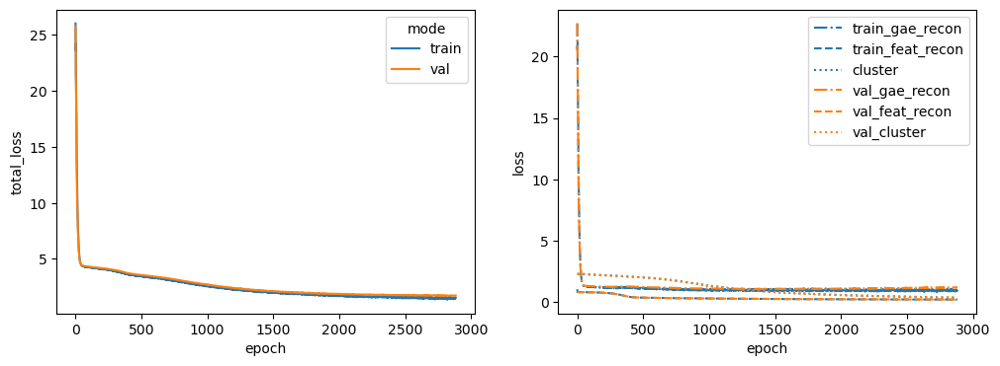

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


ATF4
Latent dim: 1024


 29%|██▉       | 2940/10000 [01:00<02:25, 48.64it/s]


Training stopped after 2941 epochs
Best model found at epoch 2839
------------------------------------------------------------
TEST AUC: 0.7631286982248521 AP: 0.788043295104503
TRAIN loss: 1.5042879581451416
VAL loss: 1.714499592781067
TEST loss: 1.9790219068527222
TEST AUC: 0.7631286982248521 	 AP: 0.788043295104503


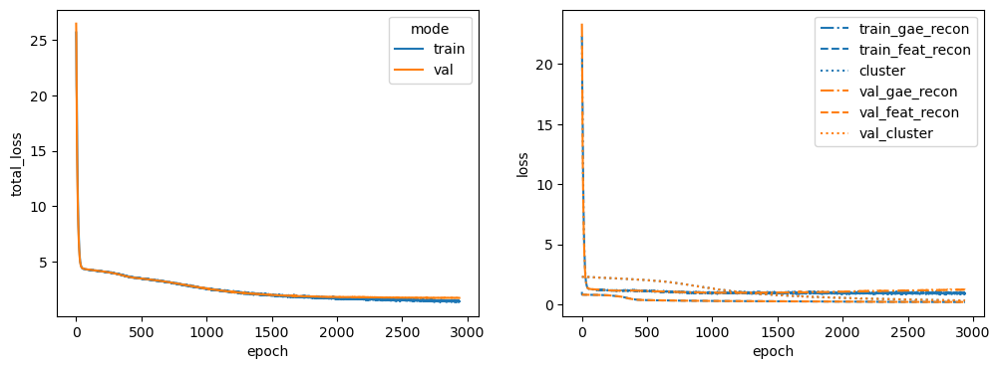

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


BAX
Latent dim: 1024


 26%|██▌       | 2559/10000 [00:54<02:38, 47.03it/s]


Training stopped after 2560 epochs
Best model found at epoch 2458
------------------------------------------------------------
TEST AUC: 0.7777366863905325 AP: 0.7950034738072438
TRAIN loss: 1.5308939218521118
VAL loss: 1.8663129806518555
TEST loss: 1.999415397644043
TEST AUC: 0.7777366863905325 	 AP: 0.7950034738072438


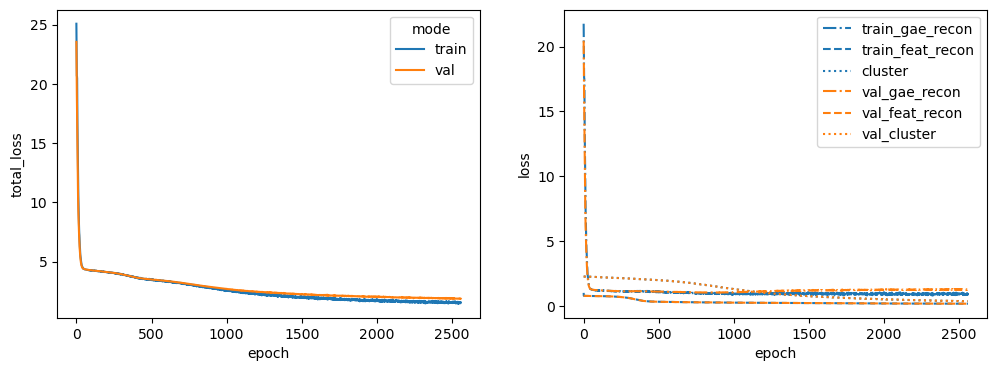

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


BCL2L11
Latent dim: 1024


 34%|███▍      | 3434/10000 [01:11<02:15, 48.35it/s]


Training stopped after 3435 epochs
Best model found at epoch 3333
------------------------------------------------------------
TEST AUC: 0.7757026627218936 AP: 0.7900264576737923
TRAIN loss: 1.3539142608642578
VAL loss: 1.768573522567749
TEST loss: 1.8912999629974365
TEST AUC: 0.7757026627218936 	 AP: 0.7900264576737923


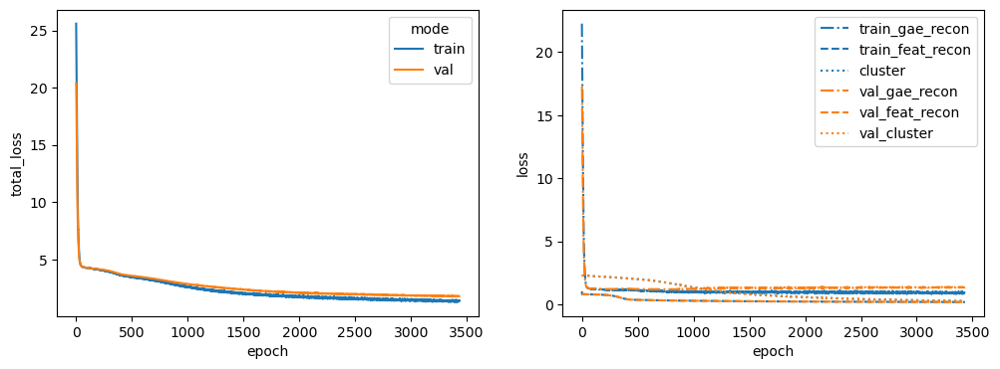

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


BRAF
Latent dim: 1024


 30%|███       | 3013/10000 [00:59<02:17, 50.78it/s]


Training stopped after 3014 epochs
Best model found at epoch 2912
------------------------------------------------------------
TEST AUC: 0.7826368343195266 AP: 0.7986229039516373
TRAIN loss: 1.393511414527893
VAL loss: 1.9313136339187622
TEST loss: 1.917622685432434
TEST AUC: 0.7826368343195266 	 AP: 0.7986229039516373


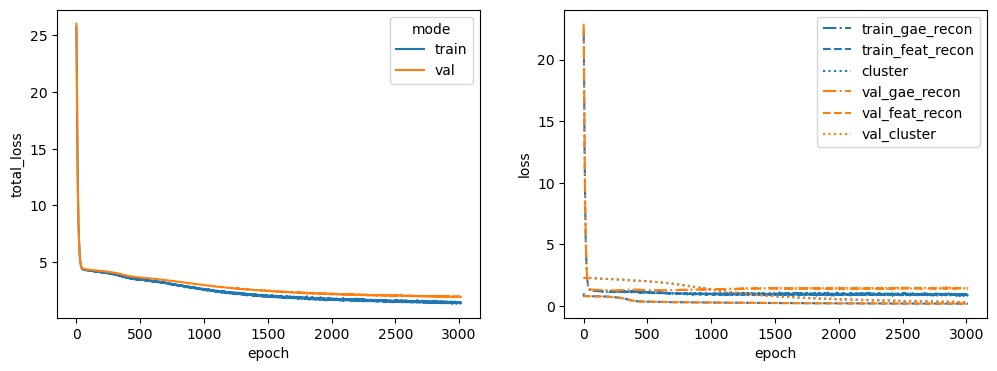

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


CASP8
Latent dim: 1024


 24%|██▍       | 2446/10000 [00:46<02:23, 52.55it/s]


Training stopped after 2447 epochs
Best model found at epoch 2345
------------------------------------------------------------
TEST AUC: 0.7573039940828402 AP: 0.7709813968155341
TRAIN loss: 1.5896382331848145
VAL loss: 1.8813488483428955
TEST loss: 2.161470651626587
TEST AUC: 0.7573039940828402 	 AP: 0.7709813968155341


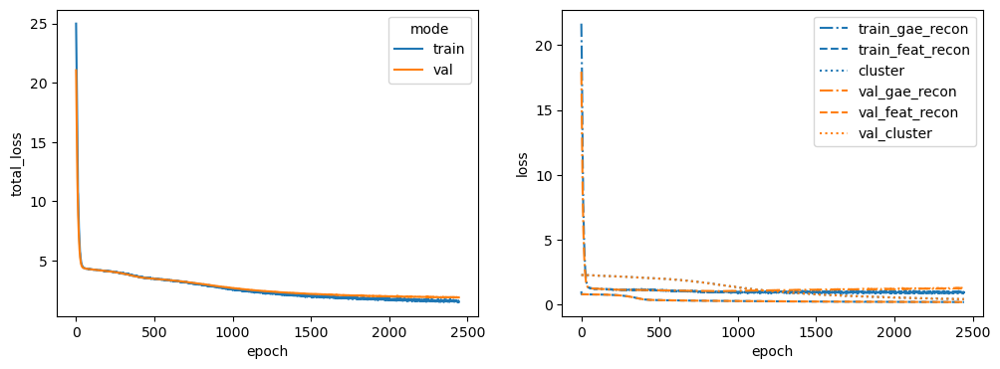

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


CDC42
Latent dim: 1024


 29%|██▉       | 2927/10000 [00:56<02:17, 51.46it/s]


Training stopped after 2928 epochs
Best model found at epoch 2826
------------------------------------------------------------
TEST AUC: 0.7490754437869822 AP: 0.7735796172250462
TRAIN loss: 1.487069010734558
VAL loss: 1.82626211643219
TEST loss: 2.0130021572113037
TEST AUC: 0.7490754437869822 	 AP: 0.7735796172250462


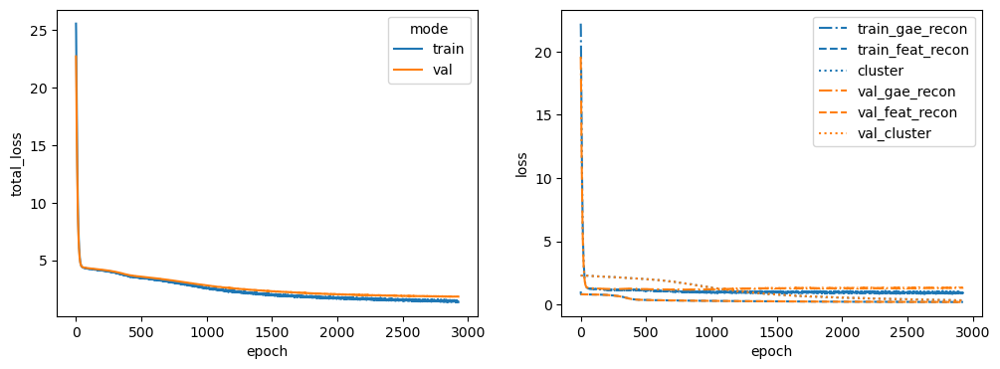

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


CDKN1A
Latent dim: 1024


 20%|█▉        | 1980/10000 [00:38<02:34, 51.89it/s]


Training stopped after 1981 epochs
Best model found at epoch 1879
------------------------------------------------------------
TEST AUC: 0.7596153846153847 AP: 0.7949735825314757
TRAIN loss: 1.7386682033538818
VAL loss: 2.0165700912475586
TEST loss: 2.1861305236816406
TEST AUC: 0.7596153846153847 	 AP: 0.7949735825314757


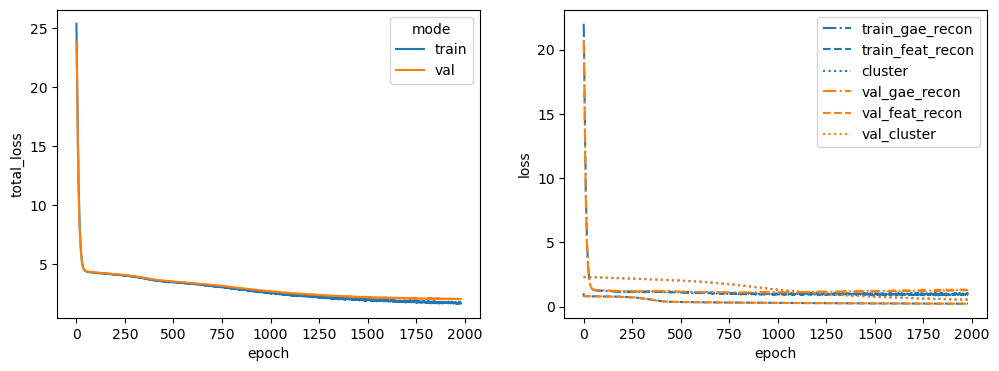

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


CEBPA
Latent dim: 1024


 48%|████▊     | 4761/10000 [01:31<01:40, 51.92it/s]


Training stopped after 4762 epochs
Best model found at epoch 4660
------------------------------------------------------------
TEST AUC: 0.7698779585798817 AP: 0.7882320417836677
TRAIN loss: 1.1860655546188354
VAL loss: 1.4482215642929077
TEST loss: 1.7349144220352173
TEST AUC: 0.7698779585798817 	 AP: 0.7882320417836677


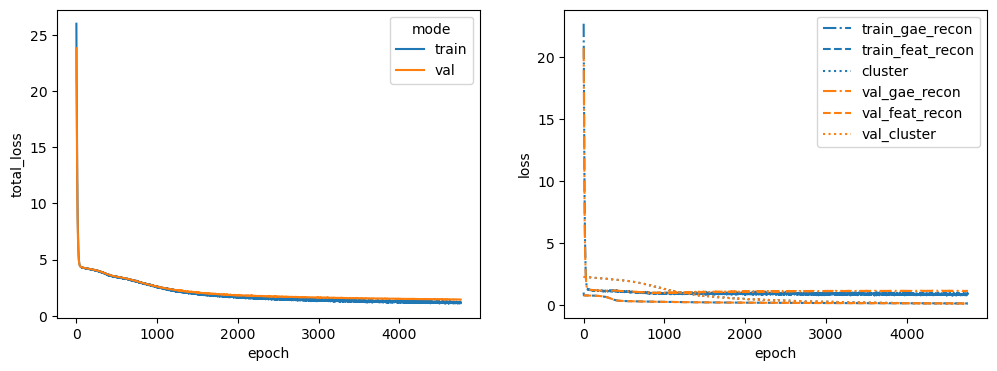

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


CREB1
Latent dim: 1024


 39%|███▉      | 3920/10000 [01:26<02:13, 45.45it/s]


Training stopped after 3921 epochs
Best model found at epoch 3819
------------------------------------------------------------
TEST AUC: 0.762758875739645 AP: 0.7624982301732972
TRAIN loss: 1.2904893159866333
VAL loss: 1.7158945798873901
TEST loss: 1.925437569618225
TEST AUC: 0.762758875739645 	 AP: 0.7624982301732972


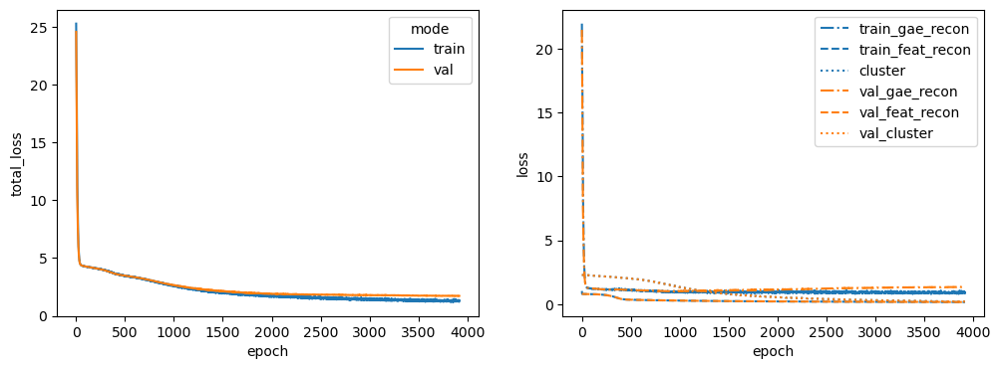

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


CXXC4
Latent dim: 1024


 33%|███▎      | 3291/10000 [01:14<02:31, 44.29it/s]


Training stopped after 3292 epochs
Best model found at epoch 3190
------------------------------------------------------------
TEST AUC: 0.7938239644970414 AP: 0.8481778292310744
TRAIN loss: 1.416252613067627
VAL loss: 1.8555089235305786
TEST loss: 1.7644765377044678
TEST AUC: 0.7938239644970414 	 AP: 0.8481778292310744


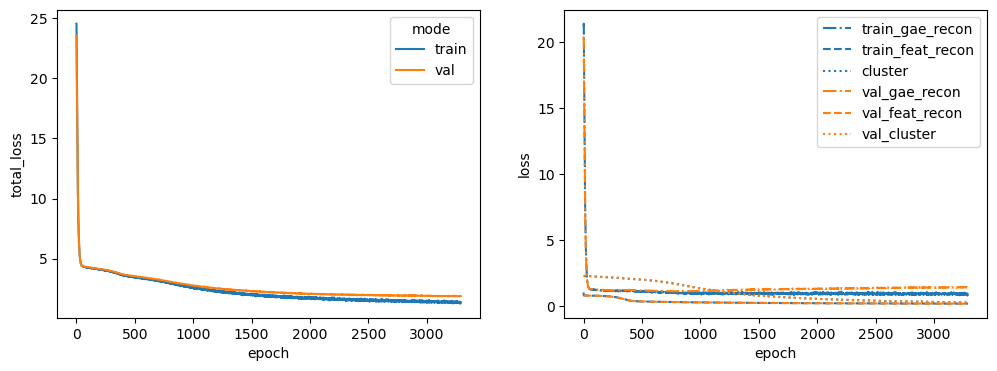

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


DIABLO
Latent dim: 1024


 23%|██▎       | 2253/10000 [00:50<02:54, 44.45it/s]


Training stopped after 2254 epochs
Best model found at epoch 2152
------------------------------------------------------------
TEST AUC: 0.7465791420118344 AP: 0.7404321606313624
TRAIN loss: 1.7575571537017822
VAL loss: 1.730710744857788
TEST loss: 2.2287187576293945
TEST AUC: 0.7465791420118344 	 AP: 0.7404321606313624


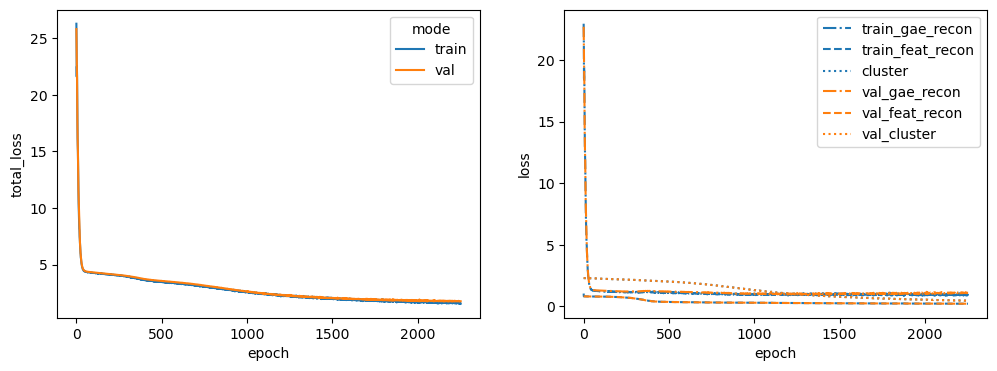

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


E2F1
Latent dim: 1024


 27%|██▋       | 2743/10000 [01:02<02:44, 43.99it/s]


Training stopped after 2744 epochs
Best model found at epoch 2642
------------------------------------------------------------
TEST AUC: 0.7519415680473374 AP: 0.8009860473740239
TRAIN loss: 1.476832628250122
VAL loss: 1.6862752437591553
TEST loss: 2.00559663772583
TEST AUC: 0.7519415680473374 	 AP: 0.8009860473740239


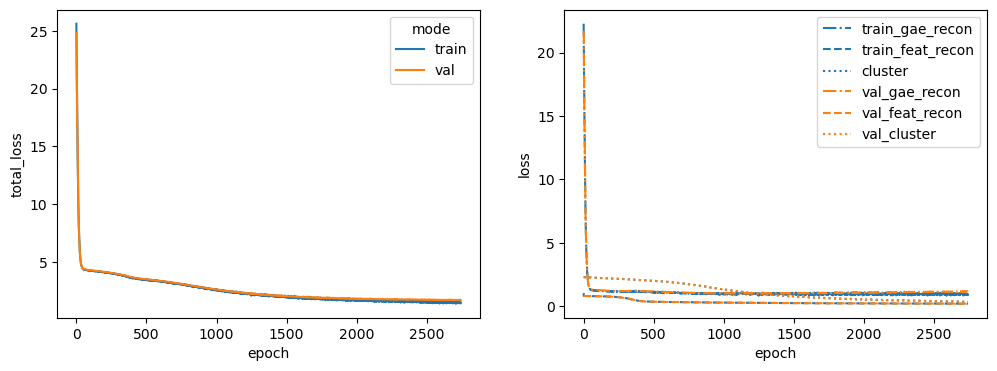

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


ELK1
Latent dim: 1024


 37%|███▋      | 3725/10000 [01:22<02:19, 45.13it/s]


Training stopped after 3726 epochs
Best model found at epoch 3624
------------------------------------------------------------
TEST AUC: 0.7933616863905325 AP: 0.8227742516050638
TRAIN loss: 1.3165948390960693
VAL loss: 1.733048677444458
TEST loss: 1.7338171005249023
TEST AUC: 0.7933616863905325 	 AP: 0.8227742516050638


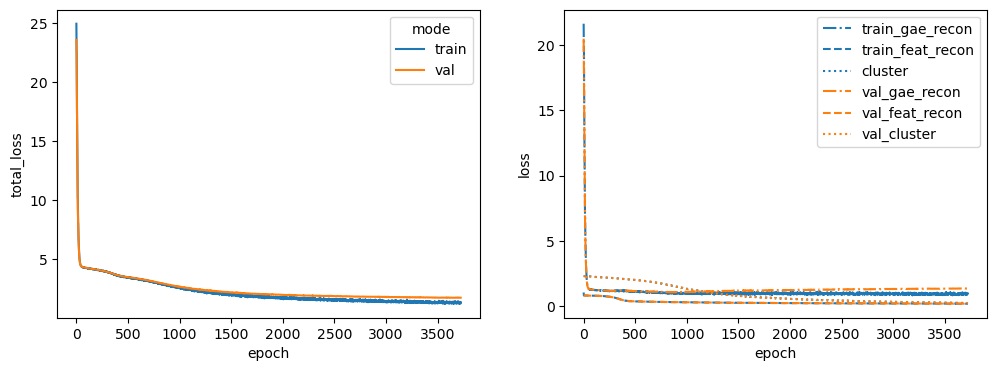

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


EMPTY
Latent dim: 1024


 33%|███▎      | 3305/10000 [01:14<02:29, 44.64it/s]


Training stopped after 3306 epochs
Best model found at epoch 3204
------------------------------------------------------------
TEST AUC: 0.7995562130177515 AP: 0.7851961209130958
TRAIN loss: 1.4246582984924316
VAL loss: 1.6723182201385498
TEST loss: 1.905566930770874
TEST AUC: 0.7995562130177515 	 AP: 0.7851961209130958


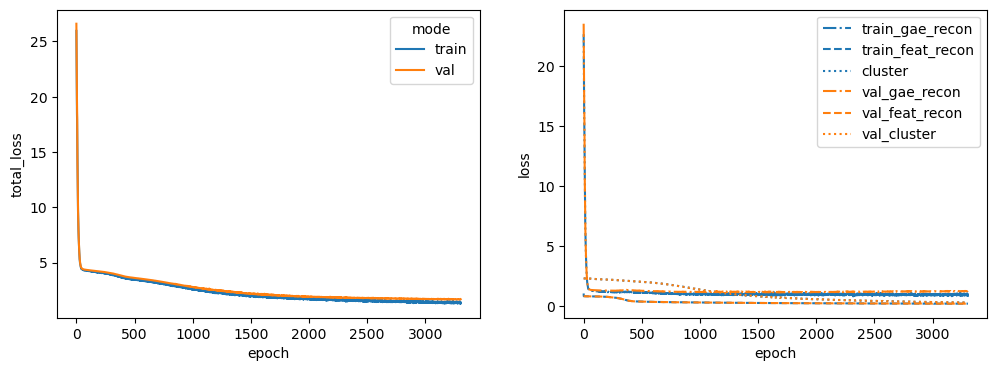

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


ERG
Latent dim: 1024


 38%|███▊      | 3833/10000 [01:24<02:16, 45.13it/s]


Training stopped after 3834 epochs
Best model found at epoch 3732
------------------------------------------------------------
TEST AUC: 0.7716346153846154 AP: 0.7817624273047086
TRAIN loss: 1.339328646659851
VAL loss: 1.7043657302856445
TEST loss: 1.8440039157867432
TEST AUC: 0.7716346153846154 	 AP: 0.7817624273047086


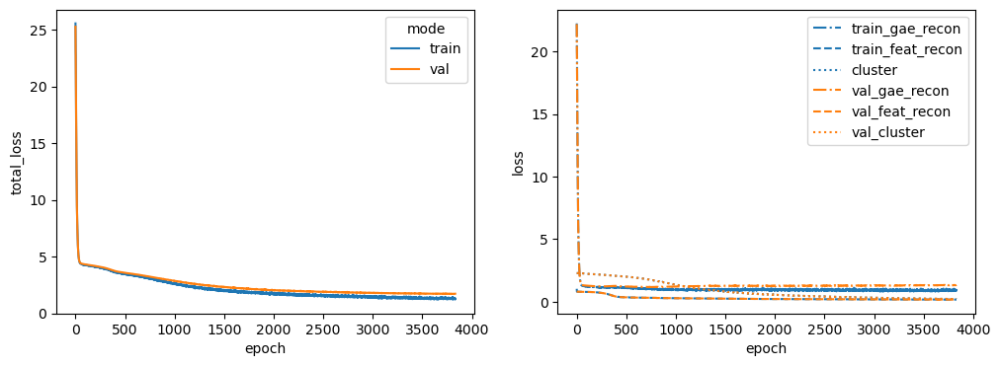

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


FGFR3
Latent dim: 1024


 34%|███▍      | 3433/10000 [01:17<02:28, 44.13it/s]


Training stopped after 3434 epochs
Best model found at epoch 3332
------------------------------------------------------------
TEST AUC: 0.8009430473372781 AP: 0.8329747329307676
TRAIN loss: 1.3611844778060913
VAL loss: 1.708940863609314
TEST loss: 1.7405681610107422
TEST AUC: 0.8009430473372781 	 AP: 0.8329747329307676


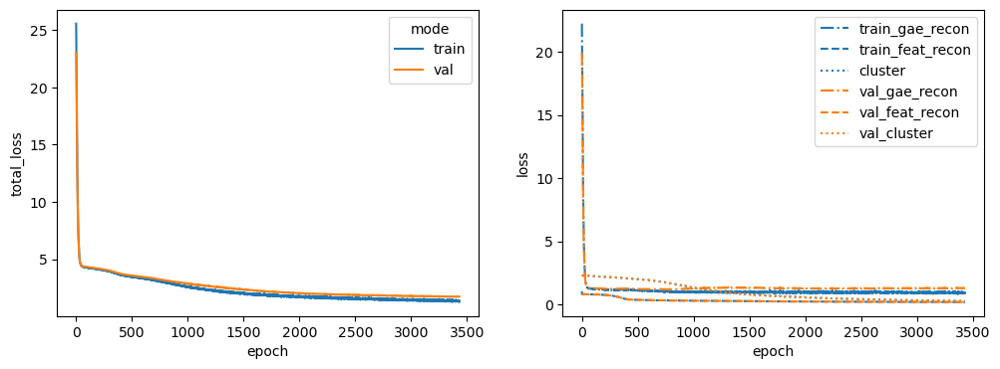

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


FOXO1
Latent dim: 1024


 45%|████▌     | 4515/10000 [01:38<02:00, 45.61it/s]


Training stopped after 4516 epochs
Best model found at epoch 4414
------------------------------------------------------------
TEST AUC: 0.7768121301775147 AP: 0.7765584969189647
TRAIN loss: 1.2305011749267578
VAL loss: 1.981292724609375
TEST loss: 1.7052481174468994
TEST AUC: 0.7768121301775147 	 AP: 0.7765584969189647


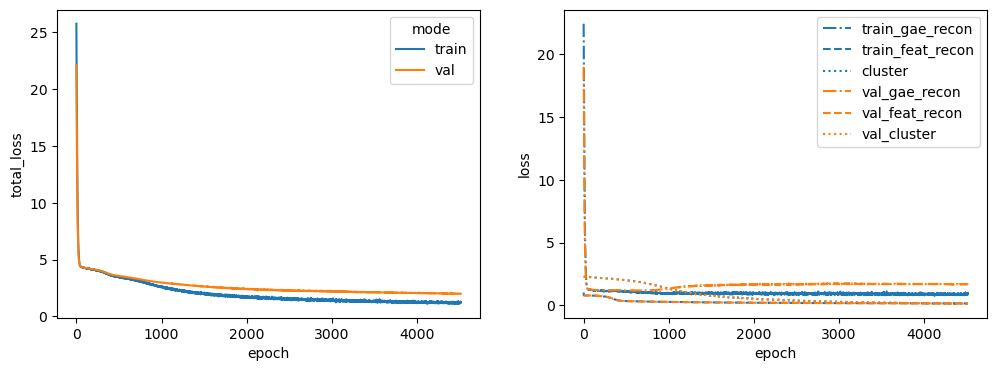

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


GLI1
Latent dim: 1024


 40%|████      | 4024/10000 [01:28<02:11, 45.60it/s]


Training stopped after 4025 epochs
Best model found at epoch 3923
------------------------------------------------------------
TEST AUC: 0.7558247041420117 AP: 0.7750028156842128
TRAIN loss: 1.3110332489013672
VAL loss: 1.7085427045822144
TEST loss: 1.84456205368042
TEST AUC: 0.7558247041420117 	 AP: 0.7750028156842128


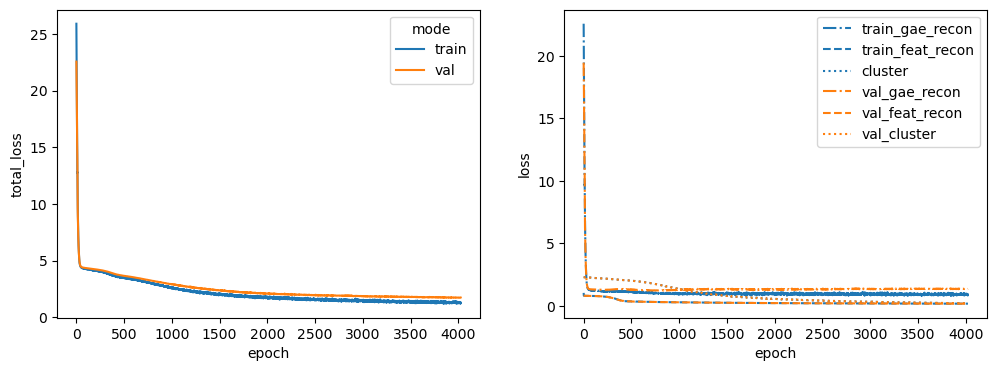

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


HRAS
Latent dim: 1024


 26%|██▌       | 2580/10000 [00:49<02:22, 52.01it/s]


Training stopped after 2581 epochs
Best model found at epoch 2479
------------------------------------------------------------
TEST AUC: 0.7259153106508875 AP: 0.6859557072025114
TRAIN loss: 1.647918701171875
VAL loss: 2.13114333152771
TEST loss: 2.5413498878479004
TEST AUC: 0.7259153106508875 	 AP: 0.6859557072025114


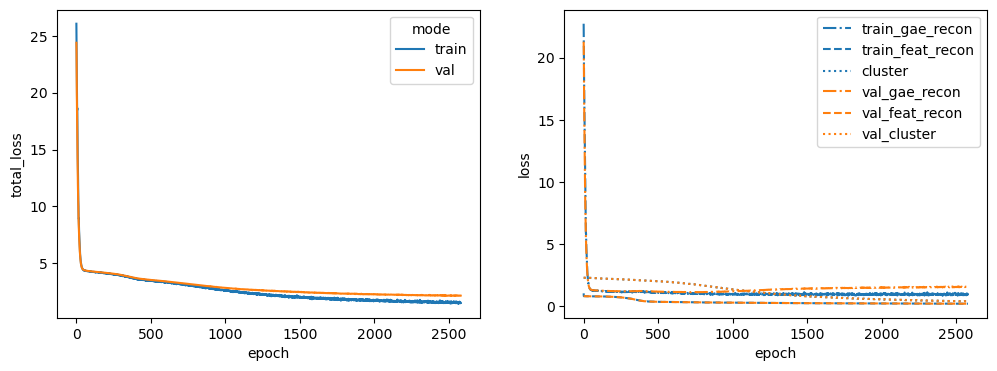

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


IRAK4
Latent dim: 1024


 36%|███▌      | 3589/10000 [01:05<01:56, 54.81it/s]


Training stopped after 3590 epochs
Best model found at epoch 3488
------------------------------------------------------------
TEST AUC: 0.7814349112426036 AP: 0.8174987952566224
TRAIN loss: 1.3873414993286133
VAL loss: 1.612181305885315
TEST loss: 1.7913142442703247
TEST AUC: 0.7814349112426036 	 AP: 0.8174987952566224


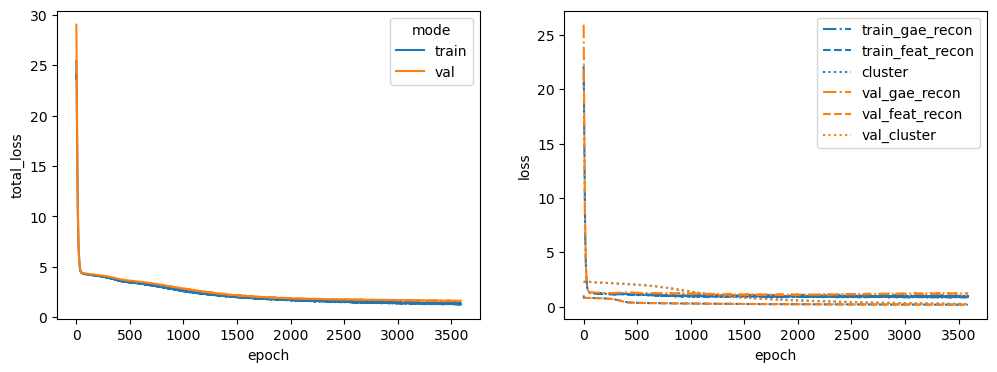

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


JUN
Latent dim: 1024


 26%|██▌       | 2595/10000 [00:52<02:29, 49.67it/s]


Training stopped after 2596 epochs
Best model found at epoch 2494
------------------------------------------------------------
TEST AUC: 0.7758875739644969 AP: 0.7750282659490998
TRAIN loss: 1.565878987312317
VAL loss: 1.9652748107910156
TEST loss: 2.0851385593414307
TEST AUC: 0.7758875739644969 	 AP: 0.7750282659490998


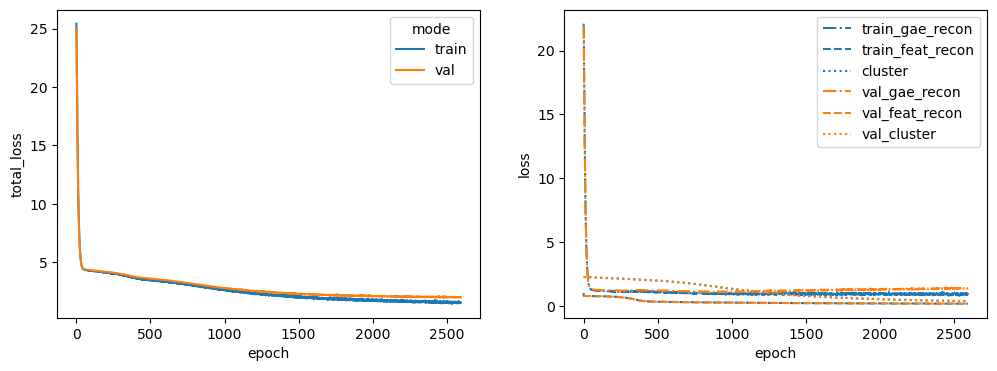

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


MAP2K3
Latent dim: 1024


 52%|█████▏    | 5223/10000 [01:38<01:30, 52.78it/s]


Training stopped after 5224 epochs
Best model found at epoch 5122
------------------------------------------------------------
TEST AUC: 0.8119452662721893 AP: 0.8619097867454735
TRAIN loss: 1.1586846113204956
VAL loss: 1.362725853919983
TEST loss: 1.4839664697647095
TEST AUC: 0.8119452662721893 	 AP: 0.8619097867454735


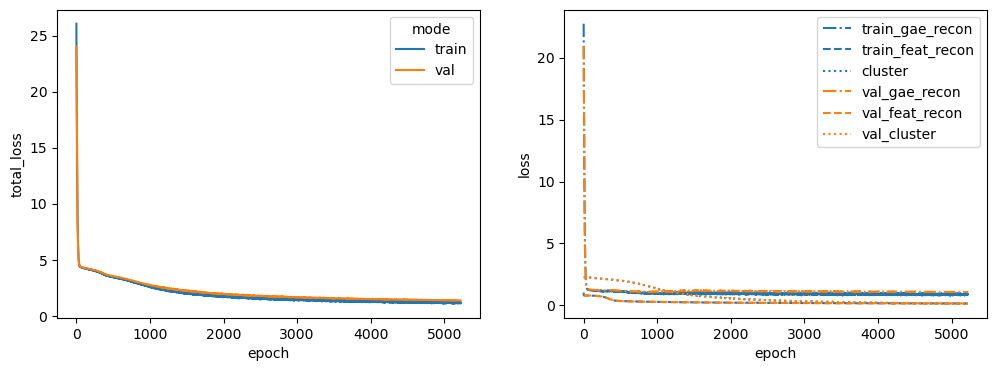

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


MAP3K2
Latent dim: 1024


 43%|████▎     | 4326/10000 [01:21<01:46, 53.11it/s]


Training stopped after 4327 epochs
Best model found at epoch 4225
------------------------------------------------------------
TEST AUC: 0.7946560650887574 AP: 0.828190110939723
TRAIN loss: 1.2133774757385254
VAL loss: 1.5410741567611694
TEST loss: 1.6179399490356445
TEST AUC: 0.7946560650887574 	 AP: 0.828190110939723


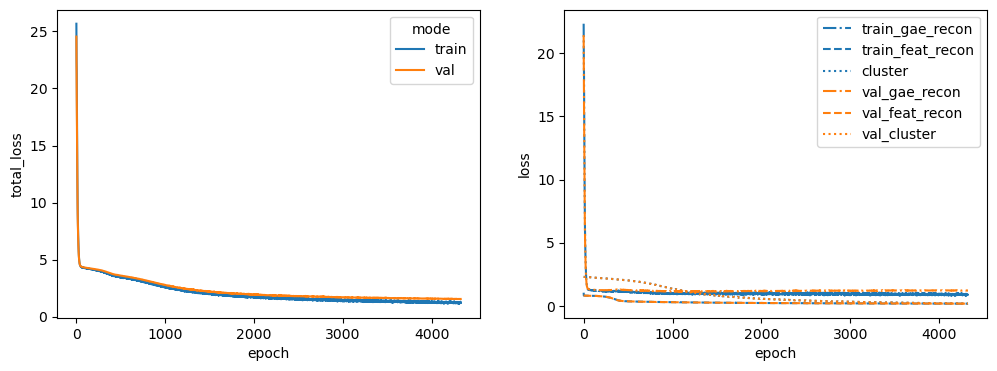

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


MAP3K5
Latent dim: 1024


 31%|███       | 3073/10000 [00:59<02:14, 51.58it/s]


Training stopped after 3074 epochs
Best model found at epoch 2972
------------------------------------------------------------
TEST AUC: 0.7293823964497042 AP: 0.721359668423095
TRAIN loss: 1.403808832168579
VAL loss: 1.6740275621414185
TEST loss: 2.0907883644104004
TEST AUC: 0.7293823964497042 	 AP: 0.721359668423095


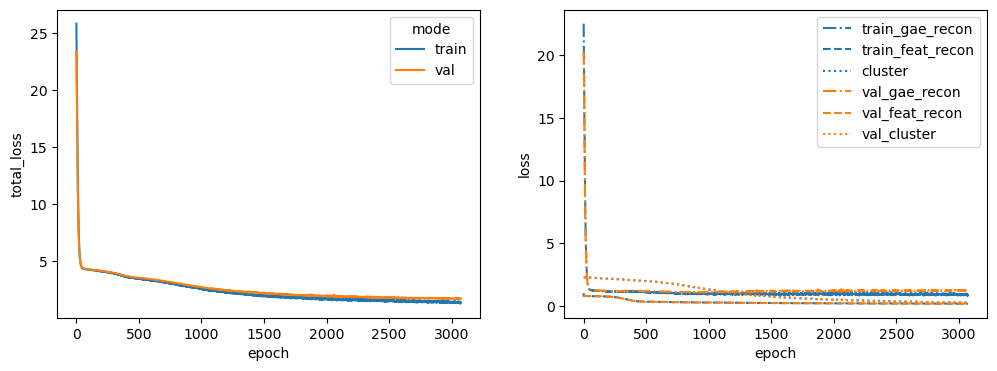

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


MAP3K9
Latent dim: 1024


 32%|███▏      | 3156/10000 [00:58<02:07, 53.84it/s]


Training stopped after 3157 epochs
Best model found at epoch 3055
------------------------------------------------------------
TEST AUC: 0.7870747041420119 AP: 0.8051944416455954
TRAIN loss: 1.3904188871383667
VAL loss: 2.1209967136383057
TEST loss: 1.8812280893325806
TEST AUC: 0.7870747041420119 	 AP: 0.8051944416455954


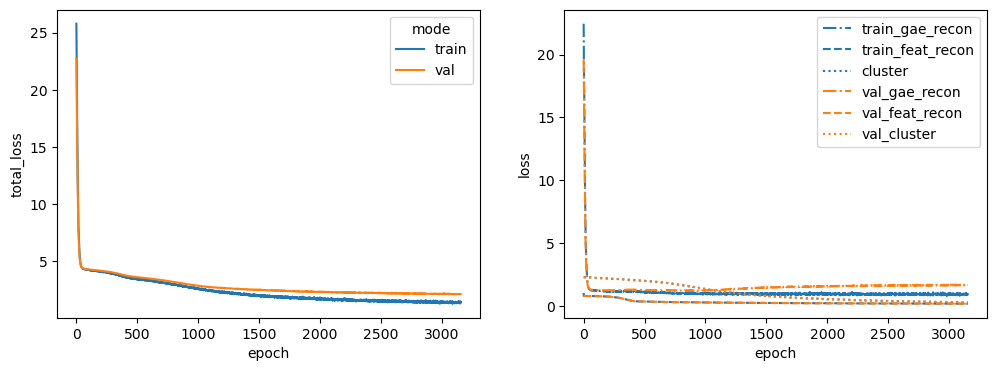

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


MAPK7
Latent dim: 1024


 31%|███       | 3112/10000 [00:58<02:09, 52.99it/s]


Training stopped after 3113 epochs
Best model found at epoch 3011
------------------------------------------------------------
TEST AUC: 0.7743158284023668 AP: 0.7788994099438432
TRAIN loss: 1.473301649093628
VAL loss: 1.9289631843566895
TEST loss: 1.9147162437438965
TEST AUC: 0.7743158284023668 	 AP: 0.7788994099438432


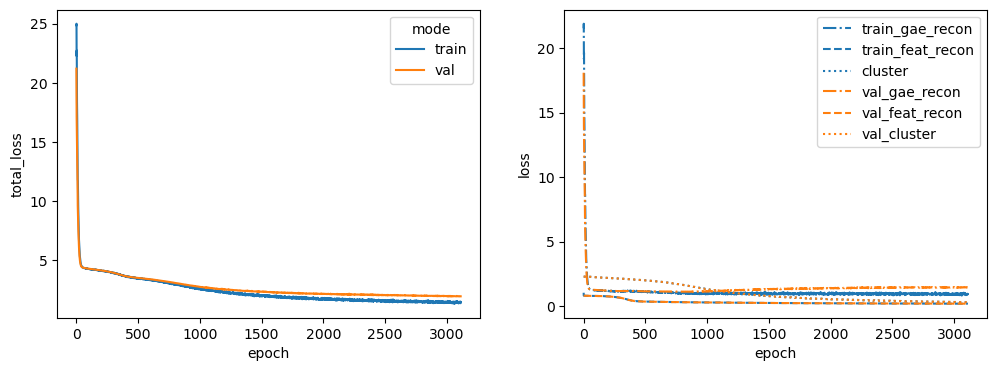

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


MOS
Latent dim: 1024


 26%|██▋       | 2627/10000 [00:47<02:13, 55.09it/s]


Training stopped after 2628 epochs
Best model found at epoch 2526
------------------------------------------------------------
TEST AUC: 0.7301220414201183 AP: 0.7435701825466564
TRAIN loss: 1.4877409934997559
VAL loss: 1.9501368999481201
TEST loss: 2.176050901412964
TEST AUC: 0.7301220414201183 	 AP: 0.7435701825466564


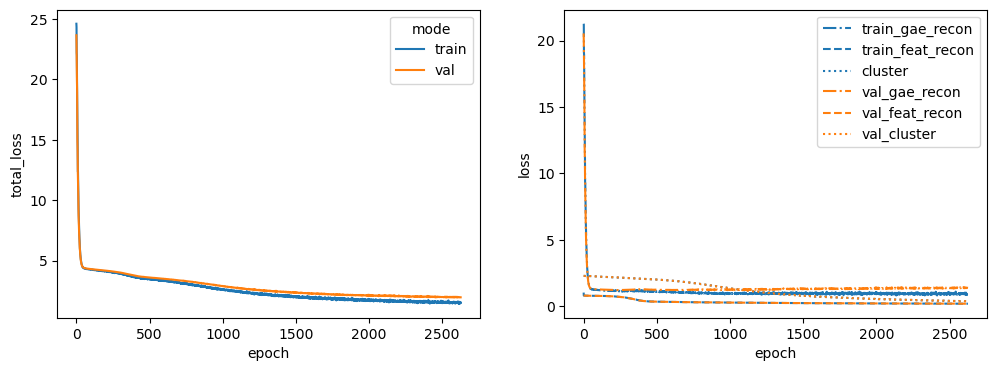

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


MYD88
Latent dim: 1024


 29%|██▉       | 2930/10000 [00:52<02:06, 56.00it/s]


Training stopped after 2931 epochs
Best model found at epoch 2829
------------------------------------------------------------
TEST AUC: 0.7867973372781065 AP: 0.8255115351018244
TRAIN loss: 1.492327332496643
VAL loss: 1.7919795513153076
TEST loss: 1.874884843826294
TEST AUC: 0.7867973372781065 	 AP: 0.8255115351018244


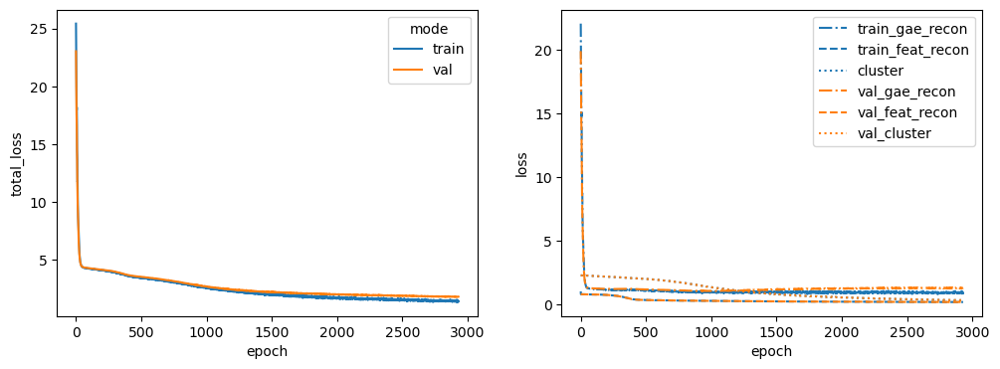

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


PIK3R2
Latent dim: 1024


 30%|██▉       | 2971/10000 [00:53<02:06, 55.38it/s]


Training stopped after 2972 epochs
Best model found at epoch 2870
------------------------------------------------------------
TEST AUC: 0.7806028106508875 AP: 0.8002539723503315
TRAIN loss: 1.4170676469802856
VAL loss: 1.7603609561920166
TEST loss: 1.910109281539917
TEST AUC: 0.7806028106508875 	 AP: 0.8002539723503315


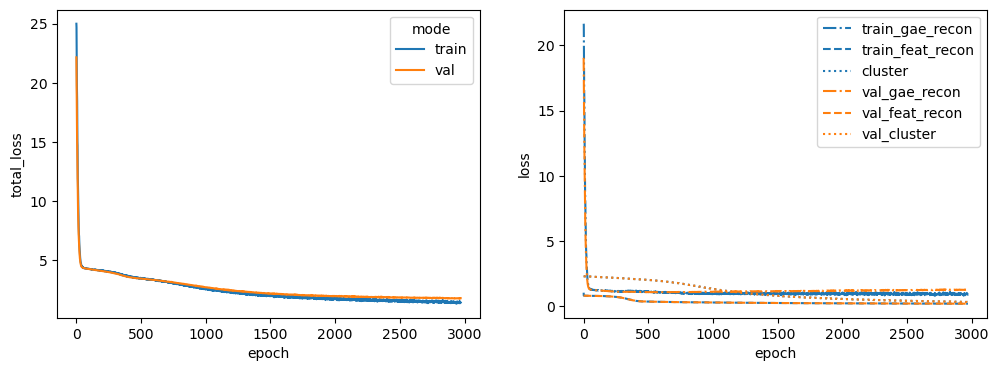

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


PRKACA
Latent dim: 1024


 28%|██▊       | 2793/10000 [00:51<02:13, 54.14it/s]


Training stopped after 2794 epochs
Best model found at epoch 2692
------------------------------------------------------------
TEST AUC: 0.7882766272189348 AP: 0.8003063657093366
TRAIN loss: 1.4316486120224
VAL loss: 1.7777231931686401
TEST loss: 1.9881069660186768
TEST AUC: 0.7882766272189348 	 AP: 0.8003063657093366


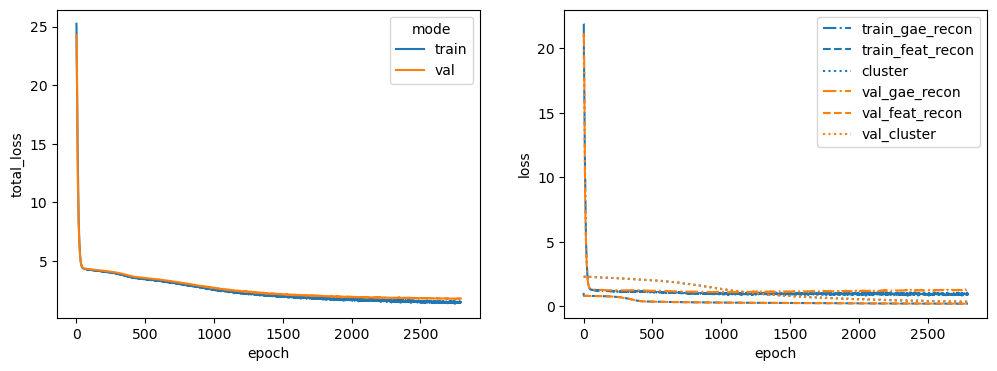

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


PRKCE
Latent dim: 1024


 26%|██▌       | 2624/10000 [00:51<02:24, 51.17it/s]


Training stopped after 2625 epochs
Best model found at epoch 2523
------------------------------------------------------------
TEST AUC: 0.7659023668639052 AP: 0.7692141697948682
TRAIN loss: 1.4821531772613525
VAL loss: 1.8008878231048584
TEST loss: 2.008653163909912
TEST AUC: 0.7659023668639052 	 AP: 0.7692141697948682


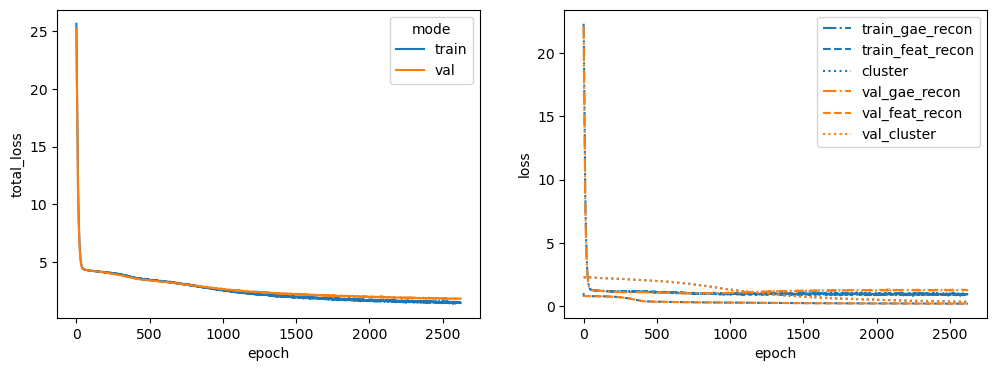

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


RAF1
Latent dim: 1024


 29%|██▊       | 2862/10000 [00:52<02:09, 54.98it/s]


Training stopped after 2863 epochs
Best model found at epoch 2761
------------------------------------------------------------
TEST AUC: 0.7994637573964497 AP: 0.831050540165894
TRAIN loss: 1.492746114730835
VAL loss: 1.9564162492752075
TEST loss: 1.858566164970398
TEST AUC: 0.7994637573964497 	 AP: 0.831050540165894


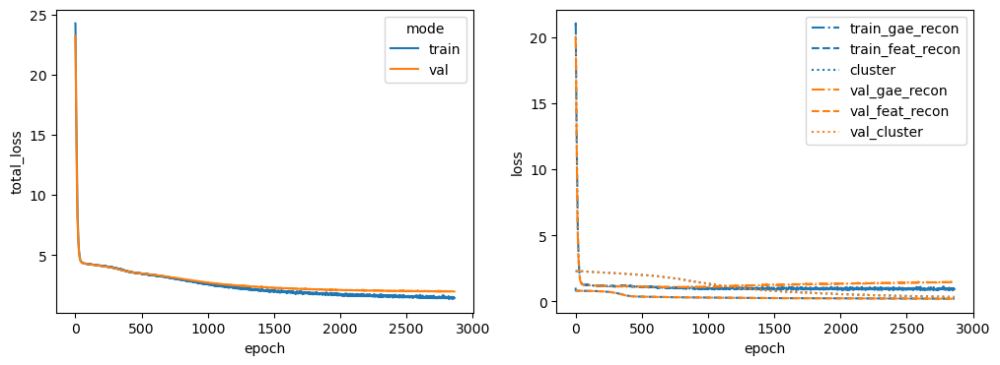

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


RELB
Latent dim: 1024


 27%|██▋       | 2721/10000 [00:50<02:14, 54.13it/s]


Training stopped after 2722 epochs
Best model found at epoch 2620
------------------------------------------------------------
TEST AUC: 0.7883690828402365 AP: 0.8055750338786056
TRAIN loss: 1.627483606338501
VAL loss: 1.7690352201461792
TEST loss: 1.91887366771698
TEST AUC: 0.7883690828402365 	 AP: 0.8055750338786056


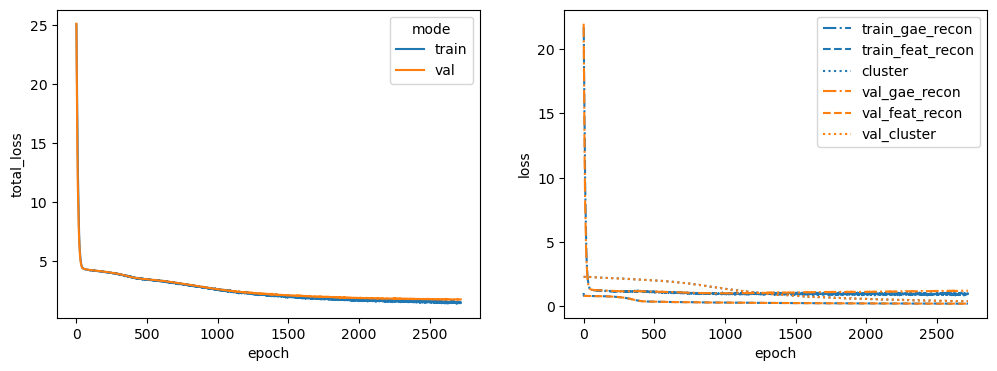

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


RHOA
Latent dim: 1024


 25%|██▍       | 2491/10000 [00:46<02:20, 53.46it/s]


Training stopped after 2492 epochs
Best model found at epoch 2390
------------------------------------------------------------
TEST AUC: 0.7855029585798816 AP: 0.8196046501743106
TRAIN loss: 1.5437290668487549
VAL loss: 1.6059237718582153
TEST loss: 1.9665470123291016
TEST AUC: 0.7855029585798816 	 AP: 0.8196046501743106


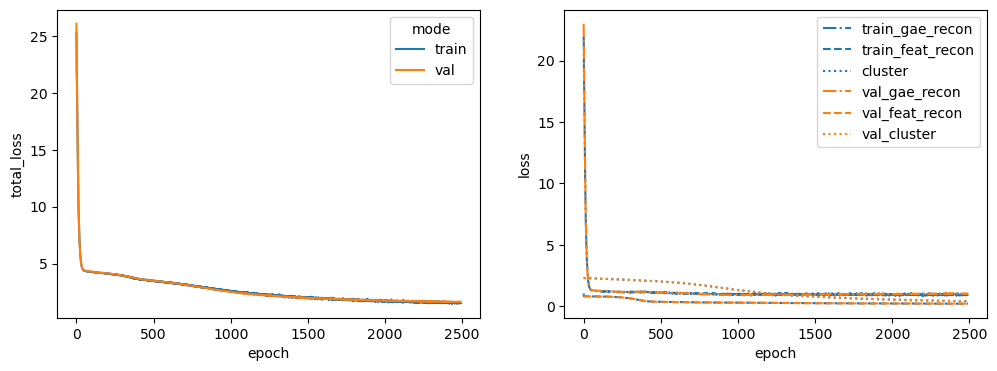

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


SMAD4
Latent dim: 1024


 23%|██▎       | 2294/10000 [00:43<02:24, 53.28it/s]


Training stopped after 2295 epochs
Best model found at epoch 2193
------------------------------------------------------------
TEST AUC: 0.7835613905325444 AP: 0.7892274680270495
TRAIN loss: 1.5987094640731812
VAL loss: 1.9126732349395752
TEST loss: 2.0617446899414062
TEST AUC: 0.7835613905325444 	 AP: 0.7892274680270495


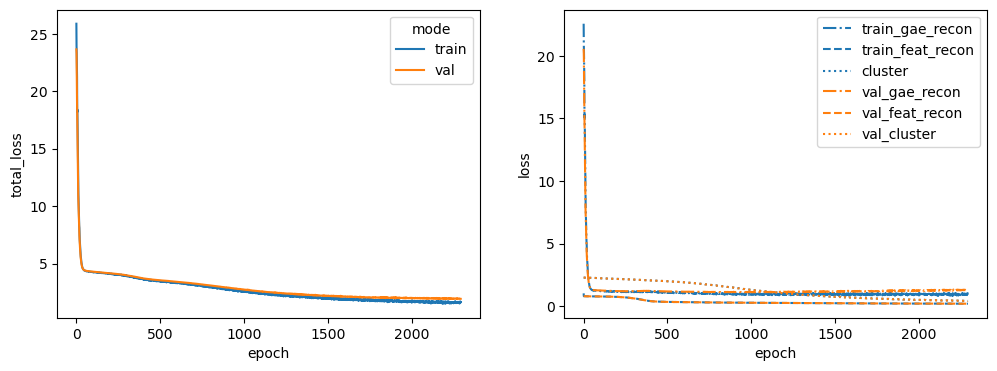

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


SMO
Latent dim: 1024


 30%|███       | 3015/10000 [00:58<02:16, 51.25it/s]


Training stopped after 3016 epochs
Best model found at epoch 2914
------------------------------------------------------------
TEST AUC: 0.745099852071006 AP: 0.7544245398208494
TRAIN loss: 1.4928889274597168
VAL loss: 1.7189970016479492
TEST loss: 2.0475072860717773
TEST AUC: 0.745099852071006 	 AP: 0.7544245398208494


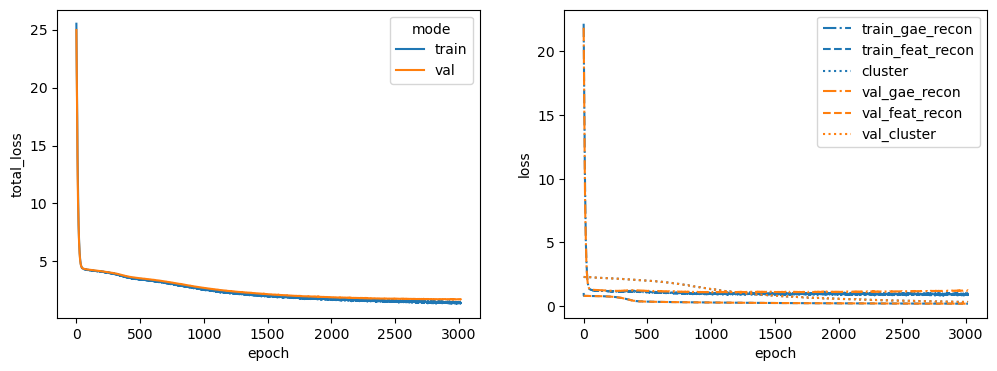

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


SRC
Latent dim: 1024


 40%|████      | 4021/10000 [01:19<01:57, 50.88it/s]


Training stopped after 4022 epochs
Best model found at epoch 3920
------------------------------------------------------------
TEST AUC: 0.8105584319526626 AP: 0.8657042735815588
TRAIN loss: 1.2416667938232422
VAL loss: 1.6775420904159546
TEST loss: 1.6085853576660156
TEST AUC: 0.8105584319526626 	 AP: 0.8657042735815588


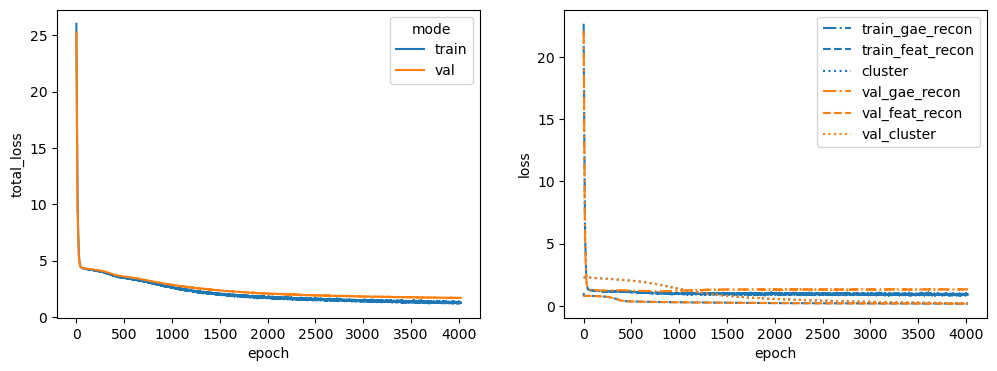

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


SREBF1
Latent dim: 1024


 29%|██▊       | 2859/10000 [00:51<02:09, 55.06it/s]


Training stopped after 2860 epochs
Best model found at epoch 2758
------------------------------------------------------------
TEST AUC: 0.79114275147929 AP: 0.8019274363577531
TRAIN loss: 1.4799619913101196
VAL loss: 1.5763628482818604
TEST loss: 1.8886899948120117
TEST AUC: 0.79114275147929 	 AP: 0.8019274363577531


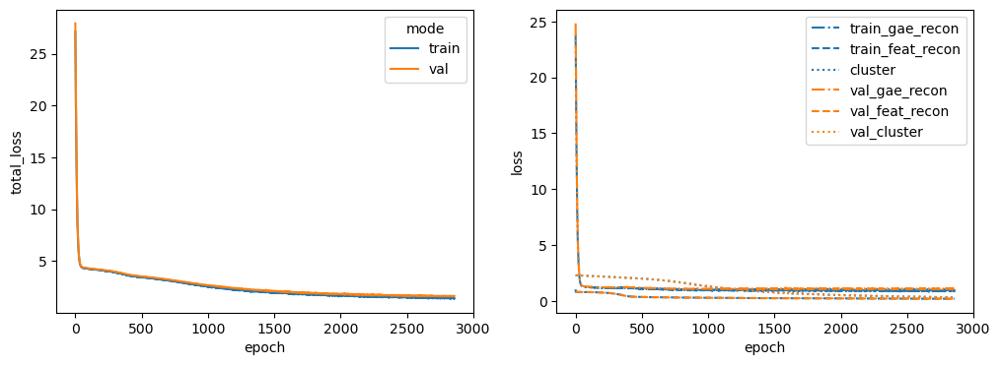

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


TRAF2
Latent dim: 1024


 41%|████      | 4100/10000 [01:17<01:51, 52.80it/s]


Training stopped after 4101 epochs
Best model found at epoch 3999
------------------------------------------------------------
TEST AUC: 0.7860576923076924 AP: 0.796074167501801
TRAIN loss: 1.2440369129180908
VAL loss: 1.709877848625183
TEST loss: 1.7114027738571167
TEST AUC: 0.7860576923076924 	 AP: 0.796074167501801


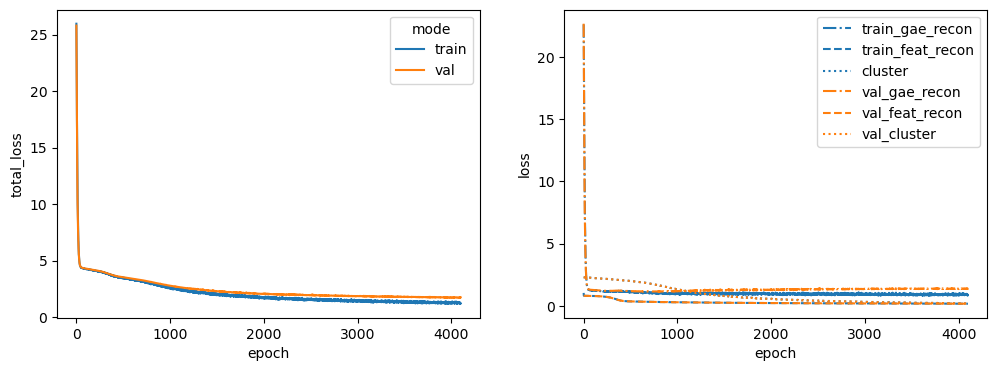

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


TSC2
Latent dim: 1024


 33%|███▎      | 3290/10000 [01:02<02:08, 52.34it/s]


Training stopped after 3291 epochs
Best model found at epoch 3189
------------------------------------------------------------
TEST AUC: 0.7529585798816568 AP: 0.7562746200238047
TRAIN loss: 1.365718960762024
VAL loss: 1.7976325750350952
TEST loss: 1.9370412826538086
TEST AUC: 0.7529585798816568 	 AP: 0.7562746200238047


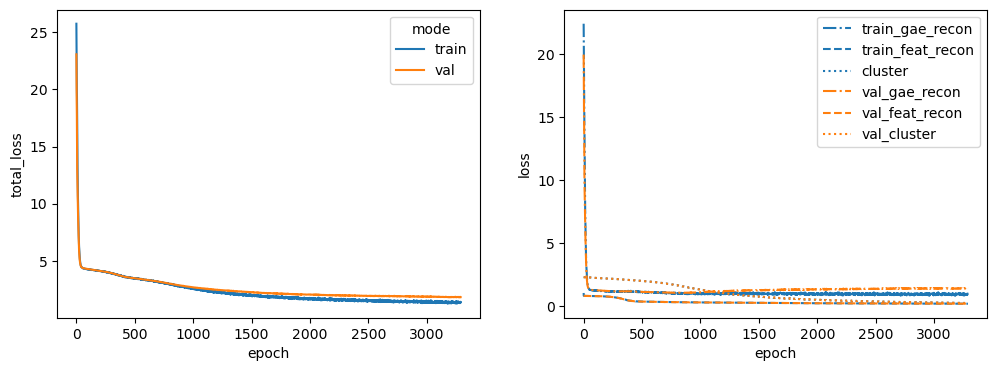

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


WWTR1
Latent dim: 1024


 35%|███▌      | 3543/10000 [01:03<01:56, 55.40it/s]


Training stopped after 3544 epochs
Best model found at epoch 3442
------------------------------------------------------------
TEST AUC: 0.8048261834319527 AP: 0.8489568374667931
TRAIN loss: 1.401828646659851
VAL loss: 1.8351426124572754
TEST loss: 1.701557993888855
TEST AUC: 0.8048261834319527 	 AP: 0.8489568374667931


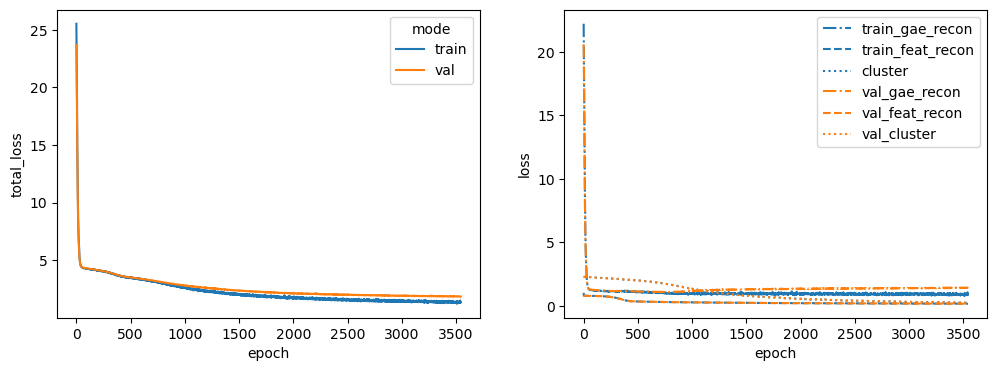

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


AKT1S1
Latent dim: 1024


 46%|████▋     | 4645/10000 [01:25<01:38, 54.61it/s]


Training stopped after 4646 epochs
Best model found at epoch 4544
------------------------------------------------------------
TEST AUC: 0.7394600591715977 AP: 0.7481724184605573
TRAIN loss: 1.508292555809021
VAL loss: 1.763825535774231
TEST loss: 2.186206579208374
TEST AUC: 0.7394600591715977 	 AP: 0.7481724184605573


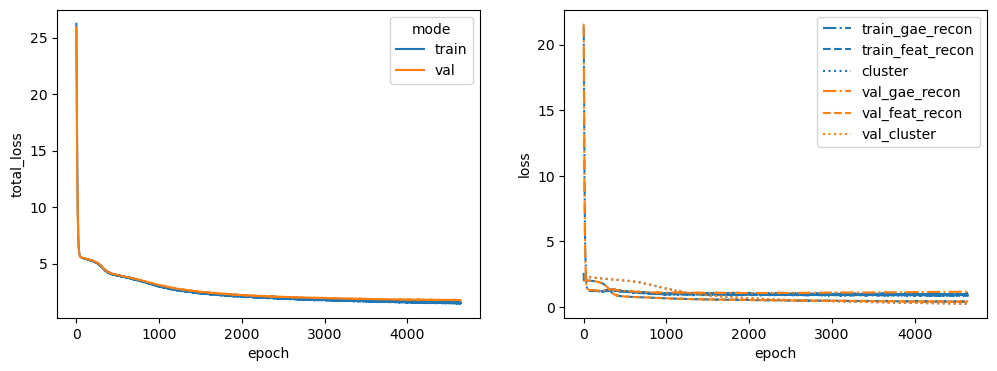

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


ATF4
Latent dim: 1024


 60%|█████▉    | 5957/10000 [01:47<01:12, 55.50it/s]


Training stopped after 5958 epochs
Best model found at epoch 5856
------------------------------------------------------------
TEST AUC: 0.7732988165680473 AP: 0.8203688755012818
TRAIN loss: 1.468676209449768
VAL loss: 1.7178819179534912
TEST loss: 1.8921886682510376
TEST AUC: 0.7732988165680473 	 AP: 0.8203688755012818


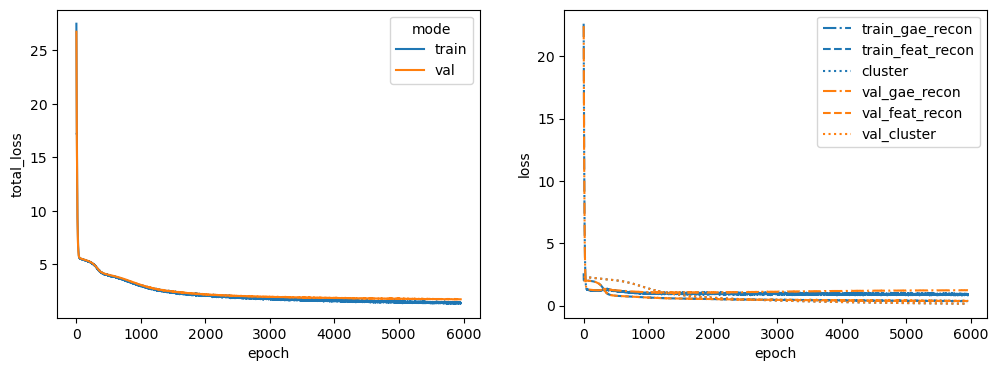

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


BAX
Latent dim: 1024


 30%|██▉       | 2984/10000 [00:58<02:16, 51.33it/s]


Training stopped after 2985 epochs
Best model found at epoch 2883
------------------------------------------------------------
TEST AUC: 0.7712647928994083 AP: 0.7870902032453583
TRAIN loss: 1.8158340454101562
VAL loss: 2.030815601348877
TEST loss: 2.304013729095459
TEST AUC: 0.7712647928994083 	 AP: 0.7870902032453583


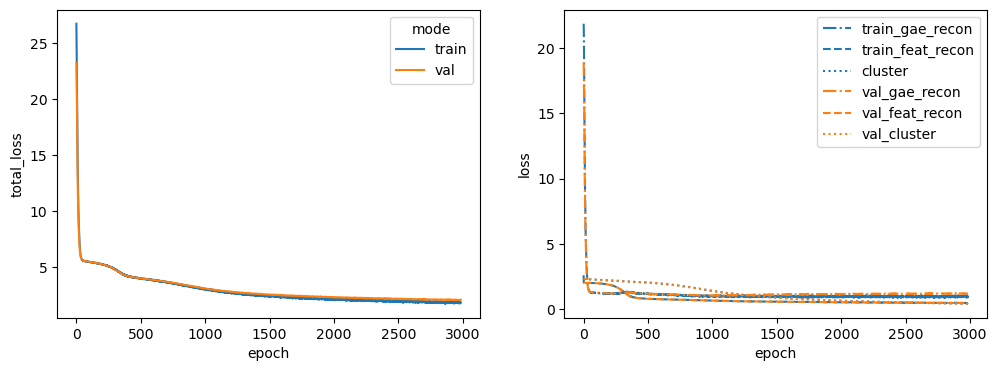

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


BCL2L11
Latent dim: 1024


 43%|████▎     | 4253/10000 [01:18<01:45, 54.34it/s]


Training stopped after 4254 epochs
Best model found at epoch 4152
------------------------------------------------------------
TEST AUC: 0.7810650887573963 AP: 0.8052192790510441
TRAIN loss: 1.5415253639221191
VAL loss: 2.0915582180023193
TEST loss: 2.0674657821655273
TEST AUC: 0.7810650887573963 	 AP: 0.8052192790510441


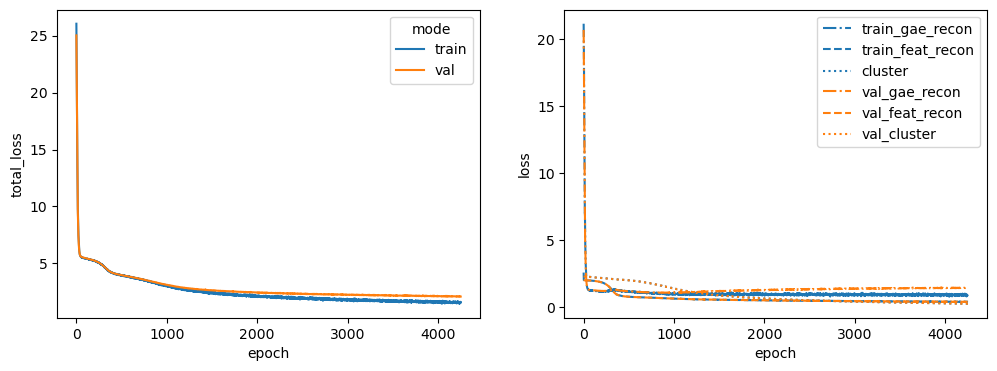

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


BRAF
Latent dim: 1024


 33%|███▎      | 3287/10000 [00:59<02:02, 54.92it/s]


Training stopped after 3288 epochs
Best model found at epoch 3186
------------------------------------------------------------
TEST AUC: 0.7222633136094675 AP: 0.7072751334605254
TRAIN loss: 1.7667977809906006
VAL loss: 2.0939719676971436
TEST loss: 2.48820424079895
TEST AUC: 0.7222633136094675 	 AP: 0.7072751334605254


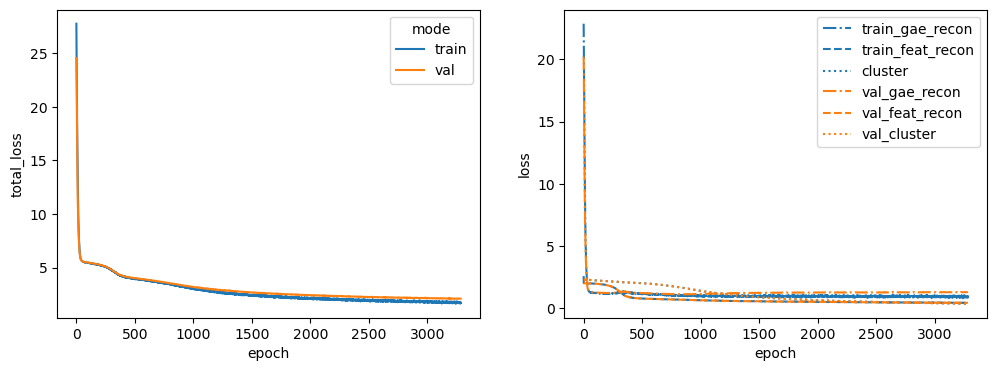

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


CASP8
Latent dim: 1024


 48%|████▊     | 4788/10000 [01:34<01:42, 50.91it/s]


Training stopped after 4789 epochs
Best model found at epoch 4687
------------------------------------------------------------
TEST AUC: 0.812869822485207 AP: 0.8369560904200066
TRAIN loss: 1.5592694282531738
VAL loss: 1.7749228477478027
TEST loss: 1.9089665412902832
TEST AUC: 0.812869822485207 	 AP: 0.8369560904200066


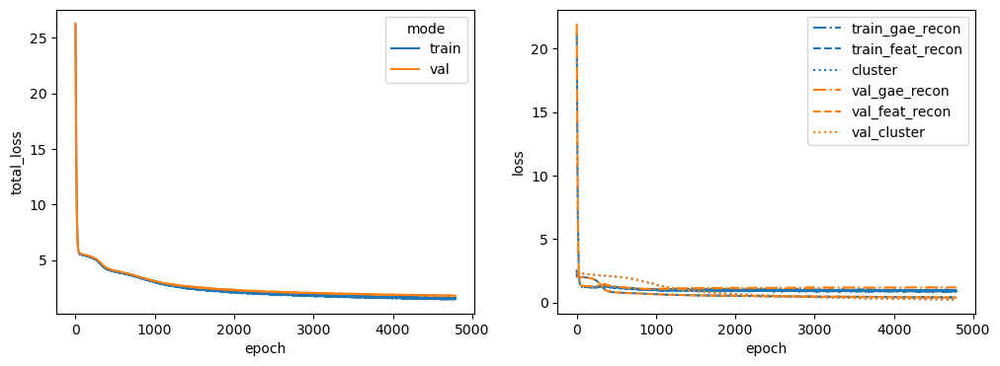

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


CDC42
Latent dim: 1024


 33%|███▎      | 3349/10000 [01:08<02:15, 48.99it/s]


Training stopped after 3350 epochs
Best model found at epoch 3248
------------------------------------------------------------
TEST AUC: 0.7707100591715975 AP: 0.8022039457674435
TRAIN loss: 1.6926321983337402
VAL loss: 2.003391981124878
TEST loss: 2.210857391357422
TEST AUC: 0.7707100591715975 	 AP: 0.8022039457674435


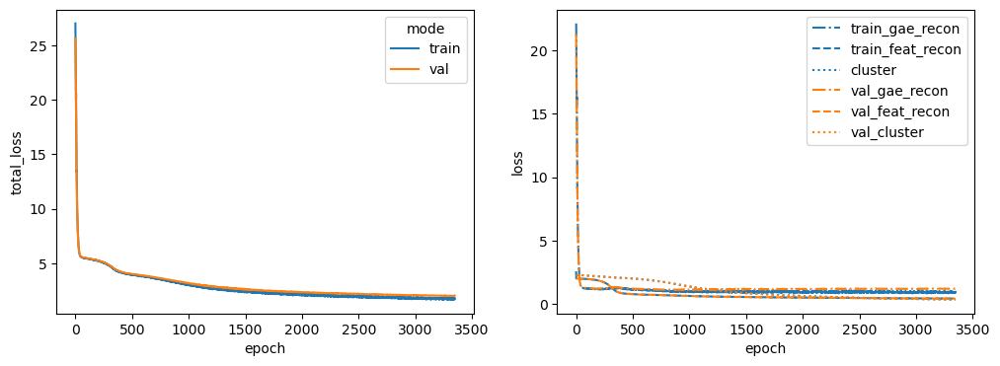

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


CDKN1A
Latent dim: 1024


 31%|███       | 3117/10000 [01:04<02:21, 48.61it/s]


Training stopped after 3118 epochs
Best model found at epoch 3016
------------------------------------------------------------
TEST AUC: 0.7591531065088758 AP: 0.7629082680991859
TRAIN loss: 1.774935245513916
VAL loss: 1.879913091659546
TEST loss: 2.3879876136779785
TEST AUC: 0.7591531065088758 	 AP: 0.7629082680991859


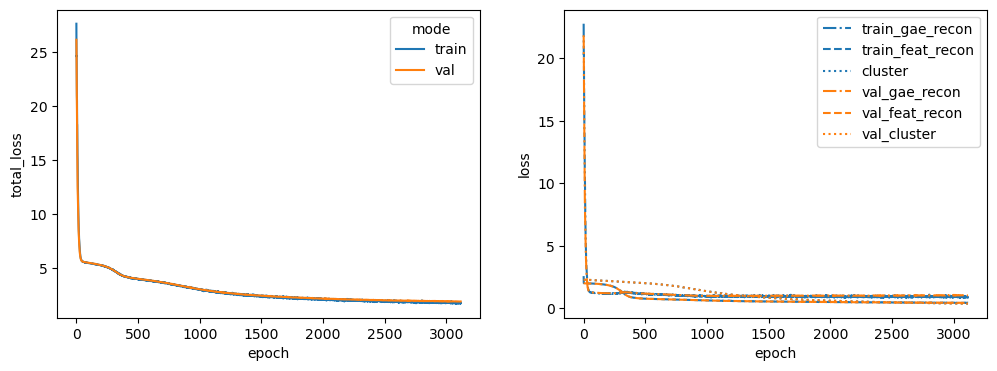

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


CEBPA
Latent dim: 1024


 45%|████▍     | 4481/10000 [01:24<01:44, 53.01it/s]


Training stopped after 4482 epochs
Best model found at epoch 4380
------------------------------------------------------------
TEST AUC: 0.7960428994082841 AP: 0.8251461608039443
TRAIN loss: 1.5082283020019531
VAL loss: 1.8730617761611938
TEST loss: 1.9509644508361816
TEST AUC: 0.7960428994082841 	 AP: 0.8251461608039443


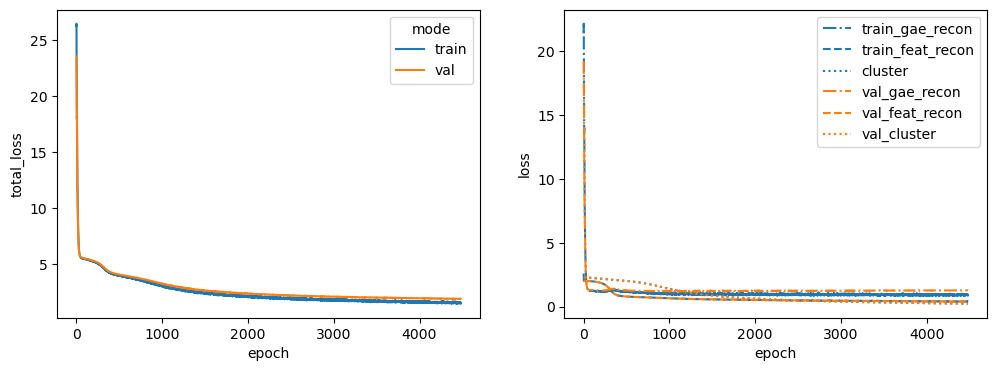

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


CREB1
Latent dim: 1024


 38%|███▊      | 3759/10000 [01:07<01:52, 55.68it/s]


Training stopped after 3760 epochs
Best model found at epoch 3658
------------------------------------------------------------
TEST AUC: 0.7757951183431954 AP: 0.774689012160992
TRAIN loss: 1.7207789421081543
VAL loss: 2.4467556476593018
TEST loss: 2.225623369216919
TEST AUC: 0.7757951183431954 	 AP: 0.774689012160992


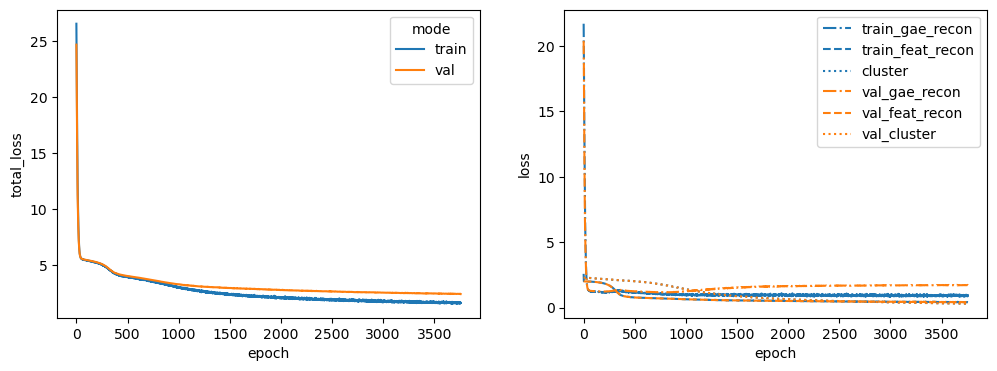

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


CXXC4
Latent dim: 1024


 43%|████▎     | 4286/10000 [01:15<01:40, 56.68it/s]


Training stopped after 4287 epochs
Best model found at epoch 4185
------------------------------------------------------------
TEST AUC: 0.739737426035503 AP: 0.741554992071676
TRAIN loss: 1.5746972560882568
VAL loss: 1.9816739559173584
TEST loss: 2.2360658645629883
TEST AUC: 0.739737426035503 	 AP: 0.741554992071676


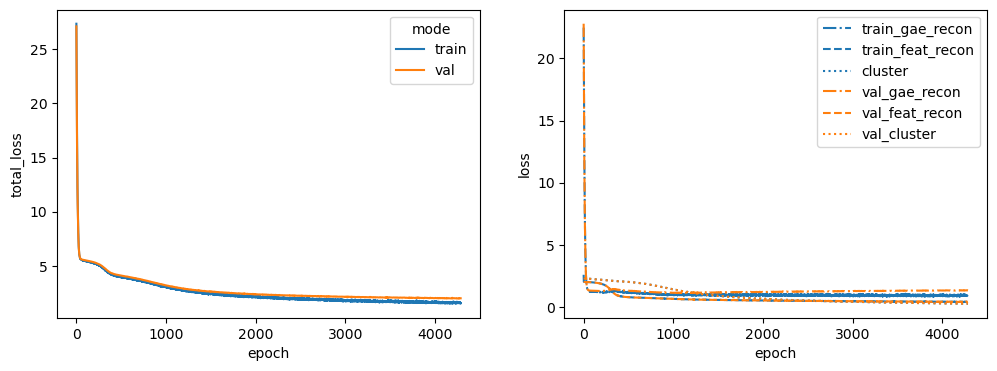

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


DIABLO
Latent dim: 1024


 56%|█████▋    | 5628/10000 [01:39<01:17, 56.29it/s]


Training stopped after 5629 epochs
Best model found at epoch 5527
------------------------------------------------------------
TEST AUC: 0.7610484467455622 AP: 0.7822652309187991
TRAIN loss: 1.3760789632797241
VAL loss: 1.8484210968017578
TEST loss: 1.9969650506973267
TEST AUC: 0.7610484467455622 	 AP: 0.7822652309187991


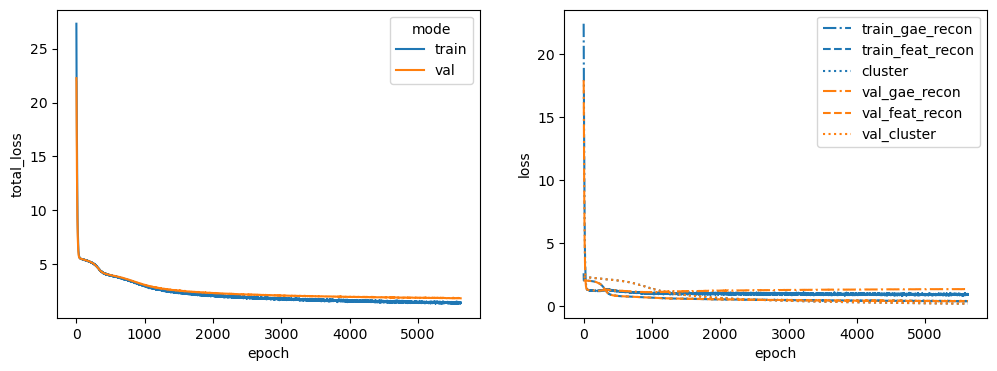

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


E2F1
Latent dim: 1024


 32%|███▏      | 3192/10000 [00:55<01:59, 57.21it/s]


Training stopped after 3193 epochs
Best model found at epoch 3091
------------------------------------------------------------
TEST AUC: 0.7765347633136096 AP: 0.8157757457002484
TRAIN loss: 1.7761125564575195
VAL loss: 2.166722059249878
TEST loss: 2.208073377609253
TEST AUC: 0.7765347633136096 	 AP: 0.8157757457002484


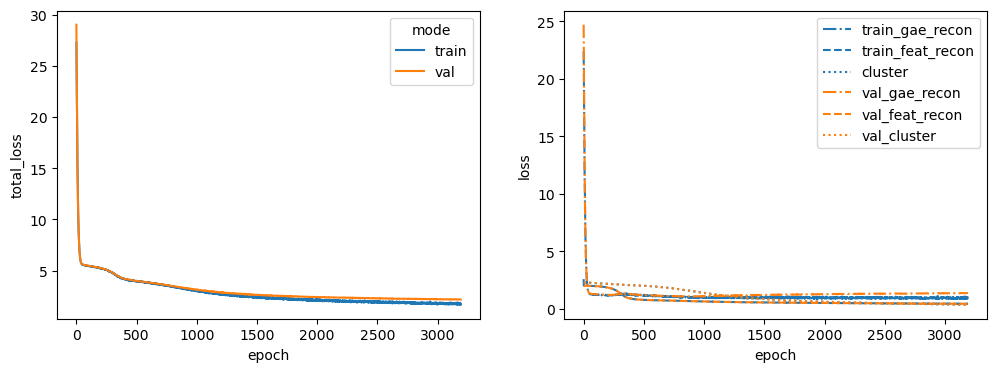

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


ELK1
Latent dim: 1024


 39%|███▊      | 3860/10000 [01:08<01:48, 56.68it/s]


Training stopped after 3861 epochs
Best model found at epoch 3759
------------------------------------------------------------
TEST AUC: 0.7665495562130177 AP: 0.7951886723121616
TRAIN loss: 1.592828392982483
VAL loss: 2.069939374923706
TEST loss: 2.1681125164031982
TEST AUC: 0.7665495562130177 	 AP: 0.7951886723121616


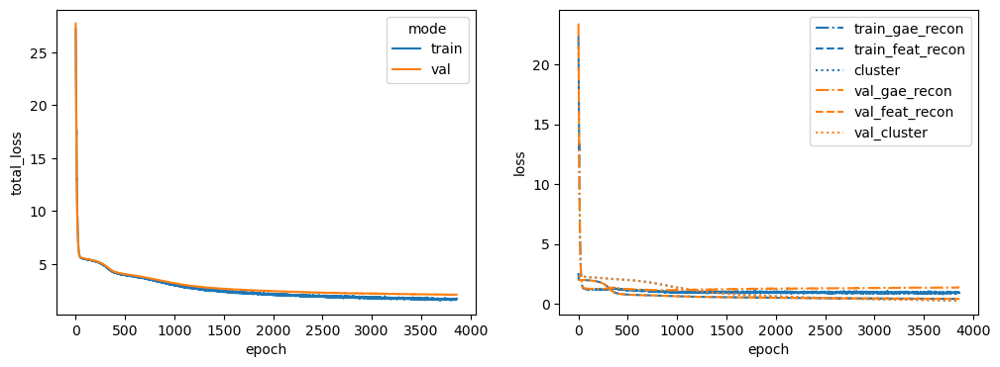

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


EMPTY
Latent dim: 1024


 54%|█████▎    | 5370/10000 [01:33<01:20, 57.30it/s]


Training stopped after 5371 epochs
Best model found at epoch 5269
------------------------------------------------------------
TEST AUC: 0.7823594674556213 AP: 0.8130375915277402
TRAIN loss: 1.4372577667236328
VAL loss: 1.7409106492996216
TEST loss: 1.9384132623672485
TEST AUC: 0.7823594674556213 	 AP: 0.8130375915277402


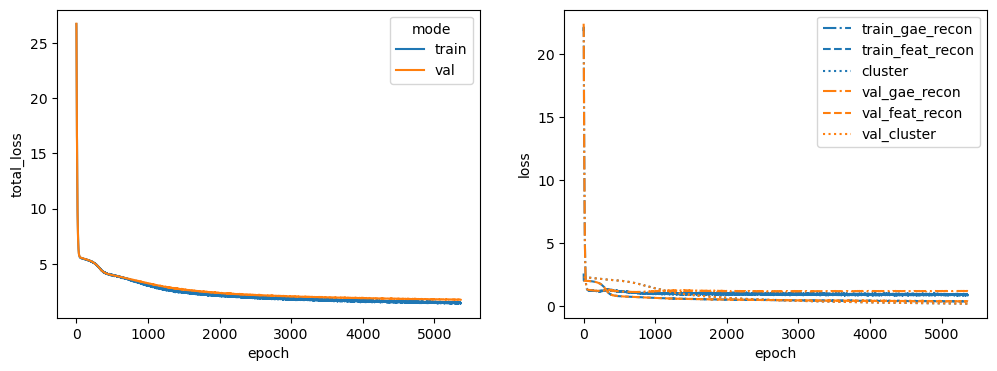

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


ERG
Latent dim: 1024


 37%|███▋      | 3677/10000 [01:05<01:52, 56.30it/s]


Training stopped after 3678 epochs
Best model found at epoch 3576
------------------------------------------------------------
TEST AUC: 0.7739460059171597 AP: 0.8001775385118385
TRAIN loss: 1.638468623161316
VAL loss: 2.242567300796509
TEST loss: 2.223086357116699
TEST AUC: 0.7739460059171597 	 AP: 0.8001775385118385


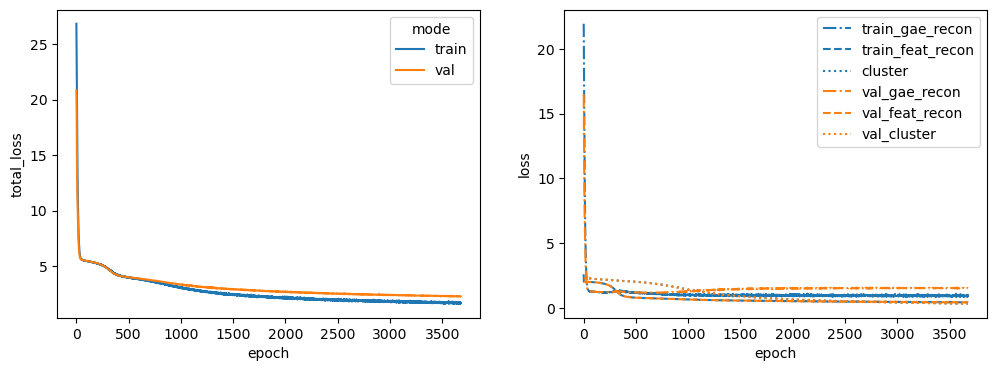

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


FGFR3
Latent dim: 1024


 52%|█████▏    | 5157/10000 [01:32<01:26, 56.02it/s]


Training stopped after 5158 epochs
Best model found at epoch 5056
------------------------------------------------------------
TEST AUC: 0.7776442307692307 AP: 0.8233799184463466
TRAIN loss: 1.5654873847961426
VAL loss: 1.6827861070632935
TEST loss: 1.9581515789031982
TEST AUC: 0.7776442307692307 	 AP: 0.8233799184463466


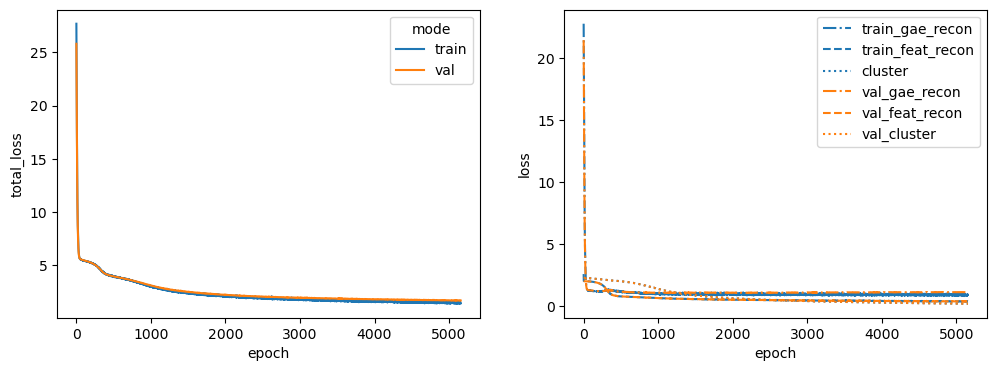

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


FOXO1
Latent dim: 1024


 42%|████▏     | 4235/10000 [01:13<01:39, 57.82it/s]


Training stopped after 4236 epochs
Best model found at epoch 4134
------------------------------------------------------------
TEST AUC: 0.736409023668639 AP: 0.752767237372705
TRAIN loss: 1.5832970142364502
VAL loss: 2.02213978767395
TEST loss: 2.1850156784057617
TEST AUC: 0.736409023668639 	 AP: 0.752767237372705


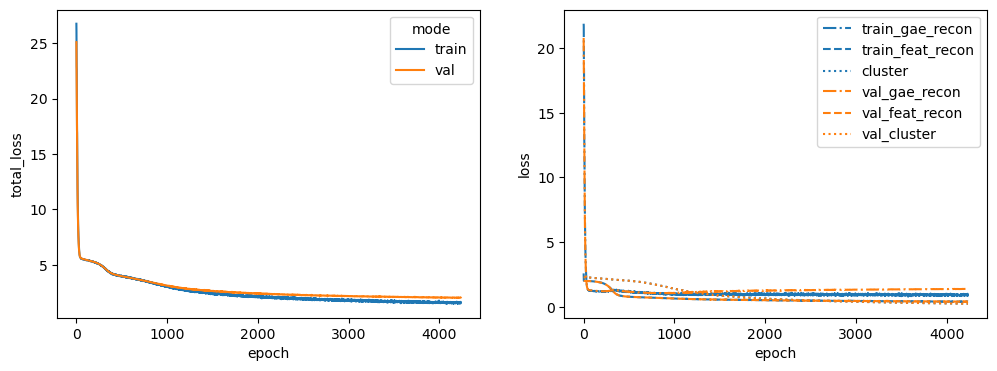

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


GLI1
Latent dim: 1024


 31%|███       | 3078/10000 [00:54<02:02, 56.72it/s]


Training stopped after 3079 epochs
Best model found at epoch 2977
------------------------------------------------------------
TEST AUC: 0.7325258875739645 AP: 0.7314451371526292
TRAIN loss: 1.794259786605835
VAL loss: 2.3054494857788086
TEST loss: 2.527996063232422
TEST AUC: 0.7325258875739645 	 AP: 0.7314451371526292


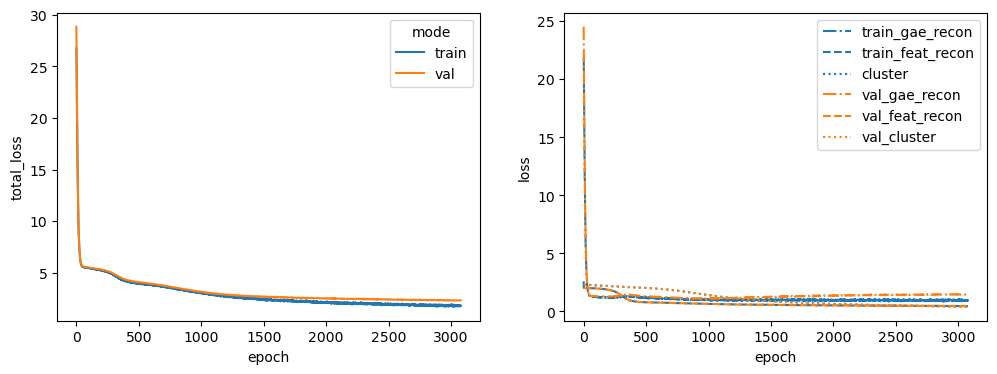

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


HRAS
Latent dim: 1024


 60%|█████▉    | 5959/10000 [01:44<01:10, 56.99it/s]


Training stopped after 5960 epochs
Best model found at epoch 5858
------------------------------------------------------------
TEST AUC: 0.7881841715976331 AP: 0.831515302234781
TRAIN loss: 1.3911023139953613
VAL loss: 1.6954067945480347
TEST loss: 1.8584648370742798
TEST AUC: 0.7881841715976331 	 AP: 0.831515302234781


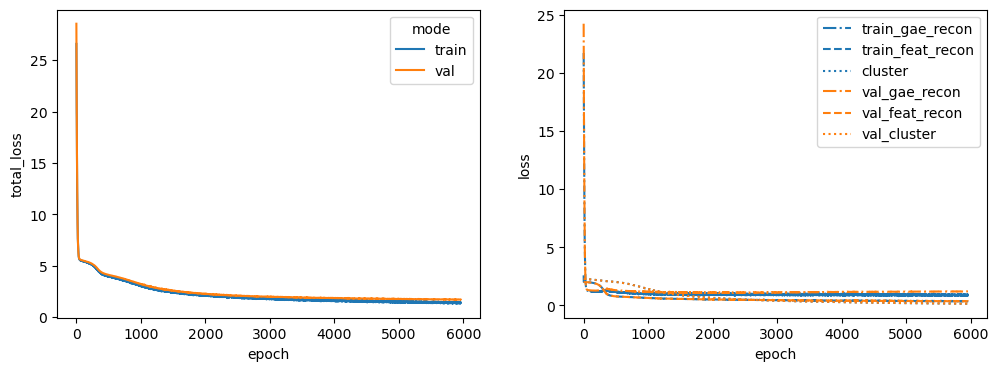

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


IRAK4
Latent dim: 1024


 40%|███▉      | 3954/10000 [01:10<01:47, 56.35it/s]


Training stopped after 3955 epochs
Best model found at epoch 3853
------------------------------------------------------------
TEST AUC: 0.7385355029585798 AP: 0.7289061031699128
TRAIN loss: 1.639330506324768
VAL loss: 1.852102279663086
TEST loss: 2.3559679985046387
TEST AUC: 0.7385355029585798 	 AP: 0.7289061031699128


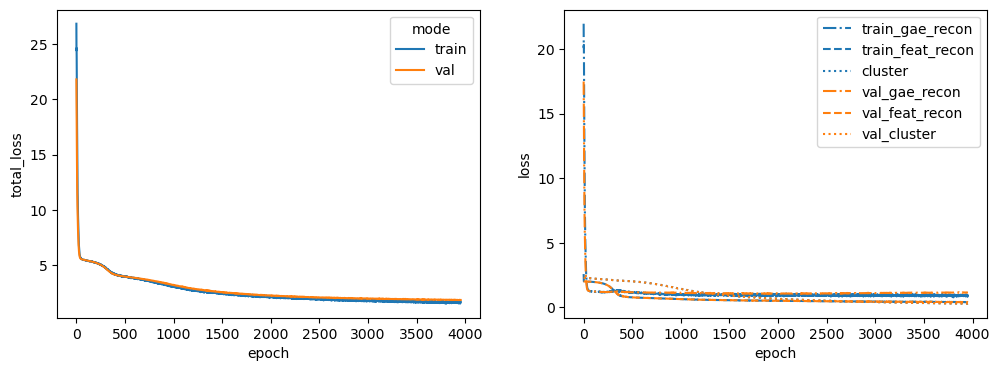

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


JUN
Latent dim: 1024


 65%|██████▌   | 6511/10000 [01:55<01:01, 56.36it/s]


Training stopped after 6512 epochs
Best model found at epoch 6410
------------------------------------------------------------
TEST AUC: 0.7788461538461537 AP: 0.8161511723303138
TRAIN loss: 1.2894513607025146
VAL loss: 1.7879477739334106
TEST loss: 1.8661930561065674
TEST AUC: 0.7788461538461537 	 AP: 0.8161511723303138


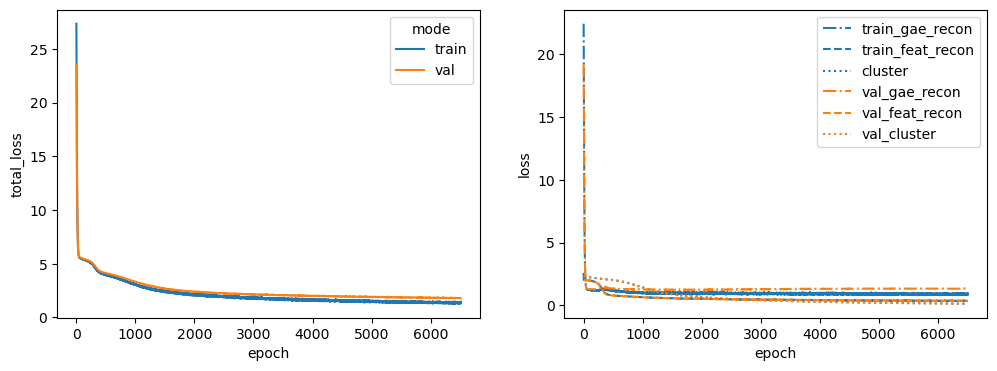

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


MAP2K3
Latent dim: 1024


 51%|█████     | 5094/10000 [01:31<01:27, 55.81it/s]


Training stopped after 5095 epochs
Best model found at epoch 4993
------------------------------------------------------------
TEST AUC: 0.7549001479289941 AP: 0.7494381593017385
TRAIN loss: 1.4397165775299072
VAL loss: 1.9032965898513794
TEST loss: 2.104949474334717
TEST AUC: 0.7549001479289941 	 AP: 0.7494381593017385


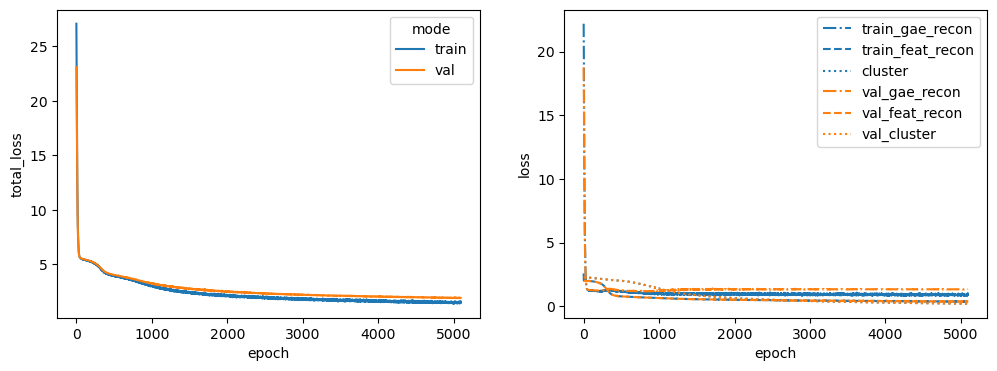

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


MAP3K2
Latent dim: 1024


 42%|████▏     | 4202/10000 [01:13<01:41, 57.22it/s]


Training stopped after 4203 epochs
Best model found at epoch 4101
------------------------------------------------------------
TEST AUC: 0.7929918639053255 AP: 0.8155404190154929
TRAIN loss: 1.611586332321167
VAL loss: 1.8108582496643066
TEST loss: 1.988762378692627
TEST AUC: 0.7929918639053255 	 AP: 0.8155404190154929


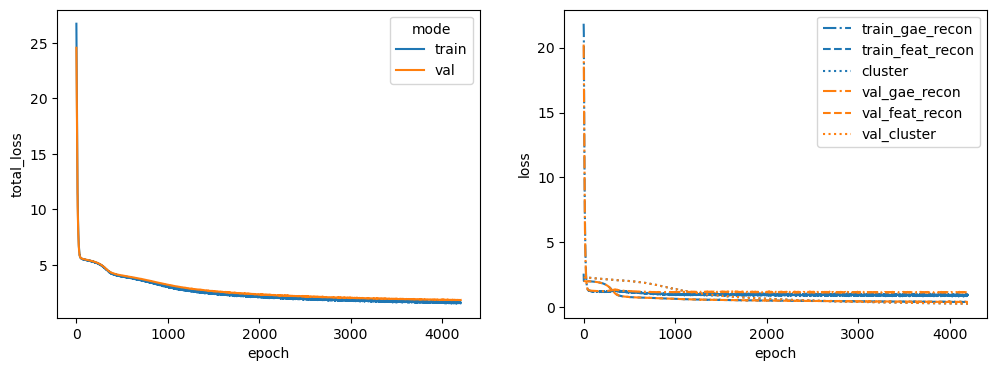

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


MAP3K5
Latent dim: 1024


 46%|████▌     | 4612/10000 [01:21<01:34, 56.88it/s]


Training stopped after 4613 epochs
Best model found at epoch 4511
------------------------------------------------------------
TEST AUC: 0.7570266272189349 AP: 0.753597469307467
TRAIN loss: 1.5940430164337158
VAL loss: 1.6744437217712402
TEST loss: 2.126004695892334
TEST AUC: 0.7570266272189349 	 AP: 0.753597469307467


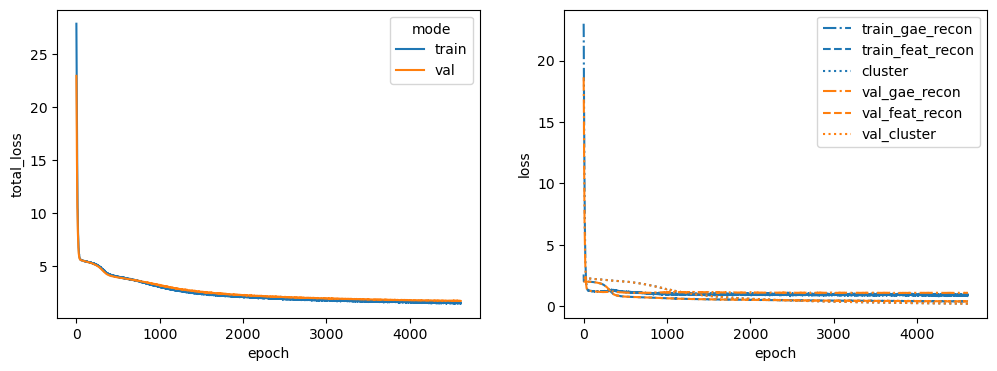

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


MAP3K9
Latent dim: 1024


 44%|████▍     | 4436/10000 [01:18<01:38, 56.28it/s]


Training stopped after 4437 epochs
Best model found at epoch 4335
------------------------------------------------------------
TEST AUC: 0.7514792899408284 AP: 0.7685160527531455
TRAIN loss: 1.6501086950302124
VAL loss: 2.0268566608428955
TEST loss: 2.1542484760284424
TEST AUC: 0.7514792899408284 	 AP: 0.7685160527531455


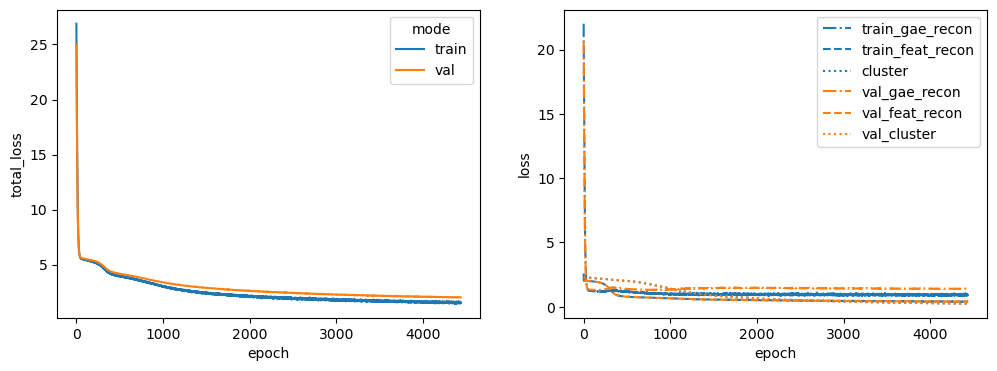

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


MAPK7
Latent dim: 1024


 58%|█████▊    | 5770/10000 [01:42<01:14, 56.48it/s]


Training stopped after 5771 epochs
Best model found at epoch 5669
------------------------------------------------------------
TEST AUC: 0.7823594674556213 AP: 0.8244821038395559
TRAIN loss: 1.450187087059021
VAL loss: 1.7605955600738525
TEST loss: 1.9091718196868896
TEST AUC: 0.7823594674556213 	 AP: 0.8244821038395559


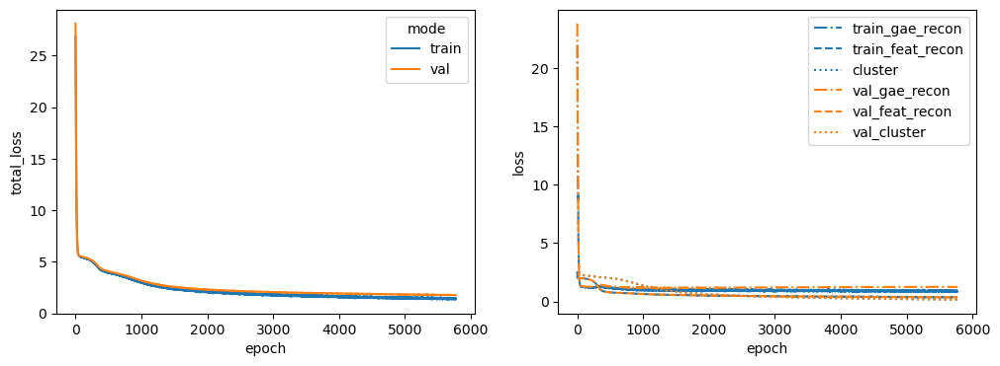

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


MOS
Latent dim: 1024


 32%|███▏      | 3214/10000 [00:55<01:56, 58.22it/s]


Training stopped after 3215 epochs
Best model found at epoch 3113
------------------------------------------------------------
TEST AUC: 0.7470414201183432 AP: 0.7877380320373397
TRAIN loss: 1.8446155786514282
VAL loss: 2.1423373222351074
TEST loss: 2.3266916275024414
TEST AUC: 0.7470414201183432 	 AP: 0.7877380320373397


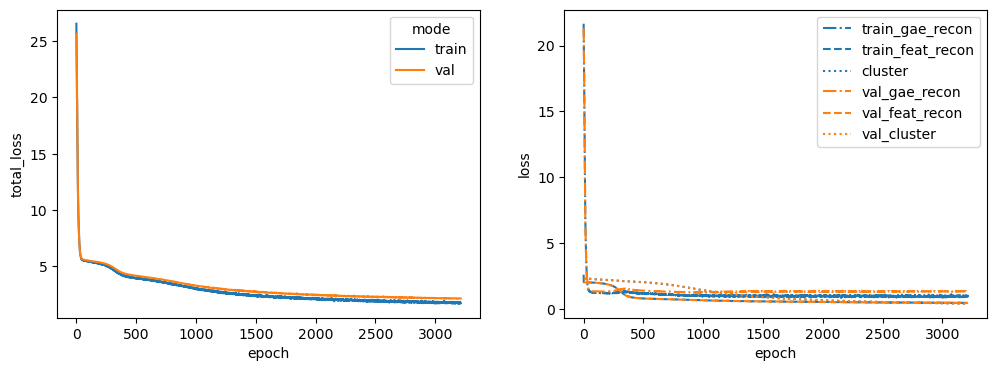

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


MYD88
Latent dim: 1024


 32%|███▏      | 3192/10000 [00:56<02:00, 56.57it/s]


Training stopped after 3193 epochs
Best model found at epoch 3091
------------------------------------------------------------
TEST AUC: 0.7960428994082841 AP: 0.8411489685340109
TRAIN loss: 1.754975438117981
VAL loss: 1.962890386581421
TEST loss: 2.152848958969116
TEST AUC: 0.7960428994082841 	 AP: 0.8411489685340109


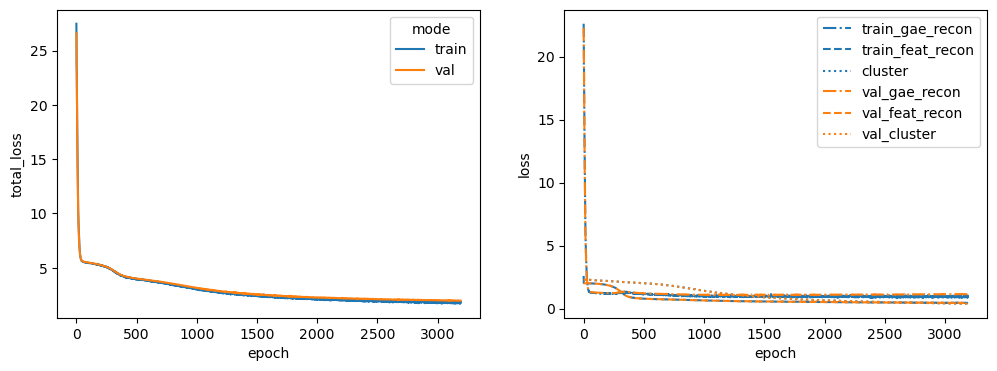

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


PIK3R2
Latent dim: 1024


 39%|███▊      | 3858/10000 [01:06<01:45, 58.07it/s]


Training stopped after 3859 epochs
Best model found at epoch 3757
------------------------------------------------------------
TEST AUC: 0.7751479289940829 AP: 0.7857734317885903
TRAIN loss: 1.6295173168182373
VAL loss: 2.1355133056640625
TEST loss: 2.1356513500213623
TEST AUC: 0.7751479289940829 	 AP: 0.7857734317885903


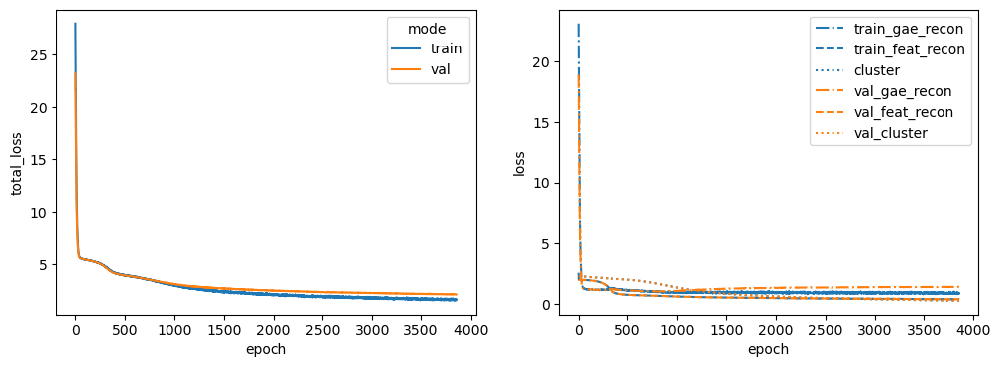

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


PRKACA
Latent dim: 1024


 40%|████      | 4002/10000 [01:08<01:43, 58.08it/s]


Training stopped after 4003 epochs
Best model found at epoch 3901
------------------------------------------------------------
TEST AUC: 0.7624815088757396 AP: 0.7931415964590048
TRAIN loss: 1.5857594013214111
VAL loss: 1.9896821975708008
TEST loss: 2.1413018703460693
TEST AUC: 0.7624815088757396 	 AP: 0.7931415964590048


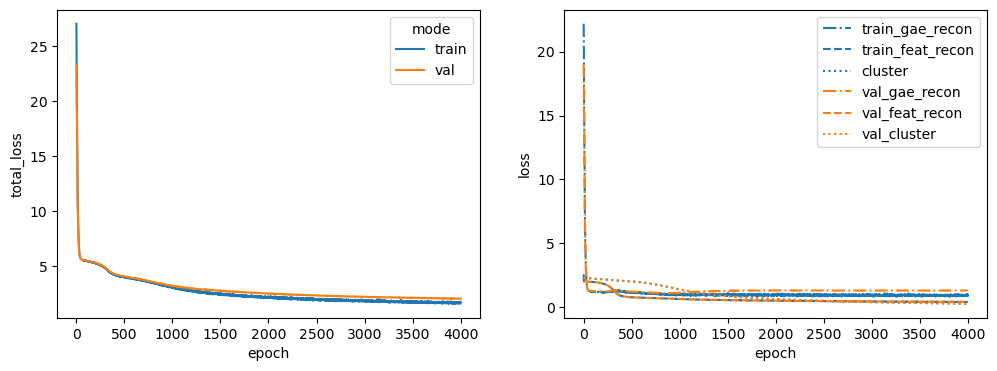

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


PRKCE
Latent dim: 1024


 49%|████▊     | 4853/10000 [01:24<01:29, 57.43it/s]


Training stopped after 4854 epochs
Best model found at epoch 4752
------------------------------------------------------------
TEST AUC: 0.77708949704142 AP: 0.7912878508462198
TRAIN loss: 1.5073930025100708
VAL loss: 1.877306342124939
TEST loss: 2.0130324363708496
TEST AUC: 0.77708949704142 	 AP: 0.7912878508462198


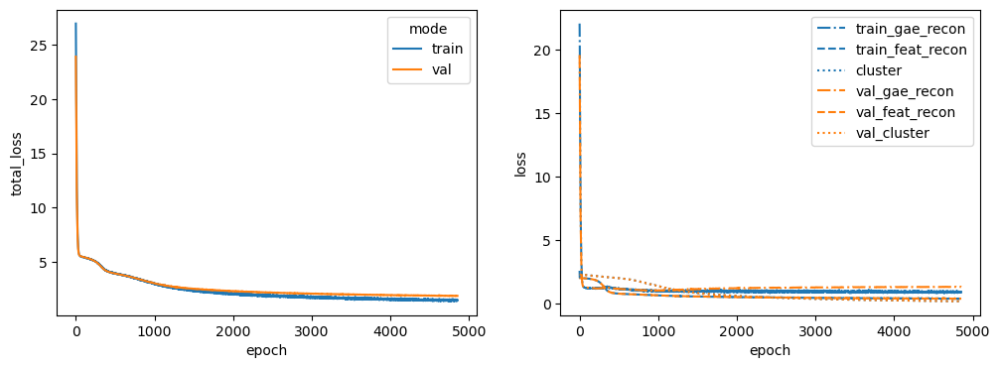

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


RAF1
Latent dim: 1024


 36%|███▌      | 3590/10000 [01:03<01:53, 56.68it/s]


Training stopped after 3591 epochs
Best model found at epoch 3489
------------------------------------------------------------
TEST AUC: 0.7638683431952663 AP: 0.7828125584334357
TRAIN loss: 1.665744662284851
VAL loss: 1.9706730842590332
TEST loss: 2.2219700813293457
TEST AUC: 0.7638683431952663 	 AP: 0.7828125584334357


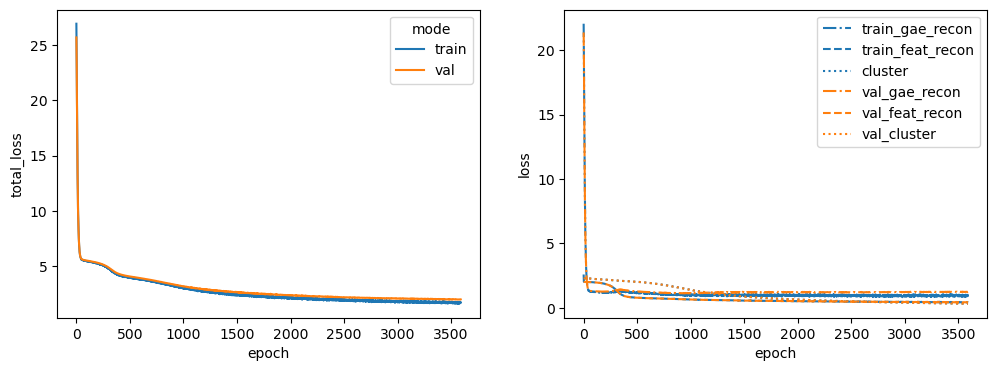

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


RELB
Latent dim: 1024


 55%|█████▍    | 5492/10000 [01:36<01:18, 57.16it/s]


Training stopped after 5493 epochs
Best model found at epoch 5391
------------------------------------------------------------
TEST AUC: 0.7950258875739645 AP: 0.8083876369913053
TRAIN loss: 1.4582511186599731
VAL loss: 1.7843691110610962
TEST loss: 1.9166592359542847
TEST AUC: 0.7950258875739645 	 AP: 0.8083876369913053


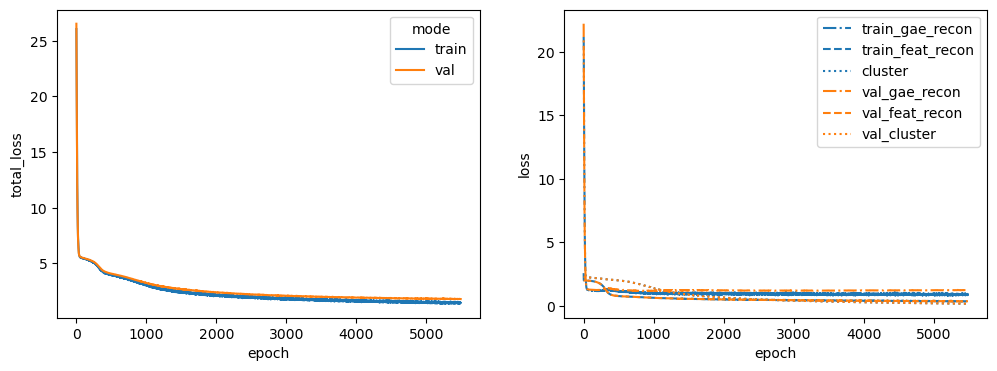

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


RHOA
Latent dim: 1024


 50%|████▉     | 4983/10000 [01:27<01:27, 57.14it/s]


Training stopped after 4984 epochs
Best model found at epoch 4882
------------------------------------------------------------
TEST AUC: 0.7580436390532544 AP: 0.7618348617814171
TRAIN loss: 1.5002530813217163
VAL loss: 1.857327938079834
TEST loss: 2.0711700916290283
TEST AUC: 0.7580436390532544 	 AP: 0.7618348617814171


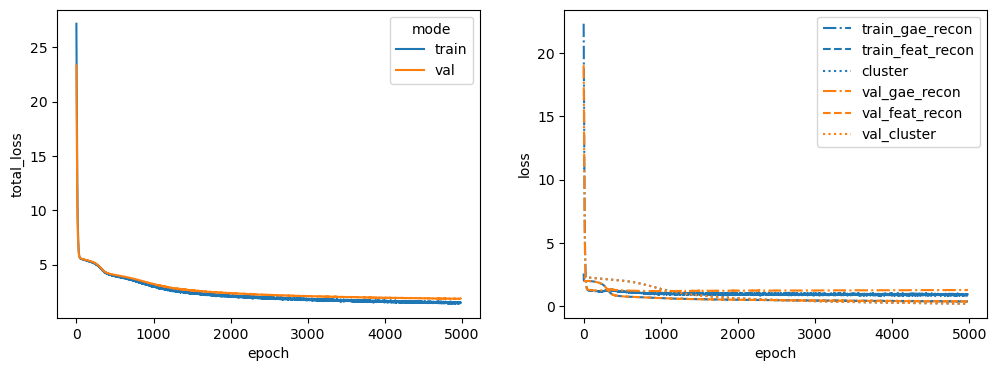

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


SMAD4
Latent dim: 1024


 32%|███▏      | 3190/10000 [00:55<01:58, 57.45it/s]


Training stopped after 3191 epochs
Best model found at epoch 3089
------------------------------------------------------------
TEST AUC: 0.7482433431952662 AP: 0.7618454467684471
TRAIN loss: 1.7182068824768066
VAL loss: 1.9079338312149048
TEST loss: 2.3585469722747803
TEST AUC: 0.7482433431952662 	 AP: 0.7618454467684471


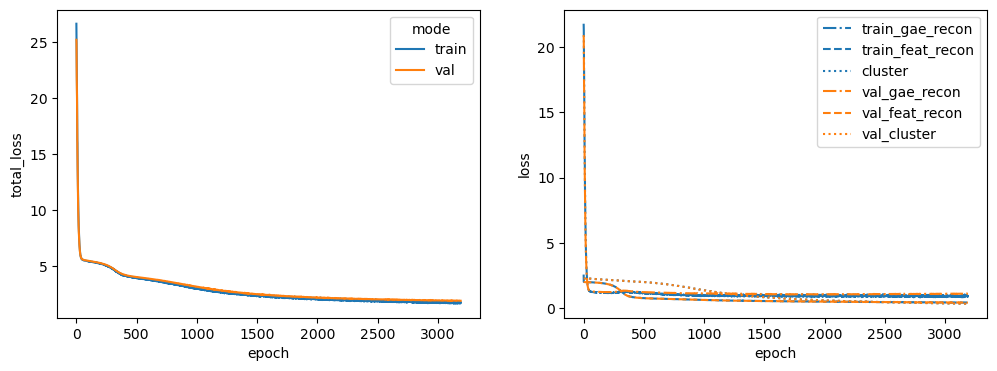

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


SMO
Latent dim: 1024


 36%|███▌      | 3600/10000 [01:02<01:51, 57.19it/s]


Training stopped after 3601 epochs
Best model found at epoch 3499
------------------------------------------------------------
TEST AUC: 0.7603550295857987 AP: 0.7589735422607529
TRAIN loss: 1.6557555198669434
VAL loss: 2.043055534362793
TEST loss: 2.275784969329834
TEST AUC: 0.7603550295857987 	 AP: 0.7589735422607529


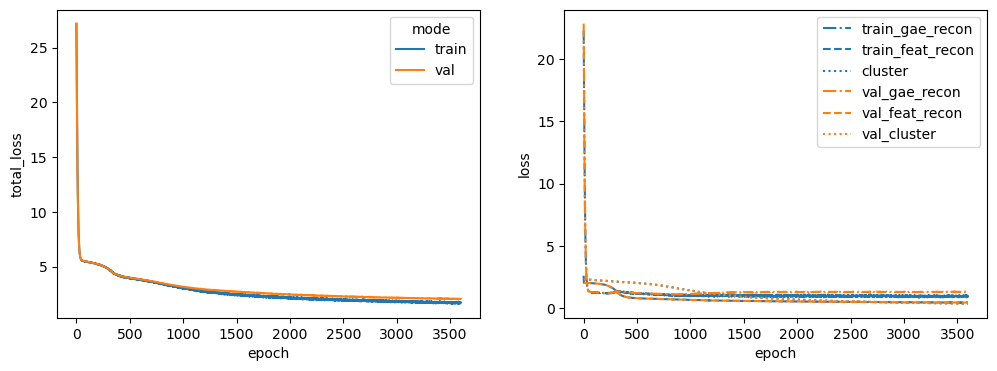

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


SRC
Latent dim: 1024


 40%|███▉      | 3955/10000 [01:08<01:44, 58.01it/s]


Training stopped after 3956 epochs
Best model found at epoch 3854
------------------------------------------------------------
TEST AUC: 0.7350221893491123 AP: 0.7442712497969446
TRAIN loss: 1.6720374822616577
VAL loss: 1.984474778175354
TEST loss: 2.271890640258789
TEST AUC: 0.7350221893491123 	 AP: 0.7442712497969446


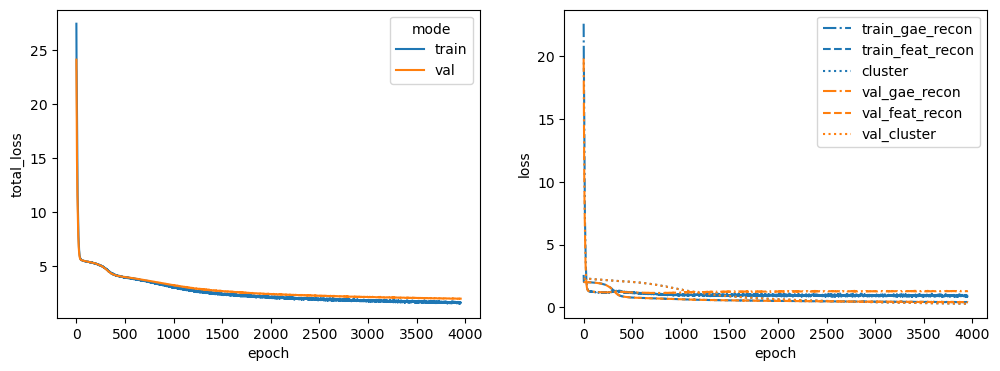

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


SREBF1
Latent dim: 1024


 33%|███▎      | 3256/10000 [00:57<01:58, 56.68it/s]


Training stopped after 3257 epochs
Best model found at epoch 3155
------------------------------------------------------------
TEST AUC: 0.7595229289940828 AP: 0.7558403982918066
TRAIN loss: 1.76455819606781
VAL loss: 1.9235115051269531
TEST loss: 2.4137606620788574
TEST AUC: 0.7595229289940828 	 AP: 0.7558403982918066


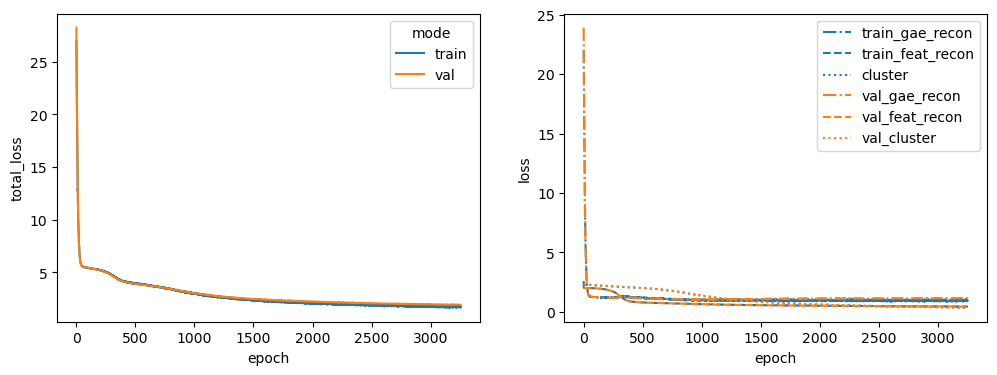

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


TRAF2
Latent dim: 1024


 54%|█████▍    | 5380/10000 [01:34<01:20, 57.13it/s]


Training stopped after 5381 epochs
Best model found at epoch 5279
------------------------------------------------------------
TEST AUC: 0.7696930473372781 AP: 0.7735815257969572
TRAIN loss: 1.4352033138275146
VAL loss: 1.820763349533081
TEST loss: 1.9884564876556396
TEST AUC: 0.7696930473372781 	 AP: 0.7735815257969572


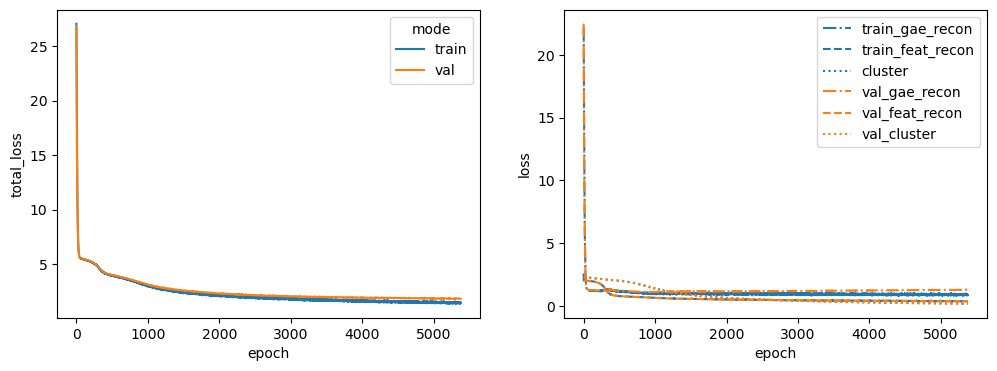

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


TSC2
Latent dim: 1024


 51%|█████▏    | 5131/10000 [01:27<01:23, 58.40it/s]


Training stopped after 5132 epochs
Best model found at epoch 5030
------------------------------------------------------------
TEST AUC: 0.7925295857988165 AP: 0.8203819576815621
TRAIN loss: 1.4609678983688354
VAL loss: 1.8373005390167236
TEST loss: 1.8792840242385864
TEST AUC: 0.7925295857988165 	 AP: 0.8203819576815621


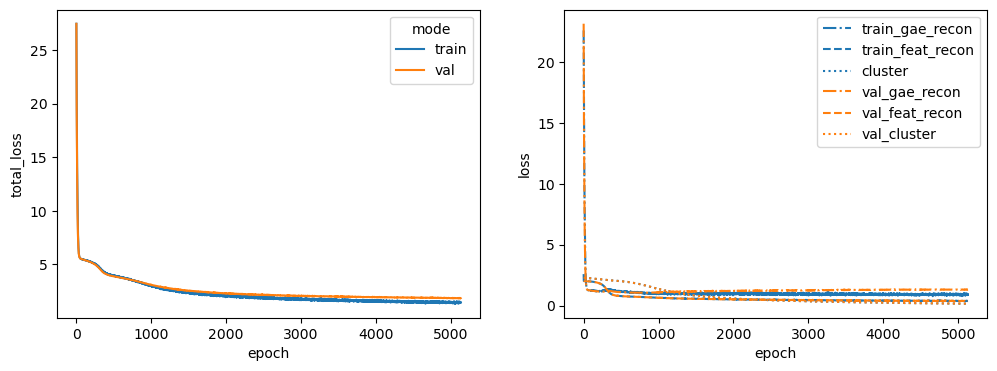

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


WWTR1
Latent dim: 1024


 32%|███▏      | 3233/10000 [00:56<01:57, 57.72it/s]


Training stopped after 3234 epochs
Best model found at epoch 3132
------------------------------------------------------------
TEST AUC: 0.7623890532544378 AP: 0.8082382458334885
TRAIN loss: 1.7581969499588013
VAL loss: 2.2983460426330566
TEST loss: 2.2712669372558594
TEST AUC: 0.7623890532544378 	 AP: 0.8082382458334885


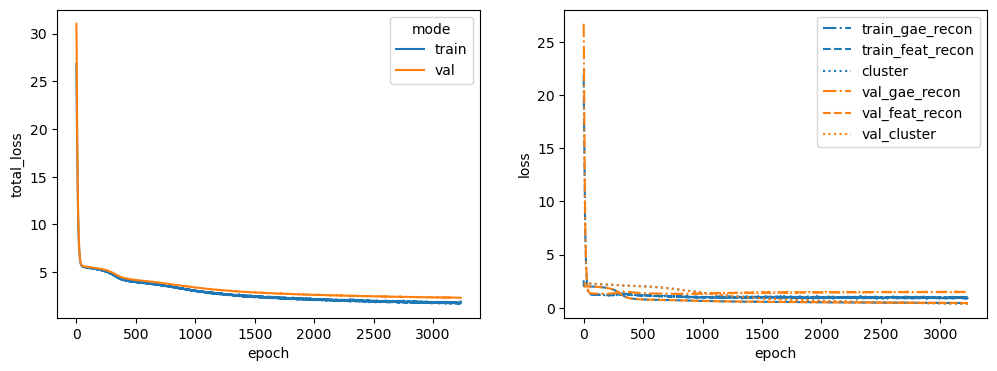

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


<IPython.core.display.Javascript object>

In [29]:
for cluster_opt in cluster_opts:

    graph_dict = {}
    for target in oe_targets:
        graph = spearman_interactome.copy()
        phy_clusters = phy_clusters_dict[target]
        phy_full_clusters = phy_full_clusters_dict[target]
        for node in graph.nodes(data=True):
            node[-1]["sc_gex"] = np.array(gex_data_z.loc[:, node[0]])
            node[-1]["sc_gex"] = node[-1]["sc_gex"]
            if cluster_opt == "cmap_full":
                if node[0] in cmap_clusters.index:
                    node[-1]["label"] = cmap_clusters.loc[node[0], "cluster"]
                    node[-1]["label_mask"] = True
                else:
                    node[-1]["label"] = -1
                    node[-1]["label_mask"] = False

            if cluster_opt == "cmap":
                if node[0] in cmap_clusters.index and node[0] != target:
                    node[-1]["label"] = cmap_clusters.loc[node[0], "cluster"]
                    node[-1]["label_mask"] = True
                else:
                    node[-1]["label"] = -1
                    node[-1]["label_mask"] = False

            if cluster_opt == "physical":
                if node[0] in phy_clusters.index and node[0] != target:
                    node[-1]["label"] = cmap_clusters.loc[node[0], "cluster"]
                    node[-1]["label_mask"] = True
                else:
                    node[-1]["label"] = -1
                    node[-1]["label_mask"] = False

            if cluster_opt == "physical_full":
                if node[0] in phy_full_clusters.index:
                    node[-1]["label"] = cmap_clusters.loc[node[0], "cluster"]
                    node[-1]["label_mask"] = True
                else:
                    node[-1]["label"] = -1
                    node[-1]["label_mask"] = False

            node[-1]["name"] = node[0]
            node[-1]["spec_target"] = node[0] in oe_targets

            gene_memberships = []
            for geneset in hallmark_geneset_dict.values():
                if node[0] in geneset:
                    gene_memberships.append(1.0)
                else:
                    gene_memberships.append(0.0)

            node[-1]["hallmark"] = np.array(gene_memberships)
            node[-1]["sc_gex_hallmark"] = np.concatenate(
                [node[-1]["sc_gex"], node[-1]["hallmark"]]
            )
        graph_dict[target] = graph

    for graph_opt in graph_opts:
        for alpha_beta_gamma_opt in alpha_beta_gamma_opts:

            for oe_target in oe_targets:
                print(oe_target)
                phy_clusters = phy_full_clusters_dict[oe_target].copy()
                if cluster_opt in ["cmap", "physical"]:
                    phy_clusters.loc[oe_target] = -1
                lut = dict(
                    zip(
                        list(np.unique(phy_clusters)),
                        [
                            "tab:blue",
                            "tab:red",
                            "tab:green",
                            "gold",
                            "tab:orange",
                            "tab:cyan",
                            "tab:purple",
                            "tab:pink",
                            "tab:olive",
                            "olivedrab",
                            "tab:brown",
                        ],
                    )
                )
                phy_clusters.loc[:, "color"] = phy_clusters.loc[:, "cluster"].map(lut)
                spearman_interactome = graph_dict[oe_target]

                device = torch.device("cpu")

                graph_data = from_networkx(spearman_interactome)
                graph_data.id = torch.FloatTensor(
                    np.identity(len(spearman_interactome))
                )
                graph_data = T.ToDevice(
                    device,
                    attrs=[
                        "id",
                        "sc_gex",
                        "label",
                        "label_mask",
                        "hallmark",
                        "sc_gex_hallmark",
                    ],
                )(graph_data)

                input_dim = 1176
                latent_dim = 1024

                class_weights = None

                gae = GAE(
                    GCNEncoder(
                        in_channels=input_dim, out_channels=latent_dim, hidden_dim=1024
                    )
                )
                feature_decoder = FeatureDecoder(
                    latent_dim=latent_dim,
                    hidden_dims=[1024],
                    output_dim=input_dim,
                    loss_fct=torch.nn.L1Loss(),
                )
                latent_classifier = LatentClassifier(
                    latent_dim=latent_dim,
                    hidden_dims=None,
                    n_classes=10,
                    loss_fct=None,
                    class_weights=class_weights,
                )

                seeds = [1234]
                alpha = alpha_beta_gamma_opt[0]
                beta = alpha_beta_gamma_opt[1]
                gamma = alpha_beta_gamma_opt[2]
                use_graph = graph_opt

                node_feature_key = "sc_gex_hallmark"
                edge_weight_key = None
                if alpha > 0:
                    n_epochs = 10000
                else:
                    n_epochs = 4000
                print("Latent dim: {}".format(1024))
                latents_dict, loss_hist_dict = get_gae_latents_for_seed(
                    graph_data=graph_data,
                    gae=gae,
                    seeds=seeds,
                    node_feature_key=node_feature_key,
                    edge_weight_key=edge_weight_key,
                    feature_decoder=feature_decoder,
                    latent_classifier=latent_classifier,
                    n_epochs=n_epochs,
                    lr=0.00001,
                    split_type="link",
                    alpha=alpha,
                    beta=beta,
                    gamma=gamma,
                    plot_loss=True,
                    early_stopping=100,
                    use_full_graph=use_graph == "full_graph",
                    neg_edge_ratio=1.0,
                )

                output_dir = "../../../data/experiments/image_embeddings/specificity_target_emb_loto/embeddings/{}/pcst_confidence_0598_hub_999_pruned".format(
                    oe_target
                )

                output_dir = os.path.join(
                    output_dir,
                    "gae_exp_a{}_b{}_g{}_{}_{}".format(
                        alpha, beta, gamma, use_graph, cluster_opt
                    ),
                )
                os.makedirs(output_dir, exist_ok=True)

                latents = latents_dict[1234]
                node_names = getattr(graph_data, "name")
                st_memberships = getattr(graph_data, "spec_target")
                latents = pd.DataFrame(latents, index=node_names)

                embs = TSNE(
                    random_state=1234,
                    perplexity=int(np.sqrt(len(latents))) + 1,
                    init="pca",
                    learning_rate="auto",
                ).fit_transform(latents)
                embs = pd.DataFrame(
                    embs, columns=["tsne_0", "tsne_1"], index=node_names
                )
                embs["spec_target"] = st_memberships.cpu().numpy()

                fig, ax = plt.subplots(figsize=[20, 10])
                ax = sns.scatterplot(
                    data=embs, x="tsne_0", y="tsne_1", cmap="viridis", hue="spec_target"
                )
                label_point(
                    np.array(embs.loc[:, "tsne_0"]),
                    np.array(embs.loc[:, "tsne_1"]),
                    np.array(embs.index).astype("str"),
                    ax=ax,
                )
                ax.set_title("Visualization of the inferred embedding space")
                plt.savefig(
                    os.path.join(
                        output_dir,
                        "tsne_embs.png".format(alpha, beta, gamma, use_graph),
                    ),
                    bbox_inches="tight",
                )
                plt.close()

                ax = sns.clustermap(
                    latents.loc[set(oe_targets).intersection(latents.index)],
                    figsize=[6, 12],
                    metric="cosine",
                    method="complete",
                    cmap="seismic",
                    row_colors=np.array(
                        phy_clusters.loc[
                            set(oe_targets).intersection(latents.index), "color"
                        ]
                    ).ravel(),
                )
                ax.ax_heatmap.set_yticklabels(
                    ax.ax_heatmap.get_ymajorticklabels(),
                    fontsize=15,
                    fontweight="bold",
                )
                plt.savefig(
                    os.path.join(
                        output_dir,
                        "reg_clustering.png".format(alpha, beta, gamma, use_graph),
                    ),
                    bbox_inches="tight",
                )
                plt.close()

                latents.to_csv(
                    os.path.join(
                        output_dir,
                        "node_embs.csv".format(alpha, beta, gamma, use_graph),
                    )
                )

In [30]:
cluster_opts = ["physical"]
alpha_beta_gamma_opts = [[1, 0, 1], [1, 0, 2], [1, 0, 5]]
graph_opts = ["full_graph"]

<IPython.core.display.Javascript object>

AKT1S1
Latent dim: 1024


 59%|█████▉    | 5888/10000 [01:42<01:11, 57.41it/s]


Training stopped after 5889 epochs
Best model found at epoch 5787
------------------------------------------------------------
TEST AUC: 0.9502588757396451 AP: 0.9397332956902279
TRAIN loss: 1.0683733224868774
VAL loss: 0.8624736666679382
TEST loss: 1.0696568489074707
TEST AUC: 0.9502588757396451 	 AP: 0.9397332956902279


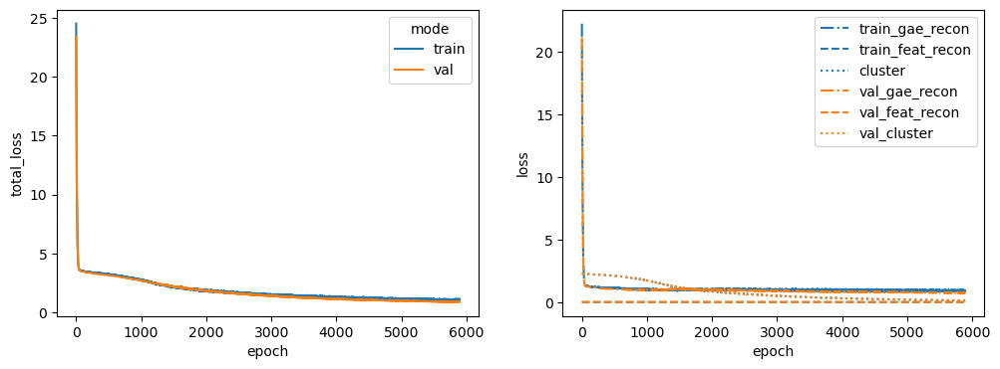

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


ATF4
Latent dim: 1024


 61%|██████    | 6062/10000 [01:45<01:08, 57.53it/s]


Training stopped after 6063 epochs
Best model found at epoch 5961
------------------------------------------------------------
TEST AUC: 0.9599667159763313 AP: 0.9588758490094537
TRAIN loss: 1.0271413326263428
VAL loss: 0.9057612419128418
TEST loss: 0.9695296287536621
TEST AUC: 0.9599667159763313 	 AP: 0.9588758490094537


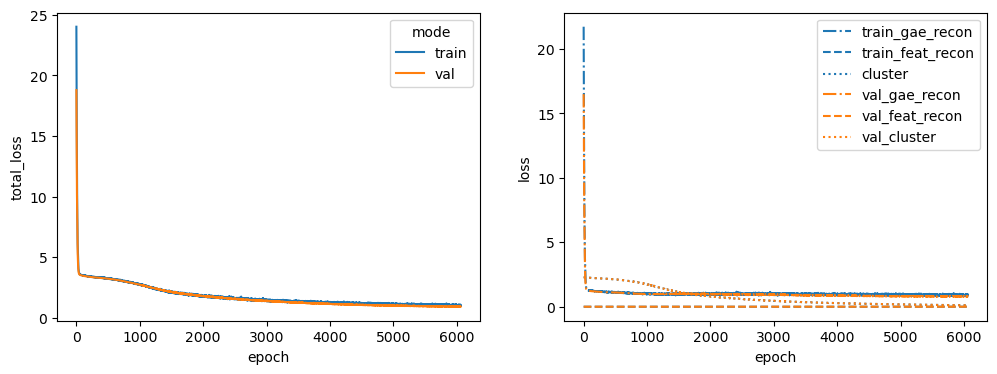

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


BAX
Latent dim: 1024


 68%|██████▊   | 6817/10000 [01:57<00:54, 58.02it/s]


Training stopped after 6818 epochs
Best model found at epoch 6716
------------------------------------------------------------
TEST AUC: 0.9459134615384616 AP: 0.9428671863261597
TRAIN loss: 0.9828907251358032
VAL loss: 0.7574712634086609
TEST loss: 1.0221271514892578
TEST AUC: 0.9459134615384616 	 AP: 0.9428671863261597


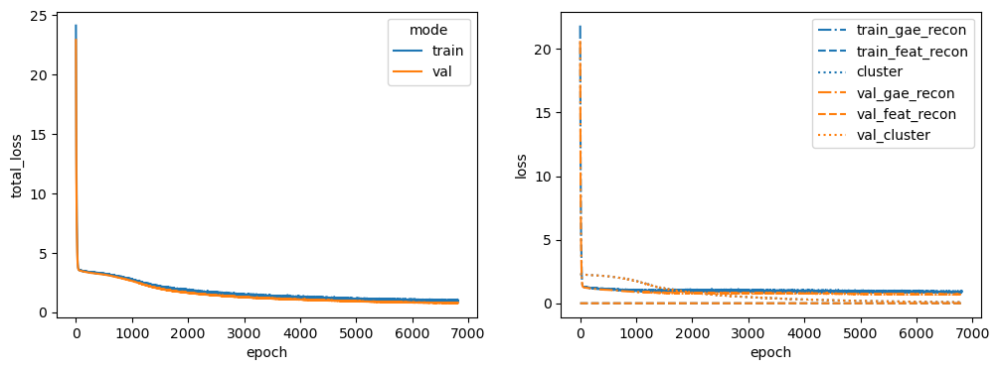

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


BCL2L11
Latent dim: 1024


 47%|████▋     | 4662/10000 [01:21<01:33, 57.04it/s]


Training stopped after 4663 epochs
Best model found at epoch 4561
------------------------------------------------------------
TEST AUC: 0.939164201183432 AP: 0.92237311940636
TRAIN loss: 1.099287748336792
VAL loss: 1.1131527423858643
TEST loss: 1.1542093753814697
TEST AUC: 0.939164201183432 	 AP: 0.92237311940636


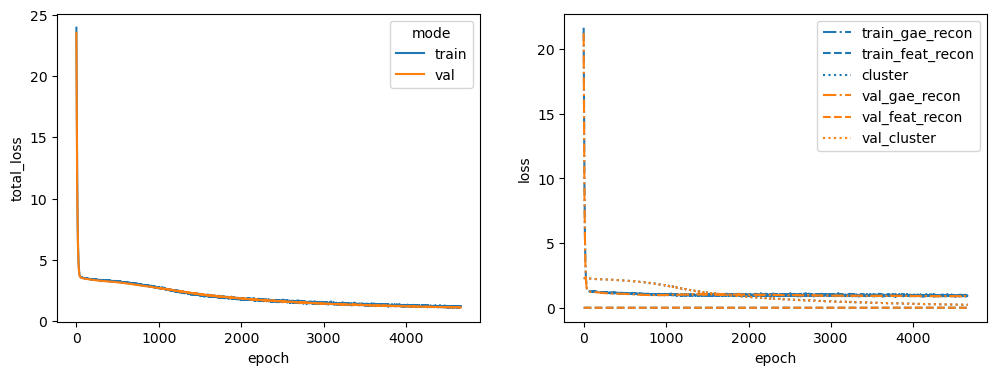

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


BRAF
Latent dim: 1024


 43%|████▎     | 4315/10000 [01:15<01:39, 57.37it/s]


Training stopped after 4316 epochs
Best model found at epoch 4214
------------------------------------------------------------
TEST AUC: 0.9324149408284025 AP: 0.9049062085271261
TRAIN loss: 1.1690776348114014
VAL loss: 1.117830753326416
TEST loss: 1.1996111869812012
TEST AUC: 0.9324149408284025 	 AP: 0.9049062085271261


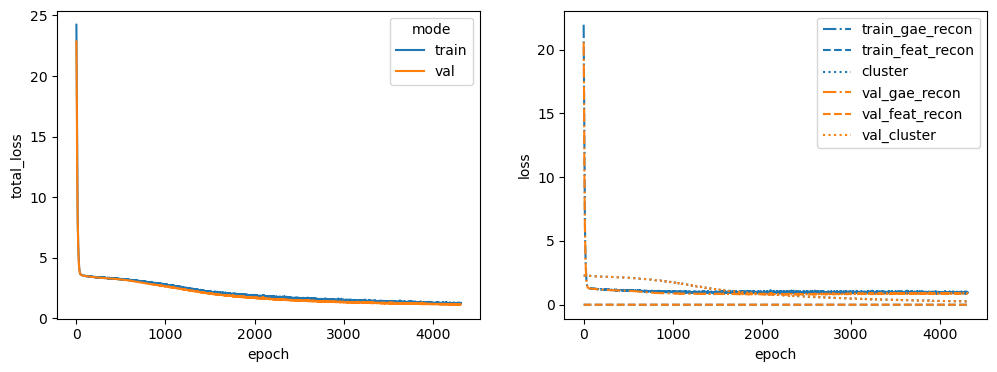

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


CASP8
Latent dim: 1024


 43%|████▎     | 4260/10000 [01:13<01:39, 57.64it/s]


Training stopped after 4261 epochs
Best model found at epoch 4159
------------------------------------------------------------
TEST AUC: 0.9163276627218935 AP: 0.8661646568677669
TRAIN loss: 1.298160433769226
VAL loss: 1.4749736785888672
TEST loss: 1.364964485168457
TEST AUC: 0.9163276627218935 	 AP: 0.8661646568677669


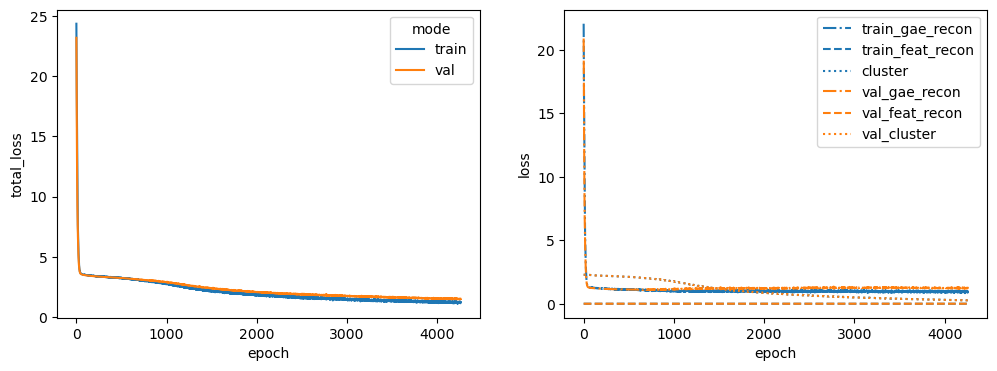

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


CDC42
Latent dim: 1024


 47%|████▋     | 4696/10000 [01:21<01:32, 57.45it/s]


Training stopped after 4697 epochs
Best model found at epoch 4595
------------------------------------------------------------
TEST AUC: 0.9158653846153846 AP: 0.8874821721926766
TRAIN loss: 1.1537272930145264
VAL loss: 1.0693491697311401
TEST loss: 1.2585266828536987
TEST AUC: 0.9158653846153846 	 AP: 0.8874821721926766


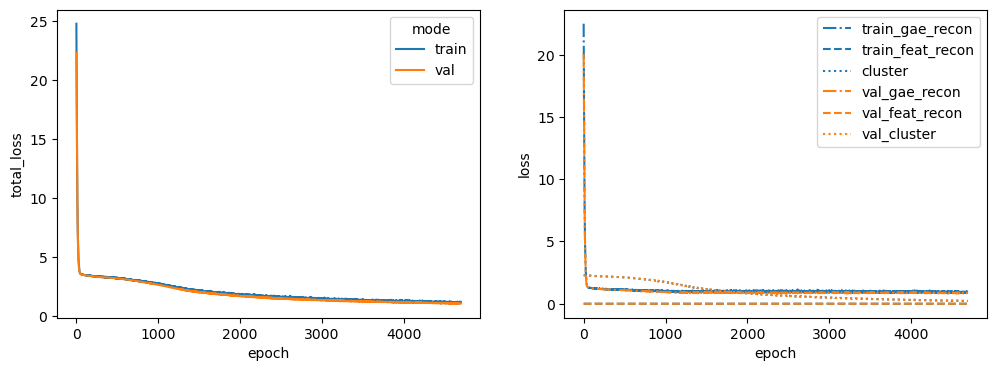

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


CDKN1A
Latent dim: 1024


 66%|██████▌   | 6559/10000 [01:54<01:00, 57.08it/s]


Training stopped after 6560 epochs
Best model found at epoch 6458
------------------------------------------------------------
TEST AUC: 0.9446190828402368 AP: 0.9399686230156594
TRAIN loss: 1.0231882333755493
VAL loss: 0.917151689529419
TEST loss: 0.9939358234405518
TEST AUC: 0.9446190828402368 	 AP: 0.9399686230156594


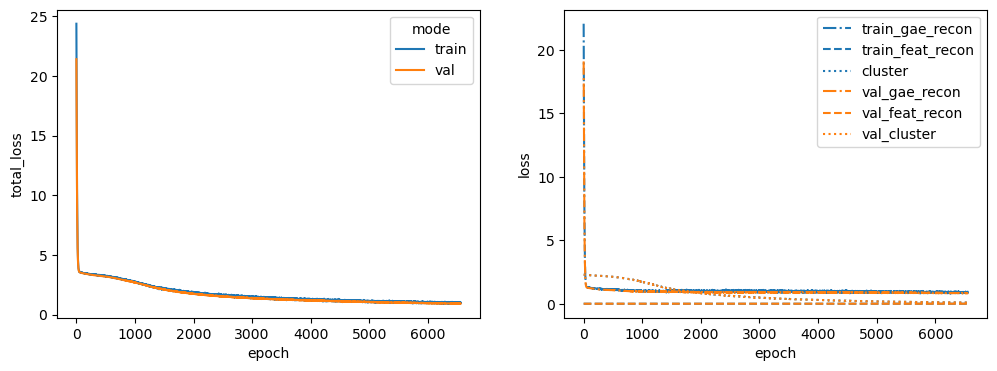

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


CEBPA
Latent dim: 1024


 61%|██████    | 6051/10000 [01:45<01:08, 57.26it/s]


Training stopped after 6052 epochs
Best model found at epoch 5950
------------------------------------------------------------
TEST AUC: 0.9389792899408285 AP: 0.9323532585585761
TRAIN loss: 1.0012885332107544
VAL loss: 1.054701805114746
TEST loss: 1.0733349323272705
TEST AUC: 0.9389792899408285 	 AP: 0.9323532585585761


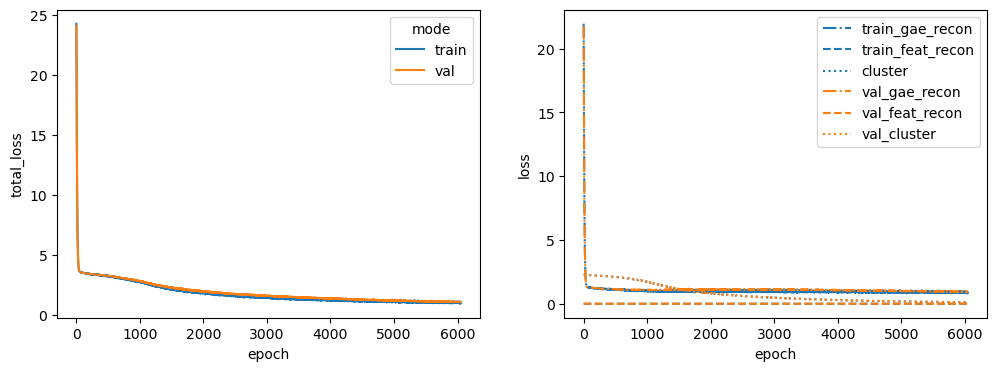

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


CREB1
Latent dim: 1024


 51%|█████     | 5114/10000 [01:27<01:23, 58.35it/s]


Training stopped after 5115 epochs
Best model found at epoch 5013
------------------------------------------------------------
TEST AUC: 0.8965421597633136 AP: 0.857721198375972
TRAIN loss: 1.1601519584655762
VAL loss: 0.9678752422332764
TEST loss: 1.3282142877578735
TEST AUC: 0.8965421597633136 	 AP: 0.857721198375972


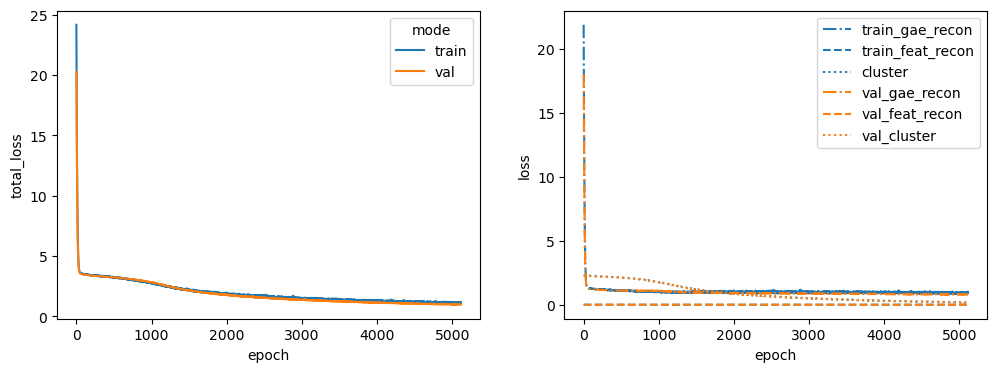

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


CXXC4
Latent dim: 1024


 60%|██████    | 6019/10000 [01:44<01:09, 57.54it/s]


Training stopped after 6020 epochs
Best model found at epoch 5918
------------------------------------------------------------
TEST AUC: 0.9375 AP: 0.917359870156968
TRAIN loss: 1.0693414211273193
VAL loss: 0.7777767777442932
TEST loss: 1.074859857559204
TEST AUC: 0.9375 	 AP: 0.917359870156968


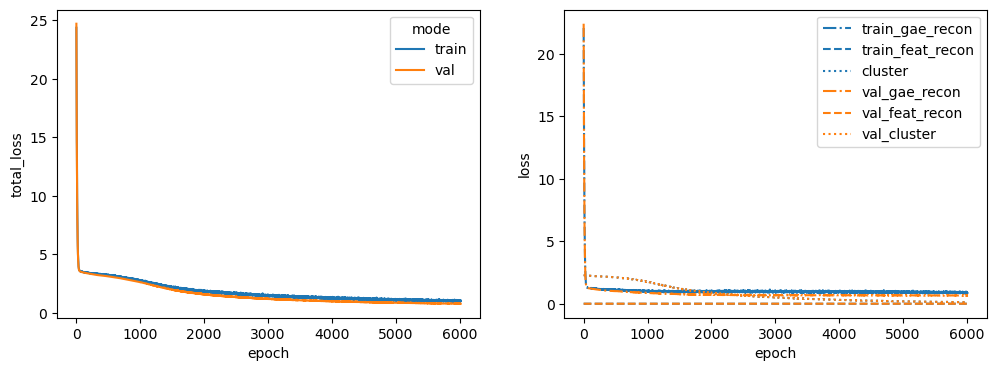

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


DIABLO
Latent dim: 1024


 71%|███████   | 7092/10000 [02:05<00:51, 56.41it/s]


Training stopped after 7093 epochs
Best model found at epoch 6991
------------------------------------------------------------
TEST AUC: 0.9545118343195266 AP: 0.9543361610801449
TRAIN loss: 0.9363363981246948
VAL loss: 0.8328731656074524
TEST loss: 1.0113714933395386
TEST AUC: 0.9545118343195266 	 AP: 0.9543361610801449


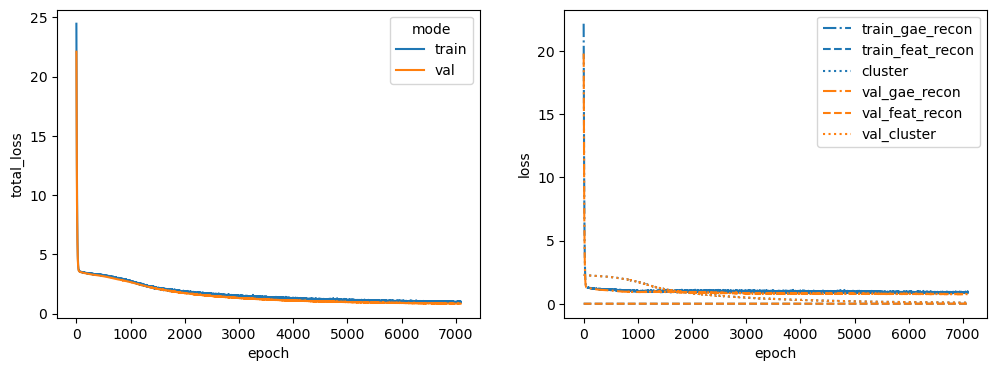

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


E2F1
Latent dim: 1024


 47%|████▋     | 4700/10000 [01:22<01:32, 57.24it/s]


Training stopped after 4701 epochs
Best model found at epoch 4599
------------------------------------------------------------
TEST AUC: 0.9330621301775148 AP: 0.9180358802972121
TRAIN loss: 1.1874316930770874
VAL loss: 1.3765223026275635
TEST loss: 1.2043945789337158
TEST AUC: 0.9330621301775148 	 AP: 0.9180358802972121


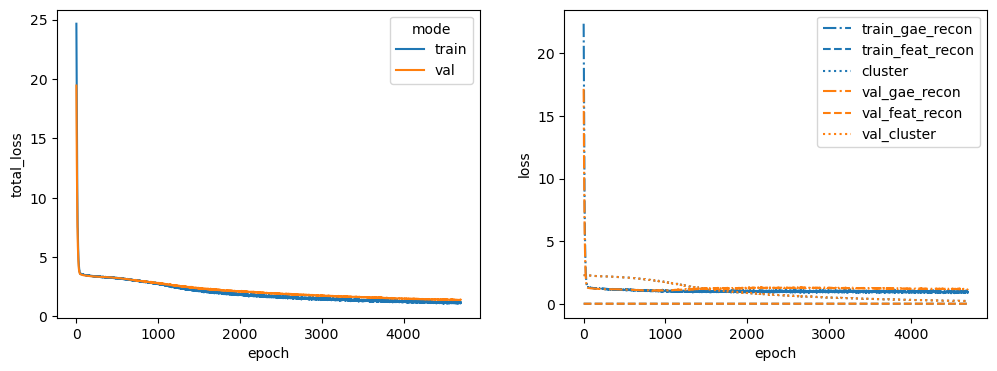

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


ELK1
Latent dim: 1024


 69%|██████▊   | 6862/10000 [01:59<00:54, 57.46it/s]


Training stopped after 6863 epochs
Best model found at epoch 6761
------------------------------------------------------------
TEST AUC: 0.9587647928994083 AP: 0.9502281673448016
TRAIN loss: 1.00680673122406
VAL loss: 1.0030711889266968
TEST loss: 0.9850476384162903
TEST AUC: 0.9587647928994083 	 AP: 0.9502281673448016


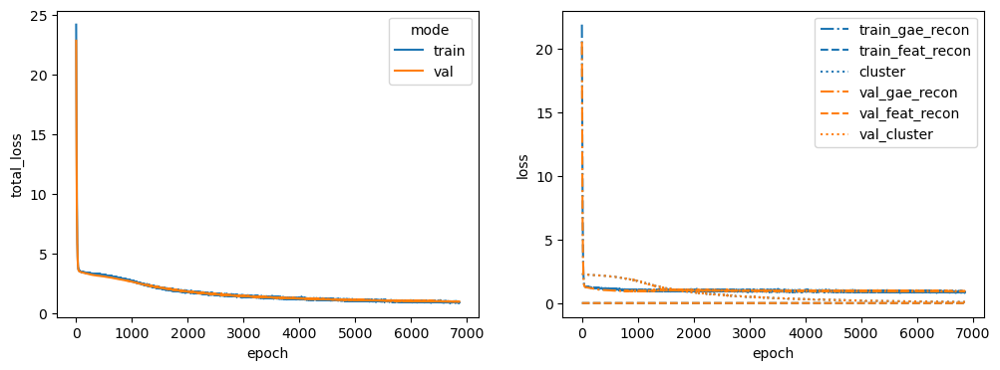

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


EMPTY
Latent dim: 1024


 60%|█████▉    | 5972/10000 [01:43<01:10, 57.47it/s]


Training stopped after 5973 epochs
Best model found at epoch 5871
------------------------------------------------------------
TEST AUC: 0.9674556213017752 AP: 0.9704215785511824
TRAIN loss: 1.0001914501190186
VAL loss: 0.9913498759269714
TEST loss: 0.9930799603462219
TEST AUC: 0.9674556213017752 	 AP: 0.9704215785511824


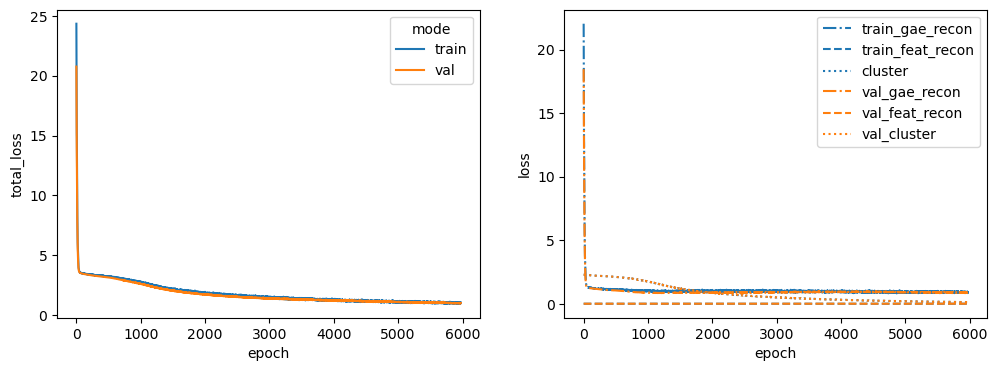

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


ERG
Latent dim: 1024


 63%|██████▎   | 6275/10000 [01:49<01:04, 57.46it/s]


Training stopped after 6276 epochs
Best model found at epoch 6174
------------------------------------------------------------
TEST AUC: 0.9252958579881657 AP: 0.9053773127935422
TRAIN loss: 1.013694167137146
VAL loss: 1.0660613775253296
TEST loss: 1.158542275428772
TEST AUC: 0.9252958579881657 	 AP: 0.9053773127935422


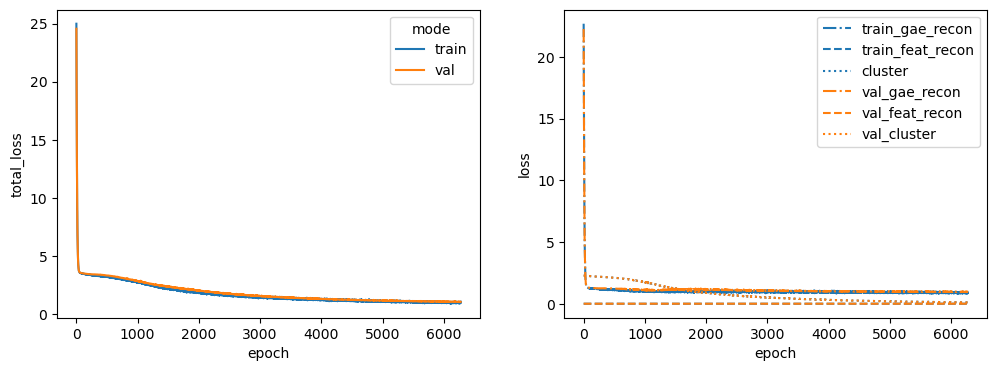

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


FGFR3
Latent dim: 1024


 65%|██████▌   | 6531/10000 [01:54<01:00, 56.87it/s]


Training stopped after 6532 epochs
Best model found at epoch 6430
------------------------------------------------------------
TEST AUC: 0.9380547337278108 AP: 0.9418896822068368
TRAIN loss: 0.986203670501709
VAL loss: 0.8712975382804871
TEST loss: 1.014370322227478
TEST AUC: 0.9380547337278108 	 AP: 0.9418896822068368


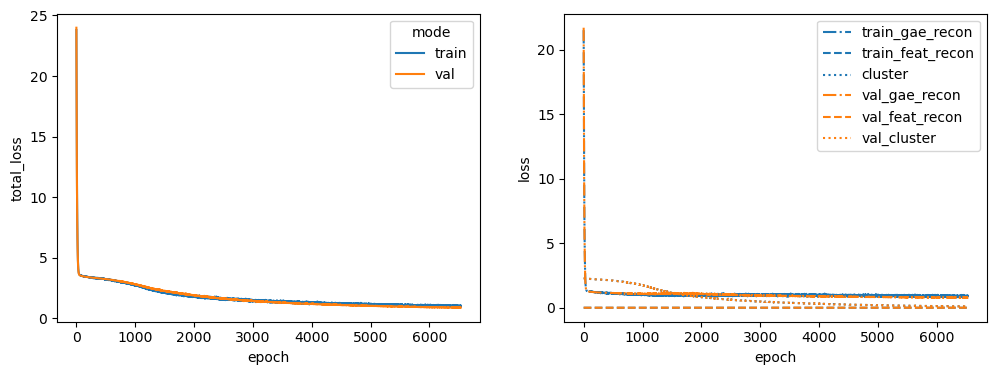

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


FOXO1
Latent dim: 1024


 55%|█████▌    | 5520/10000 [01:36<01:18, 57.41it/s]


Training stopped after 5521 epochs
Best model found at epoch 5419
------------------------------------------------------------
TEST AUC: 0.9097633136094674 AP: 0.883666365713761
TRAIN loss: 1.0656427145004272
VAL loss: 1.1642953157424927
TEST loss: 1.30879807472229
TEST AUC: 0.9097633136094674 	 AP: 0.883666365713761


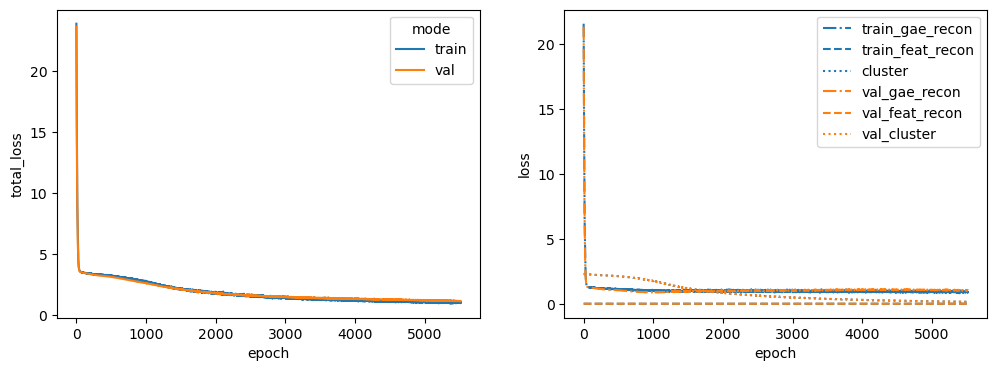

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


GLI1
Latent dim: 1024


 53%|█████▎    | 5338/10000 [01:32<01:21, 57.40it/s]


Training stopped after 5339 epochs
Best model found at epoch 5237
------------------------------------------------------------
TEST AUC: 0.9374999999999999 AP: 0.934855598250598
TRAIN loss: 1.1435809135437012
VAL loss: 0.9315969944000244
TEST loss: 1.1045724153518677
TEST AUC: 0.9374999999999999 	 AP: 0.934855598250598


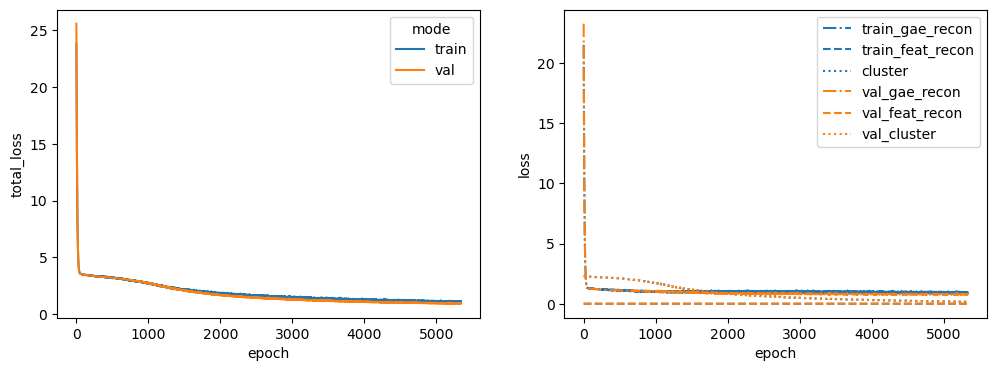

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


HRAS
Latent dim: 1024


 62%|██████▏   | 6207/10000 [01:46<01:05, 58.30it/s]


Training stopped after 6208 epochs
Best model found at epoch 6106
------------------------------------------------------------
TEST AUC: 0.9565458579881657 AP: 0.9530158183690316
TRAIN loss: 0.956027090549469
VAL loss: 0.947346031665802
TEST loss: 0.9701225757598877
TEST AUC: 0.9565458579881657 	 AP: 0.9530158183690316


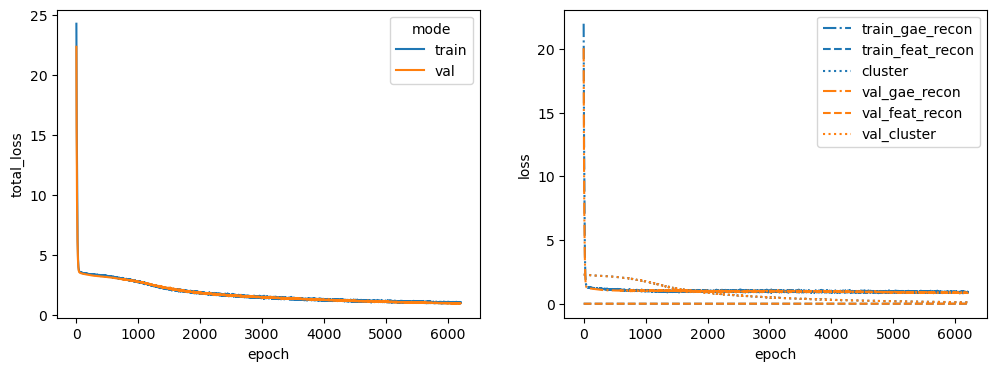

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


IRAK4
Latent dim: 1024


 62%|██████▏   | 6242/10000 [01:49<01:05, 57.07it/s]


Training stopped after 6243 epochs
Best model found at epoch 6141
------------------------------------------------------------
TEST AUC: 0.9615384615384616 AP: 0.9602630663475142
TRAIN loss: 0.9191156625747681
VAL loss: 0.9312933683395386
TEST loss: 0.9542487859725952
TEST AUC: 0.9615384615384616 	 AP: 0.9602630663475142


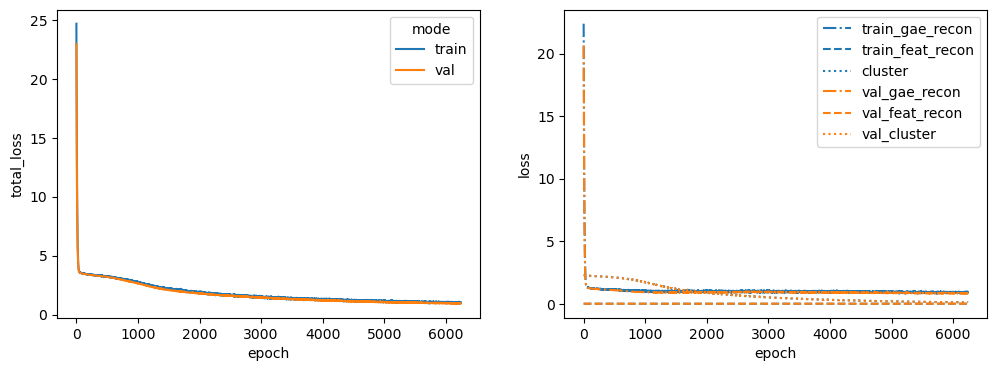

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


JUN
Latent dim: 1024


 49%|████▉     | 4907/10000 [01:25<01:28, 57.24it/s]


Training stopped after 4908 epochs
Best model found at epoch 4806
------------------------------------------------------------
TEST AUC: 0.930473372781065 AP: 0.899077530518072
TRAIN loss: 1.170471429824829
VAL loss: 1.1553438901901245
TEST loss: 1.203586220741272
TEST AUC: 0.930473372781065 	 AP: 0.899077530518072


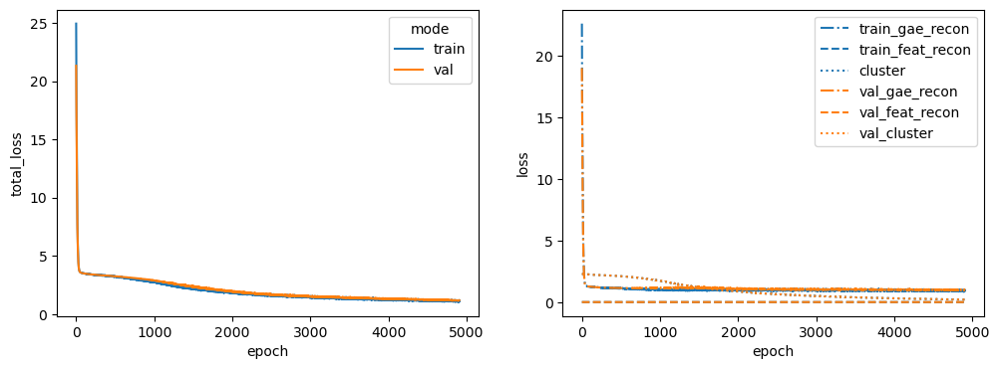

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


MAP2K3
Latent dim: 1024


 68%|██████▊   | 6815/10000 [01:59<00:55, 57.03it/s]


Training stopped after 6816 epochs
Best model found at epoch 6714
------------------------------------------------------------
TEST AUC: 0.9503513313609467 AP: 0.9489080848089775
TRAIN loss: 1.0184592008590698
VAL loss: 0.891859769821167
TEST loss: 1.0485377311706543
TEST AUC: 0.9503513313609467 	 AP: 0.9489080848089775


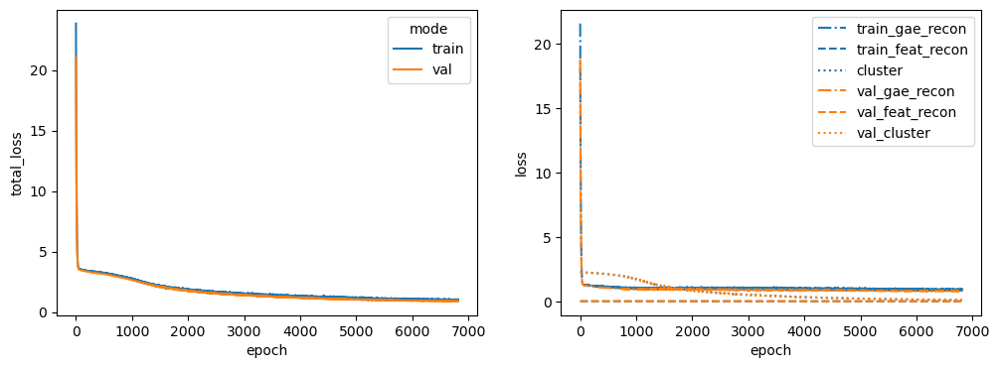

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


MAP3K2
Latent dim: 1024


 48%|████▊     | 4763/10000 [01:22<01:30, 57.97it/s]


Training stopped after 4764 epochs
Best model found at epoch 4662
------------------------------------------------------------
TEST AUC: 0.9102255917159764 AP: 0.8692131961886237
TRAIN loss: 1.1562145948410034
VAL loss: 1.090185523033142
TEST loss: 1.2928897142410278
TEST AUC: 0.9102255917159764 	 AP: 0.8692131961886237


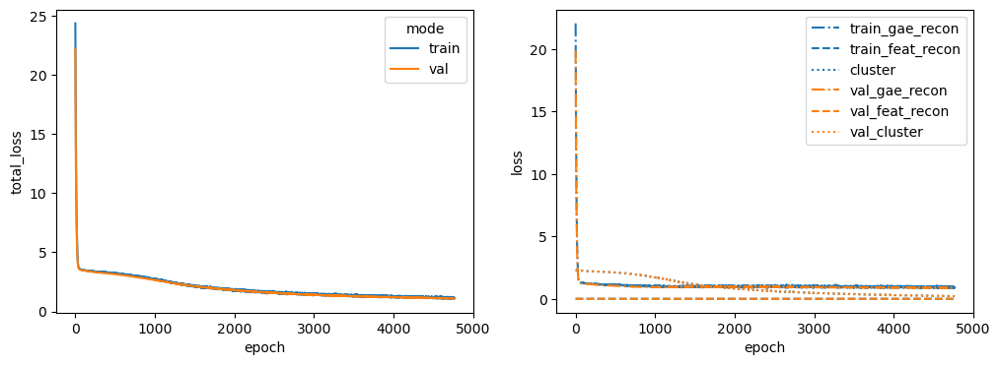

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


MAP3K5
Latent dim: 1024


 60%|█████▉    | 5973/10000 [01:45<01:11, 56.42it/s]


Training stopped after 5974 epochs
Best model found at epoch 5872
------------------------------------------------------------
TEST AUC: 0.9478550295857989 AP: 0.9292953340521988
TRAIN loss: 1.051788091659546
VAL loss: 1.0705071687698364
TEST loss: 1.065422534942627
TEST AUC: 0.9478550295857989 	 AP: 0.9292953340521988


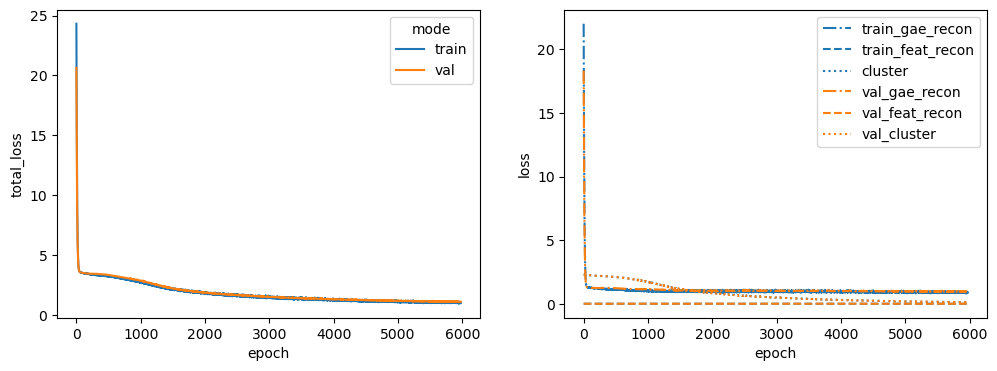

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


MAP3K9
Latent dim: 1024


 69%|██████▉   | 6891/10000 [02:00<00:54, 57.39it/s]


Training stopped after 6892 epochs
Best model found at epoch 6790
------------------------------------------------------------
TEST AUC: 0.962185650887574 AP: 0.9448005761260481
TRAIN loss: 0.9791662096977234
VAL loss: 0.9007047414779663
TEST loss: 0.9180920124053955
TEST AUC: 0.962185650887574 	 AP: 0.9448005761260481


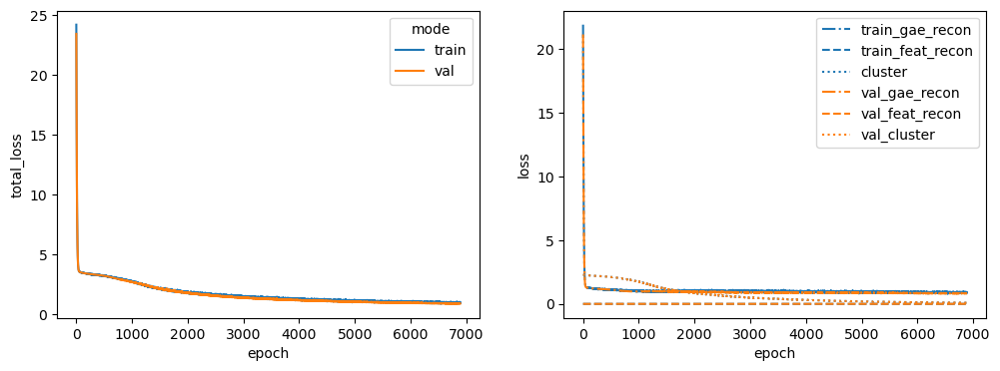

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


MAPK7
Latent dim: 1024


 73%|███████▎  | 7259/10000 [02:06<00:47, 57.26it/s]


Training stopped after 7260 epochs
Best model found at epoch 7158
------------------------------------------------------------
TEST AUC: 0.9509060650887574 AP: 0.9380706186421294
TRAIN loss: 0.8889967799186707
VAL loss: 0.9813095927238464
TEST loss: 0.9944534301757812
TEST AUC: 0.9509060650887574 	 AP: 0.9380706186421294


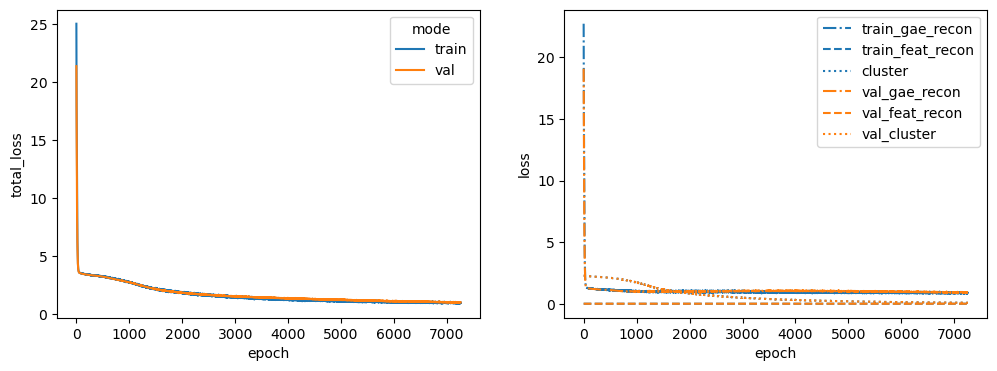

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


MOS
Latent dim: 1024


 47%|████▋     | 4734/10000 [01:22<01:31, 57.50it/s]


Training stopped after 4735 epochs
Best model found at epoch 4633
------------------------------------------------------------
TEST AUC: 0.9234467455621302 AP: 0.8900093146909998
TRAIN loss: 1.1414551734924316
VAL loss: 1.3583685159683228
TEST loss: 1.2788419723510742
TEST AUC: 0.9234467455621302 	 AP: 0.8900093146909998


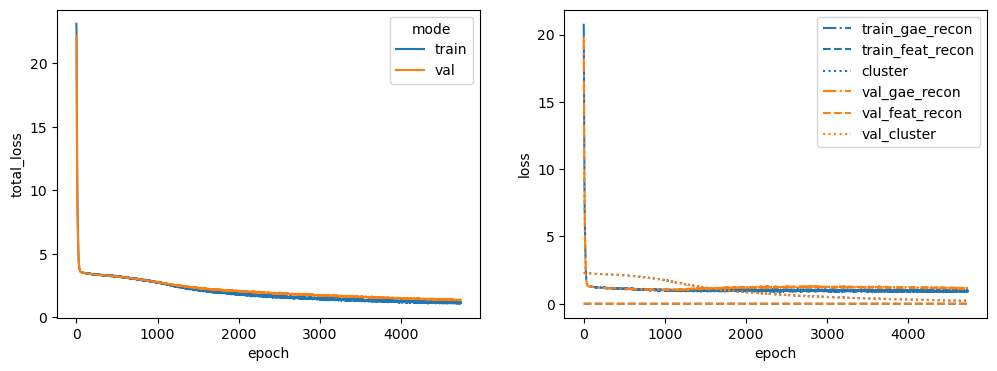

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


MYD88
Latent dim: 1024


 52%|█████▏    | 5182/10000 [01:29<01:23, 57.59it/s]


Training stopped after 5183 epochs
Best model found at epoch 5081
------------------------------------------------------------
TEST AUC: 0.9314903846153847 AP: 0.9100258983013627
TRAIN loss: 1.1376848220825195
VAL loss: 1.2906110286712646
TEST loss: 1.2128371000289917
TEST AUC: 0.9314903846153847 	 AP: 0.9100258983013627


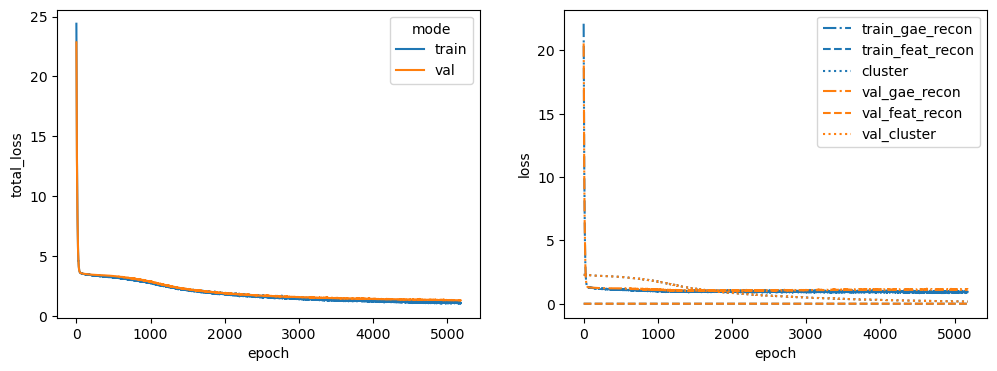

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


PIK3R2
Latent dim: 1024


 54%|█████▍    | 5389/10000 [01:34<01:20, 57.04it/s]


Training stopped after 5390 epochs
Best model found at epoch 5288
------------------------------------------------------------
TEST AUC: 0.9592270710059173 AP: 0.953599193942657
TRAIN loss: 1.044551134109497
VAL loss: 1.0676360130310059
TEST loss: 1.0609318017959595
TEST AUC: 0.9592270710059173 	 AP: 0.953599193942657


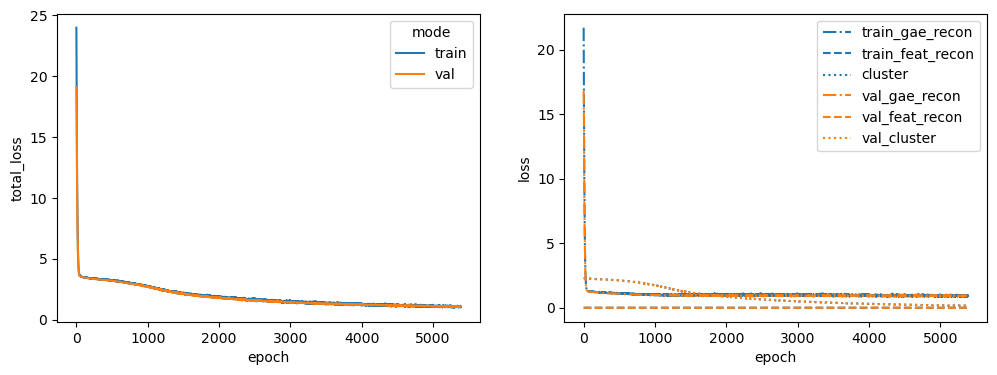

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


PRKACA
Latent dim: 1024


 61%|██████▏   | 6149/10000 [01:47<01:07, 57.27it/s]


Training stopped after 6150 epochs
Best model found at epoch 6048
------------------------------------------------------------
TEST AUC: 0.9334319526627219 AP: 0.8931459935723692
TRAIN loss: 1.0233243703842163
VAL loss: 0.8903260231018066
TEST loss: 1.219939112663269
TEST AUC: 0.9334319526627219 	 AP: 0.8931459935723692


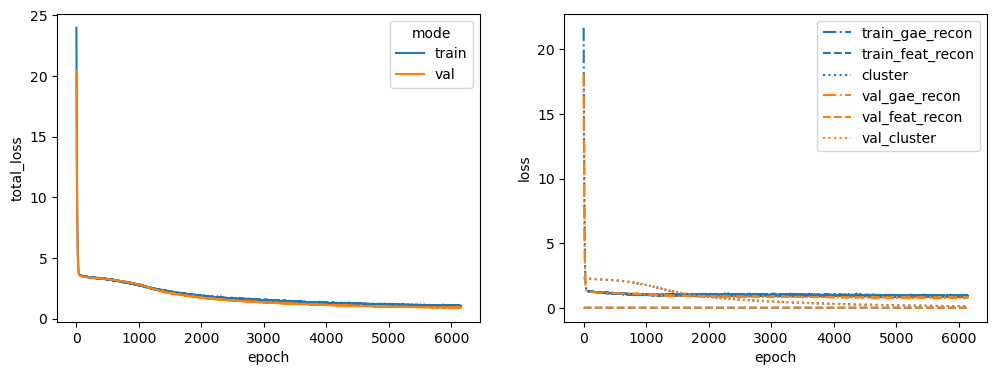

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


PRKCE
Latent dim: 1024


 62%|██████▏   | 6245/10000 [01:49<01:05, 57.17it/s]


Training stopped after 6246 epochs
Best model found at epoch 6144
------------------------------------------------------------
TEST AUC: 0.949796597633136 AP: 0.9453590761831061
TRAIN loss: 0.9173948764801025
VAL loss: 1.0954689979553223
TEST loss: 1.0323947668075562
TEST AUC: 0.949796597633136 	 AP: 0.9453590761831061


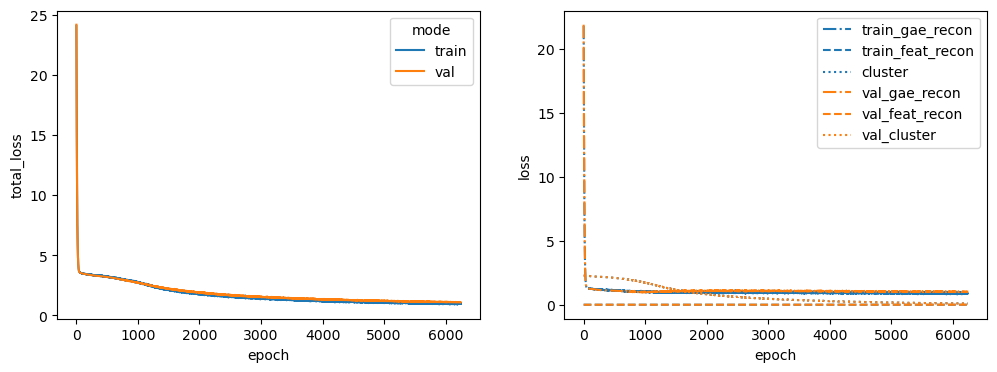

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


RAF1
Latent dim: 1024


 74%|███████▍  | 7378/10000 [02:07<00:45, 58.02it/s]


Training stopped after 7379 epochs
Best model found at epoch 7277
------------------------------------------------------------
TEST AUC: 0.9687499999999999 AP: 0.971902194463633
TRAIN loss: 1.009368658065796
VAL loss: 0.8514289259910583
TEST loss: 0.9198788404464722
TEST AUC: 0.9687499999999999 	 AP: 0.971902194463633


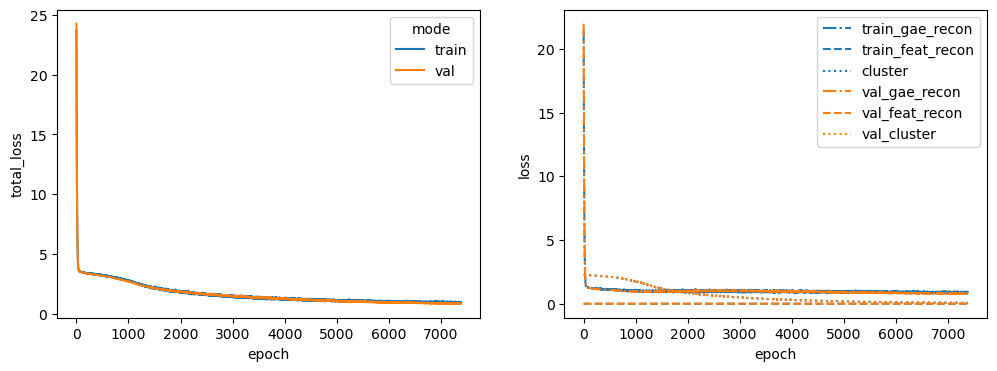

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


RELB
Latent dim: 1024


 61%|██████    | 6080/10000 [01:45<01:07, 57.89it/s]


Training stopped after 6081 epochs
Best model found at epoch 5979
------------------------------------------------------------
TEST AUC: 0.9669008875739645 AP: 0.9653575291162261
TRAIN loss: 1.047812581062317
VAL loss: 0.9466859698295593
TEST loss: 0.9392350912094116
TEST AUC: 0.9669008875739645 	 AP: 0.9653575291162261


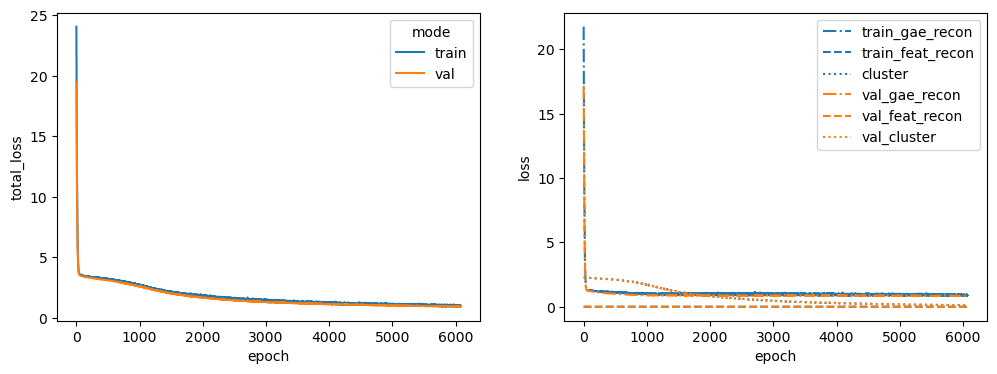

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


RHOA
Latent dim: 1024


 66%|██████▋   | 6629/10000 [01:55<00:58, 57.48it/s]


Training stopped after 6630 epochs
Best model found at epoch 6528
------------------------------------------------------------
TEST AUC: 0.94739275147929 AP: 0.94135284193698
TRAIN loss: 1.0411444902420044
VAL loss: 0.8944524526596069
TEST loss: 1.0731959342956543
TEST AUC: 0.94739275147929 	 AP: 0.94135284193698


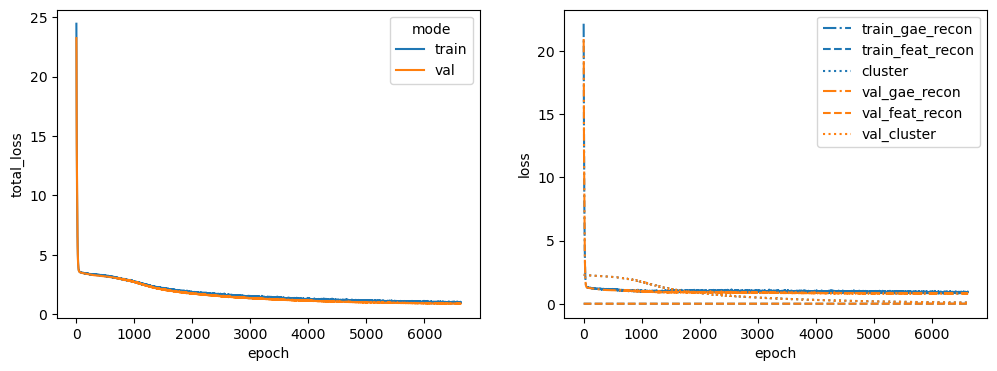

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


SMAD4
Latent dim: 1024


 68%|██████▊   | 6768/10000 [01:57<00:56, 57.36it/s]


Training stopped after 6769 epochs
Best model found at epoch 6667
------------------------------------------------------------
TEST AUC: 0.9595968934911244 AP: 0.9587092613949526
TRAIN loss: 0.9878041744232178
VAL loss: 0.8564027547836304
TEST loss: 0.9647060036659241
TEST AUC: 0.9595968934911244 	 AP: 0.9587092613949526


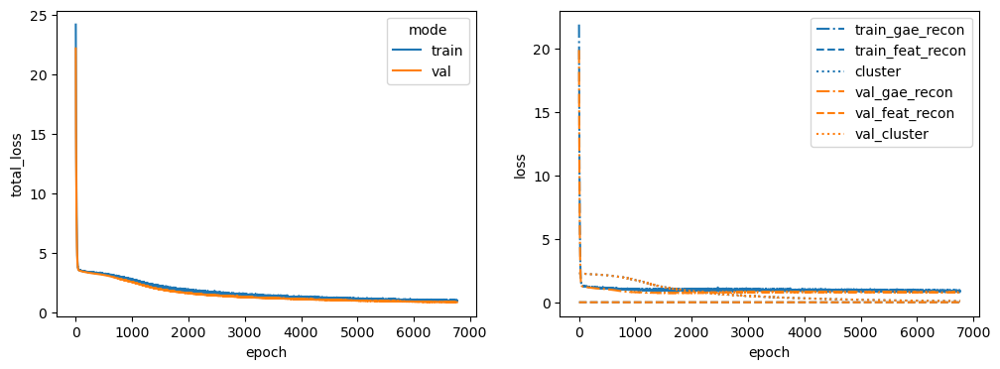

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


SMO
Latent dim: 1024


 60%|█████▉    | 5954/10000 [01:44<01:10, 57.06it/s]


Training stopped after 5955 epochs
Best model found at epoch 5853
------------------------------------------------------------
TEST AUC: 0.9362980769230769 AP: 0.923493762632503
TRAIN loss: 1.0979520082473755
VAL loss: 1.1135461330413818
TEST loss: 1.0997674465179443
TEST AUC: 0.9362980769230769 	 AP: 0.923493762632503


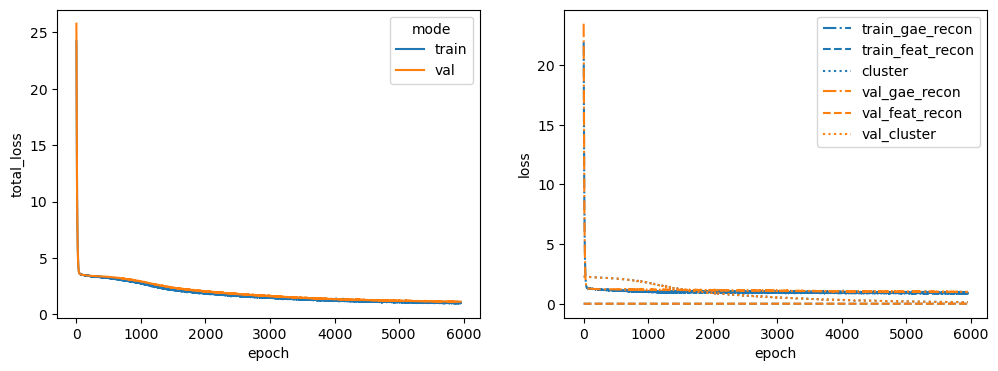

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


SRC
Latent dim: 1024


 57%|█████▋    | 5659/10000 [01:37<01:15, 57.81it/s]


Training stopped after 5660 epochs
Best model found at epoch 5558
------------------------------------------------------------
TEST AUC: 0.9502588757396451 AP: 0.9439088505336759
TRAIN loss: 1.0449256896972656
VAL loss: 1.1682831048965454
TEST loss: 1.0660700798034668
TEST AUC: 0.9502588757396451 	 AP: 0.9439088505336759


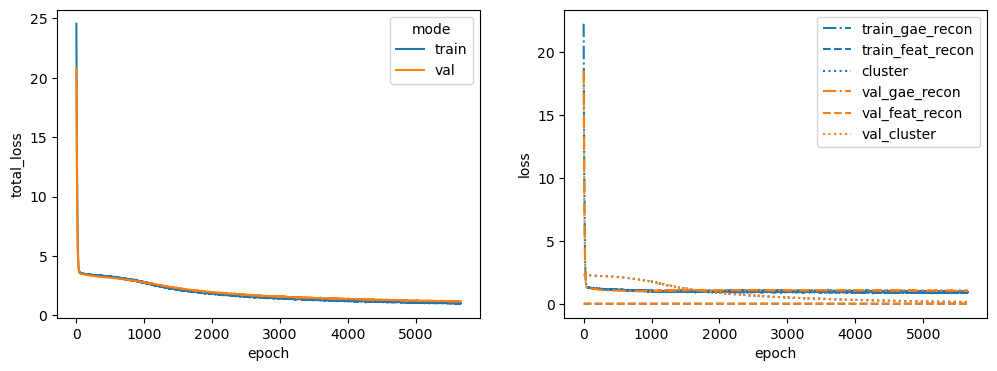

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


SREBF1
Latent dim: 1024


 60%|██████    | 6020/10000 [01:44<01:09, 57.34it/s]


Training stopped after 6021 epochs
Best model found at epoch 5919
------------------------------------------------------------
TEST AUC: 0.9504437869822485 AP: 0.9358836566642469
TRAIN loss: 1.0447880029678345
VAL loss: 1.0011417865753174
TEST loss: 1.0895487070083618
TEST AUC: 0.9504437869822485 	 AP: 0.9358836566642469


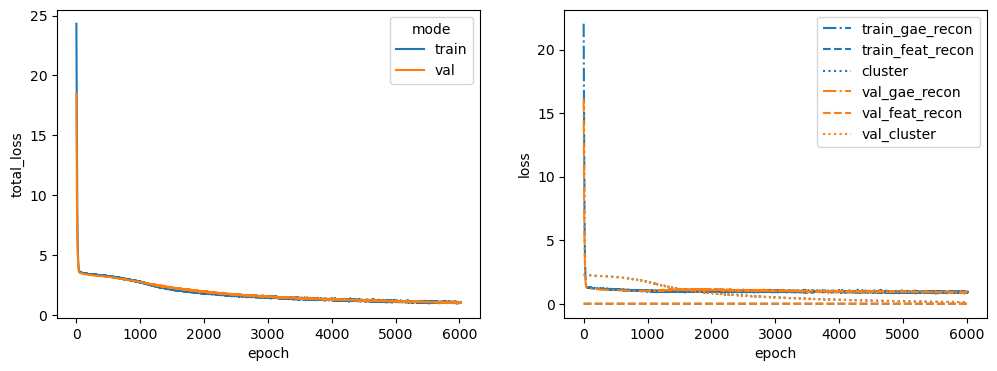

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


TRAF2
Latent dim: 1024


 72%|███████▏  | 7158/10000 [02:03<00:48, 58.01it/s]


Training stopped after 7159 epochs
Best model found at epoch 7057
------------------------------------------------------------
TEST AUC: 0.9473927514792899 AP: 0.9265625248359359
TRAIN loss: 1.0506532192230225
VAL loss: 1.0043060779571533
TEST loss: 1.0006352663040161
TEST AUC: 0.9473927514792899 	 AP: 0.9265625248359359


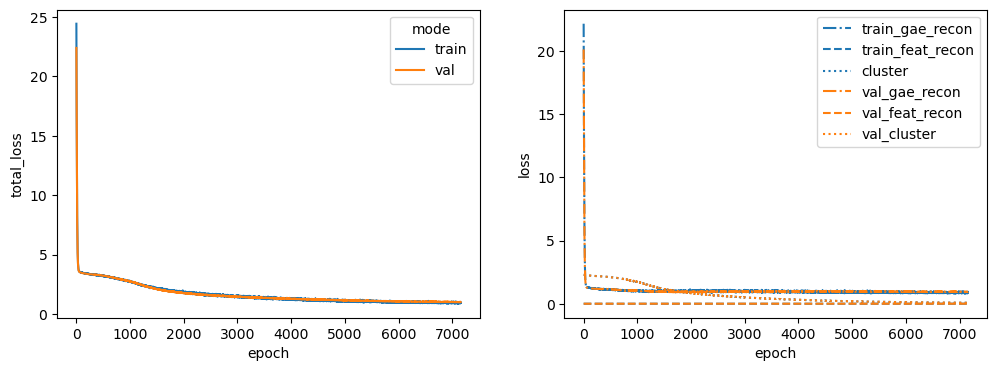

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


TSC2
Latent dim: 1024


 62%|██████▏   | 6151/10000 [01:47<01:07, 57.30it/s]


Training stopped after 6152 epochs
Best model found at epoch 6050
------------------------------------------------------------
TEST AUC: 0.9430473372781066 AP: 0.939186056367117
TRAIN loss: 1.0079083442687988
VAL loss: 0.8778212666511536
TEST loss: 1.0377097129821777
TEST AUC: 0.9430473372781066 	 AP: 0.939186056367117


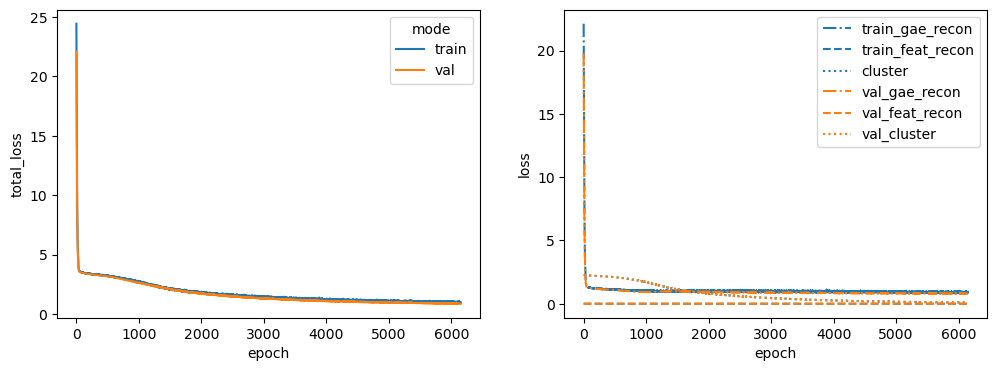

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


WWTR1
Latent dim: 1024


 65%|██████▌   | 6548/10000 [01:53<00:59, 57.66it/s]


Training stopped after 6549 epochs
Best model found at epoch 6447
------------------------------------------------------------
TEST AUC: 0.9400887573964497 AP: 0.931290283480734
TRAIN loss: 1.0125981569290161
VAL loss: 0.8743570446968079
TEST loss: 1.087010145187378
TEST AUC: 0.9400887573964497 	 AP: 0.931290283480734


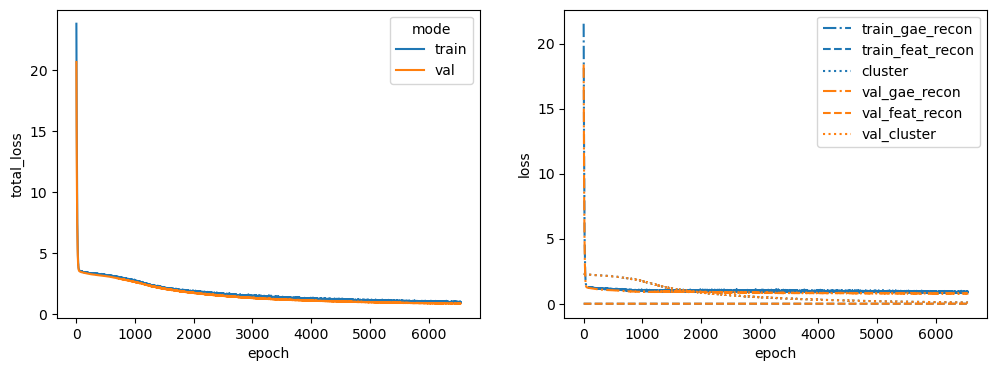

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


AKT1S1
Latent dim: 1024


 68%|██████▊   | 6791/10000 [01:57<00:55, 57.97it/s]


Training stopped after 6792 epochs
Best model found at epoch 6690
------------------------------------------------------------
TEST AUC: 0.9134615384615385 AP: 0.9074460989640392
TRAIN loss: 0.9901169538497925
VAL loss: 1.093102216720581
TEST loss: 1.1627683639526367
TEST AUC: 0.9134615384615385 	 AP: 0.9074460989640392


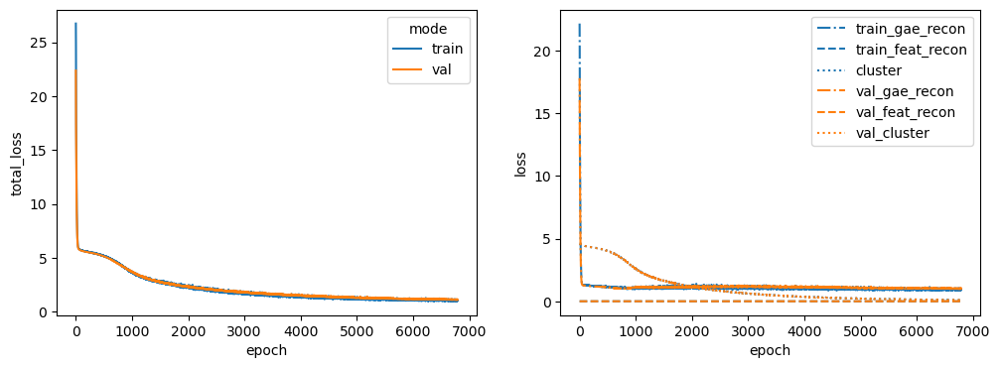

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


ATF4
Latent dim: 1024


 58%|█████▊    | 5793/10000 [01:41<01:13, 57.25it/s]


Training stopped after 5794 epochs
Best model found at epoch 5692
------------------------------------------------------------
TEST AUC: 0.9688424556213018 AP: 0.9710406995691835
TRAIN loss: 1.0791438817977905
VAL loss: 1.1467047929763794
TEST loss: 0.9909260272979736
TEST AUC: 0.9688424556213018 	 AP: 0.9710406995691835


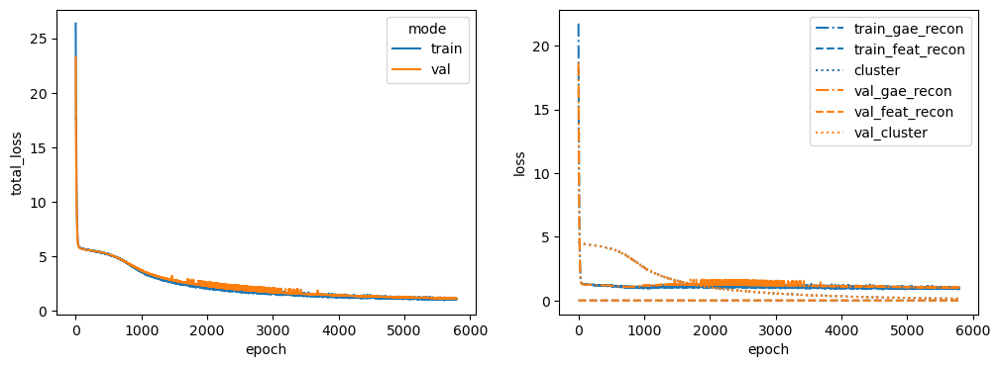

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


BAX
Latent dim: 1024


 61%|██████    | 6082/10000 [01:44<01:07, 58.02it/s]


Training stopped after 6083 epochs
Best model found at epoch 5981
------------------------------------------------------------
TEST AUC: 0.943694526627219 AP: 0.9309843139759245
TRAIN loss: 1.0466766357421875
VAL loss: 1.170371413230896
TEST loss: 1.0826488733291626
TEST AUC: 0.943694526627219 	 AP: 0.9309843139759245


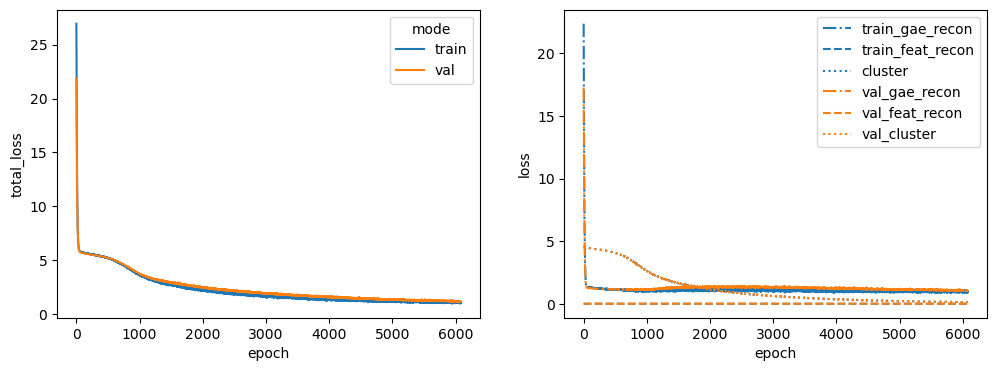

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


BCL2L11
Latent dim: 1024


 44%|████▎     | 4354/10000 [01:15<01:38, 57.43it/s]


Training stopped after 4355 epochs
Best model found at epoch 4253
------------------------------------------------------------
TEST AUC: 0.9245562130177516 AP: 0.9229163330553188
TRAIN loss: 1.2418320178985596
VAL loss: 1.2820405960083008
TEST loss: 1.326988697052002
TEST AUC: 0.9245562130177516 	 AP: 0.9229163330553188


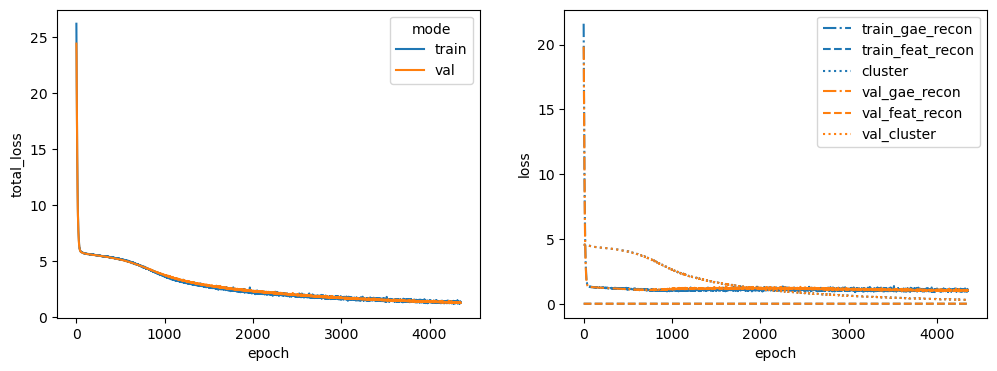

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


BRAF
Latent dim: 1024


 74%|███████▍  | 7449/10000 [02:09<00:44, 57.69it/s]


Training stopped after 7450 epochs
Best model found at epoch 7348
------------------------------------------------------------
TEST AUC: 0.9195636094674556 AP: 0.8969634821575321
TRAIN loss: 0.9610836505889893
VAL loss: 1.0251615047454834
TEST loss: 1.144008994102478
TEST AUC: 0.9195636094674556 	 AP: 0.8969634821575321


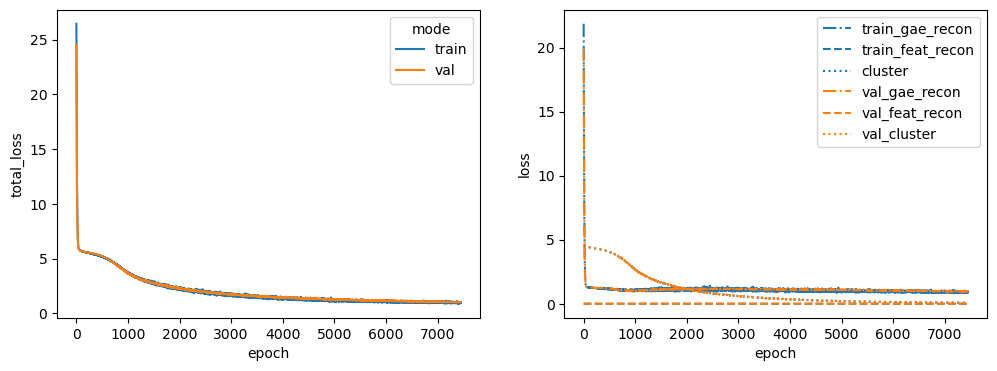

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


CASP8
Latent dim: 1024


 36%|███▌      | 3590/10000 [01:03<01:53, 56.23it/s]


Training stopped after 3591 epochs
Best model found at epoch 3489
------------------------------------------------------------
TEST AUC: 0.8990384615384616 AP: 0.8624476018097345
TRAIN loss: 1.5069468021392822
VAL loss: 1.4914827346801758
TEST loss: 1.7218992710113525
TEST AUC: 0.8990384615384616 	 AP: 0.8624476018097345


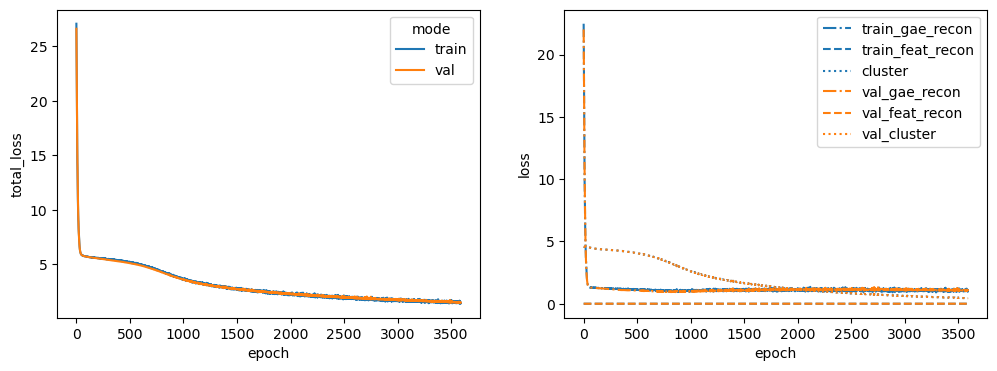

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


CDC42
Latent dim: 1024


 65%|██████▌   | 6541/10000 [01:55<01:01, 56.48it/s]


Training stopped after 6542 epochs
Best model found at epoch 6440
------------------------------------------------------------
TEST AUC: 0.946560650887574 AP: 0.9344077741773301
TRAIN loss: 1.0572295188903809
VAL loss: 0.9692689180374146
TEST loss: 1.119884729385376
TEST AUC: 0.946560650887574 	 AP: 0.9344077741773301


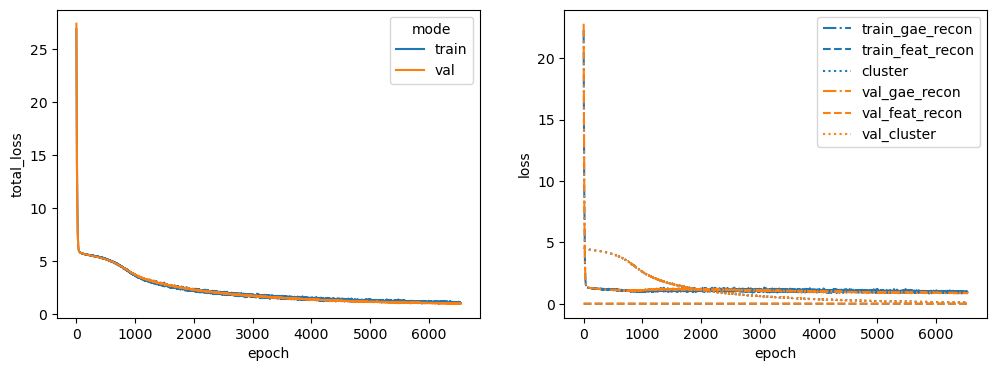

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


CDKN1A
Latent dim: 1024


 74%|███████▎  | 7355/10000 [02:06<00:45, 58.15it/s]


Training stopped after 7356 epochs
Best model found at epoch 7254
------------------------------------------------------------
TEST AUC: 0.9699519230769231 AP: 0.9727676565812916
TRAIN loss: 1.013189673423767
VAL loss: 1.1064296960830688
TEST loss: 0.9150910973548889
TEST AUC: 0.9699519230769231 	 AP: 0.9727676565812916


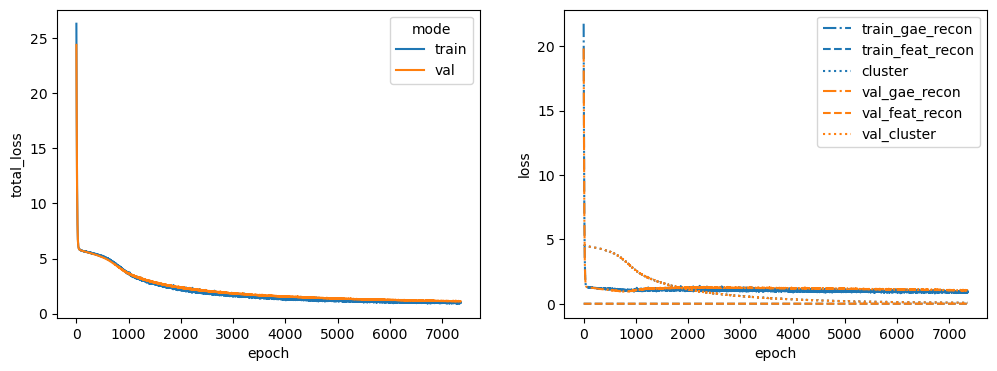

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


CEBPA
Latent dim: 1024


 55%|█████▍    | 5473/10000 [01:33<01:17, 58.31it/s]


Training stopped after 5474 epochs
Best model found at epoch 5372
------------------------------------------------------------
TEST AUC: 0.9343565088757397 AP: 0.9300460688904895
TRAIN loss: 1.1281131505966187
VAL loss: 1.2720744609832764
TEST loss: 1.142577052116394
TEST AUC: 0.9343565088757397 	 AP: 0.9300460688904895


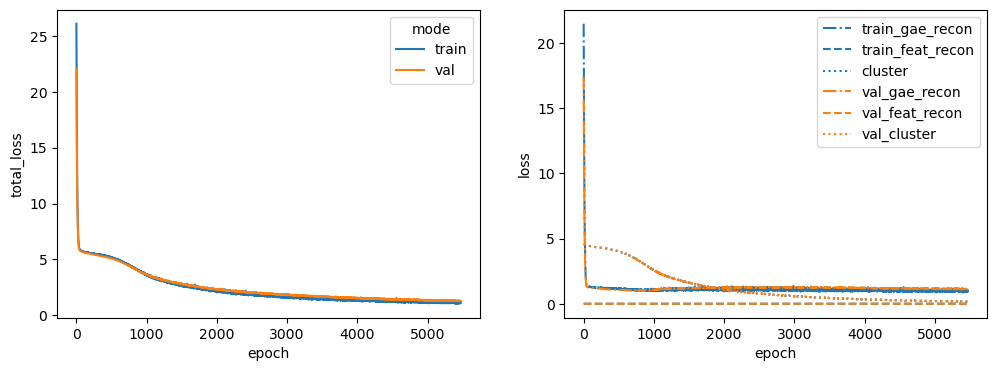

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


CREB1
Latent dim: 1024


 65%|██████▌   | 6528/10000 [01:55<01:01, 56.62it/s]


Training stopped after 6529 epochs
Best model found at epoch 6427
------------------------------------------------------------
TEST AUC: 0.918639053254438 AP: 0.8966290181121259
TRAIN loss: 0.9823949337005615
VAL loss: 1.0012824535369873
TEST loss: 1.1477932929992676
TEST AUC: 0.918639053254438 	 AP: 0.8966290181121259


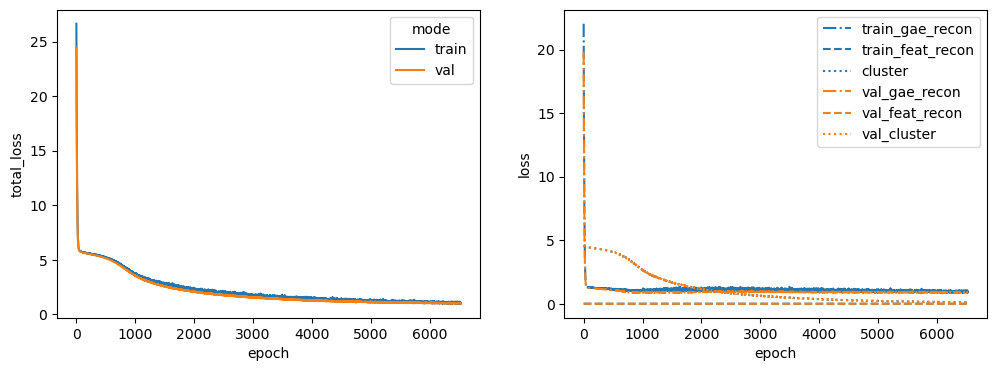

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


CXXC4
Latent dim: 1024


 52%|█████▏    | 5183/10000 [01:31<01:25, 56.56it/s]


Training stopped after 5184 epochs
Best model found at epoch 5082
------------------------------------------------------------
TEST AUC: 0.8887758875739644 AP: 0.8509796830417679
TRAIN loss: 1.2105128765106201
VAL loss: 0.9497641324996948
TEST loss: 1.4378364086151123
TEST AUC: 0.8887758875739644 	 AP: 0.8509796830417679


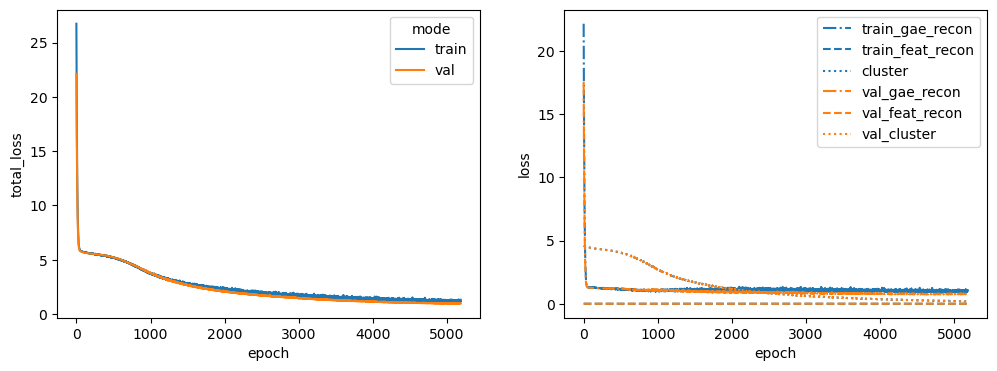

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


DIABLO
Latent dim: 1024


 57%|█████▋    | 5734/10000 [01:40<01:14, 57.21it/s]


Training stopped after 5735 epochs
Best model found at epoch 5633
------------------------------------------------------------
TEST AUC: 0.9363905325443787 AP: 0.9204240097385578
TRAIN loss: 1.1684396266937256
VAL loss: 1.2797669172286987
TEST loss: 1.1428885459899902
TEST AUC: 0.9363905325443787 	 AP: 0.9204240097385578


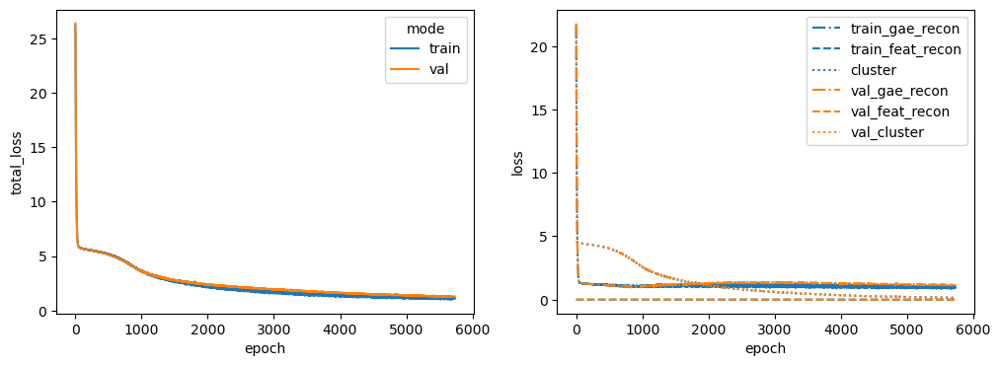

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


E2F1
Latent dim: 1024


 54%|█████▍    | 5379/10000 [01:33<01:20, 57.49it/s]


Training stopped after 5380 epochs
Best model found at epoch 5278
------------------------------------------------------------
TEST AUC: 0.9269600591715976 AP: 0.9145301781276984
TRAIN loss: 1.205785870552063
VAL loss: 0.9538787007331848
TEST loss: 1.1765133142471313
TEST AUC: 0.9269600591715976 	 AP: 0.9145301781276984


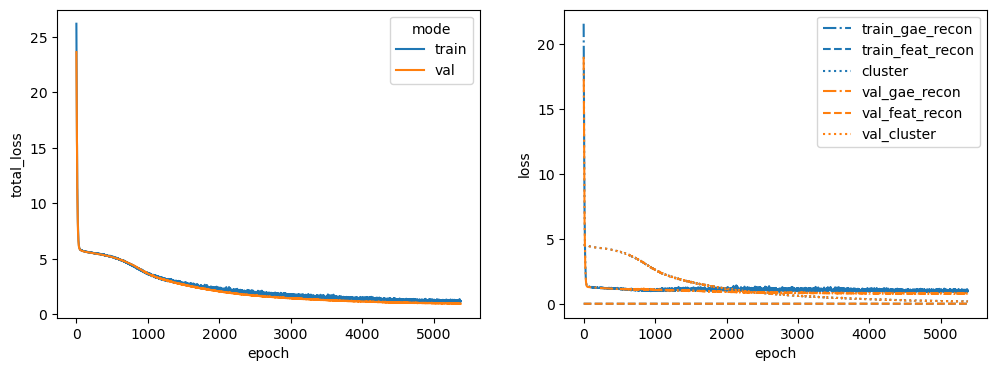

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


ELK1
Latent dim: 1024


 67%|██████▋   | 6725/10000 [01:57<00:57, 57.36it/s]


Training stopped after 6726 epochs
Best model found at epoch 6624
------------------------------------------------------------
TEST AUC: 0.9172522189349113 AP: 0.8885262310830895
TRAIN loss: 1.0084776878356934
VAL loss: 0.9688623547554016
TEST loss: 1.1918771266937256
TEST AUC: 0.9172522189349113 	 AP: 0.8885262310830895


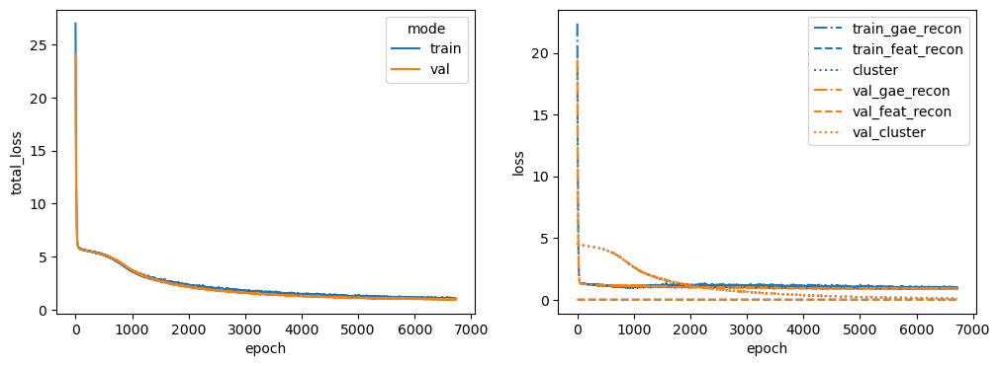

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


EMPTY
Latent dim: 1024


 49%|████▉     | 4905/10000 [01:24<01:28, 57.87it/s]


Training stopped after 4906 epochs
Best model found at epoch 4804
------------------------------------------------------------
TEST AUC: 0.9248335798816568 AP: 0.8873680316665062
TRAIN loss: 1.2456156015396118
VAL loss: 0.9924676418304443
TEST loss: 1.3175597190856934
TEST AUC: 0.9248335798816568 	 AP: 0.8873680316665062


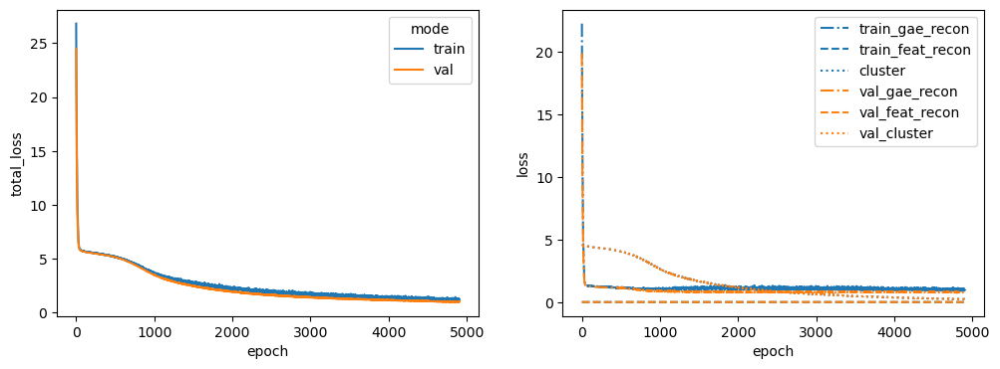

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


ERG
Latent dim: 1024


 60%|█████▉    | 5951/10000 [01:43<01:10, 57.43it/s]


Training stopped after 5952 epochs
Best model found at epoch 5850
------------------------------------------------------------
TEST AUC: 0.9254807692307693 AP: 0.9116135767990317
TRAIN loss: 1.094431757926941
VAL loss: 1.1077288389205933
TEST loss: 1.1743918657302856
TEST AUC: 0.9254807692307693 	 AP: 0.9116135767990317


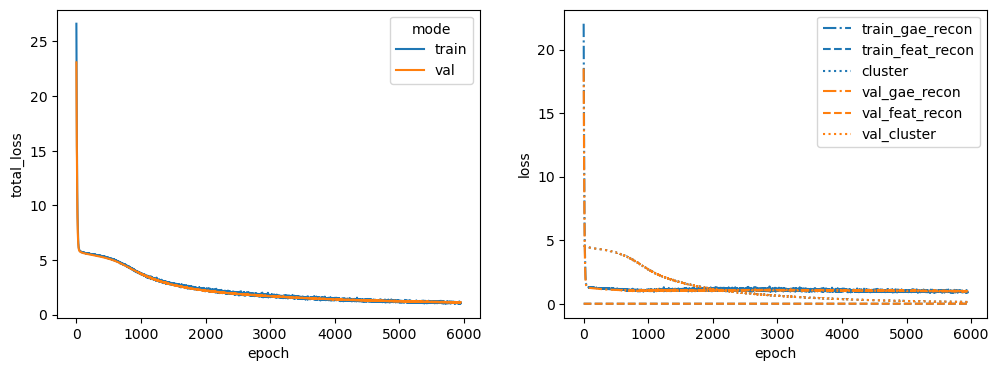

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


FGFR3
Latent dim: 1024


 66%|██████▋   | 6631/10000 [01:56<00:59, 56.78it/s]


Training stopped after 6632 epochs
Best model found at epoch 6530
------------------------------------------------------------
TEST AUC: 0.9274223372781064 AP: 0.9079215188152546
TRAIN loss: 1.081588625907898
VAL loss: 0.9761806726455688
TEST loss: 1.1592295169830322
TEST AUC: 0.9274223372781064 	 AP: 0.9079215188152546


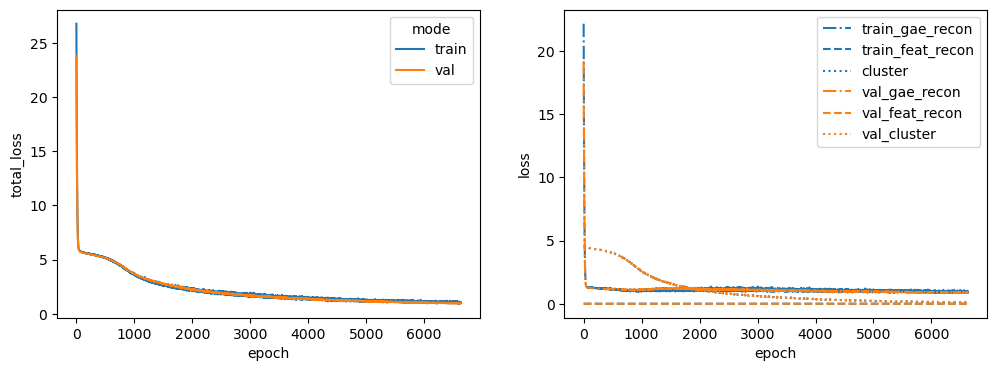

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


FOXO1
Latent dim: 1024


 68%|██████▊   | 6782/10000 [01:56<00:55, 57.99it/s]


Training stopped after 6783 epochs
Best model found at epoch 6681
------------------------------------------------------------
TEST AUC: 0.9466531065088758 AP: 0.9491027470978983
TRAIN loss: 1.0062683820724487
VAL loss: 0.9401654005050659
TEST loss: 0.9936532974243164
TEST AUC: 0.9466531065088758 	 AP: 0.9491027470978983


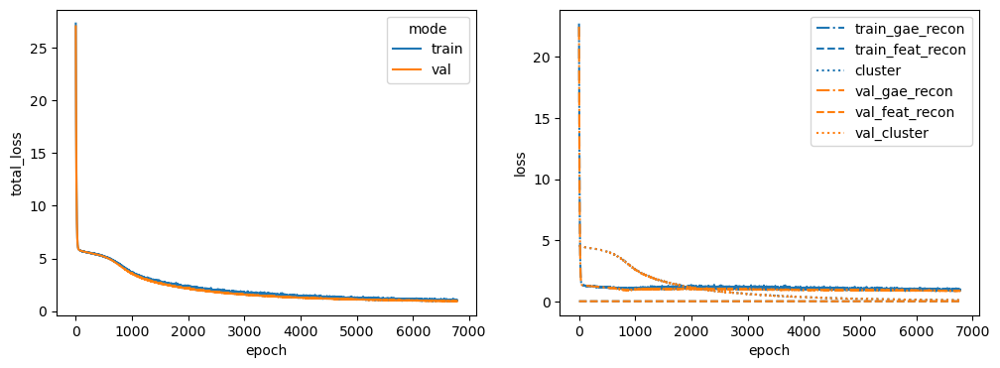

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


GLI1
Latent dim: 1024


 65%|██████▌   | 6511/10000 [01:53<01:00, 57.43it/s]


Training stopped after 6512 epochs
Best model found at epoch 6410
------------------------------------------------------------
TEST AUC: 0.9175295857988165 AP: 0.8861721534048813
TRAIN loss: 1.1023941040039062
VAL loss: 1.0675536394119263
TEST loss: 1.1783984899520874
TEST AUC: 0.9175295857988165 	 AP: 0.8861721534048813


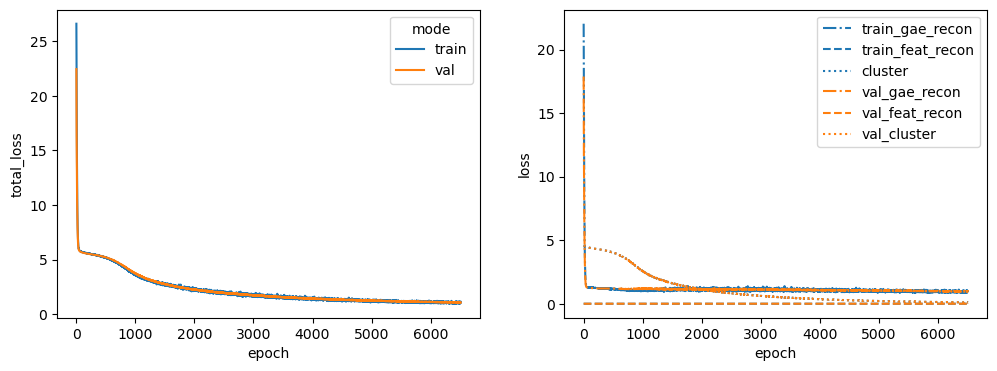

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


HRAS
Latent dim: 1024


 55%|█████▍    | 5461/10000 [01:36<01:19, 56.76it/s]


Training stopped after 5462 epochs
Best model found at epoch 5360
------------------------------------------------------------
TEST AUC: 0.9378698224852071 AP: 0.918861096230554
TRAIN loss: 1.116554617881775
VAL loss: 1.1258622407913208
TEST loss: 1.1900404691696167
TEST AUC: 0.9378698224852071 	 AP: 0.918861096230554


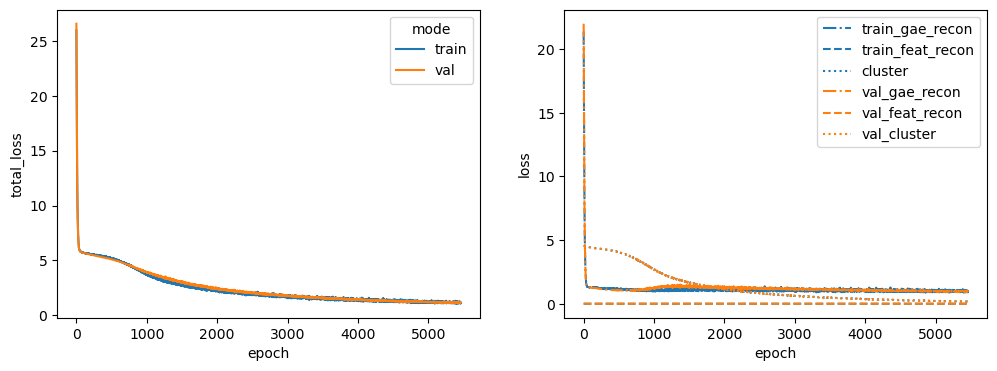

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


IRAK4
Latent dim: 1024


 56%|█████▌    | 5597/10000 [01:37<01:16, 57.61it/s]


Training stopped after 5598 epochs
Best model found at epoch 5496
------------------------------------------------------------
TEST AUC: 0.9463757396449706 AP: 0.9337608542079295
TRAIN loss: 1.2174314260482788
VAL loss: 1.1803559064865112
TEST loss: 1.0802797079086304
TEST AUC: 0.9463757396449706 	 AP: 0.9337608542079295


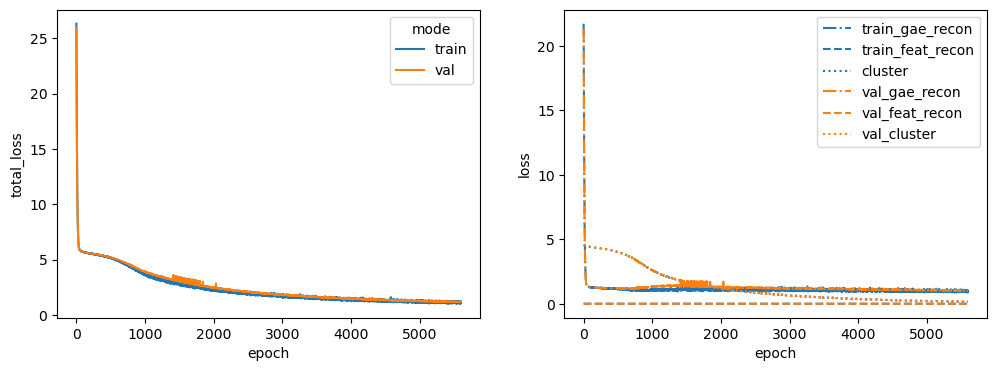

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


JUN
Latent dim: 1024


 61%|██████    | 6108/10000 [01:46<01:08, 57.24it/s]


Training stopped after 6109 epochs
Best model found at epoch 6007
------------------------------------------------------------
TEST AUC: 0.966715976331361 AP: 0.9668610517496997
TRAIN loss: 1.0625752210617065
VAL loss: 0.9274596571922302
TEST loss: 0.9611653685569763
TEST AUC: 0.966715976331361 	 AP: 0.9668610517496997


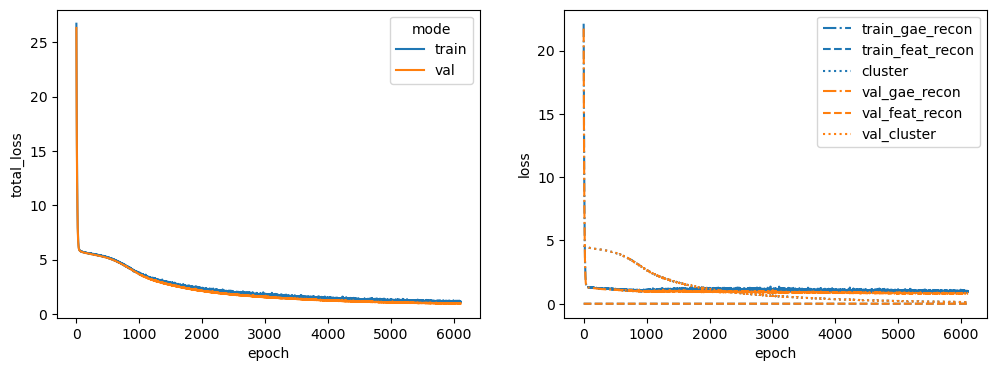

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


MAP2K3
Latent dim: 1024


 62%|██████▏   | 6222/10000 [01:48<01:05, 57.51it/s]


Training stopped after 6223 epochs
Best model found at epoch 6121
------------------------------------------------------------
TEST AUC: 0.9320451183431953 AP: 0.901860843780211
TRAIN loss: 1.1511242389678955
VAL loss: 0.9702611565589905
TEST loss: 1.1574268341064453
TEST AUC: 0.9320451183431953 	 AP: 0.901860843780211


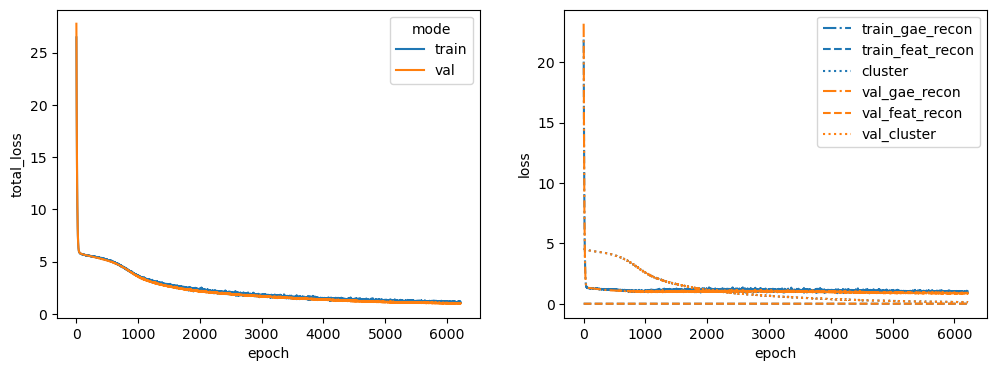

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


MAP3K2
Latent dim: 1024


 60%|██████    | 6011/10000 [01:45<01:09, 57.22it/s]


Training stopped after 6012 epochs
Best model found at epoch 5910
------------------------------------------------------------
TEST AUC: 0.932137573964497 AP: 0.9121111886778769
TRAIN loss: 1.0774096250534058
VAL loss: 1.2287099361419678
TEST loss: 1.169546365737915
TEST AUC: 0.932137573964497 	 AP: 0.9121111886778769


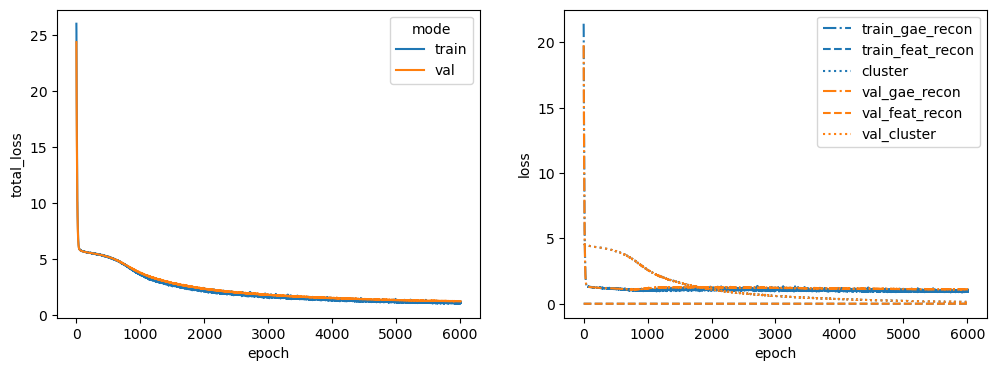

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


MAP3K5
Latent dim: 1024


 54%|█████▍    | 5414/10000 [01:35<01:21, 56.48it/s]


Training stopped after 5415 epochs
Best model found at epoch 5313
------------------------------------------------------------
TEST AUC: 0.9338017751479292 AP: 0.9168071781915865
TRAIN loss: 1.1692105531692505
VAL loss: 0.8996387720108032
TEST loss: 1.151832938194275
TEST AUC: 0.9338017751479292 	 AP: 0.9168071781915865


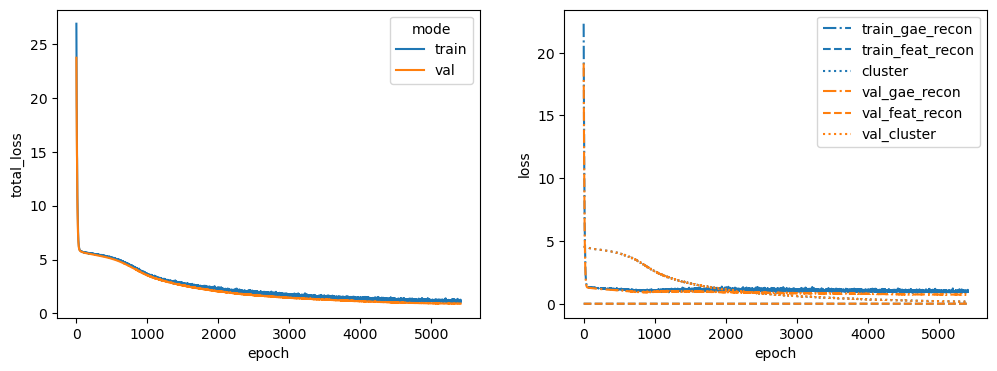

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


MAP3K9
Latent dim: 1024


 73%|███████▎  | 7294/10000 [02:06<00:46, 57.72it/s]


Training stopped after 7295 epochs
Best model found at epoch 7193
------------------------------------------------------------
TEST AUC: 0.952292899408284 AP: 0.9450311519684518
TRAIN loss: 1.1030759811401367
VAL loss: 1.0423681735992432
TEST loss: 1.0072822570800781
TEST AUC: 0.952292899408284 	 AP: 0.9450311519684518


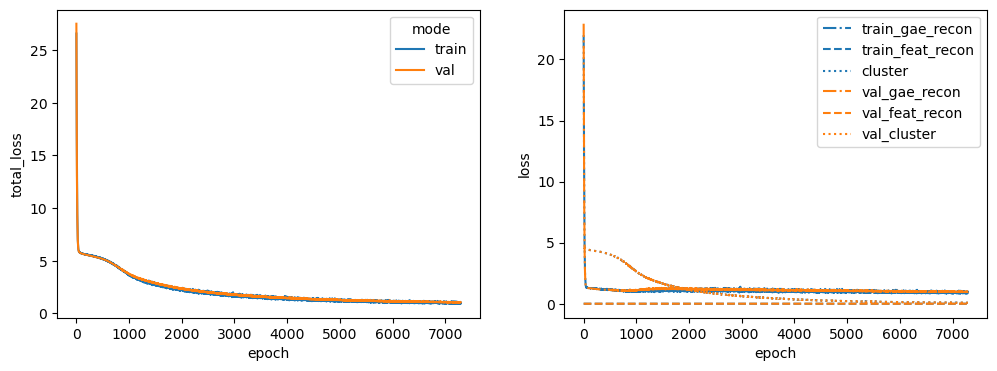

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


MAPK7
Latent dim: 1024


 57%|█████▋    | 5717/10000 [01:41<01:16, 56.35it/s]


Training stopped after 5718 epochs
Best model found at epoch 5616
------------------------------------------------------------
TEST AUC: 0.8851701183431953 AP: 0.8263667555538246
TRAIN loss: 1.1773626804351807
VAL loss: 1.037744164466858
TEST loss: 1.494266390800476
TEST AUC: 0.8851701183431953 	 AP: 0.8263667555538246


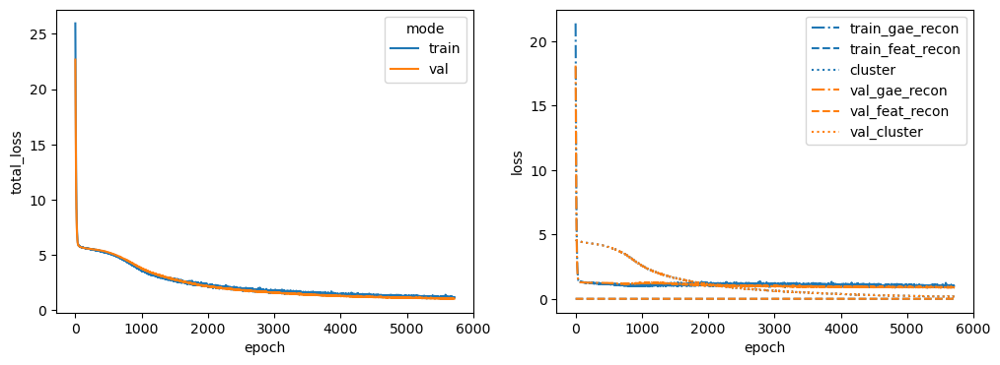

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


MOS
Latent dim: 1024


 67%|██████▋   | 6657/10000 [01:55<00:57, 57.88it/s]


Training stopped after 6658 epochs
Best model found at epoch 6556
------------------------------------------------------------
TEST AUC: 0.9553439349112426 AP: 0.9571008041555769
TRAIN loss: 1.0817115306854248
VAL loss: 0.9319813847541809
TEST loss: 1.043143391609192
TEST AUC: 0.9553439349112426 	 AP: 0.9571008041555769


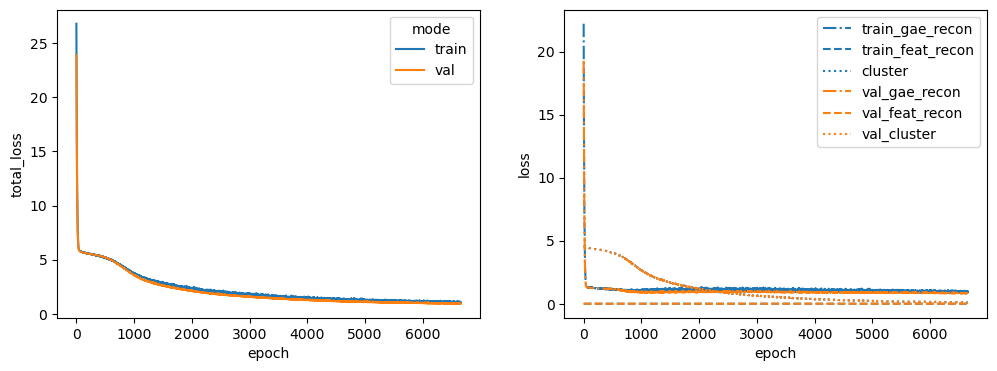

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


MYD88
Latent dim: 1024


 52%|█████▏    | 5180/10000 [01:29<01:23, 57.65it/s]


Training stopped after 5181 epochs
Best model found at epoch 5079
------------------------------------------------------------
TEST AUC: 0.9351886094674556 AP: 0.89753357206331
TRAIN loss: 1.187556505203247
VAL loss: 1.048551082611084
TEST loss: 1.1907134056091309
TEST AUC: 0.9351886094674556 	 AP: 0.89753357206331


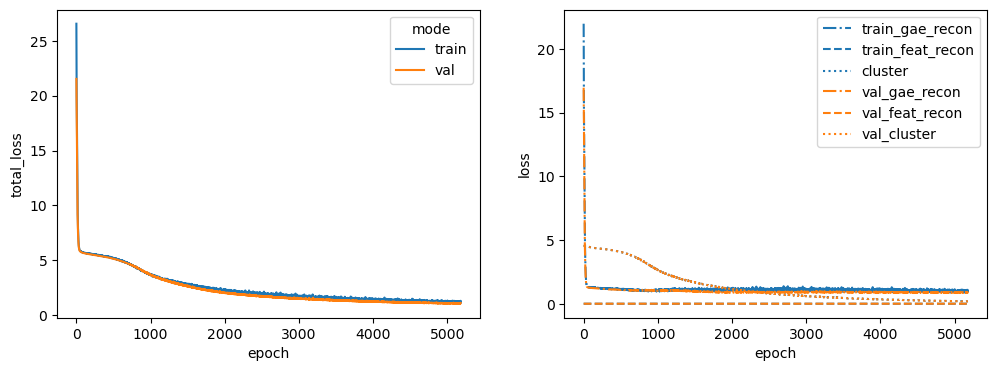

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


PIK3R2
Latent dim: 1024


 76%|███████▌  | 7598/10000 [02:12<00:41, 57.32it/s]


Training stopped after 7599 epochs
Best model found at epoch 7497
------------------------------------------------------------
TEST AUC: 0.9214127218934911 AP: 0.8865619474668897
TRAIN loss: 0.9346184730529785
VAL loss: 0.9454703330993652
TEST loss: 1.1862035989761353
TEST AUC: 0.9214127218934911 	 AP: 0.8865619474668897


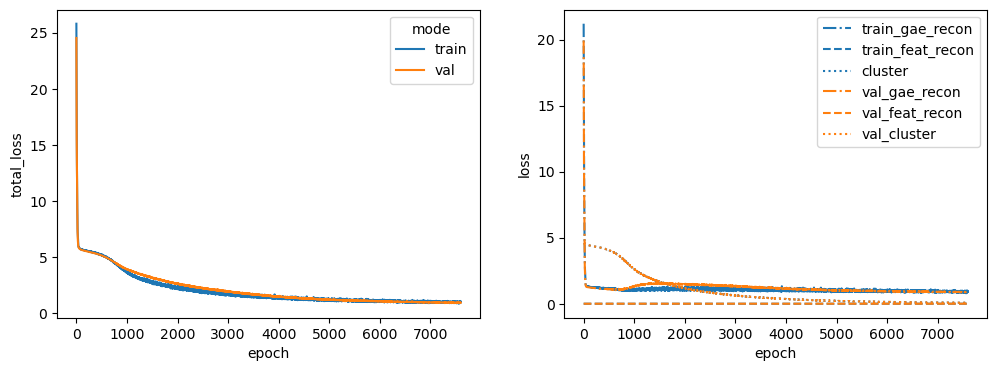

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


PRKACA
Latent dim: 1024


 53%|█████▎    | 5296/10000 [01:31<01:21, 57.67it/s]


Training stopped after 5297 epochs
Best model found at epoch 5195
------------------------------------------------------------
TEST AUC: 0.9535872781065088 AP: 0.9309786005958153
TRAIN loss: 1.1826181411743164
VAL loss: 1.0797481536865234
TEST loss: 1.0677164793014526
TEST AUC: 0.9535872781065088 	 AP: 0.9309786005958153


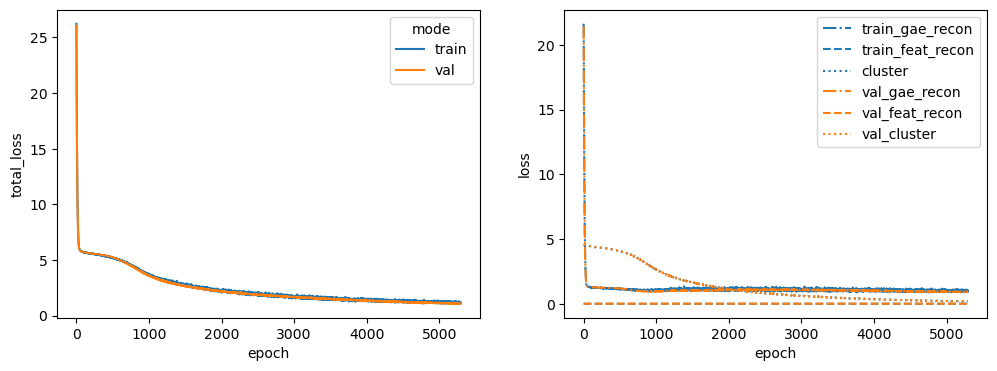

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


PRKCE
Latent dim: 1024


 42%|████▏     | 4163/10000 [01:13<01:43, 56.48it/s]


Training stopped after 4164 epochs
Best model found at epoch 4062
------------------------------------------------------------
TEST AUC: 0.9101331360946746 AP: 0.893130483831422
TRAIN loss: 1.3700772523880005
VAL loss: 1.1449114084243774
TEST loss: 1.3884657621383667
TEST AUC: 0.9101331360946746 	 AP: 0.893130483831422


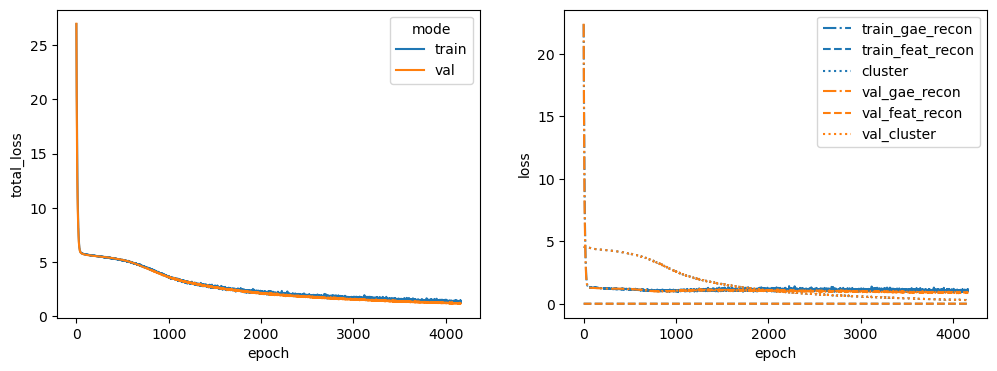

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


RAF1
Latent dim: 1024


 73%|███████▎  | 7346/10000 [02:06<00:45, 58.06it/s]


Training stopped after 7347 epochs
Best model found at epoch 7245
------------------------------------------------------------
TEST AUC: 0.932599852071006 AP: 0.919093316534595
TRAIN loss: 1.0216563940048218
VAL loss: 1.006079912185669
TEST loss: 1.0840845108032227
TEST AUC: 0.932599852071006 	 AP: 0.919093316534595


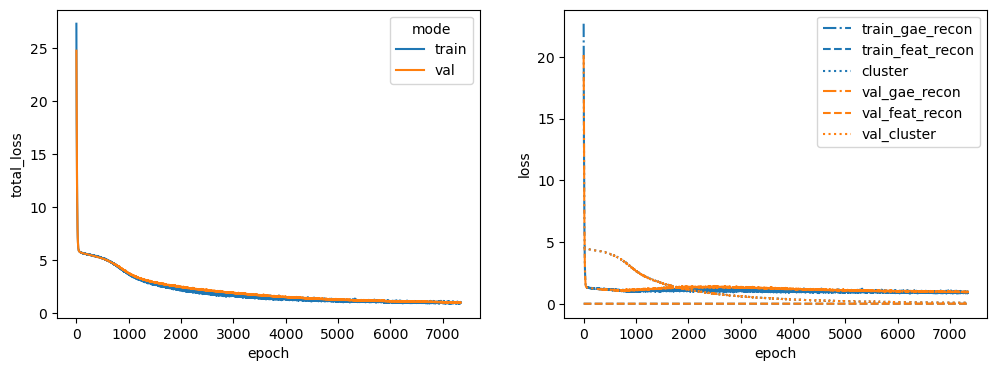

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


RELB
Latent dim: 1024


 67%|██████▋   | 6689/10000 [01:56<00:57, 57.40it/s]


Training stopped after 6690 epochs
Best model found at epoch 6588
------------------------------------------------------------
TEST AUC: 0.9429548816568047 AP: 0.9387110304074956
TRAIN loss: 1.0483628511428833
VAL loss: 1.0503662824630737
TEST loss: 1.0446444749832153
TEST AUC: 0.9429548816568047 	 AP: 0.9387110304074956


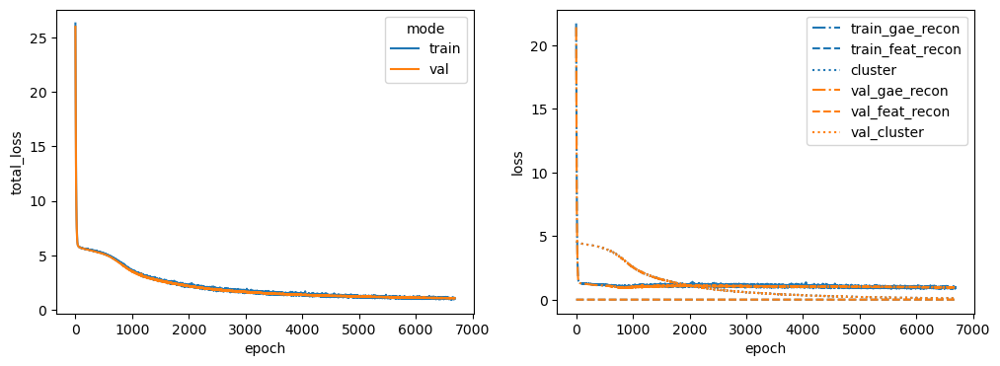

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


RHOA
Latent dim: 1024


 60%|█████▉    | 5987/10000 [01:44<01:09, 57.54it/s]


Training stopped after 5988 epochs
Best model found at epoch 5886
------------------------------------------------------------
TEST AUC: 0.942030325443787 AP: 0.9242970948219709
TRAIN loss: 1.0934163331985474
VAL loss: 0.9571740627288818
TEST loss: 1.1358671188354492
TEST AUC: 0.942030325443787 	 AP: 0.9242970948219709


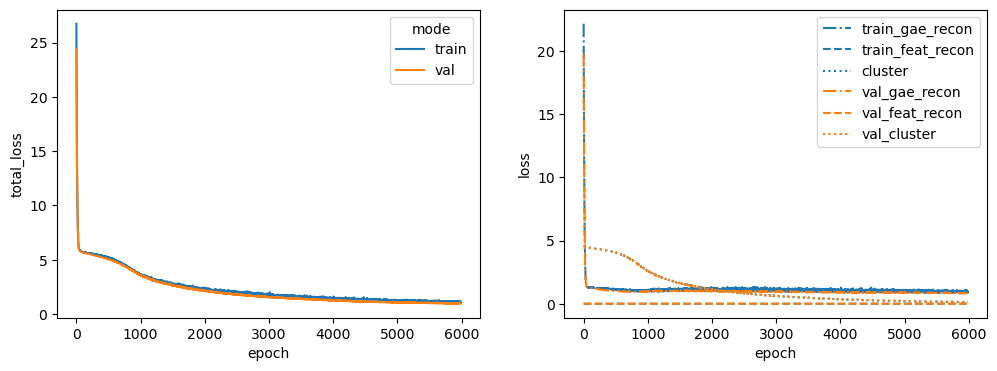

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


SMAD4
Latent dim: 1024


 55%|█████▍    | 5495/10000 [01:34<01:17, 58.13it/s]


Training stopped after 5496 epochs
Best model found at epoch 5394
------------------------------------------------------------
TEST AUC: 0.9370377218934912 AP: 0.9238899179087485
TRAIN loss: 1.1544960737228394
VAL loss: 1.1028419733047485
TEST loss: 1.127670168876648
TEST AUC: 0.9370377218934912 	 AP: 0.9238899179087485


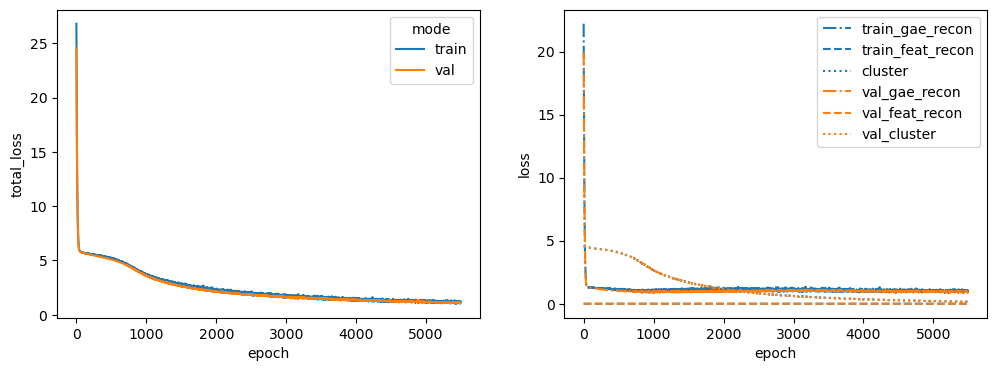

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


SMO
Latent dim: 1024


 66%|██████▌   | 6566/10000 [01:53<00:59, 57.64it/s]


Training stopped after 6567 epochs
Best model found at epoch 6465
------------------------------------------------------------
TEST AUC: 0.9411057692307694 AP: 0.9193432556764807
TRAIN loss: 1.096521258354187
VAL loss: 0.9606348872184753
TEST loss: 1.1669367551803589
TEST AUC: 0.9411057692307694 	 AP: 0.9193432556764807


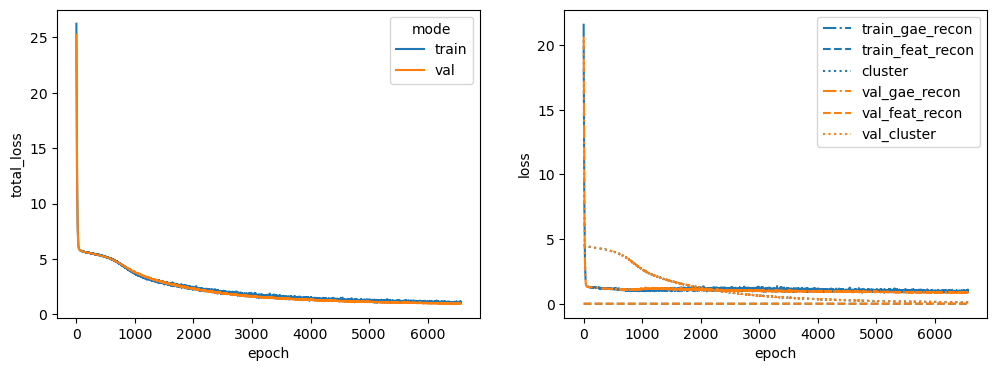

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


SRC
Latent dim: 1024


 57%|█████▋    | 5673/10000 [01:39<01:15, 57.03it/s]


Training stopped after 5674 epochs
Best model found at epoch 5572
------------------------------------------------------------
TEST AUC: 0.931305473372781 AP: 0.9121068081840495
TRAIN loss: 1.1434476375579834
VAL loss: 0.8135582208633423
TEST loss: 1.1730130910873413
TEST AUC: 0.931305473372781 	 AP: 0.9121068081840495


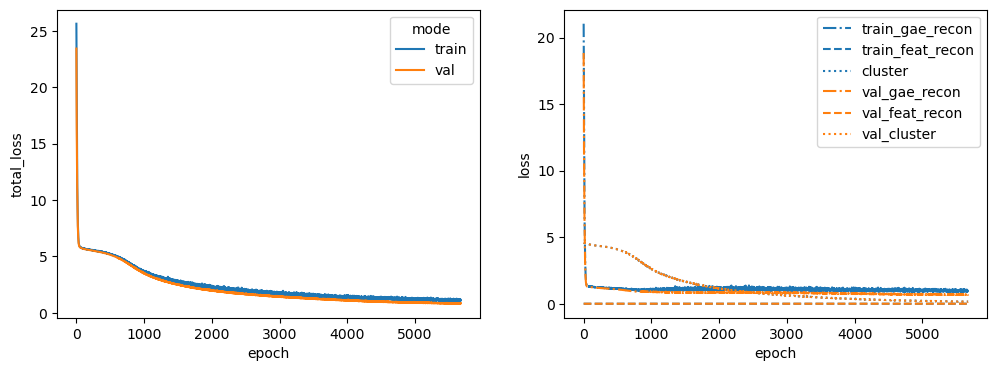

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


SREBF1
Latent dim: 1024


 62%|██████▏   | 6152/10000 [01:47<01:07, 57.08it/s]


Training stopped after 6153 epochs
Best model found at epoch 6051
------------------------------------------------------------
TEST AUC: 0.9405510355029587 AP: 0.9339771448043384
TRAIN loss: 1.1114327907562256
VAL loss: 1.0568866729736328
TEST loss: 1.005333423614502
TEST AUC: 0.9405510355029587 	 AP: 0.9339771448043384


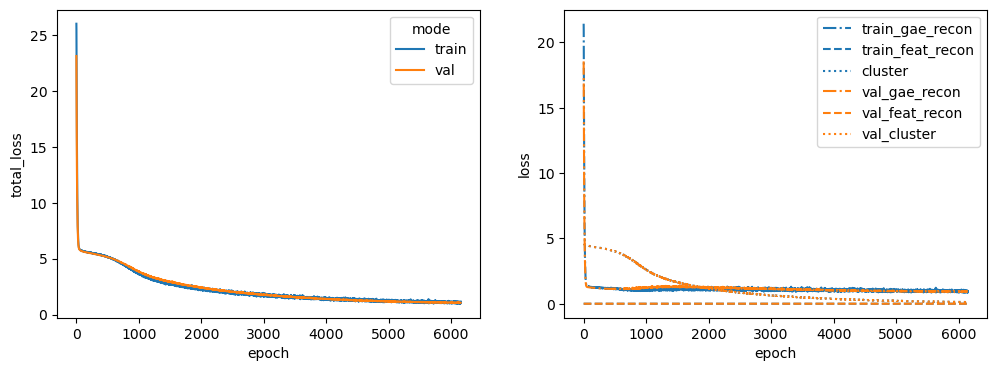

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


TRAF2
Latent dim: 1024


 72%|███████▏  | 7240/10000 [02:07<00:48, 56.57it/s]


Training stopped after 7241 epochs
Best model found at epoch 7139
------------------------------------------------------------
TEST AUC: 0.9411057692307693 AP: 0.9336165898167006
TRAIN loss: 1.0787056684494019
VAL loss: 0.8839592337608337
TEST loss: 1.0127605199813843
TEST AUC: 0.9411057692307693 	 AP: 0.9336165898167006


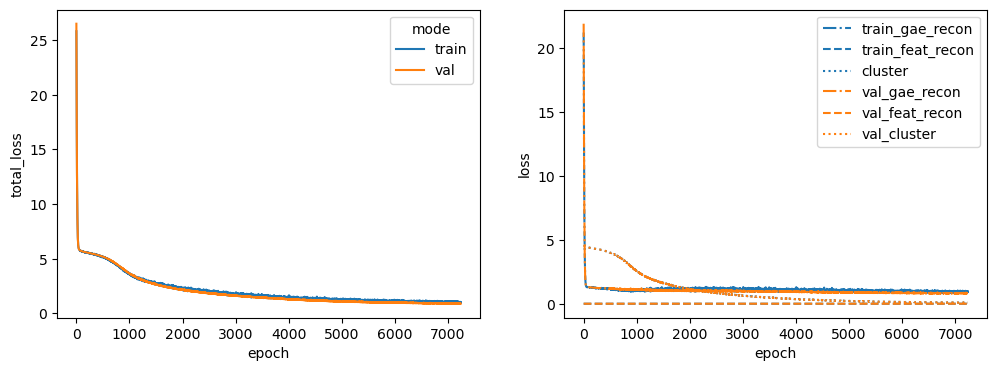

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


TSC2
Latent dim: 1024


 51%|█████     | 5110/10000 [01:30<01:26, 56.22it/s]


Training stopped after 5111 epochs
Best model found at epoch 5009
------------------------------------------------------------
TEST AUC: 0.9357433431952663 AP: 0.9128886161749009
TRAIN loss: 1.1335020065307617
VAL loss: 0.9657521843910217
TEST loss: 1.0787972211837769
TEST AUC: 0.9357433431952663 	 AP: 0.9128886161749009


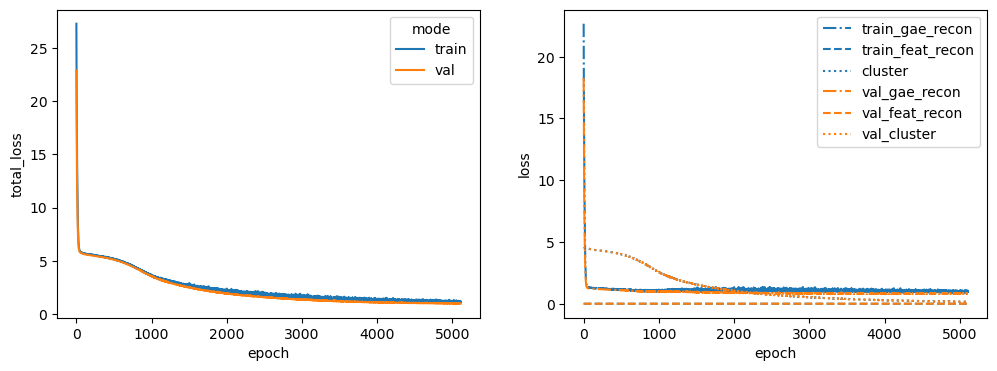

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


WWTR1
Latent dim: 1024


 63%|██████▎   | 6310/10000 [01:50<01:04, 57.00it/s]


Training stopped after 6311 epochs
Best model found at epoch 6209
------------------------------------------------------------
TEST AUC: 0.9359282544378698 AP: 0.9192196701249495
TRAIN loss: 1.1446939706802368
VAL loss: 0.8730522990226746
TEST loss: 1.0881882905960083
TEST AUC: 0.9359282544378698 	 AP: 0.9192196701249495


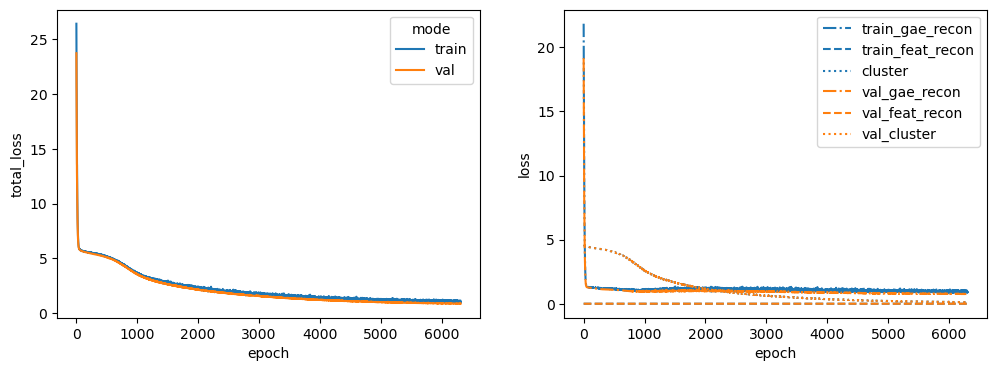

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


AKT1S1
Latent dim: 1024


 40%|████      | 4039/10000 [01:10<01:44, 57.16it/s]


Training stopped after 4040 epochs
Best model found at epoch 3938
------------------------------------------------------------
TEST AUC: 0.9215976331360946 AP: 0.8931567160633636
TRAIN loss: 1.6838635206222534
VAL loss: 1.5917648077011108
TEST loss: 1.5676653385162354
TEST AUC: 0.9215976331360946 	 AP: 0.8931567160633636


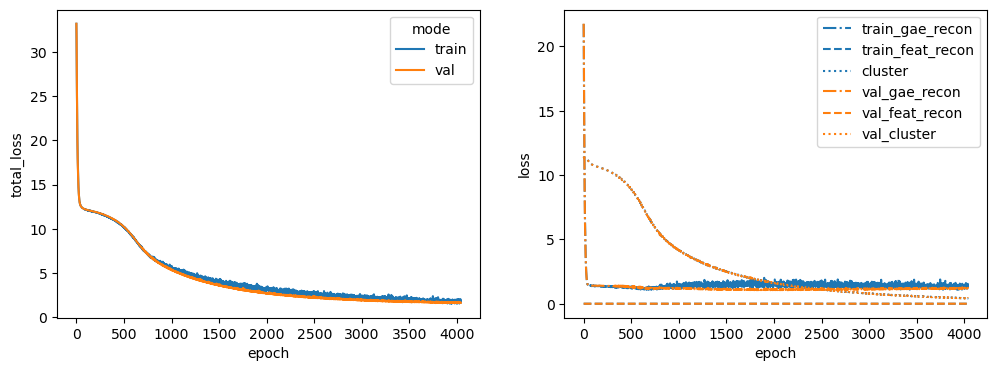

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


ATF4
Latent dim: 1024


 56%|█████▌    | 5558/10000 [01:38<01:18, 56.64it/s]


Training stopped after 5559 epochs
Best model found at epoch 5457
------------------------------------------------------------
TEST AUC: 0.928069526627219 AP: 0.9067453619223284
TRAIN loss: 1.4251911640167236
VAL loss: 1.027634620666504
TEST loss: 1.2514848709106445
TEST AUC: 0.928069526627219 	 AP: 0.9067453619223284


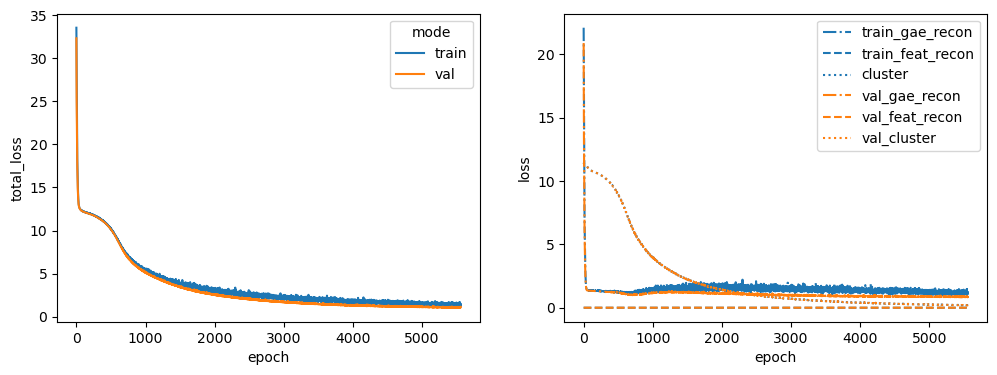

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


BAX
Latent dim: 1024


 75%|███████▍  | 7460/10000 [02:10<00:44, 57.28it/s]


Training stopped after 7461 epochs
Best model found at epoch 7359
------------------------------------------------------------
TEST AUC: 0.9022744082840236 AP: 0.83218378144648
TRAIN loss: 1.216870665550232
VAL loss: 0.9746671915054321
TEST loss: 1.9235923290252686
TEST AUC: 0.9022744082840236 	 AP: 0.83218378144648


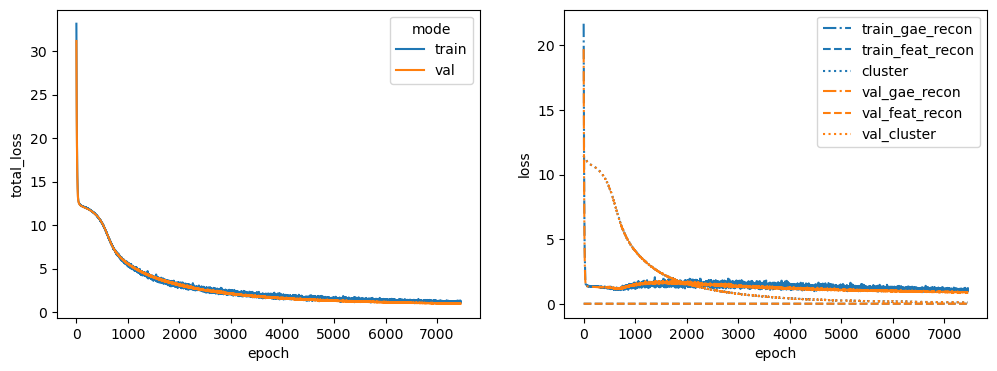

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


BCL2L11
Latent dim: 1024


 58%|█████▊    | 5767/10000 [01:40<01:13, 57.48it/s]


Training stopped after 5768 epochs
Best model found at epoch 5666
------------------------------------------------------------
TEST AUC: 0.92395525147929 AP: 0.8808944784827832
TRAIN loss: 1.381946325302124
VAL loss: 0.9478558301925659
TEST loss: 1.571094274520874
TEST AUC: 0.92395525147929 	 AP: 0.8808944784827832


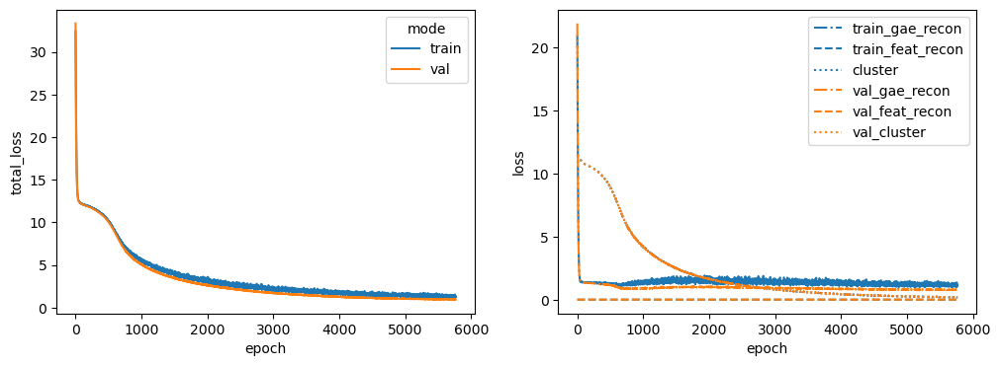

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


BRAF
Latent dim: 1024


 41%|████      | 4110/10000 [01:12<01:43, 57.05it/s]


Training stopped after 4111 epochs
Best model found at epoch 4009
------------------------------------------------------------
TEST AUC: 0.8925665680473374 AP: 0.869990511221306
TRAIN loss: 1.6938053369522095
VAL loss: 1.1874794960021973
TEST loss: 1.6646778583526611
TEST AUC: 0.8925665680473374 	 AP: 0.869990511221306


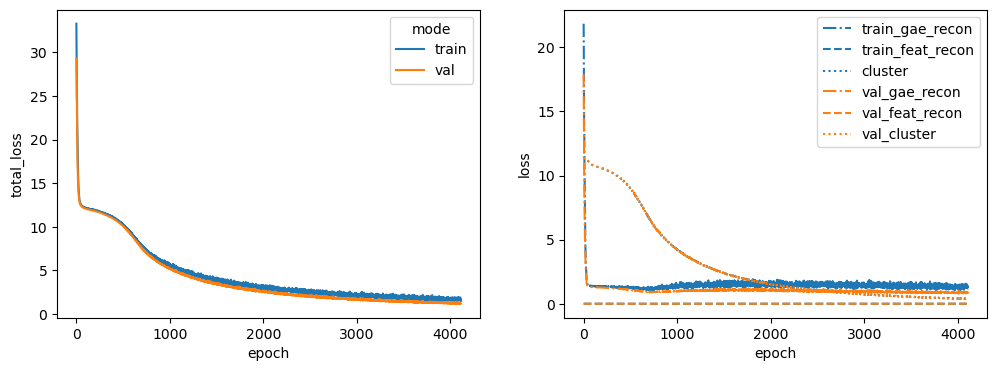

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


CASP8
Latent dim: 1024


 67%|██████▋   | 6722/10000 [01:56<00:56, 57.61it/s]


Training stopped after 6723 epochs
Best model found at epoch 6621
------------------------------------------------------------
TEST AUC: 0.9255269970414202 AP: 0.881312972934353
TRAIN loss: 1.2693172693252563
VAL loss: 0.9186433553695679
TEST loss: 1.5168532133102417
TEST AUC: 0.9255269970414202 	 AP: 0.881312972934353


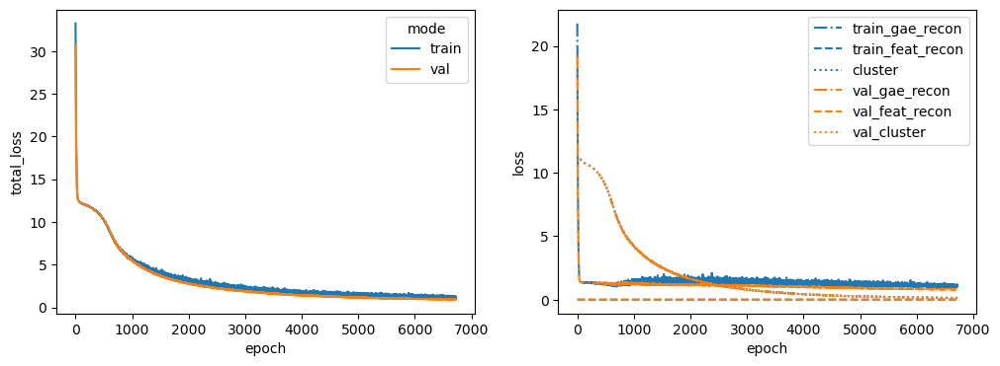

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


CDC42
Latent dim: 1024


 61%|██████    | 6089/10000 [01:47<01:09, 56.46it/s]


Training stopped after 6090 epochs
Best model found at epoch 5988
------------------------------------------------------------
TEST AUC: 0.8913646449704142 AP: 0.8453168034617815
TRAIN loss: 1.3160810470581055
VAL loss: 0.9342395067214966
TEST loss: 1.550029993057251
TEST AUC: 0.8913646449704142 	 AP: 0.8453168034617815


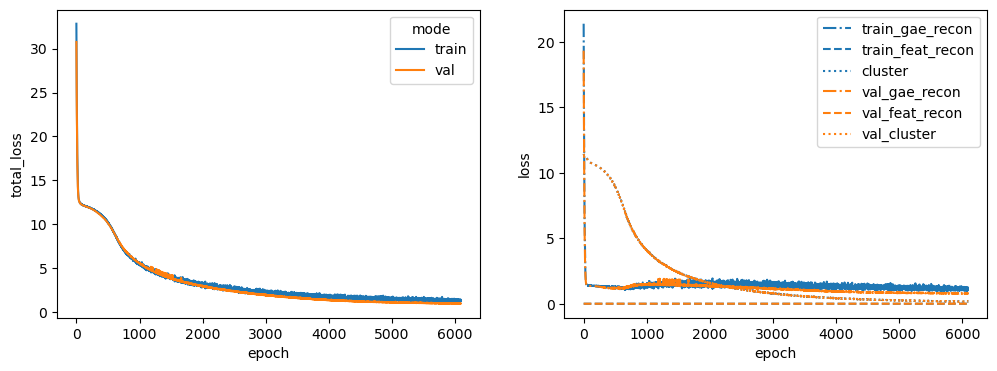

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


CDKN1A
Latent dim: 1024


 54%|█████▍    | 5435/10000 [01:33<01:18, 57.95it/s]


Training stopped after 5436 epochs
Best model found at epoch 5334
------------------------------------------------------------
TEST AUC: 0.9121671597633135 AP: 0.8889547772160556
TRAIN loss: 1.3851439952850342
VAL loss: 1.0086004734039307
TEST loss: 1.3576123714447021
TEST AUC: 0.9121671597633135 	 AP: 0.8889547772160556


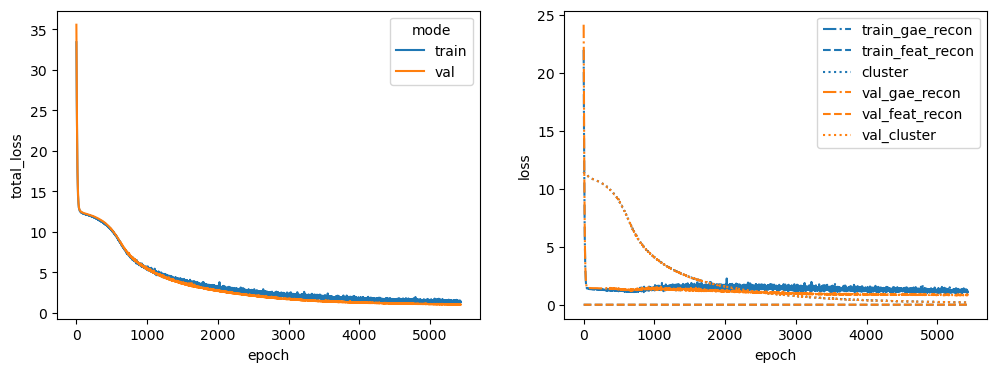

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


CEBPA
Latent dim: 1024


 42%|████▏     | 4170/10000 [01:12<01:40, 57.86it/s]


Training stopped after 4171 epochs
Best model found at epoch 4069
------------------------------------------------------------
TEST AUC: 0.9015347633136096 AP: 0.8823979934152766
TRAIN loss: 1.7453558444976807
VAL loss: 1.3265149593353271
TEST loss: 1.5214358568191528
TEST AUC: 0.9015347633136096 	 AP: 0.8823979934152766


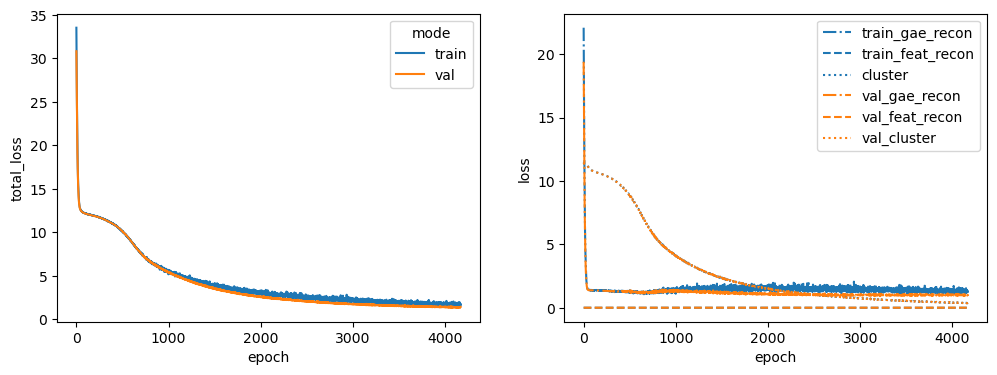

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


CREB1
Latent dim: 1024


 69%|██████▉   | 6938/10000 [02:00<00:53, 57.43it/s]


Training stopped after 6939 epochs
Best model found at epoch 6837
------------------------------------------------------------
TEST AUC: 0.9391642011834318 AP: 0.9160848084325507
TRAIN loss: 1.0769885778427124
VAL loss: 1.4580469131469727
TEST loss: 1.156752347946167
TEST AUC: 0.9391642011834318 	 AP: 0.9160848084325507


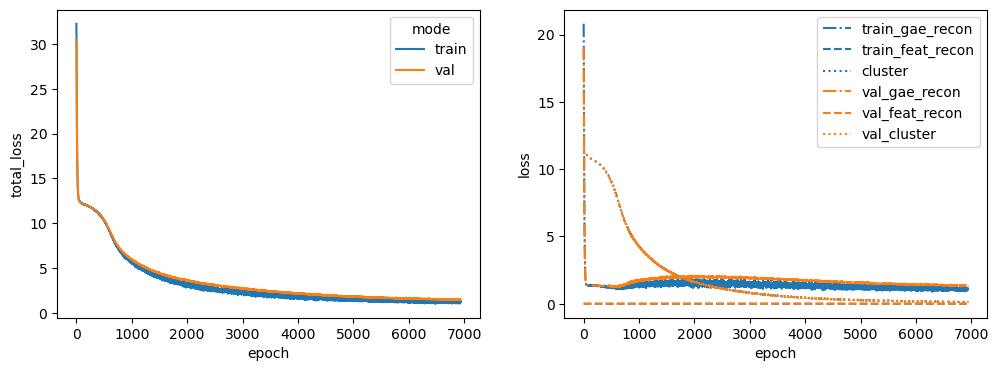

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


CXXC4
Latent dim: 1024


 59%|█████▊    | 5864/10000 [01:42<01:12, 57.21it/s]


Training stopped after 5865 epochs
Best model found at epoch 5763
------------------------------------------------------------
TEST AUC: 0.9461908284023668 AP: 0.937226086883665
TRAIN loss: 1.3518741130828857
VAL loss: 1.1969444751739502
TEST loss: 1.0961226224899292
TEST AUC: 0.9461908284023668 	 AP: 0.937226086883665


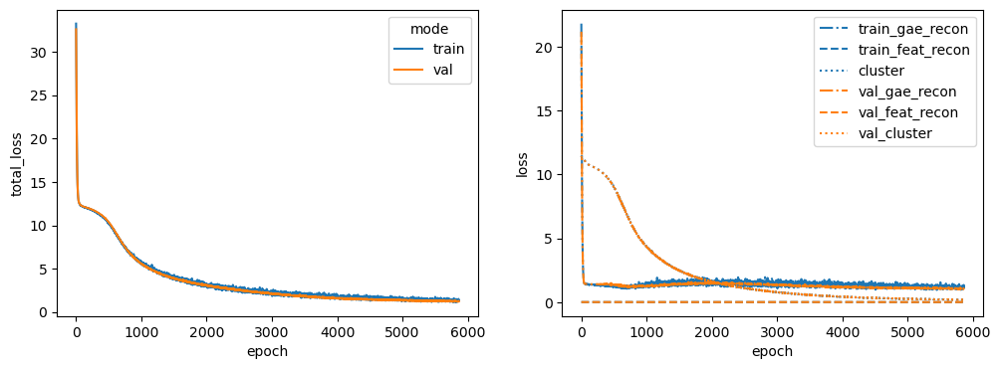

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


DIABLO
Latent dim: 1024


 68%|██████▊   | 6808/10000 [01:57<00:55, 57.83it/s]


Training stopped after 6809 epochs
Best model found at epoch 6707
------------------------------------------------------------
TEST AUC: 0.9541420118343196 AP: 0.9491188777187766
TRAIN loss: 1.1535320281982422
VAL loss: 1.0328292846679688
TEST loss: 1.0640124082565308
TEST AUC: 0.9541420118343196 	 AP: 0.9491188777187766


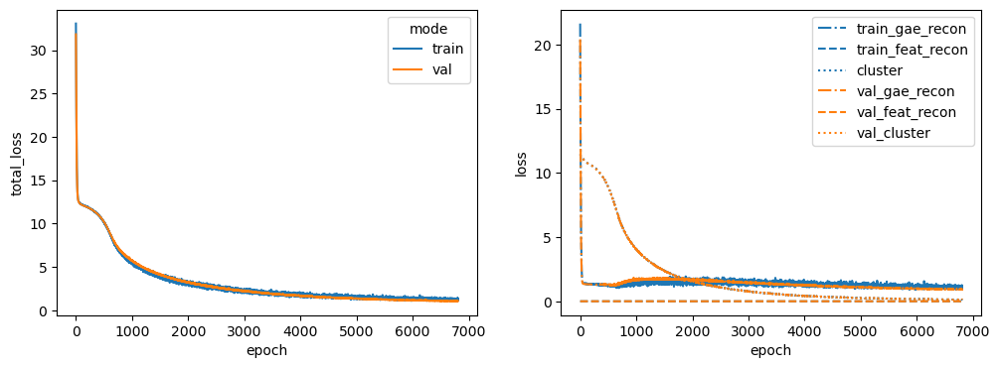

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


E2F1
Latent dim: 1024


 18%|█▊        | 1830/10000 [00:32<02:24, 56.52it/s]


Training stopped after 1831 epochs
Best model found at epoch 1729
------------------------------------------------------------
TEST AUC: 0.8460613905325444 AP: 0.7804459931218704
TRAIN loss: 3.5535356998443604
VAL loss: 3.2213268280029297
TEST loss: 4.074007511138916
TEST AUC: 0.8460613905325444 	 AP: 0.7804459931218704


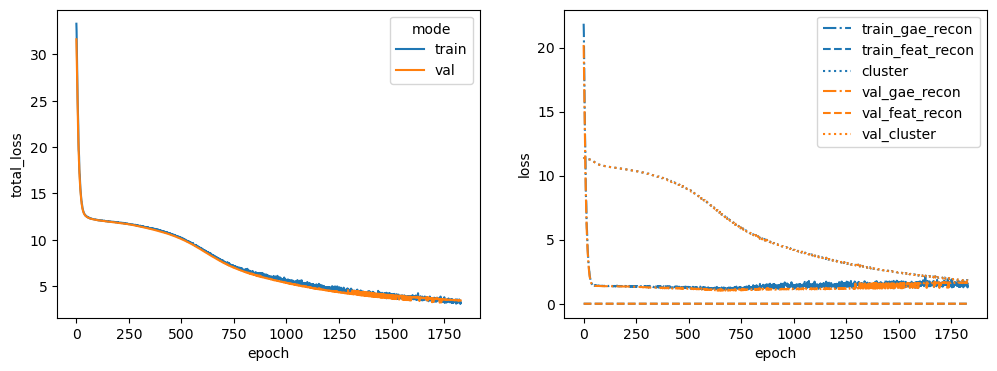

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


ELK1
Latent dim: 1024


 61%|██████    | 6114/10000 [01:46<01:07, 57.50it/s]


Training stopped after 6115 epochs
Best model found at epoch 6013
------------------------------------------------------------
TEST AUC: 0.9056028106508875 AP: 0.8566817251524854
TRAIN loss: 1.445605993270874
VAL loss: 0.9743130207061768
TEST loss: 1.4742684364318848
TEST AUC: 0.9056028106508875 	 AP: 0.8566817251524854


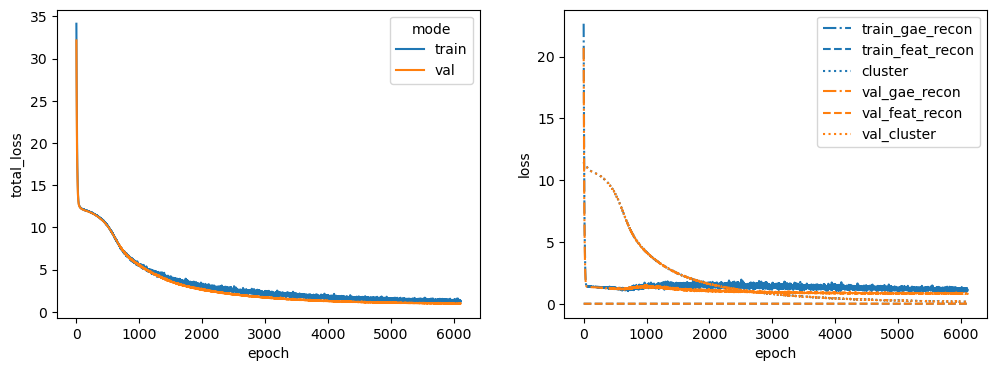

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


EMPTY
Latent dim: 1024


 13%|█▎        | 1340/10000 [00:23<02:34, 55.98it/s]


Training stopped after 1341 epochs
Best model found at epoch 1239
------------------------------------------------------------
TEST AUC: 0.8684818786982248 AP: 0.8340540654135449
TRAIN loss: 4.684314727783203
VAL loss: 5.138183116912842
TEST loss: 4.768742084503174
TEST AUC: 0.8684818786982248 	 AP: 0.8340540654135449


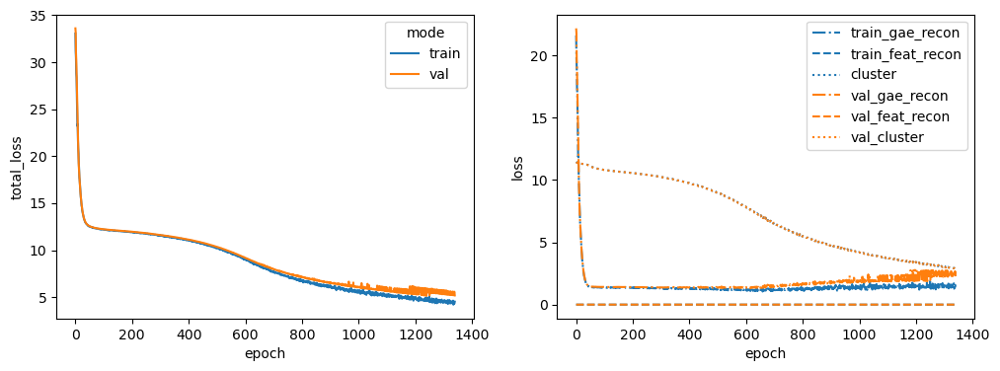

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


ERG
Latent dim: 1024


 78%|███████▊  | 7819/10000 [02:16<00:37, 57.42it/s]


Training stopped after 7820 epochs
Best model found at epoch 7718
------------------------------------------------------------
TEST AUC: 0.9480399408284024 AP: 0.9405099914328688
TRAIN loss: 1.191481113433838
VAL loss: 1.1903668642044067
TEST loss: 0.9537467360496521
TEST AUC: 0.9480399408284024 	 AP: 0.9405099914328688


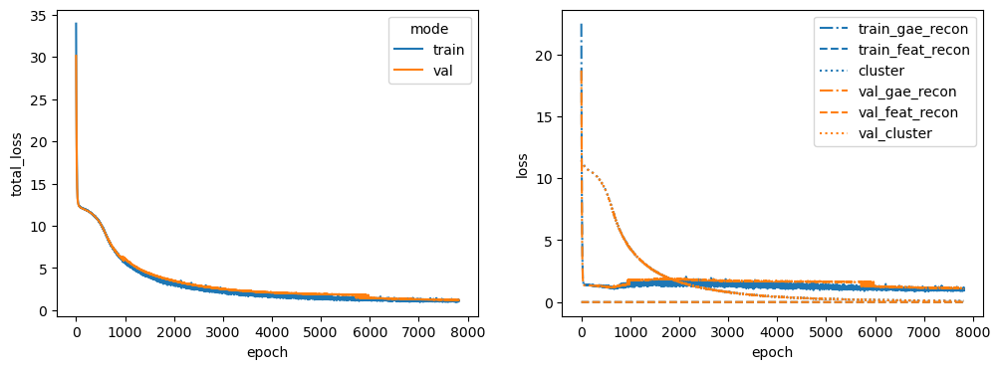

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


FGFR3
Latent dim: 1024


 52%|█████▏    | 5152/10000 [01:30<01:24, 57.18it/s]


Training stopped after 5153 epochs
Best model found at epoch 5051
------------------------------------------------------------
TEST AUC: 0.8903476331360947 AP: 0.8696513082370011
TRAIN loss: 1.401758074760437
VAL loss: 1.1872955560684204
TEST loss: 1.555061936378479
TEST AUC: 0.8903476331360947 	 AP: 0.8696513082370011


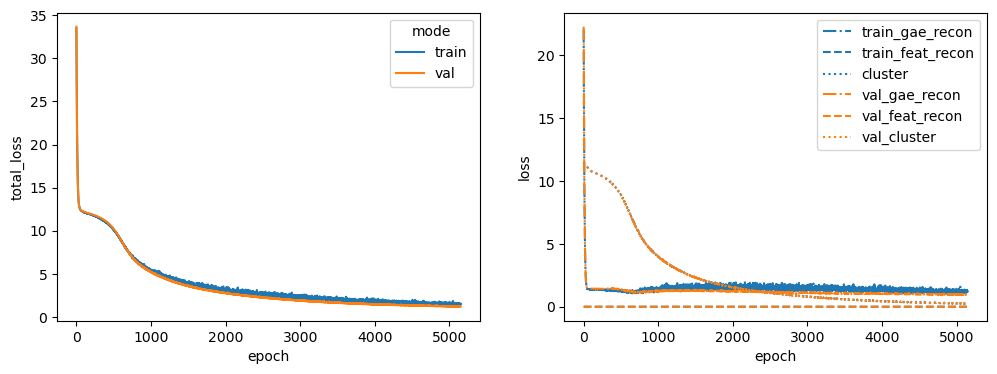

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


FOXO1
Latent dim: 1024


 22%|██▏       | 2161/10000 [00:37<02:16, 57.26it/s]


Training stopped after 2162 epochs
Best model found at epoch 2060
------------------------------------------------------------
TEST AUC: 0.8896079881656804 AP: 0.8845365260144572
TRAIN loss: 2.987381935119629
VAL loss: 3.5703890323638916
TEST loss: 2.8170278072357178
TEST AUC: 0.8896079881656804 	 AP: 0.8845365260144572


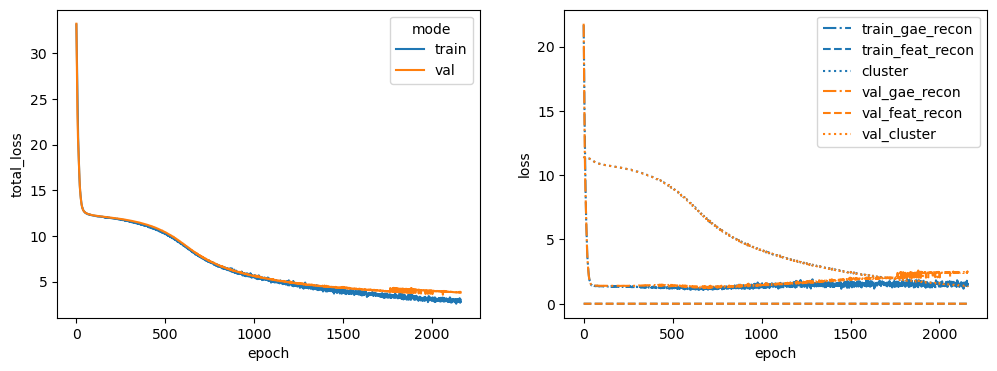

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


GLI1
Latent dim: 1024


 16%|█▋        | 1631/10000 [00:29<02:29, 56.10it/s]


Training stopped after 1632 epochs
Best model found at epoch 1530
------------------------------------------------------------
TEST AUC: 0.8524408284023668 AP: 0.8445854803451093
TRAIN loss: 3.796854019165039
VAL loss: 4.45946741104126
TEST loss: 3.849637985229492
TEST AUC: 0.8524408284023668 	 AP: 0.8445854803451093


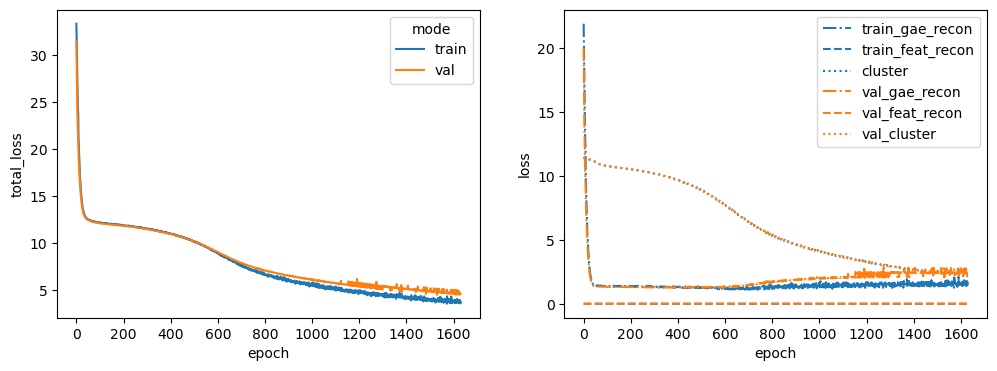

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


HRAS
Latent dim: 1024


 65%|██████▌   | 6503/10000 [01:53<01:01, 57.29it/s]


Training stopped after 6504 epochs
Best model found at epoch 6402
------------------------------------------------------------
TEST AUC: 0.907451923076923 AP: 0.8633056686151119
TRAIN loss: 1.2765312194824219
VAL loss: 0.7593503594398499
TEST loss: 1.3737744092941284
TEST AUC: 0.907451923076923 	 AP: 0.8633056686151119


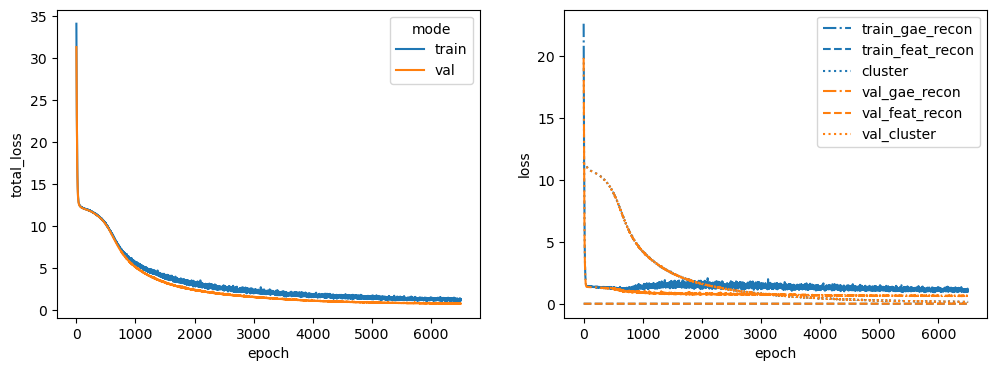

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


IRAK4
Latent dim: 1024


 66%|██████▋   | 6649/10000 [01:56<00:58, 57.13it/s]


Training stopped after 6650 epochs
Best model found at epoch 6548
------------------------------------------------------------
TEST AUC: 0.9256656804733727 AP: 0.9002733152503374
TRAIN loss: 1.2904529571533203
VAL loss: 1.767075538635254
TEST loss: 1.2234046459197998
TEST AUC: 0.9256656804733727 	 AP: 0.9002733152503374


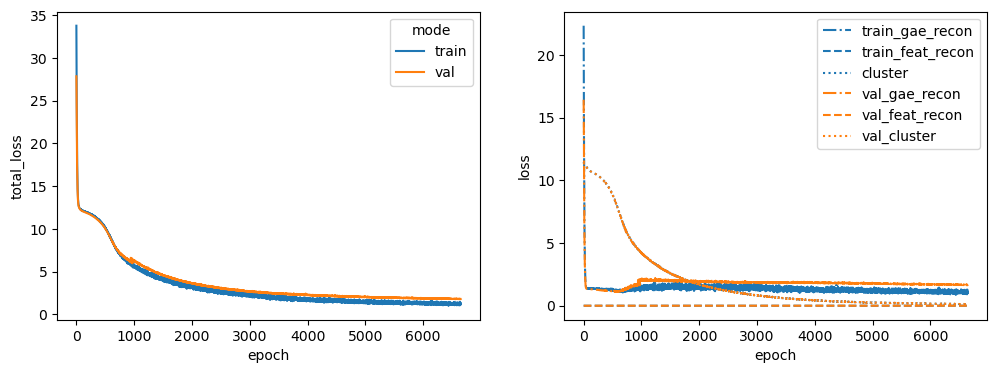

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


JUN
Latent dim: 1024


 65%|██████▌   | 6503/10000 [01:53<01:00, 57.43it/s]


Training stopped after 6504 epochs
Best model found at epoch 6402
------------------------------------------------------------
TEST AUC: 0.9588572485207101 AP: 0.9559741276383675
TRAIN loss: 1.3309566974639893
VAL loss: 1.0067576169967651
TEST loss: 1.0018597841262817
TEST AUC: 0.9588572485207101 	 AP: 0.9559741276383675


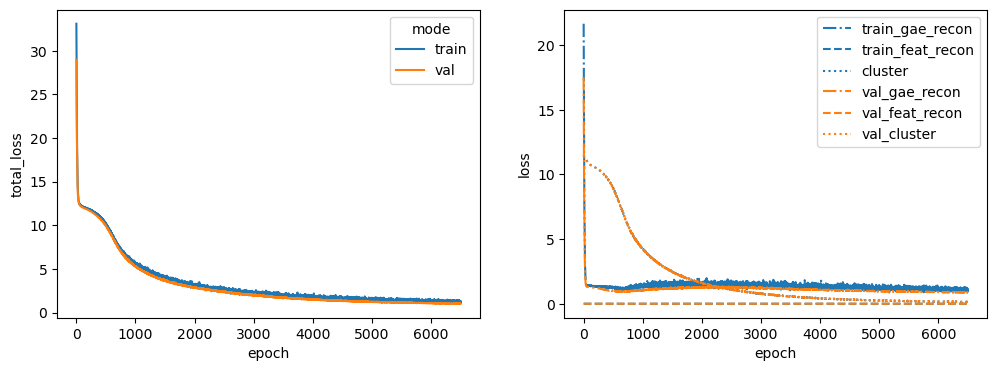

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


MAP2K3
Latent dim: 1024


 55%|█████▌    | 5549/10000 [01:36<01:17, 57.61it/s]


Training stopped after 5550 epochs
Best model found at epoch 5448
------------------------------------------------------------
TEST AUC: 0.8355214497041419 AP: 0.7805879196387637
TRAIN loss: 1.3685060739517212
VAL loss: 1.4799861907958984
TEST loss: 1.9641770124435425
TEST AUC: 0.8355214497041419 	 AP: 0.7805879196387637


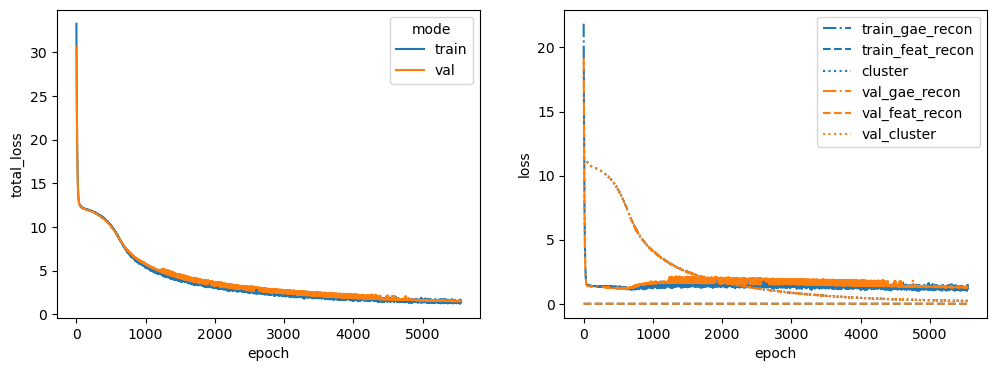

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


MAP3K2
Latent dim: 1024


 54%|█████▍    | 5434/10000 [01:35<01:20, 56.95it/s]


Training stopped after 5435 epochs
Best model found at epoch 5333
------------------------------------------------------------
TEST AUC: 0.9235392011834319 AP: 0.8817813261415947
TRAIN loss: 1.3121216297149658
VAL loss: 1.229336142539978
TEST loss: 1.594673991203308
TEST AUC: 0.9235392011834319 	 AP: 0.8817813261415947


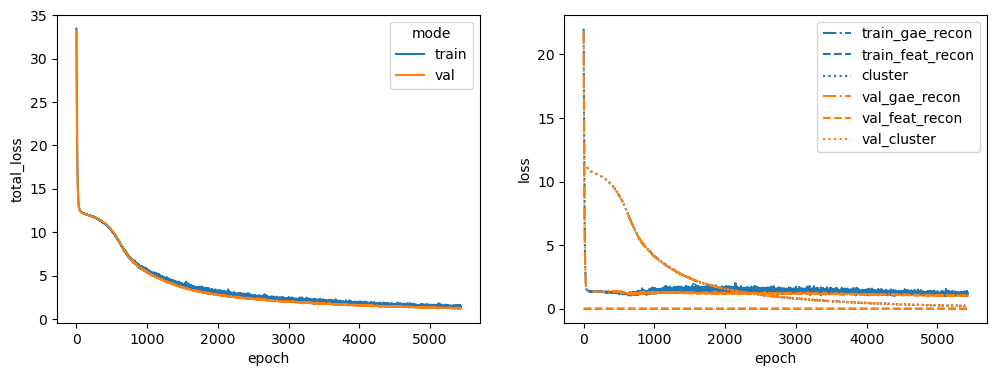

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


MAP3K5
Latent dim: 1024


 72%|███████▏  | 7154/10000 [02:05<00:49, 57.23it/s]


Training stopped after 7155 epochs
Best model found at epoch 7053
------------------------------------------------------------
TEST AUC: 0.9219674556213018 AP: 0.8833796292450085
TRAIN loss: 1.186690092086792
VAL loss: 0.8627445697784424
TEST loss: 1.2276674509048462
TEST AUC: 0.9219674556213018 	 AP: 0.8833796292450085


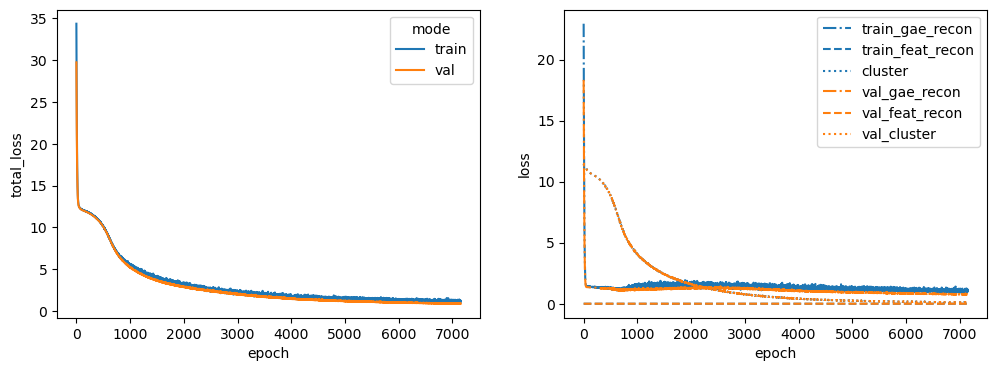

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


MAP3K9
Latent dim: 1024


 64%|██████▎   | 6356/10000 [01:49<01:03, 57.80it/s]


Training stopped after 6357 epochs
Best model found at epoch 6255
------------------------------------------------------------
TEST AUC: 0.9061113165680473 AP: 0.8672610604974715
TRAIN loss: 1.2786225080490112
VAL loss: 1.3230183124542236
TEST loss: 1.403222918510437
TEST AUC: 0.9061113165680473 	 AP: 0.8672610604974715


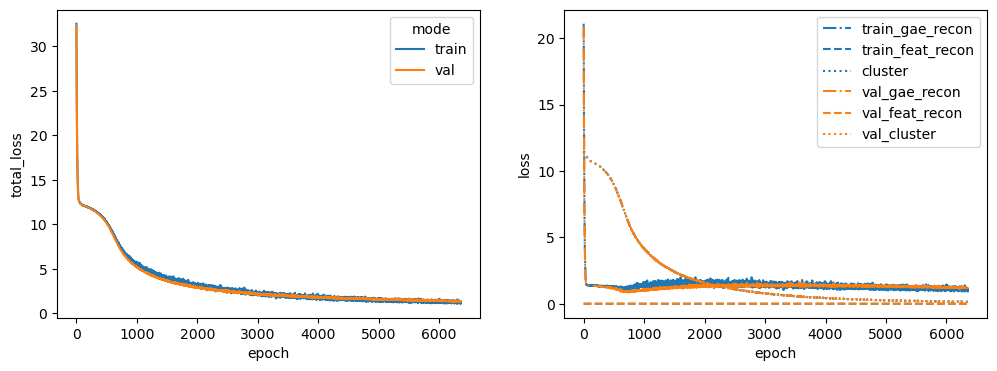

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


MAPK7
Latent dim: 1024


 57%|█████▋    | 5702/10000 [01:39<01:15, 57.12it/s]


Training stopped after 5703 epochs
Best model found at epoch 5601
------------------------------------------------------------
TEST AUC: 0.9182692307692308 AP: 0.89461069779129
TRAIN loss: 1.327791452407837
VAL loss: 1.225989818572998
TEST loss: 1.2981027364730835
TEST AUC: 0.9182692307692308 	 AP: 0.89461069779129


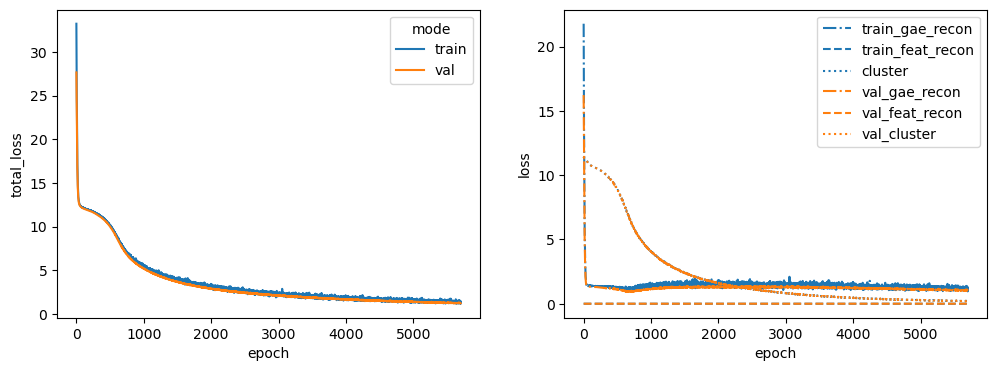

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


MOS
Latent dim: 1024


 51%|█████▏    | 5139/10000 [01:30<01:25, 57.10it/s]


Training stopped after 5140 epochs
Best model found at epoch 5038
------------------------------------------------------------
TEST AUC: 0.9255732248520712 AP: 0.8960256564410343
TRAIN loss: 1.4499237537384033
VAL loss: 1.1760683059692383
TEST loss: 1.358025074005127
TEST AUC: 0.9255732248520712 	 AP: 0.8960256564410343


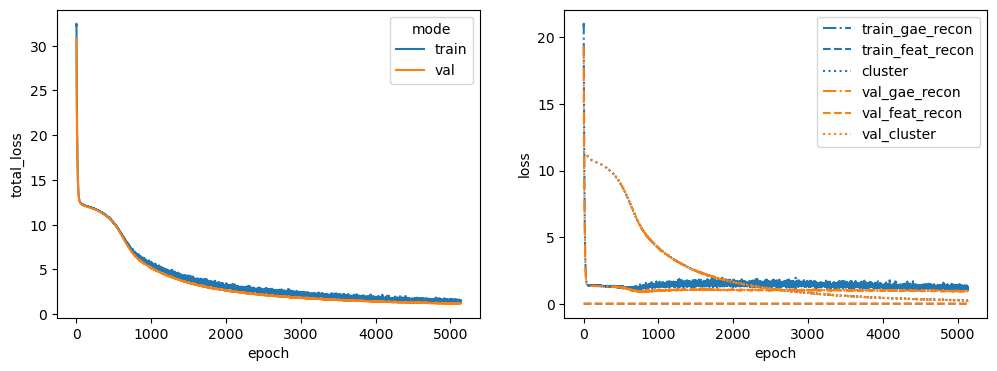

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


MYD88
Latent dim: 1024


 37%|███▋      | 3732/10000 [01:05<01:50, 56.58it/s]


Training stopped after 3733 epochs
Best model found at epoch 3631
------------------------------------------------------------
TEST AUC: 0.8924741124260357 AP: 0.8340401685718523
TRAIN loss: 1.6415284872055054
VAL loss: 1.4940133094787598
TEST loss: 2.276477098464966
TEST AUC: 0.8924741124260357 	 AP: 0.8340401685718523


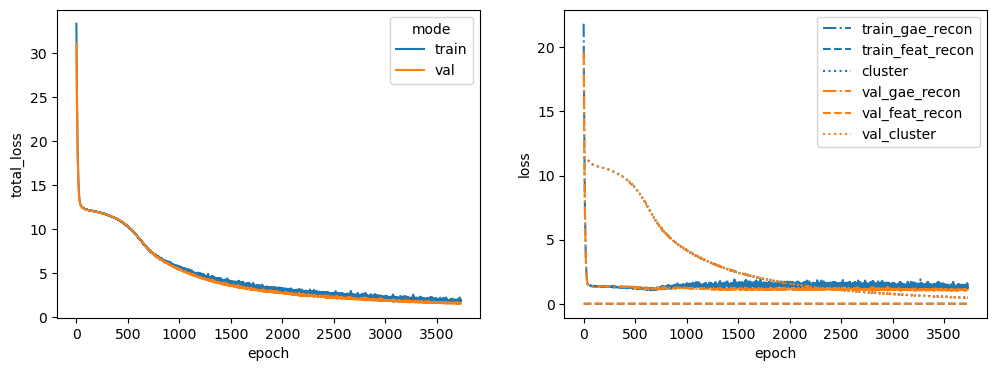

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


PIK3R2
Latent dim: 1024


 58%|█████▊    | 5794/10000 [01:41<01:13, 57.36it/s]


Training stopped after 5795 epochs
Best model found at epoch 5693
------------------------------------------------------------
TEST AUC: 0.9238165680473371 AP: 0.896983871246466
TRAIN loss: 1.2466809749603271
VAL loss: 1.1584742069244385
TEST loss: 1.466469168663025
TEST AUC: 0.9238165680473371 	 AP: 0.896983871246466


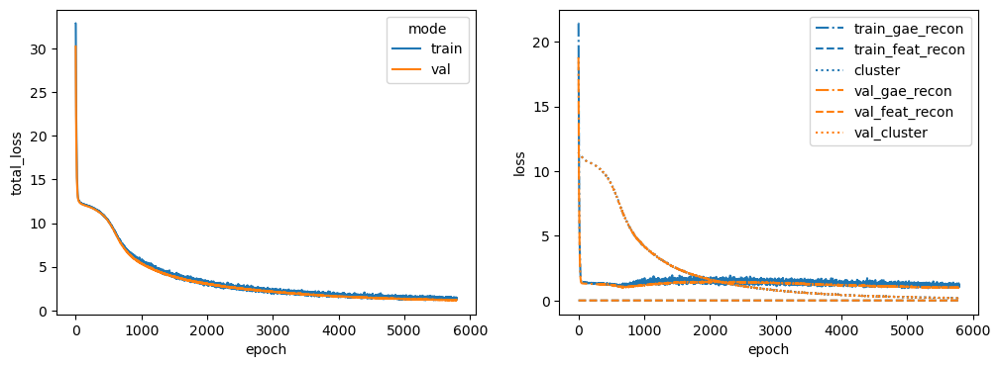

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


PRKACA
Latent dim: 1024


 64%|██████▍   | 6398/10000 [01:51<01:03, 57.13it/s]


Training stopped after 6399 epochs
Best model found at epoch 6297
------------------------------------------------------------
TEST AUC: 0.901719674556213 AP: 0.8556693674252536
TRAIN loss: 1.388838291168213
VAL loss: 1.3433825969696045
TEST loss: 1.5651646852493286
TEST AUC: 0.901719674556213 	 AP: 0.8556693674252536


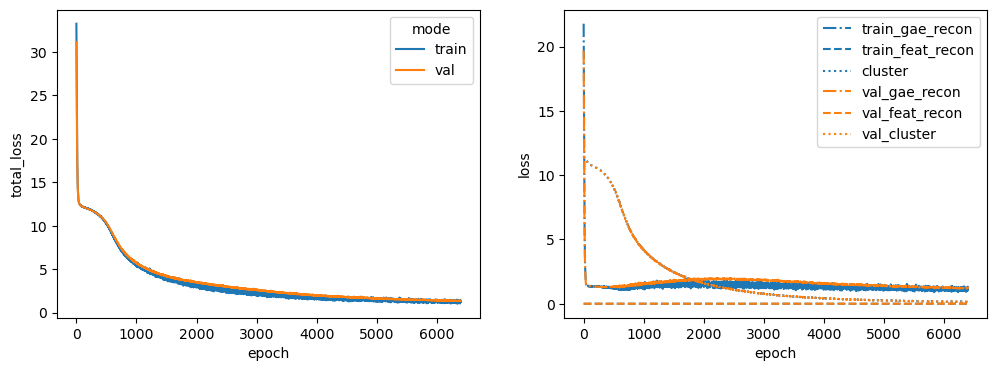

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


PRKCE
Latent dim: 1024


 53%|█████▎    | 5339/10000 [01:32<01:20, 57.61it/s]


Training stopped after 5340 epochs
Best model found at epoch 5238
------------------------------------------------------------
TEST AUC: 0.900055473372781 AP: 0.849142042962279
TRAIN loss: 1.3594768047332764
VAL loss: 1.4805006980895996
TEST loss: 1.6725637912750244
TEST AUC: 0.900055473372781 	 AP: 0.849142042962279


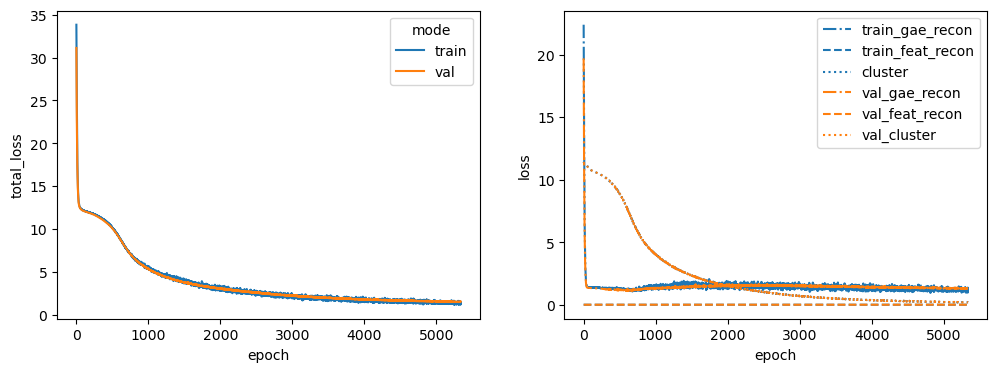

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


RAF1
Latent dim: 1024


 59%|█████▉    | 5894/10000 [01:42<01:11, 57.51it/s]


Training stopped after 5895 epochs
Best model found at epoch 5793
------------------------------------------------------------
TEST AUC: 0.9308894230769231 AP: 0.8887577464679918
TRAIN loss: 1.3862829208374023
VAL loss: 1.2039463520050049
TEST loss: 1.5226260423660278
TEST AUC: 0.9308894230769231 	 AP: 0.8887577464679918


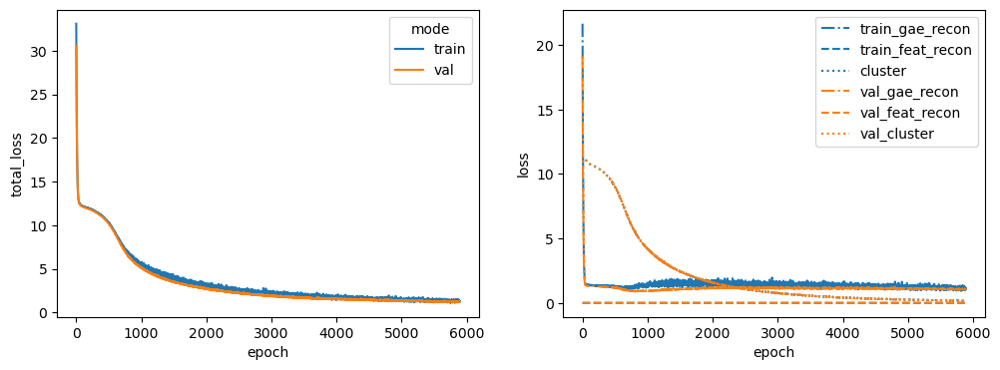

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


RELB
Latent dim: 1024


 58%|█████▊    | 5785/10000 [01:42<01:14, 56.34it/s]


Training stopped after 5786 epochs
Best model found at epoch 5684
------------------------------------------------------------
TEST AUC: 0.9192862426035503 AP: 0.8955056912479139
TRAIN loss: 1.5047821998596191
VAL loss: 1.270804524421692
TEST loss: 1.3061586618423462
TEST AUC: 0.9192862426035503 	 AP: 0.8955056912479139


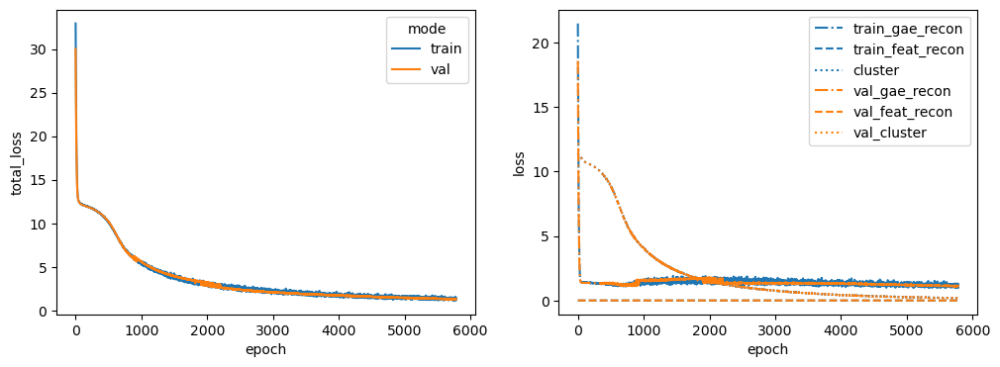

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


RHOA
Latent dim: 1024


 52%|█████▏    | 5160/10000 [01:30<01:25, 56.71it/s]


Training stopped after 5161 epochs
Best model found at epoch 5059
------------------------------------------------------------
TEST AUC: 0.937962278106509 AP: 0.9248230454312039
TRAIN loss: 1.483689546585083
VAL loss: 1.838683843612671
TEST loss: 1.280535340309143
TEST AUC: 0.937962278106509 	 AP: 0.9248230454312039


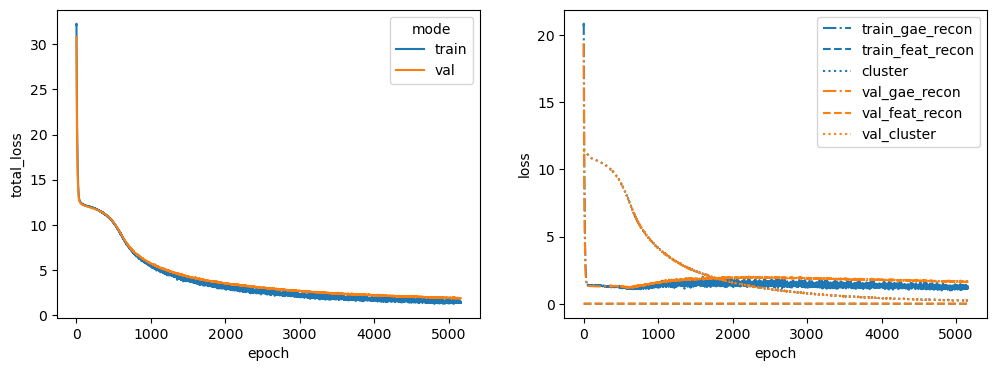

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


SMAD4
Latent dim: 1024


 20%|█▉        | 1961/10000 [00:34<02:21, 56.89it/s]


Training stopped after 1962 epochs
Best model found at epoch 1860
------------------------------------------------------------
TEST AUC: 0.8986686390532544 AP: 0.8870573535150379
TRAIN loss: 3.4215314388275146
VAL loss: 3.758239269256592
TEST loss: 2.979990243911743
TEST AUC: 0.8986686390532544 	 AP: 0.8870573535150379


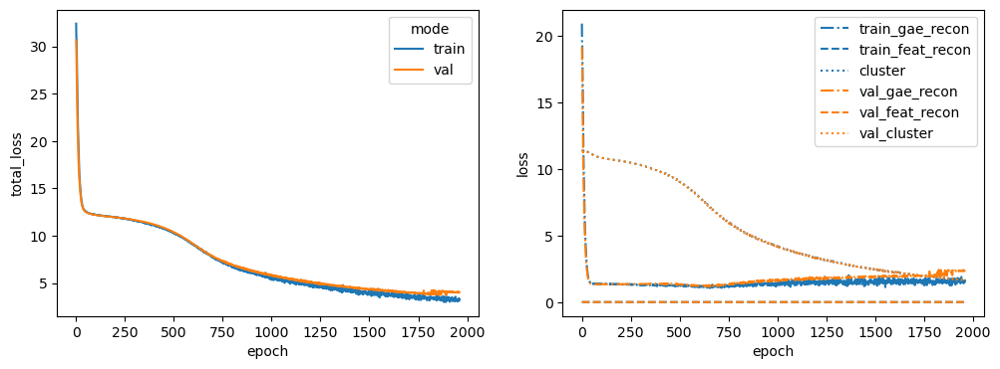

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


SMO
Latent dim: 1024


 61%|██████    | 6081/10000 [01:45<01:08, 57.38it/s]


Training stopped after 6082 epochs
Best model found at epoch 5980
------------------------------------------------------------
TEST AUC: 0.9266826923076923 AP: 0.9084255897712211
TRAIN loss: 1.6490190029144287
VAL loss: 1.2484344244003296
TEST loss: 1.1862648725509644
TEST AUC: 0.9266826923076923 	 AP: 0.9084255897712211


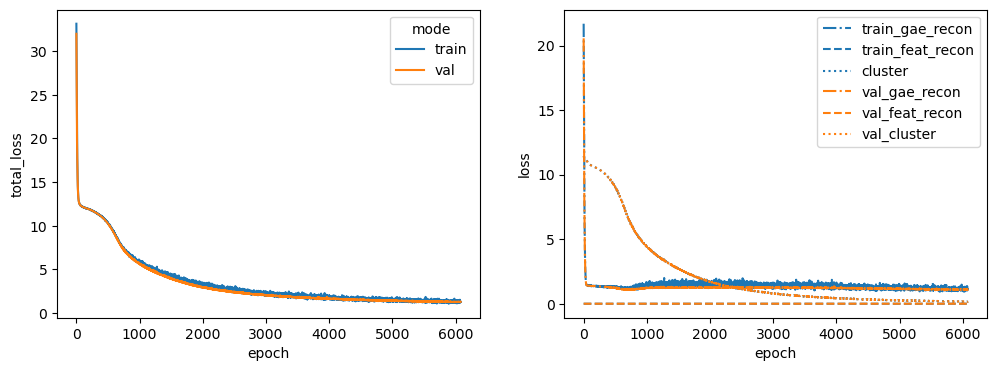

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


SRC
Latent dim: 1024


 46%|████▌     | 4604/10000 [01:19<01:33, 57.87it/s]


Training stopped after 4605 epochs
Best model found at epoch 4503
------------------------------------------------------------
TEST AUC: 0.8994082840236686 AP: 0.8644789425556088
TRAIN loss: 1.6529901027679443
VAL loss: 1.3433207273483276
TEST loss: 1.5577199459075928
TEST AUC: 0.8994082840236686 	 AP: 0.8644789425556088


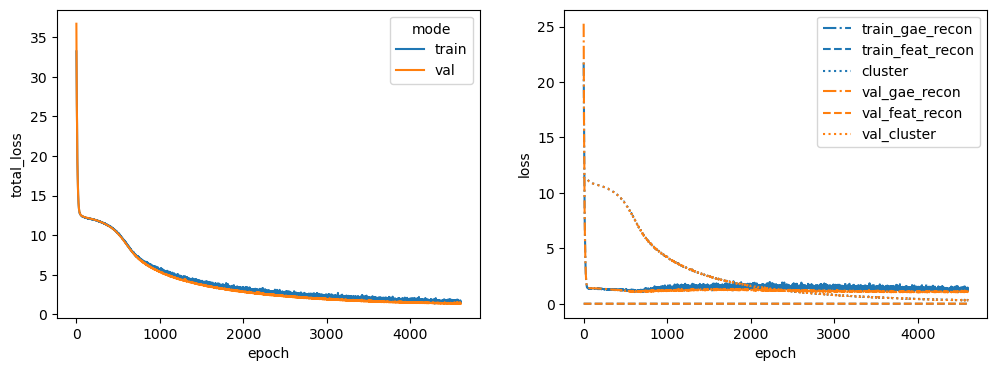

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


SREBF1
Latent dim: 1024


 73%|███████▎  | 7261/10000 [02:05<00:47, 57.81it/s]


Training stopped after 7262 epochs
Best model found at epoch 7160
------------------------------------------------------------
TEST AUC: 0.9069896449704142 AP: 0.856289379733063
TRAIN loss: 1.2013757228851318
VAL loss: 0.9322762489318848
TEST loss: 1.3862723112106323
TEST AUC: 0.9069896449704142 	 AP: 0.856289379733063


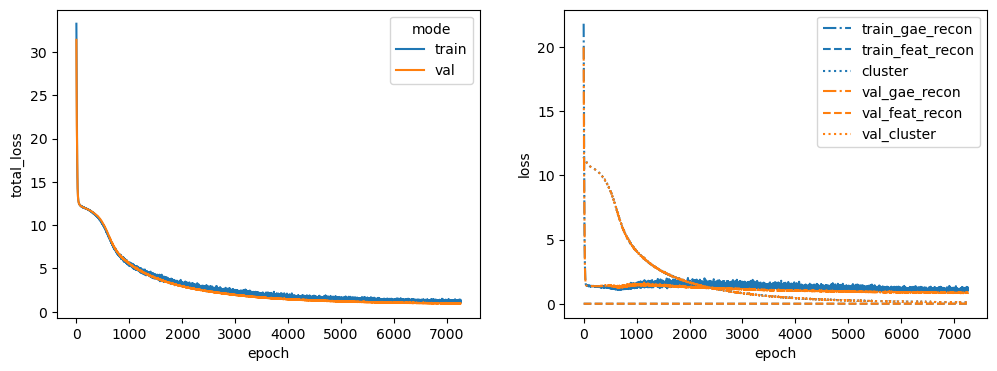

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


TRAF2
Latent dim: 1024


 63%|██████▎   | 6273/10000 [01:49<01:05, 57.28it/s]


Training stopped after 6274 epochs
Best model found at epoch 6172
------------------------------------------------------------
TEST AUC: 0.9182692307692307 AP: 0.8945459994684929
TRAIN loss: 1.2130721807479858
VAL loss: 1.0539557933807373
TEST loss: 1.183732271194458
TEST AUC: 0.9182692307692307 	 AP: 0.8945459994684929


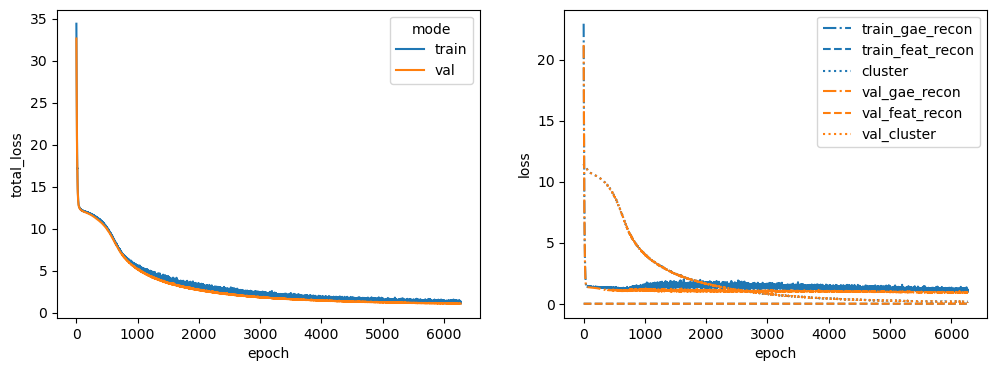

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


TSC2
Latent dim: 1024


 58%|█████▊    | 5791/10000 [01:41<01:13, 57.32it/s]


Training stopped after 5792 epochs
Best model found at epoch 5690
------------------------------------------------------------
TEST AUC: 0.9031065088757396 AP: 0.8968398165880832
TRAIN loss: 1.2891197204589844
VAL loss: 0.901978611946106
TEST loss: 1.2677457332611084
TEST AUC: 0.9031065088757396 	 AP: 0.8968398165880832


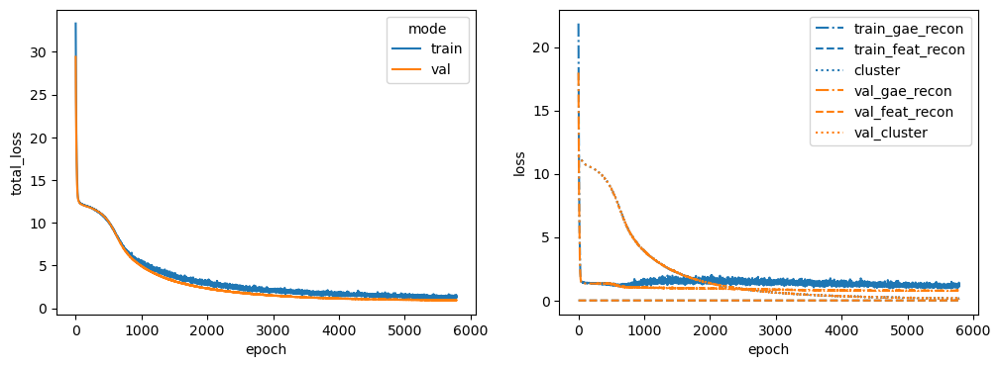

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


WWTR1
Latent dim: 1024


 54%|█████▍    | 5433/10000 [01:35<01:20, 57.06it/s]


Training stopped after 5434 epochs
Best model found at epoch 5332
------------------------------------------------------------
TEST AUC: 0.9397189349112426 AP: 0.9222523284787266
TRAIN loss: 1.346083641052246
VAL loss: 1.2595363855361938
TEST loss: 1.2140133380889893
TEST AUC: 0.9397189349112426 	 AP: 0.9222523284787266


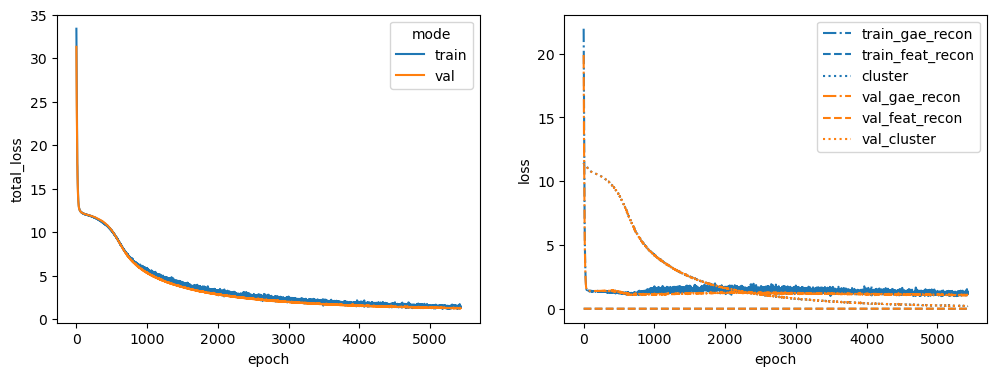

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


<IPython.core.display.Javascript object>

In [31]:
for cluster_opt in cluster_opts:

    graph_dict = {}
    for target in oe_targets:
        graph = spearman_interactome.copy()
        phy_clusters = phy_clusters_dict[target]
        phy_full_clusters = phy_full_clusters_dict[target]
        for node in graph.nodes(data=True):
            node[-1]["sc_gex"] = np.array(gex_data_z.loc[:, node[0]])
            node[-1]["sc_gex"] = node[-1]["sc_gex"]
            if cluster_opt == "cmap_full":
                if node[0] in cmap_clusters.index:
                    node[-1]["label"] = cmap_clusters.loc[node[0], "cluster"]
                    node[-1]["label_mask"] = True
                else:
                    node[-1]["label"] = -1
                    node[-1]["label_mask"] = False

            if cluster_opt == "cmap":
                if node[0] in cmap_clusters.index and node[0] != target:
                    node[-1]["label"] = cmap_clusters.loc[node[0], "cluster"]
                    node[-1]["label_mask"] = True
                else:
                    node[-1]["label"] = -1
                    node[-1]["label_mask"] = False

            if cluster_opt == "physical":
                if node[0] in phy_clusters.index and node[0] != target:
                    node[-1]["label"] = cmap_clusters.loc[node[0], "cluster"]
                    node[-1]["label_mask"] = True
                else:
                    node[-1]["label"] = -1
                    node[-1]["label_mask"] = False

            if cluster_opt == "physical_full":
                if node[0] in phy_full_clusters.index:
                    node[-1]["label"] = cmap_clusters.loc[node[0], "cluster"]
                    node[-1]["label_mask"] = True
                else:
                    node[-1]["label"] = -1
                    node[-1]["label_mask"] = False

            node[-1]["name"] = node[0]
            node[-1]["spec_target"] = node[0] in oe_targets

            gene_memberships = []
            for geneset in hallmark_geneset_dict.values():
                if node[0] in geneset:
                    gene_memberships.append(1.0)
                else:
                    gene_memberships.append(0.0)

            node[-1]["hallmark"] = np.array(gene_memberships)
            node[-1]["sc_gex_hallmark"] = np.concatenate(
                [node[-1]["sc_gex"], node[-1]["hallmark"]]
            )
        graph_dict[target] = graph

    for graph_opt in graph_opts:
        for alpha_beta_gamma_opt in alpha_beta_gamma_opts:

            for oe_target in oe_targets:
                print(oe_target)
                phy_clusters = phy_full_clusters_dict[oe_target].copy()
                if cluster_opt in ["cmap", "physical"]:
                    phy_clusters.loc[oe_target] = -1
                lut = dict(
                    zip(
                        list(np.unique(phy_clusters)),
                        [
                            "tab:blue",
                            "tab:red",
                            "tab:green",
                            "gold",
                            "tab:orange",
                            "tab:cyan",
                            "tab:purple",
                            "tab:pink",
                            "tab:olive",
                            "olivedrab",
                            "tab:brown",
                        ],
                    )
                )
                phy_clusters.loc[:, "color"] = phy_clusters.loc[:, "cluster"].map(lut)
                spearman_interactome = graph_dict[oe_target]

                device = torch.device("cpu")

                graph_data = from_networkx(spearman_interactome)
                graph_data.id = torch.FloatTensor(
                    np.identity(len(spearman_interactome))
                )
                graph_data = T.ToDevice(
                    device,
                    attrs=[
                        "id",
                        "sc_gex",
                        "label",
                        "label_mask",
                        "hallmark",
                        "sc_gex_hallmark",
                    ],
                )(graph_data)

                input_dim = 1176
                latent_dim = 1024

                class_weights = None

                gae = GAE(
                    GCNEncoder(
                        in_channels=input_dim, out_channels=latent_dim, hidden_dim=1024
                    )
                )
                feature_decoder = FeatureDecoder(
                    latent_dim=latent_dim,
                    hidden_dims=[1024],
                    output_dim=input_dim,
                    loss_fct=torch.nn.L1Loss(),
                )
                latent_classifier = LatentClassifier(
                    latent_dim=latent_dim,
                    hidden_dims=None,
                    n_classes=10,
                    loss_fct=None,
                    class_weights=class_weights,
                )

                seeds = [1234]
                alpha = alpha_beta_gamma_opt[0]
                beta = alpha_beta_gamma_opt[1]
                gamma = alpha_beta_gamma_opt[2]
                use_graph = graph_opt

                node_feature_key = "sc_gex_hallmark"
                edge_weight_key = None

                print("Latent dim: {}".format(1024))
                latents_dict, loss_hist_dict = get_gae_latents_for_seed(
                    graph_data=graph_data,
                    gae=gae,
                    seeds=seeds,
                    node_feature_key=node_feature_key,
                    edge_weight_key=edge_weight_key,
                    feature_decoder=feature_decoder,
                    latent_classifier=latent_classifier,
                    n_epochs=10000,
                    lr=0.00001,
                    split_type="link",
                    alpha=alpha,
                    beta=beta,
                    gamma=gamma,
                    plot_loss=True,
                    early_stopping=100,
                    use_full_graph=use_graph == "full_graph",
                    neg_edge_ratio=1.0,
                )

                output_dir = "../../../data/experiments/image_embeddings/specificity_target_emb_loto/embeddings/{}/pcst_confidence_0598_hub_999_pruned".format(
                    oe_target
                )

                output_dir = os.path.join(
                    output_dir,
                    "gae_exp_a{}_b{}_g{}_{}_{}".format(
                        alpha, beta, gamma, use_graph, cluster_opt
                    ),
                )
                os.makedirs(output_dir, exist_ok=True)

                latents = latents_dict[1234]
                node_names = getattr(graph_data, "name")
                st_memberships = getattr(graph_data, "spec_target")
                latents = pd.DataFrame(latents, index=node_names)

                embs = TSNE(
                    random_state=1234,
                    perplexity=int(np.sqrt(len(latents))) + 1,
                    init="pca",
                    learning_rate="auto",
                ).fit_transform(latents)
                embs = pd.DataFrame(
                    embs, columns=["tsne_0", "tsne_1"], index=node_names
                )
                embs["spec_target"] = st_memberships.cpu().numpy()

                fig, ax = plt.subplots(figsize=[20, 10])
                ax = sns.scatterplot(
                    data=embs, x="tsne_0", y="tsne_1", cmap="viridis", hue="spec_target"
                )
                label_point(
                    np.array(embs.loc[:, "tsne_0"]),
                    np.array(embs.loc[:, "tsne_1"]),
                    np.array(embs.index).astype("str"),
                    ax=ax,
                )
                ax.set_title("Visualization of the inferred embedding space")
                plt.savefig(
                    os.path.join(
                        output_dir,
                        "tsne_embs.png".format(alpha, beta, gamma, use_graph),
                    ),
                    bbox_inches="tight",
                )
                plt.close()

                ax = sns.clustermap(
                    latents.loc[set(oe_targets).intersection(latents.index)],
                    figsize=[6, 12],
                    metric="cosine",
                    method="complete",
                    cmap="seismic",
                    row_colors=np.array(
                        phy_clusters.loc[
                            set(oe_targets).intersection(latents.index), "color"
                        ]
                    ).ravel(),
                )
                ax.ax_heatmap.set_yticklabels(
                    ax.ax_heatmap.get_ymajorticklabels(),
                    fontsize=15,
                    fontweight="bold",
                )
                plt.savefig(
                    os.path.join(
                        output_dir,
                        "reg_clustering.png".format(alpha, beta, gamma, use_graph),
                    ),
                    bbox_inches="tight",
                )
                plt.close()

                latents.to_csv(
                    os.path.join(
                        output_dir,
                        "node_embs.csv".format(alpha, beta, gamma, use_graph),
                    )
                )

In [32]:
graph_dict = {}
for target in oe_targets:
    graph = spearman_interactome.copy()
    phy_clusters = phy_clusters_dict[target]
    phy_full_clusters = phy_full_clusters_dict[target]
    for node in graph.nodes(data=True):
        node[-1]["sc_gex"] = np.array(gex_data_z.loc[:, node[0]])
        node[-1]["sc_gex"] = node[-1]["sc_gex"]
        # if node[0] in phy_full_clusters.index and node[0] != target:
        if node[0] in cmap_clusters.index:
            node[-1]["label"] = cmap_clusters.loc[node[0], "cluster"]
            node[-1]["label_mask"] = True
        else:
            node[-1]["label"] = -1
            node[-1]["label_mask"] = False
        node[-1]["name"] = node[0]
        node[-1]["spec_target"] = node[0] in oe_targets

        gene_memberships = []
        for geneset in hallmark_geneset_dict.values():
            if node[0] in geneset:
                gene_memberships.append(1.0)
            else:
                gene_memberships.append(0.0)

        node[-1]["hallmark"] = np.array(gene_memberships)
        node[-1]["sc_gex_hallmark"] = np.concatenate(
            [node[-1]["sc_gex"], node[-1]["hallmark"]]
        )
    graph_dict[target] = graph

<IPython.core.display.Javascript object>

AKT1S1
Latent dim: 1024


 35%|███▍      | 3488/10000 [01:08<02:07, 51.21it/s]


Training stopped after 3489 epochs
Best model found at epoch 3387
------------------------------------------------------------
TEST AUC: 0.7506471893491125 AP: 0.7332294665715287
TRAIN loss: 1.1381936073303223
VAL loss: 1.4033117294311523
TEST loss: 1.7779734134674072
TEST AUC: 0.7506471893491125 	 AP: 0.7332294665715287


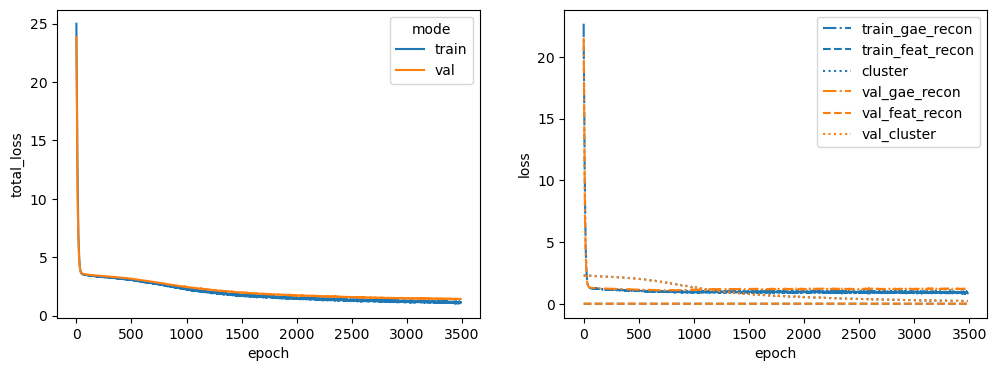

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


ATF4
Latent dim: 1024


 37%|███▋      | 3678/10000 [01:15<02:09, 48.73it/s]


Training stopped after 3679 epochs
Best model found at epoch 3577
------------------------------------------------------------
TEST AUC: 0.7863350591715976 AP: 0.8360348770908583
TRAIN loss: 1.083633303642273
VAL loss: 1.411425232887268
TEST loss: 1.5208277702331543
TEST AUC: 0.7863350591715976 	 AP: 0.8360348770908583


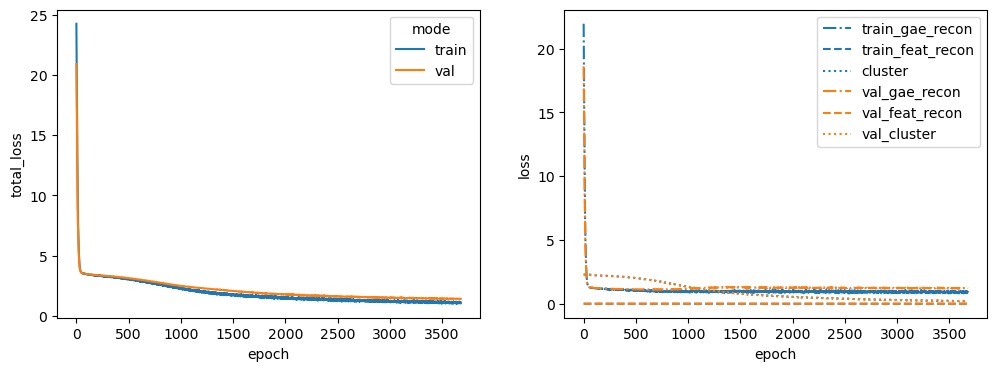

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


BAX
Latent dim: 1024


 27%|██▋       | 2699/10000 [00:53<02:26, 49.99it/s]


Training stopped after 2700 epochs
Best model found at epoch 2598
------------------------------------------------------------
TEST AUC: 0.7464866863905325 AP: 0.7737653190700642
TRAIN loss: 1.349187970161438
VAL loss: 1.4381048679351807
TEST loss: 1.8299951553344727
TEST AUC: 0.7464866863905325 	 AP: 0.7737653190700642


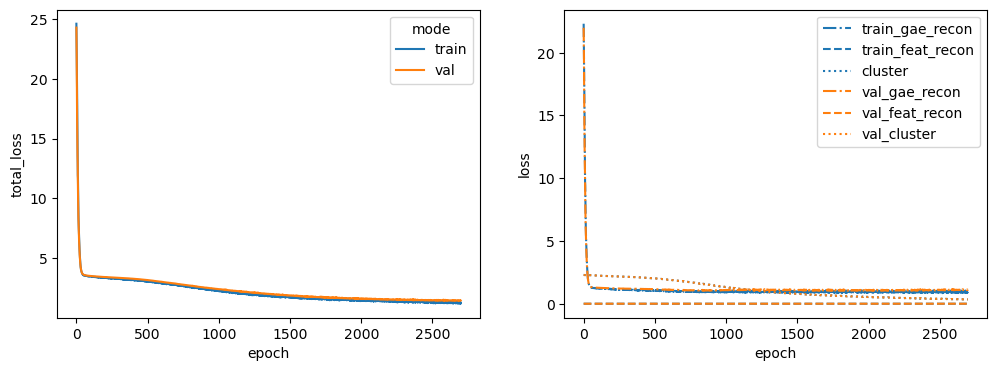

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


BCL2L11
Latent dim: 1024


 32%|███▏      | 3173/10000 [01:04<02:18, 49.20it/s]


Training stopped after 3174 epochs
Best model found at epoch 3072
------------------------------------------------------------
TEST AUC: 0.7729289940828402 AP: 0.7714138074646459
TRAIN loss: 1.153130054473877
VAL loss: 1.4971387386322021
TEST loss: 1.7174415588378906
TEST AUC: 0.7729289940828402 	 AP: 0.7714138074646459


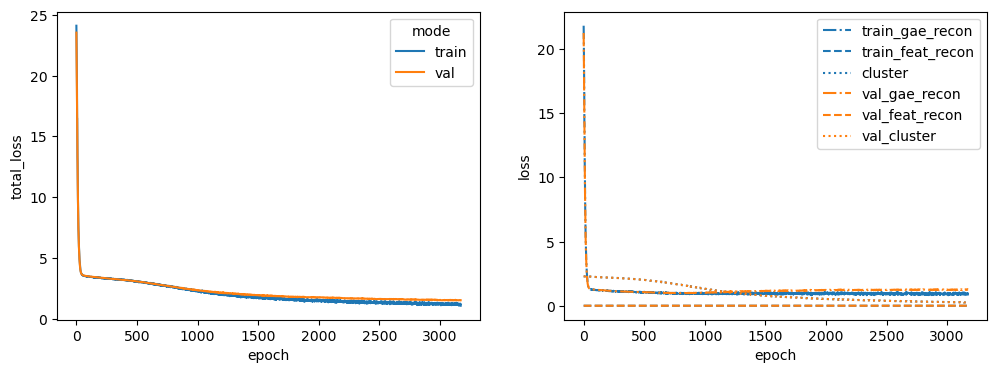

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


BRAF
Latent dim: 1024


 31%|███▏      | 3145/10000 [01:05<02:23, 47.81it/s]


Training stopped after 3146 epochs
Best model found at epoch 3044
------------------------------------------------------------
TEST AUC: 0.8027921597633135 AP: 0.8251918826039426
TRAIN loss: 1.240492343902588
VAL loss: 1.5769243240356445
TEST loss: 1.6345317363739014
TEST AUC: 0.8027921597633135 	 AP: 0.8251918826039426


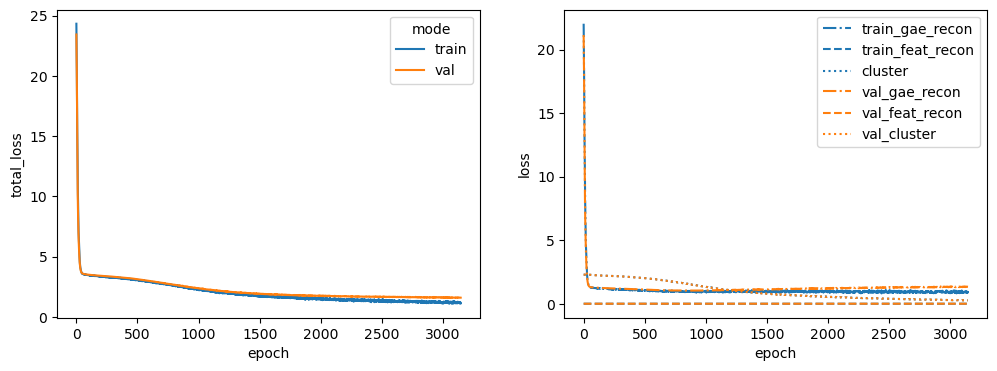

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


CASP8
Latent dim: 1024


 37%|███▋      | 3667/10000 [01:12<02:04, 50.90it/s]


Training stopped after 3668 epochs
Best model found at epoch 3566
------------------------------------------------------------
TEST AUC: 0.7991863905325444 AP: 0.8287073489196456
TRAIN loss: 1.1496386528015137
VAL loss: 1.5469626188278198
TEST loss: 1.500346064567566
TEST AUC: 0.7991863905325444 	 AP: 0.8287073489196456


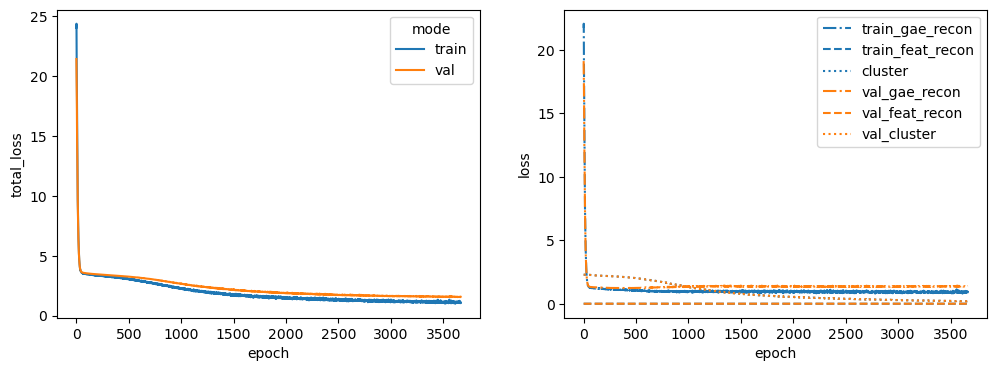

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


CDC42
Latent dim: 1024


 26%|██▌       | 2622/10000 [00:51<02:25, 50.62it/s]


Training stopped after 2623 epochs
Best model found at epoch 2521
------------------------------------------------------------
TEST AUC: 0.7781989644970414 AP: 0.8076406032066429
TRAIN loss: 1.3362752199172974
VAL loss: 1.6453461647033691
TEST loss: 1.7346211671829224
TEST AUC: 0.7781989644970414 	 AP: 0.8076406032066429


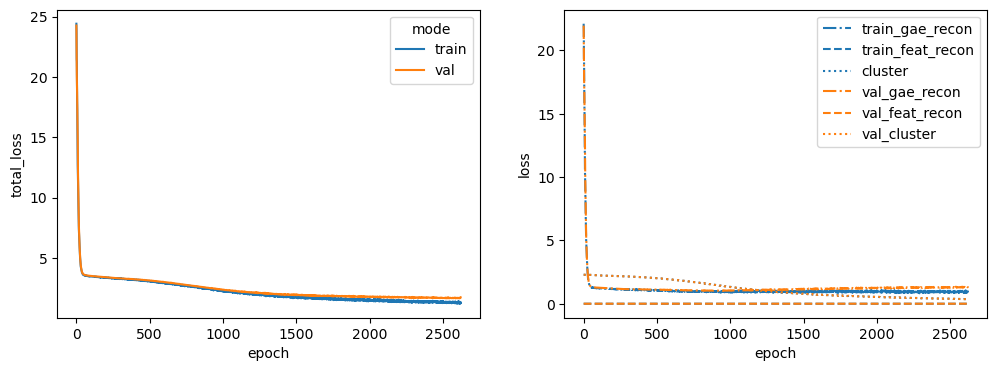

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


CDKN1A
Latent dim: 1024


 24%|██▍       | 2449/10000 [00:51<02:37, 47.80it/s]


Training stopped after 2450 epochs
Best model found at epoch 2348
------------------------------------------------------------
TEST AUC: 0.733542899408284 AP: 0.7315059797958144
TRAIN loss: 1.4158072471618652
VAL loss: 1.4649360179901123
TEST loss: 2.0077738761901855
TEST AUC: 0.733542899408284 	 AP: 0.7315059797958144


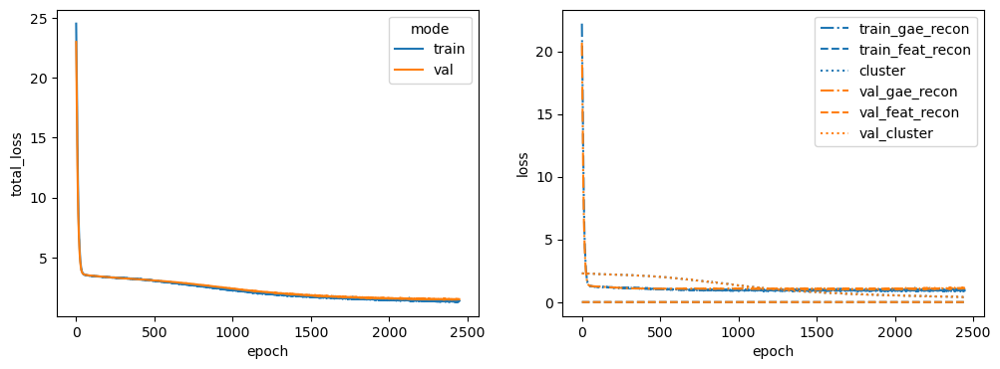

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


CEBPA
Latent dim: 1024


 29%|██▊       | 2852/10000 [01:00<02:31, 47.26it/s]


Training stopped after 2853 epochs
Best model found at epoch 2751
------------------------------------------------------------
TEST AUC: 0.7983542899408284 AP: 0.8276725457561416
TRAIN loss: 1.2081947326660156
VAL loss: 1.4074244499206543
TEST loss: 1.6539552211761475
TEST AUC: 0.7983542899408284 	 AP: 0.8276725457561416


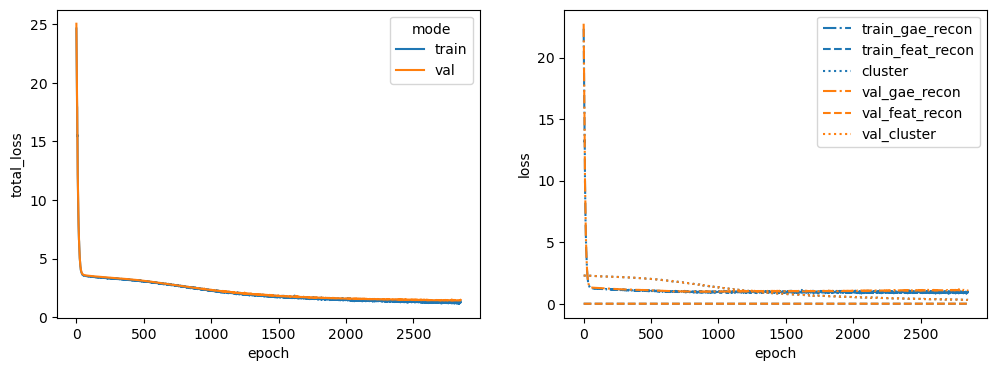

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


CREB1
Latent dim: 1024


 36%|███▌      | 3588/10000 [01:13<02:10, 48.98it/s]


Training stopped after 3589 epochs
Best model found at epoch 3487
------------------------------------------------------------
TEST AUC: 0.7501849112426036 AP: 0.7540371830109485
TRAIN loss: 1.1531808376312256
VAL loss: 1.490127682685852
TEST loss: 1.7273558378219604
TEST AUC: 0.7501849112426036 	 AP: 0.7540371830109485


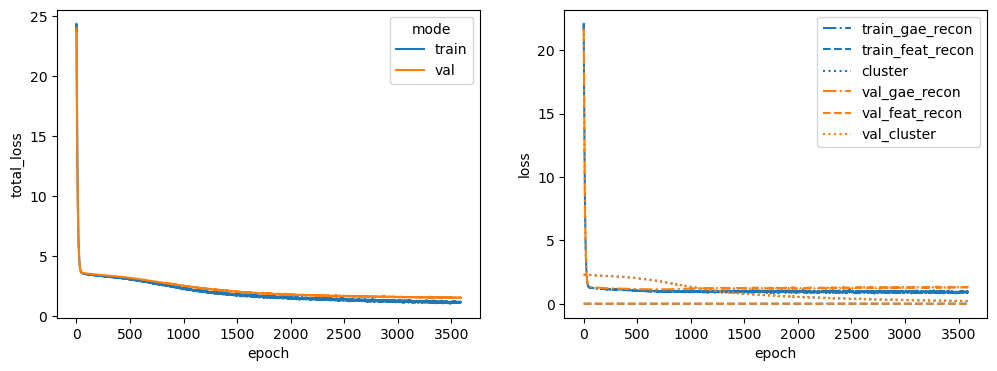

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


CXXC4
Latent dim: 1024


 27%|██▋       | 2712/10000 [00:55<02:30, 48.49it/s]


Training stopped after 2713 epochs
Best model found at epoch 2611
------------------------------------------------------------
TEST AUC: 0.774223372781065 AP: 0.7996615411361124
TRAIN loss: 1.3176831007003784
VAL loss: 1.551198959350586
TEST loss: 1.7442446947097778
TEST AUC: 0.774223372781065 	 AP: 0.7996615411361124


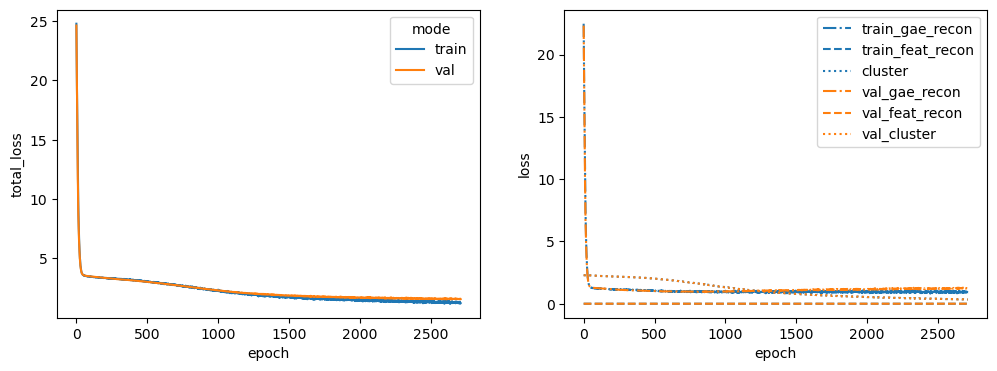

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


DIABLO
Latent dim: 1024


 37%|███▋      | 3663/10000 [01:14<02:09, 48.92it/s]


Training stopped after 3664 epochs
Best model found at epoch 3562
------------------------------------------------------------
TEST AUC: 0.7480584319526628 AP: 0.759738254097975
TRAIN loss: 1.0846461057662964
VAL loss: 1.6221356391906738
TEST loss: 1.6924169063568115
TEST AUC: 0.7480584319526628 	 AP: 0.759738254097975


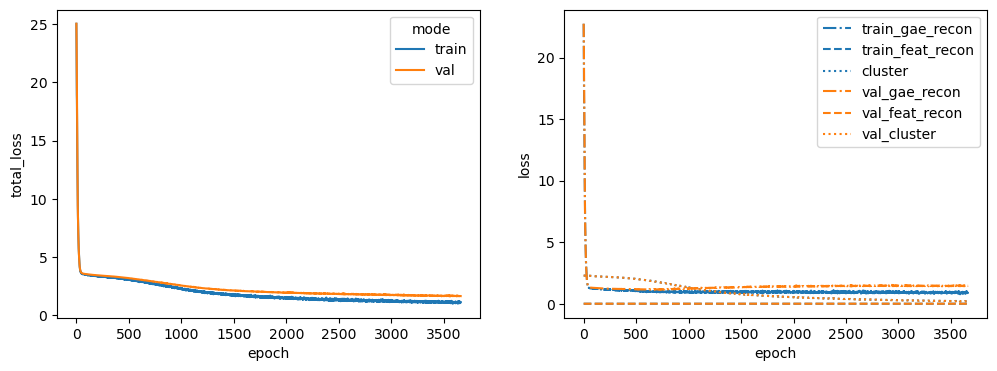

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


E2F1
Latent dim: 1024


 27%|██▋       | 2748/10000 [00:57<02:31, 47.84it/s]


Training stopped after 2749 epochs
Best model found at epoch 2647
------------------------------------------------------------
TEST AUC: 0.7646079881656804 AP: 0.7746298843655461
TRAIN loss: 1.2817542552947998
VAL loss: 1.3805065155029297
TEST loss: 1.8215417861938477
TEST AUC: 0.7646079881656804 	 AP: 0.7746298843655461


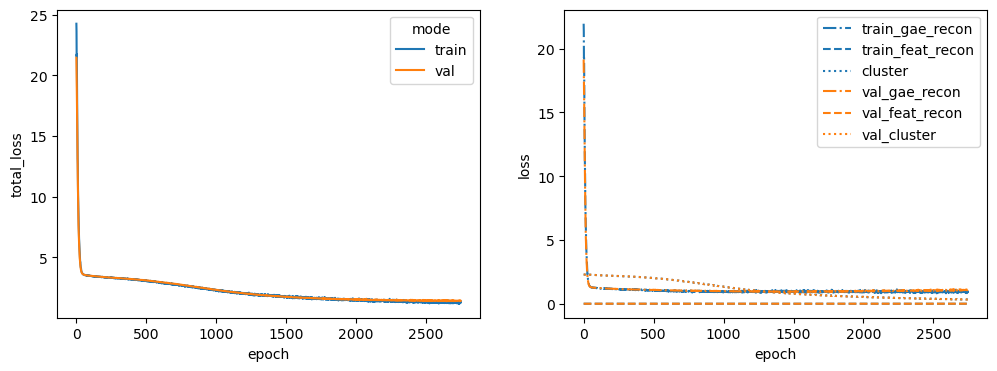

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


ELK1
Latent dim: 1024


 36%|███▌      | 3560/10000 [01:13<02:13, 48.15it/s]


Training stopped after 3561 epochs
Best model found at epoch 3459
------------------------------------------------------------
TEST AUC: 0.7576738165680473 AP: 0.790914087277204
TRAIN loss: 1.120250940322876
VAL loss: 1.5341936349868774
TEST loss: 1.6409530639648438
TEST AUC: 0.7576738165680473 	 AP: 0.790914087277204


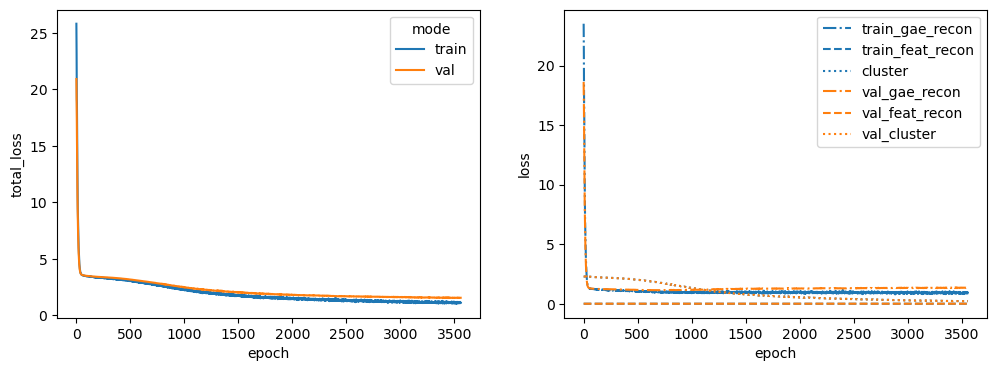

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


EMPTY
Latent dim: 1024


 34%|███▎      | 3372/10000 [01:08<02:13, 49.59it/s]


Training stopped after 3373 epochs
Best model found at epoch 3271
------------------------------------------------------------
TEST AUC: 0.7531434911242603 AP: 0.7611103400580881
TRAIN loss: 1.1268138885498047
VAL loss: 1.445296049118042
TEST loss: 1.7320246696472168
TEST AUC: 0.7531434911242603 	 AP: 0.7611103400580881


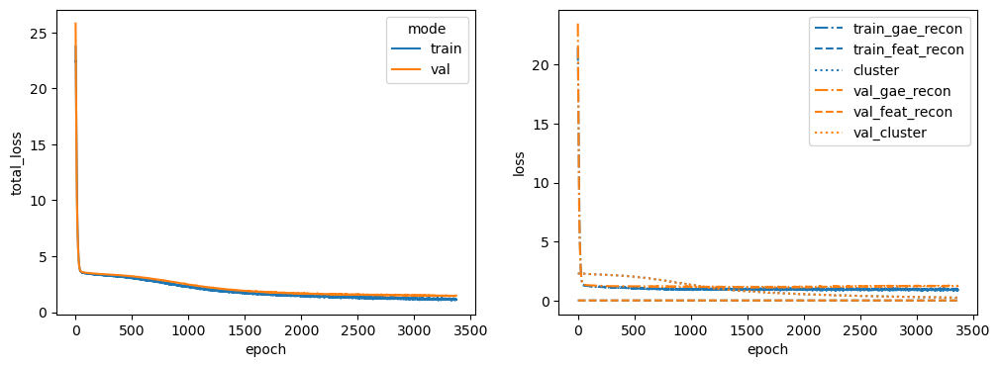

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


ERG
Latent dim: 1024


 29%|██▊       | 2874/10000 [00:58<02:24, 49.26it/s]


Training stopped after 2875 epochs
Best model found at epoch 2773
------------------------------------------------------------
TEST AUC: 0.7731139053254438 AP: 0.7843381595319247
TRAIN loss: 1.1906036138534546
VAL loss: 1.7555543184280396
TEST loss: 1.751237392425537
TEST AUC: 0.7731139053254438 	 AP: 0.7843381595319247


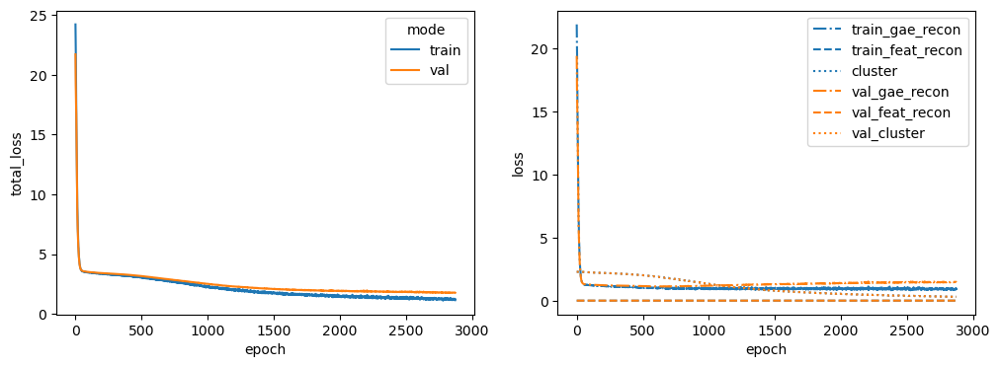

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


FGFR3
Latent dim: 1024


 36%|███▌      | 3568/10000 [01:11<02:09, 49.65it/s]


Training stopped after 3569 epochs
Best model found at epoch 3467
------------------------------------------------------------
TEST AUC: 0.7935465976331362 AP: 0.8152698541288437
TRAIN loss: 1.1405905485153198
VAL loss: 1.3839795589447021
TEST loss: 1.5548667907714844
TEST AUC: 0.7935465976331362 	 AP: 0.8152698541288437


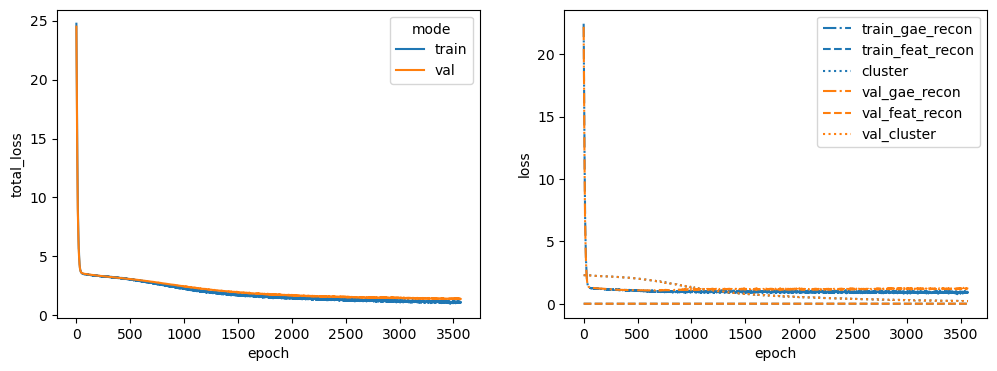

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


FOXO1
Latent dim: 1024


 25%|██▍       | 2454/10000 [00:50<02:35, 48.55it/s]


Training stopped after 2455 epochs
Best model found at epoch 2353
------------------------------------------------------------
TEST AUC: 0.7505547337278107 AP: 0.779484142666253
TRAIN loss: 1.3376096487045288
VAL loss: 1.6660374402999878
TEST loss: 1.8887693881988525
TEST AUC: 0.7505547337278107 	 AP: 0.779484142666253


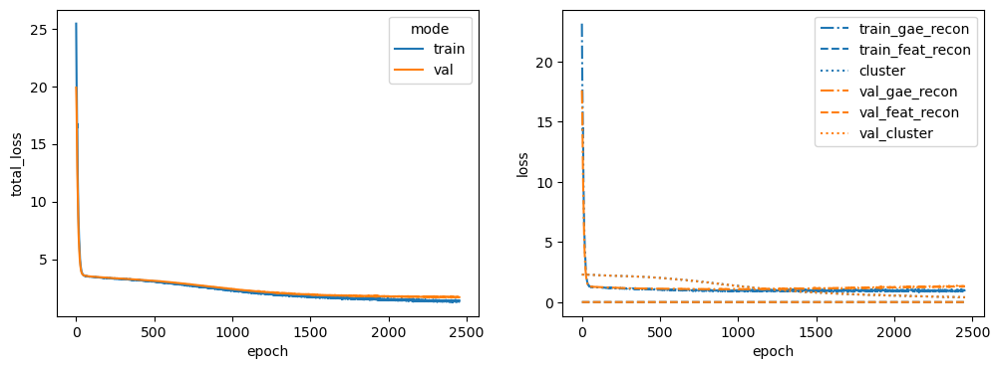

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


GLI1
Latent dim: 1024


 32%|███▏      | 3174/10000 [01:03<02:16, 49.93it/s]


Training stopped after 3175 epochs
Best model found at epoch 3073
------------------------------------------------------------
TEST AUC: 0.7543454142011834 AP: 0.753994629777399
TRAIN loss: 1.1403218507766724
VAL loss: 1.589432954788208
TEST loss: 1.8144572973251343
TEST AUC: 0.7543454142011834 	 AP: 0.753994629777399


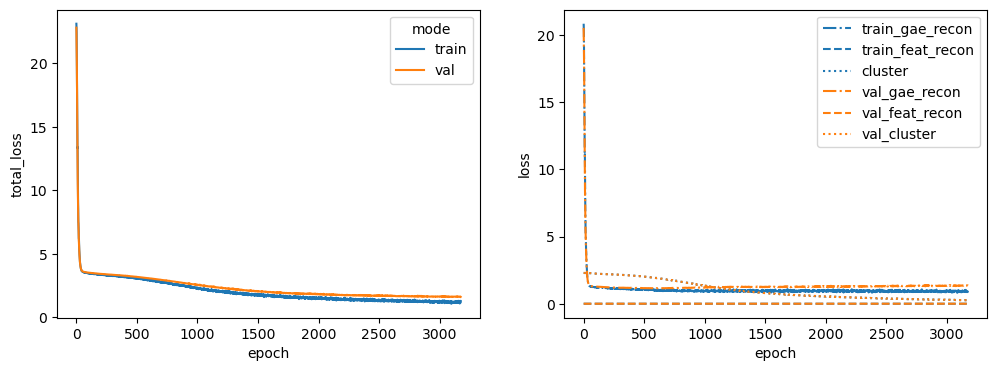

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


HRAS
Latent dim: 1024


 35%|███▌      | 3520/10000 [01:12<02:12, 48.75it/s]


Training stopped after 3521 epochs
Best model found at epoch 3419
------------------------------------------------------------
TEST AUC: 0.7801405325443787 AP: 0.836498568429443
TRAIN loss: 1.14349365234375
VAL loss: 1.5141304731369019
TEST loss: 1.5572152137756348
TEST AUC: 0.7801405325443787 	 AP: 0.836498568429443


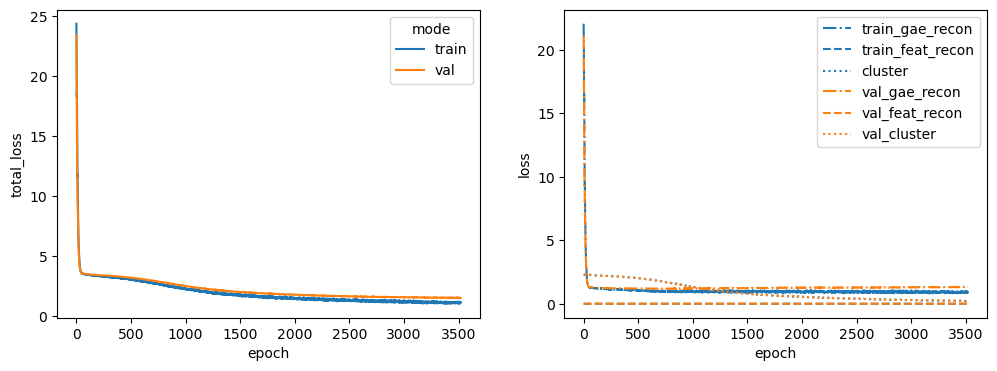

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


IRAK4
Latent dim: 1024


 29%|██▉       | 2893/10000 [00:57<02:22, 50.02it/s]


Training stopped after 2894 epochs
Best model found at epoch 2792
------------------------------------------------------------
TEST AUC: 0.7736686390532544 AP: 0.7904564371200989
TRAIN loss: 1.2710453271865845
VAL loss: 1.717024564743042
TEST loss: 1.721937894821167
TEST AUC: 0.7736686390532544 	 AP: 0.7904564371200989


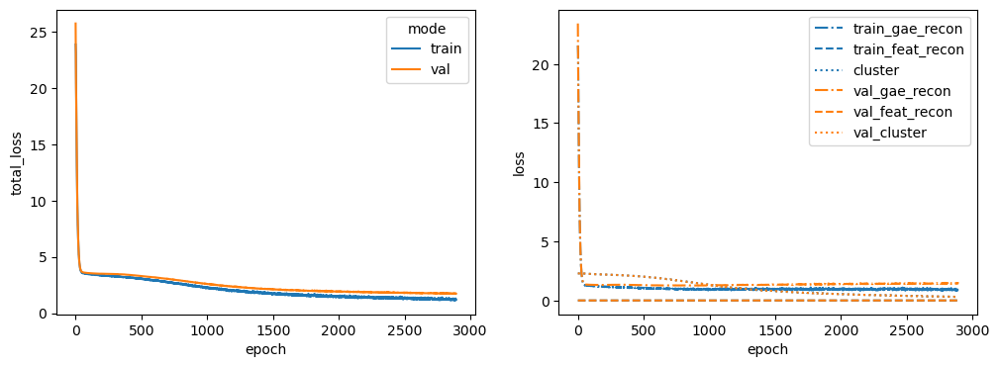

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


JUN
Latent dim: 1024


 29%|██▊       | 2854/10000 [00:57<02:23, 49.81it/s]


Training stopped after 2855 epochs
Best model found at epoch 2753
------------------------------------------------------------
TEST AUC: 0.7574889053254438 AP: 0.7920257437508254
TRAIN loss: 1.233492374420166
VAL loss: 1.4656572341918945
TEST loss: 1.7515722513198853
TEST AUC: 0.7574889053254438 	 AP: 0.7920257437508254


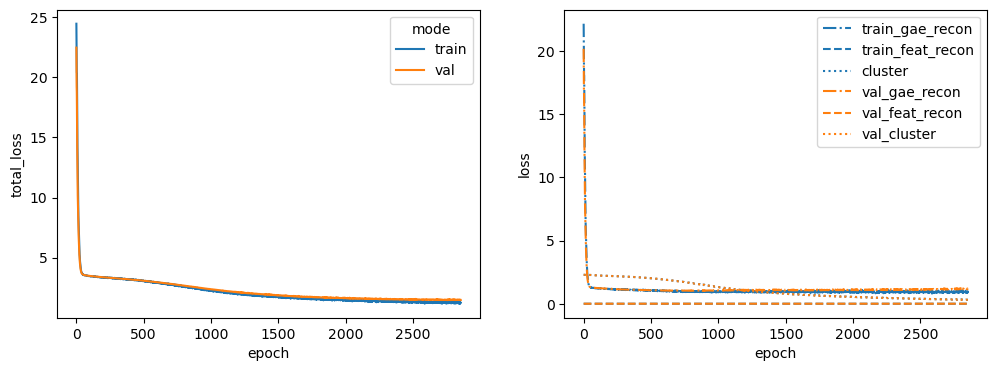

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


MAP2K3
Latent dim: 1024


 27%|██▋       | 2684/10000 [00:53<02:25, 50.11it/s]


Training stopped after 2685 epochs
Best model found at epoch 2583
------------------------------------------------------------
TEST AUC: 0.75 AP: 0.7536584485236577
TRAIN loss: 1.3221282958984375
VAL loss: 1.44556725025177
TEST loss: 1.8675694465637207
TEST AUC: 0.75 	 AP: 0.7536584485236577


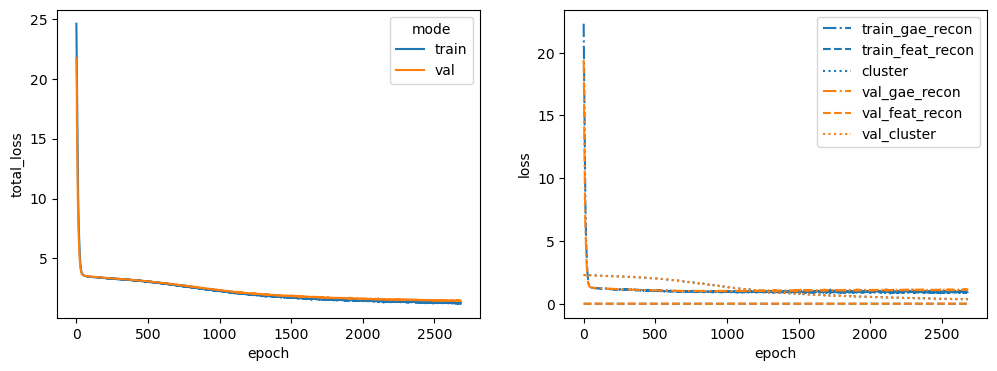

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


MAP3K2
Latent dim: 1024


 21%|██        | 2069/10000 [00:41<02:39, 49.74it/s]


Training stopped after 2070 epochs
Best model found at epoch 1968
------------------------------------------------------------
TEST AUC: 0.7971523668639052 AP: 0.8357722848231877
TRAIN loss: 1.490617036819458
VAL loss: 1.7442166805267334
TEST loss: 1.8173362016677856
TEST AUC: 0.7971523668639052 	 AP: 0.8357722848231877


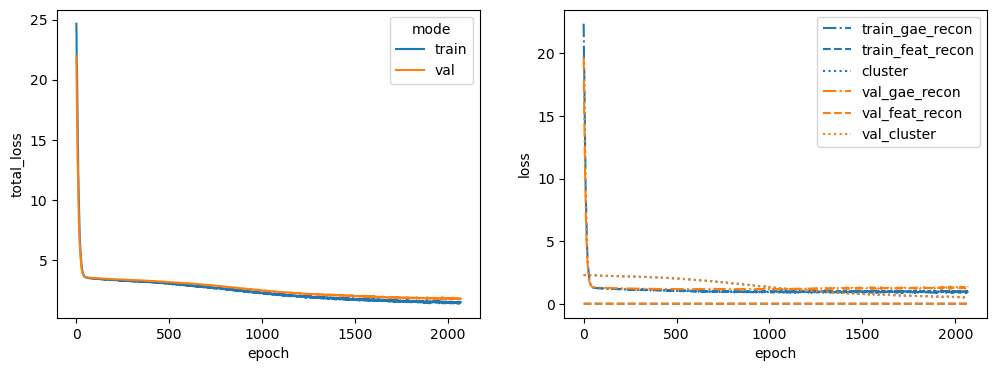

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


MAP3K5
Latent dim: 1024


 27%|██▋       | 2666/10000 [00:55<02:33, 47.72it/s]


Training stopped after 2667 epochs
Best model found at epoch 2565
------------------------------------------------------------
TEST AUC: 0.7550850591715976 AP: 0.7336804404554238
TRAIN loss: 1.2984641790390015
VAL loss: 1.4364562034606934
TEST loss: 1.9537187814712524
TEST AUC: 0.7550850591715976 	 AP: 0.7336804404554238


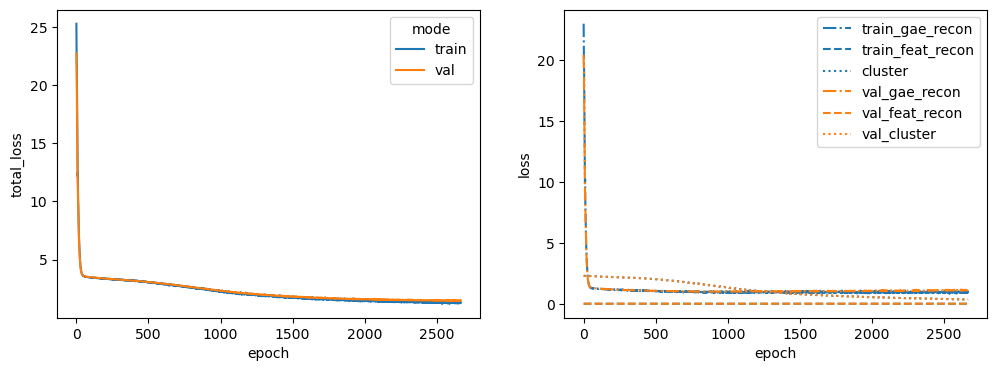

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


MAP3K9
Latent dim: 1024


 29%|██▉       | 2940/10000 [00:58<02:19, 50.60it/s]


Training stopped after 2941 epochs
Best model found at epoch 2839
------------------------------------------------------------
TEST AUC: 0.7447300295857988 AP: 0.7494891907522113
TRAIN loss: 1.24700129032135
VAL loss: 1.619849443435669
TEST loss: 1.8451582193374634
TEST AUC: 0.7447300295857988 	 AP: 0.7494891907522113


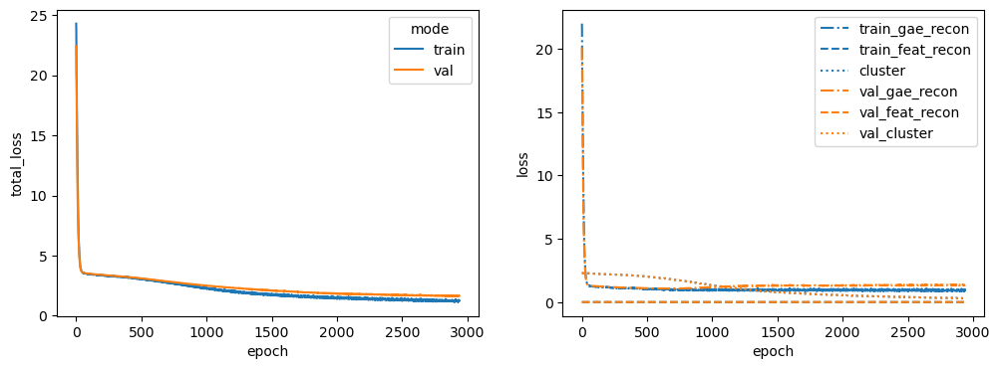

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


MAPK7
Latent dim: 1024


 31%|███       | 3108/10000 [01:02<02:19, 49.53it/s]


Training stopped after 3109 epochs
Best model found at epoch 3007
------------------------------------------------------------
TEST AUC: 0.776257396449704 AP: 0.8021886437517658
TRAIN loss: 1.203282356262207
VAL loss: 1.8499153852462769
TEST loss: 1.6561226844787598
TEST AUC: 0.776257396449704 	 AP: 0.8021886437517658


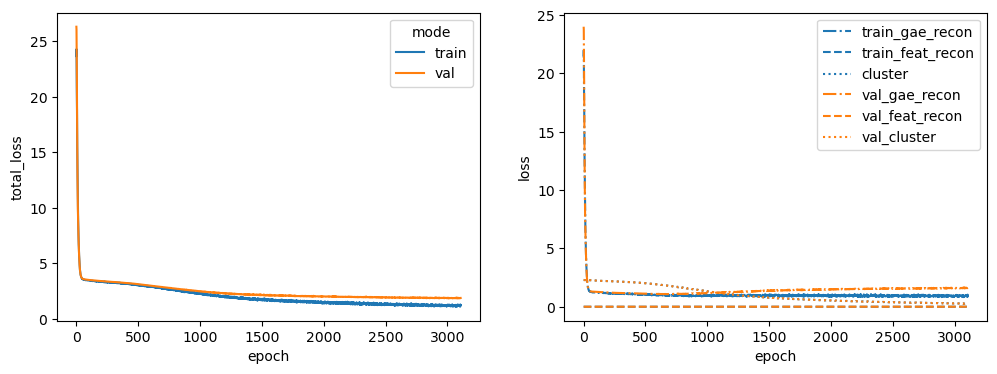

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


MOS
Latent dim: 1024


 28%|██▊       | 2766/10000 [00:55<02:25, 49.82it/s]


Training stopped after 2767 epochs
Best model found at epoch 2665
------------------------------------------------------------
TEST AUC: 0.7229105029585798 AP: 0.7154408946281956
TRAIN loss: 1.3183726072311401
VAL loss: 1.3982934951782227
TEST loss: 1.9904217720031738
TEST AUC: 0.7229105029585798 	 AP: 0.7154408946281956


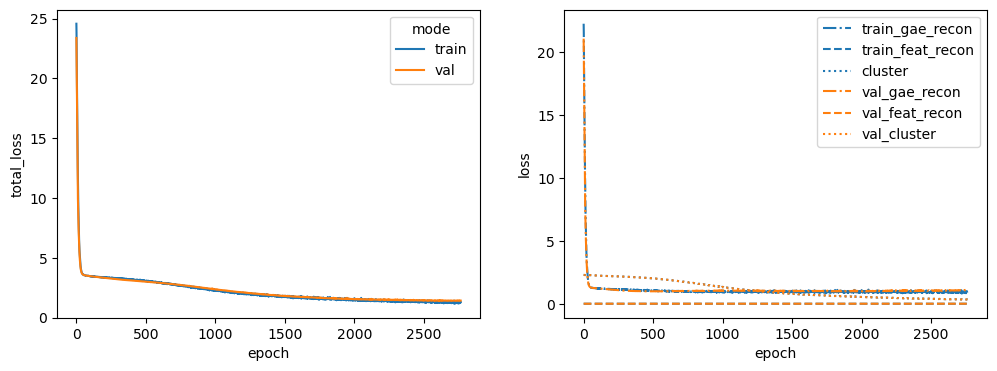

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


MYD88
Latent dim: 1024


 30%|███       | 3035/10000 [01:00<02:19, 49.85it/s]


Training stopped after 3036 epochs
Best model found at epoch 2934
------------------------------------------------------------
TEST AUC: 0.7806028106508875 AP: 0.8133847199651127
TRAIN loss: 1.2568151950836182
VAL loss: 1.4891295433044434
TEST loss: 1.6956044435501099
TEST AUC: 0.7806028106508875 	 AP: 0.8133847199651127


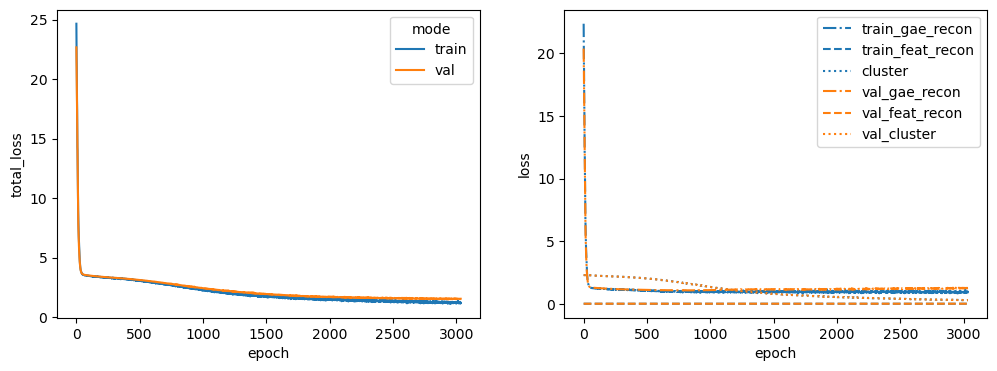

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


PIK3R2
Latent dim: 1024


 23%|██▎       | 2253/10000 [00:42<02:26, 52.94it/s]


Training stopped after 2254 epochs
Best model found at epoch 2152
------------------------------------------------------------
TEST AUC: 0.7757026627218935 AP: 0.7726077011900259
TRAIN loss: 1.42482590675354
VAL loss: 1.7768433094024658
TEST loss: 1.8906208276748657
TEST AUC: 0.7757026627218935 	 AP: 0.7726077011900259


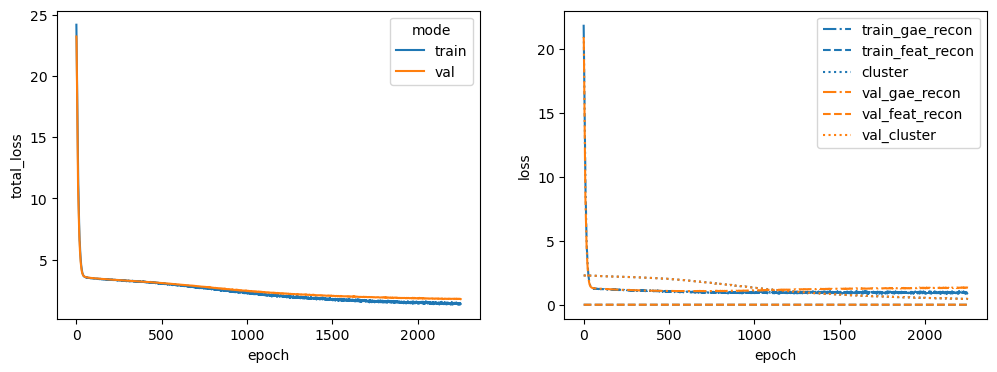

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


PRKACA
Latent dim: 1024


 23%|██▎       | 2302/10000 [00:43<02:26, 52.62it/s]


Training stopped after 2303 epochs
Best model found at epoch 2201
------------------------------------------------------------
TEST AUC: 0.7260539940828402 AP: 0.7117392163541736
TRAIN loss: 1.4813282489776611
VAL loss: 1.5678377151489258
TEST loss: 2.116659641265869
TEST AUC: 0.7260539940828402 	 AP: 0.7117392163541736


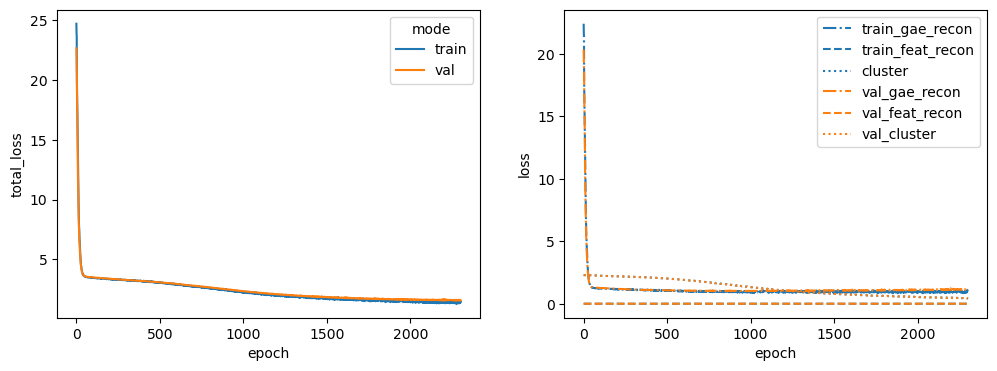

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


PRKCE
Latent dim: 1024


 25%|██▍       | 2452/10000 [00:46<02:21, 53.21it/s]


Training stopped after 2453 epochs
Best model found at epoch 2351
------------------------------------------------------------
TEST AUC: 0.7609097633136094 AP: 0.7703473414392805
TRAIN loss: 1.3756368160247803
VAL loss: 1.5481951236724854
TEST loss: 1.906407356262207
TEST AUC: 0.7609097633136094 	 AP: 0.7703473414392805


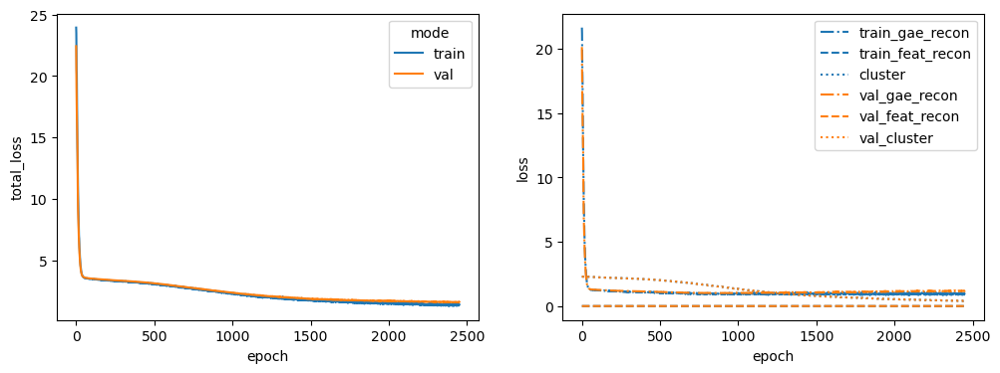

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


RAF1
Latent dim: 1024


 32%|███▏      | 3186/10000 [00:59<02:08, 53.12it/s]


Training stopped after 3187 epochs
Best model found at epoch 3085
------------------------------------------------------------
TEST AUC: 0.7614644970414202 AP: 0.7971005750382809
TRAIN loss: 1.1910680532455444
VAL loss: 1.5014187097549438
TEST loss: 1.6768593788146973
TEST AUC: 0.7614644970414202 	 AP: 0.7971005750382809


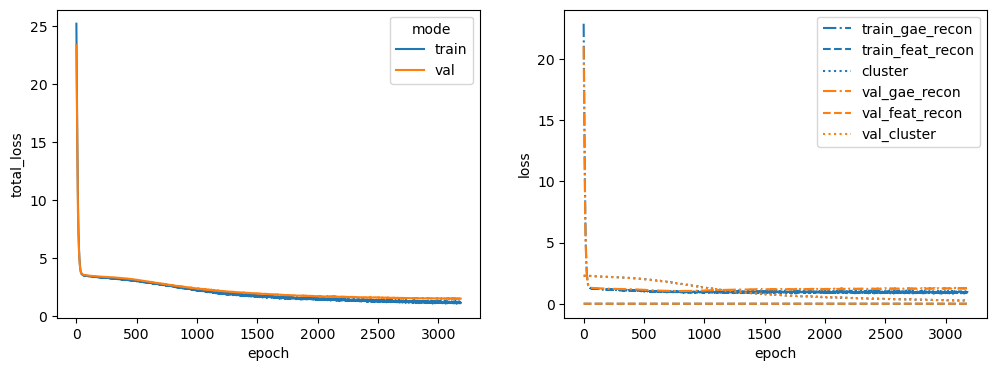

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


RELB
Latent dim: 1024


 27%|██▋       | 2717/10000 [00:51<02:17, 52.97it/s]


Training stopped after 2718 epochs
Best model found at epoch 2616
------------------------------------------------------------
TEST AUC: 0.7616494082840236 AP: 0.8170721653975188
TRAIN loss: 1.2832167148590088
VAL loss: 1.381385326385498
TEST loss: 1.7615702152252197
TEST AUC: 0.7616494082840236 	 AP: 0.8170721653975188


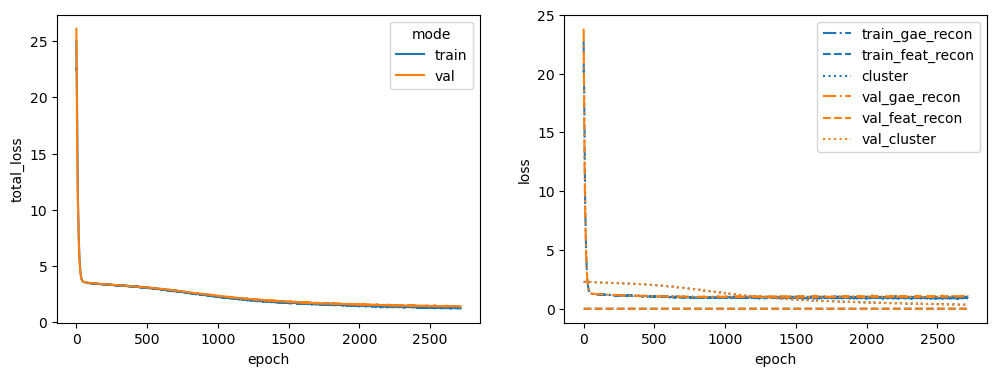

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


RHOA
Latent dim: 1024


 32%|███▏      | 3228/10000 [01:00<02:05, 53.77it/s]


Training stopped after 3229 epochs
Best model found at epoch 3127
------------------------------------------------------------
TEST AUC: 0.7444526627218936 AP: 0.7170151063486959
TRAIN loss: 1.167891025543213
VAL loss: 1.507574439048767
TEST loss: 1.9114038944244385
TEST AUC: 0.7444526627218936 	 AP: 0.7170151063486959


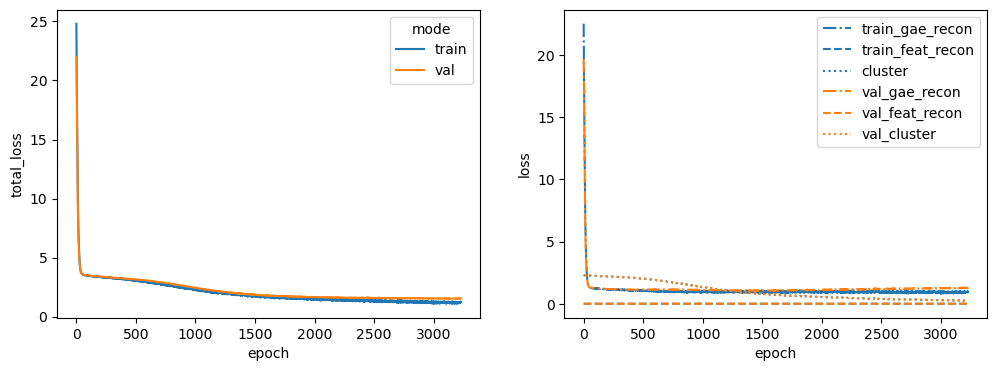

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


SMAD4
Latent dim: 1024


 26%|██▌       | 2620/10000 [00:48<02:15, 54.48it/s]


Training stopped after 2621 epochs
Best model found at epoch 2519
------------------------------------------------------------
TEST AUC: 0.7753328402366865 AP: 0.7883973811104268
TRAIN loss: 1.2503914833068848
VAL loss: 1.625847339630127
TEST loss: 1.7960814237594604
TEST AUC: 0.7753328402366865 	 AP: 0.7883973811104268


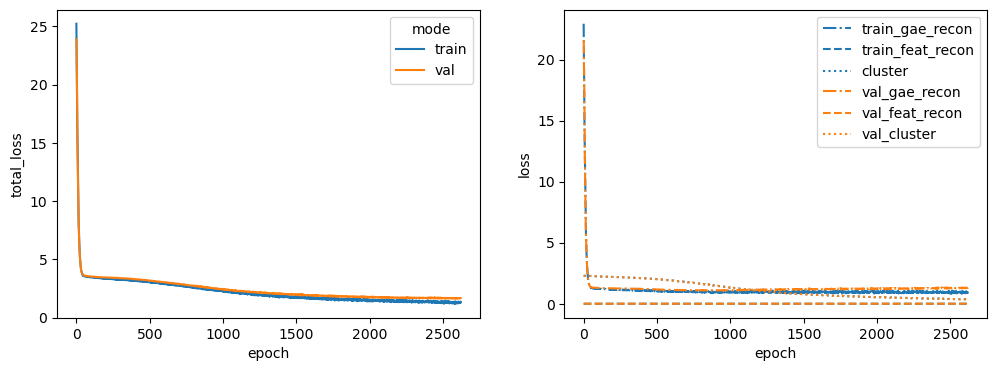

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


SMO
Latent dim: 1024


 17%|█▋        | 1730/10000 [00:32<02:35, 53.02it/s]


Training stopped after 1731 epochs
Best model found at epoch 1629
------------------------------------------------------------
TEST AUC: 0.7319711538461539 AP: 0.7450511454912865
TRAIN loss: 1.7220263481140137
VAL loss: 1.9895656108856201
TEST loss: 2.2263684272766113
TEST AUC: 0.7319711538461539 	 AP: 0.7450511454912865


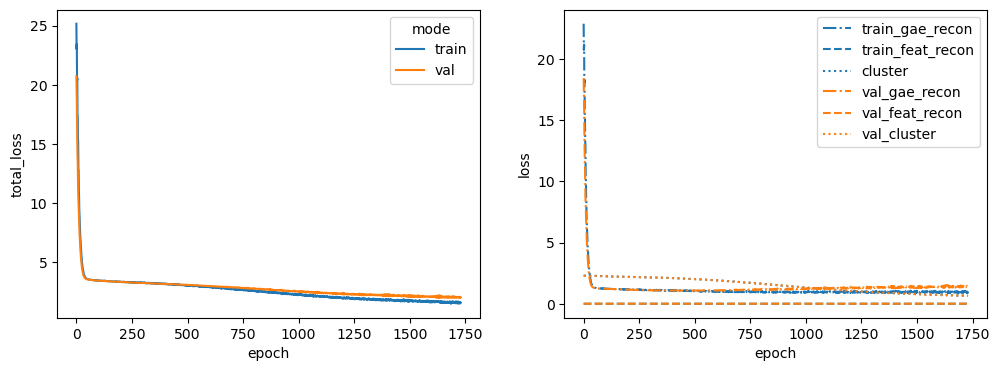

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


SRC
Latent dim: 1024


 36%|███▋      | 3635/10000 [01:07<01:59, 53.46it/s]


Training stopped after 3636 epochs
Best model found at epoch 3534
------------------------------------------------------------
TEST AUC: 0.7670118343195266 AP: 0.7922558213702333
TRAIN loss: 1.1115596294403076
VAL loss: 1.4437412023544312
TEST loss: 1.6093355417251587
TEST AUC: 0.7670118343195266 	 AP: 0.7922558213702333


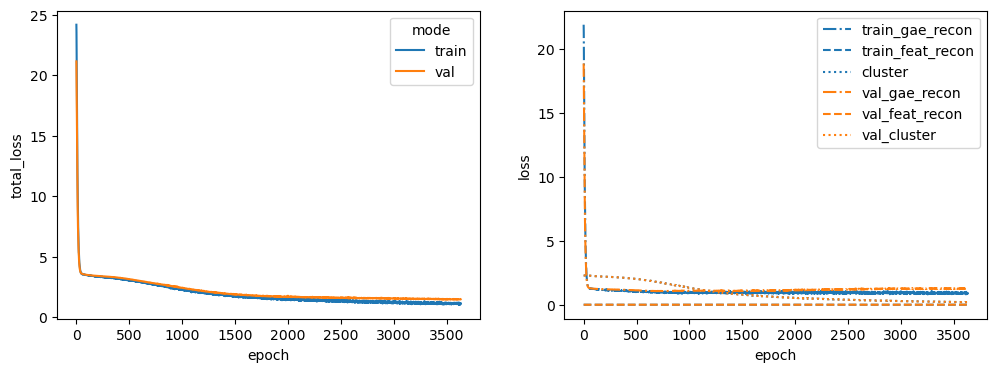

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


SREBF1
Latent dim: 1024


 24%|██▍       | 2428/10000 [00:45<02:21, 53.58it/s]


Training stopped after 2429 epochs
Best model found at epoch 2327
------------------------------------------------------------
TEST AUC: 0.7251294378698224 AP: 0.735687180489297
TRAIN loss: 1.437337875366211
VAL loss: 1.6110421419143677
TEST loss: 1.9949017763137817
TEST AUC: 0.7251294378698224 	 AP: 0.735687180489297


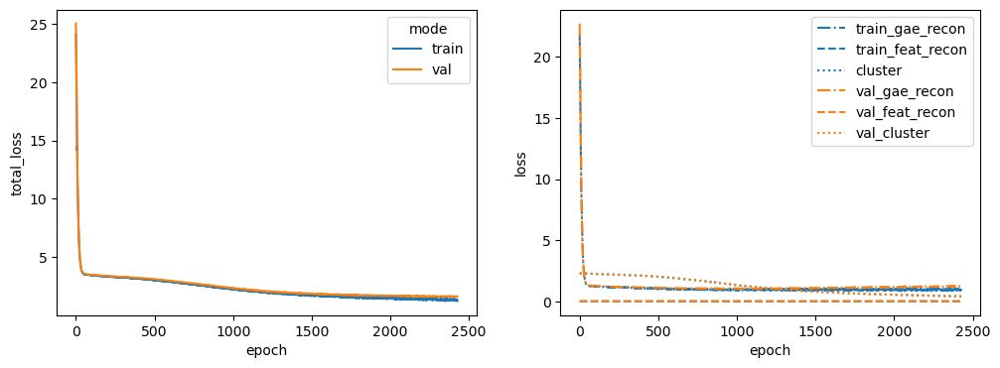

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


TRAF2
Latent dim: 1024


 22%|██▏       | 2248/10000 [00:42<02:25, 53.33it/s]


Training stopped after 2249 epochs
Best model found at epoch 2147
------------------------------------------------------------
TEST AUC: 0.7412167159763313 AP: 0.7503082419149224
TRAIN loss: 1.4047163724899292
VAL loss: 2.048746109008789
TEST loss: 1.986733317375183
TEST AUC: 0.7412167159763313 	 AP: 0.7503082419149224


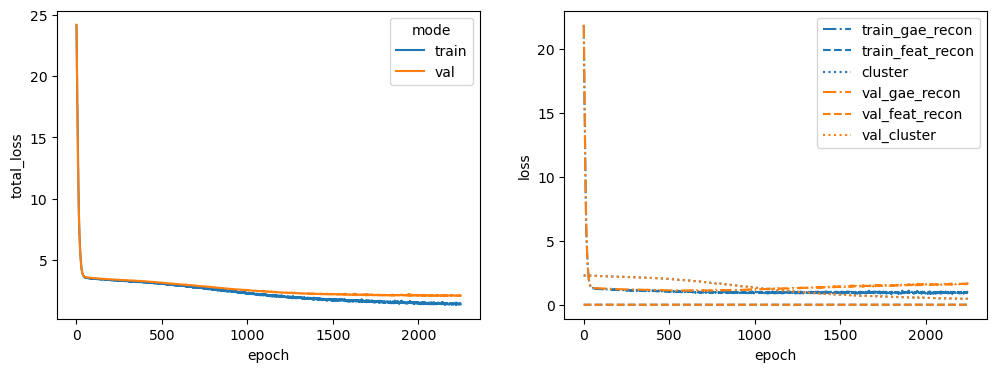

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


TSC2
Latent dim: 1024


 24%|██▍       | 2381/10000 [00:45<02:26, 52.08it/s]


Training stopped after 2382 epochs
Best model found at epoch 2280
------------------------------------------------------------
TEST AUC: 0.7426960059171598 AP: 0.7604203167795519
TRAIN loss: 1.45697021484375
VAL loss: 1.8259892463684082
TEST loss: 1.9755414724349976
TEST AUC: 0.7426960059171598 	 AP: 0.7604203167795519


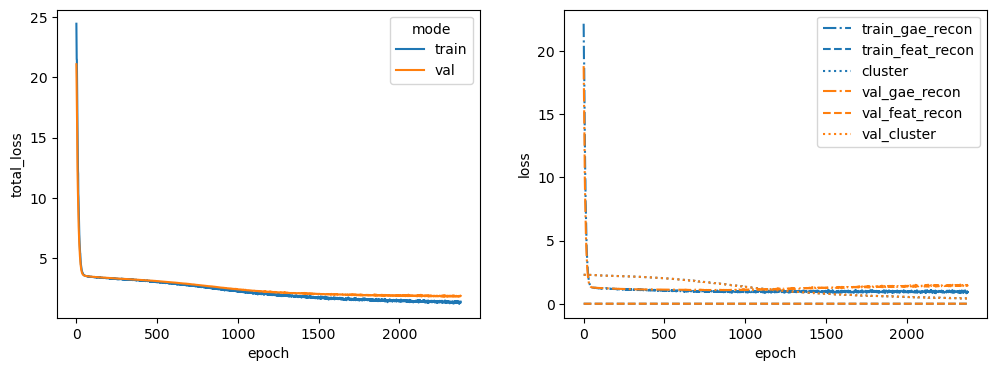

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


WWTR1
Latent dim: 1024


 28%|██▊       | 2816/10000 [00:57<02:27, 48.73it/s]


Training stopped after 2817 epochs
Best model found at epoch 2715
------------------------------------------------------------
TEST AUC: 0.7704326923076924 AP: 0.8107645006282105
TRAIN loss: 1.2333757877349854
VAL loss: 1.429445743560791
TEST loss: 1.696552038192749
TEST AUC: 0.7704326923076924 	 AP: 0.8107645006282105


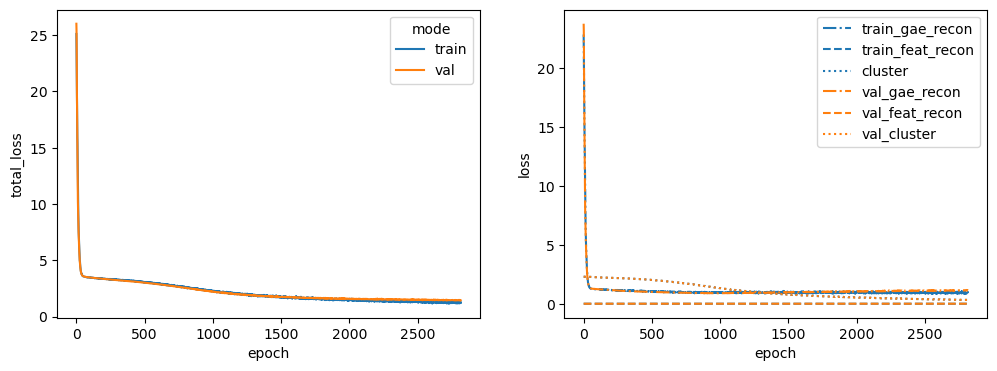

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


<IPython.core.display.Javascript object>

In [34]:
for oe_target in oe_targets:
    print(oe_target)
    phy_clusters = phy_full_clusters_dict[oe_target].copy()
    # phy_clusters.loc[oe_target] = -1
    lut = dict(
        zip(
            list(np.unique(phy_clusters)),
            [
                "tab:blue",
                "tab:red",
                "tab:green",
                "gold",
                "tab:orange",
                "tab:cyan",
                "tab:purple",
                "tab:pink",
                "tab:olive",
                "olivedrab",
                "tab:brown",
            ],
        )
    )
    phy_clusters.loc[:, "color"] = phy_clusters.loc[:, "cluster"].map(lut)
    spearman_interactome = graph_dict[oe_target]

    device = torch.device("cpu")

    graph_data = from_networkx(spearman_interactome)
    graph_data.id = torch.FloatTensor(np.identity(len(spearman_interactome)))
    graph_data = T.ToDevice(
        device,
        attrs=[
            "id",
            "sc_gex",
            "label",
            "label_mask",
            "hallmark",
            "sc_gex_hallmark",
        ],
    )(graph_data)

    input_dim = 1176
    latent_dim = 1024

    # Derive class weights
    class_weights = OrderedDict(
        sorted(dict(Counter(np.array(phy_clusters.loc[:, "cluster"]))).items())
    )
    # del class_weights[-1]
    class_weights = np.array(list(class_weights.values()))
    class_weights = 1 / class_weights
    class_weights = class_weights / np.sum(class_weights)

    class_weights = None

    gae = GAE(
        GCNEncoder(in_channels=input_dim, out_channels=latent_dim, hidden_dim=1024)
    )
    feature_decoder = FeatureDecoder(
        latent_dim=latent_dim,
        hidden_dims=[1024],
        output_dim=input_dim,
        loss_fct=torch.nn.L1Loss(),
    )
    latent_classifier = LatentClassifier(
        latent_dim=latent_dim,
        hidden_dims=None,
        n_classes=10,
        loss_fct=None,
        class_weights=class_weights,
    )

    seeds = [1234]
    alpha = 1
    beta = 0
    gamma = 1
    use_graph = "split_graph"

    node_feature_key = "sc_gex_hallmark"
    edge_weight_key = None

    print("Latent dim: {}".format(1024))
    latents_dict, loss_hist_dict = get_gae_latents_for_seed(
        graph_data=graph_data,
        gae=gae,
        seeds=seeds,
        node_feature_key=node_feature_key,
        edge_weight_key=edge_weight_key,
        feature_decoder=feature_decoder,
        latent_classifier=latent_classifier,
        n_epochs=10000,
        lr=0.00001,
        split_type="link",
        alpha=alpha,
        beta=beta,
        gamma=gamma,
        plot_loss=True,
        early_stopping=100,
        use_full_graph=use_graph == "full_graph",
        neg_edge_ratio=1.0,
    )

    output_dir = "../../../data/experiments/image_embeddings/specificity_target_emb_loto/embeddings/pcst_confidence_0598_hub_999_pruned/{}".format(
        oe_target
    )

    output_dir = os.path.join(
        output_dir,
        "gae_exp_a{}_b{}_g{}_{}_cmap_full".format(alpha, beta, gamma, use_graph),
    )
    os.makedirs(output_dir, exist_ok=True)

    latents = latents_dict[1234]
    node_names = getattr(graph_data, "name")
    st_memberships = getattr(graph_data, "spec_target")
    latents = pd.DataFrame(latents, index=node_names)

    embs = TSNE(
        random_state=1234,
        perplexity=int(np.sqrt(len(latents))) + 1,
        init="pca",
        learning_rate="auto",
    ).fit_transform(latents)
    embs = pd.DataFrame(embs, columns=["tsne_0", "tsne_1"], index=node_names)
    embs["spec_target"] = st_memberships.cpu().numpy()

    fig, ax = plt.subplots(figsize=[20, 10])
    ax = sns.scatterplot(
        data=embs, x="tsne_0", y="tsne_1", cmap="viridis", hue="spec_target"
    )
    label_point(
        np.array(embs.loc[:, "tsne_0"]),
        np.array(embs.loc[:, "tsne_1"]),
        np.array(embs.index).astype("str"),
        ax=ax,
    )
    ax.set_title("Visualization of the inferred embedding space")
    plt.savefig(
        os.path.join(
            output_dir,
            "tsne_embs.png".format(alpha, beta, gamma, use_graph),
        ),
        bbox_inches="tight",
    )
    plt.close()

    ax = sns.clustermap(
        latents.loc[set(oe_targets).intersection(latents.index)],
        figsize=[6, 12],
        metric="cosine",
        method="complete",
        cmap="seismic",
        row_colors=np.array(
            phy_clusters.loc[set(oe_targets).intersection(latents.index), "color"]
        ).ravel(),
    )
    ax.ax_heatmap.set_yticklabels(
        ax.ax_heatmap.get_ymajorticklabels(),
        fontsize=15,
        fontweight="bold",
    )
    plt.savefig(
        os.path.join(
            output_dir,
            "reg_clustering.png".format(alpha, beta, gamma, use_graph),
        ),
        bbox_inches="tight",
    )
    plt.close()

    latents.to_csv(
        os.path.join(
            output_dir,
            "node_embs.csv".format(alpha, beta, gamma, use_graph),
        )
    )

AKT1S1
Latent dim: 1024


 42%|████▏     | 4167/10000 [01:20<01:52, 51.87it/s]


Training stopped after 4168 epochs
Best model found at epoch 4066
------------------------------------------------------------
TEST AUC: 0.8104308390022674 AP: 0.8379546607662107
TRAIN loss: 1.0951576232910156
VAL loss: 1.204641342163086
TEST loss: 1.361486792564392
TEST AUC: 0.8104308390022674 	 AP: 0.8379546607662107


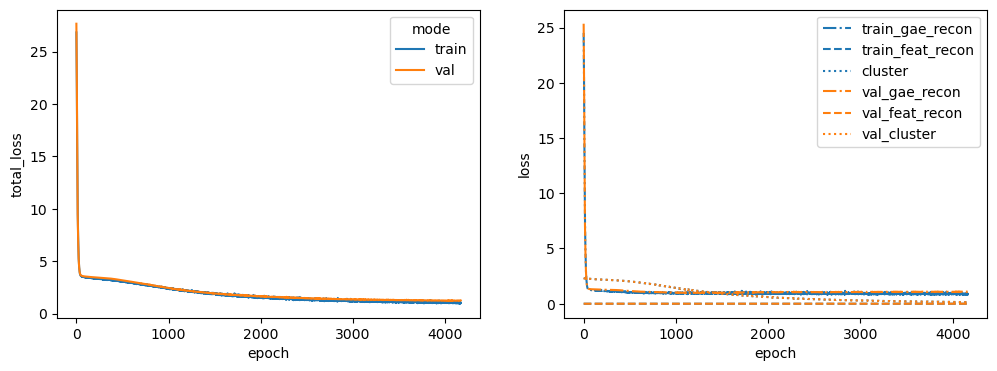

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


ATF4
Latent dim: 1024


 46%|████▋     | 4643/10000 [01:28<01:41, 52.64it/s]


Training stopped after 4644 epochs
Best model found at epoch 4542
------------------------------------------------------------
TEST AUC: 0.7644444444444445 AP: 0.7615157912603513
TRAIN loss: 0.9883887767791748
VAL loss: 1.433154582977295
TEST loss: 1.4773273468017578
TEST AUC: 0.7644444444444445 	 AP: 0.7615157912603513


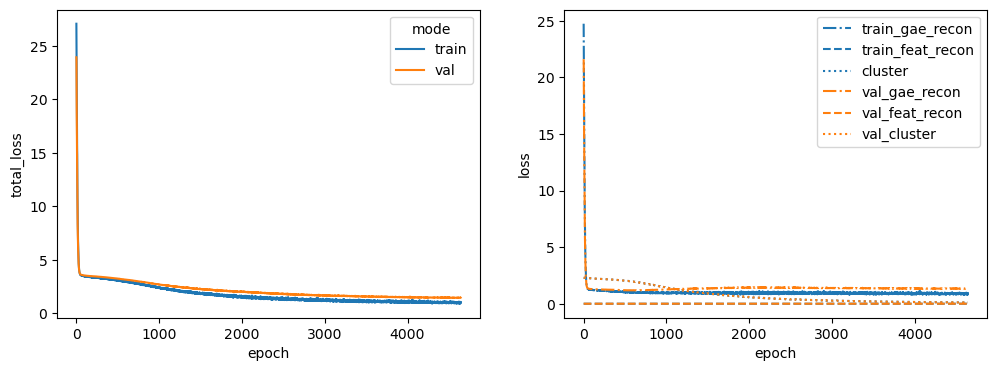

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


BAX
Latent dim: 1024


 48%|████▊     | 4826/10000 [01:29<01:36, 53.76it/s]


Training stopped after 4827 epochs
Best model found at epoch 4725
------------------------------------------------------------
TEST AUC: 0.801360544217687 AP: 0.8151911639075957
TRAIN loss: 1.1102337837219238
VAL loss: 1.239038348197937
TEST loss: 1.3807600736618042
TEST AUC: 0.801360544217687 	 AP: 0.8151911639075957


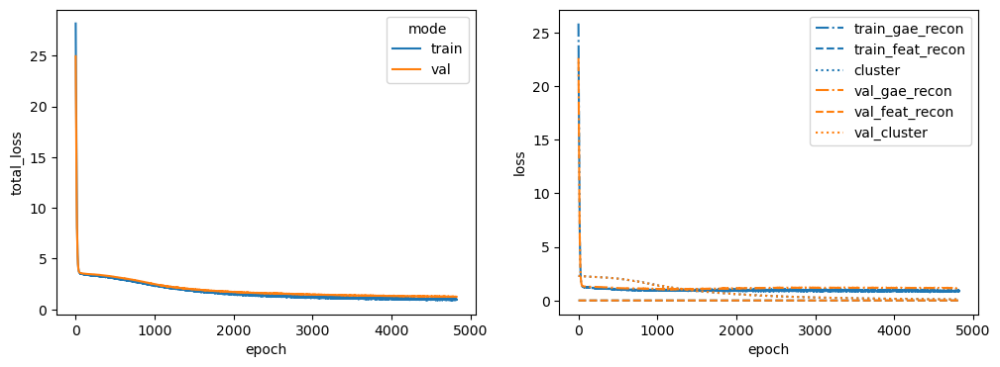

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


BCL2L11
Latent dim: 1024


 45%|████▌     | 4511/10000 [01:25<01:43, 52.95it/s]


Training stopped after 4512 epochs
Best model found at epoch 4410
------------------------------------------------------------
TEST AUC: 0.8019047619047618 AP: 0.7886447183847103
TRAIN loss: 0.9637522101402283
VAL loss: 1.2025492191314697
TEST loss: 1.448974609375
TEST AUC: 0.8019047619047618 	 AP: 0.7886447183847103


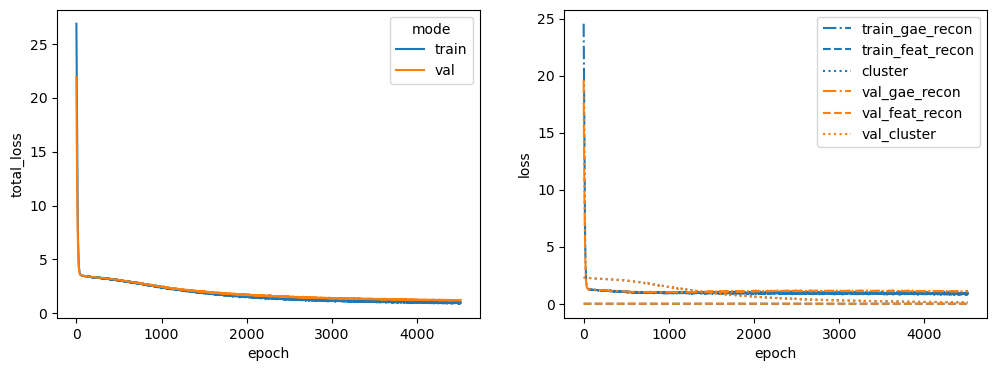

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


BRAF
Latent dim: 1024


 36%|███▋      | 3649/10000 [01:11<02:04, 51.08it/s]


Training stopped after 3650 epochs
Best model found at epoch 3548
------------------------------------------------------------
TEST AUC: 0.7775963718820863 AP: 0.7531151416123397
TRAIN loss: 1.166353464126587
VAL loss: 1.3645915985107422
TEST loss: 1.6045976877212524
TEST AUC: 0.7775963718820863 	 AP: 0.7531151416123397


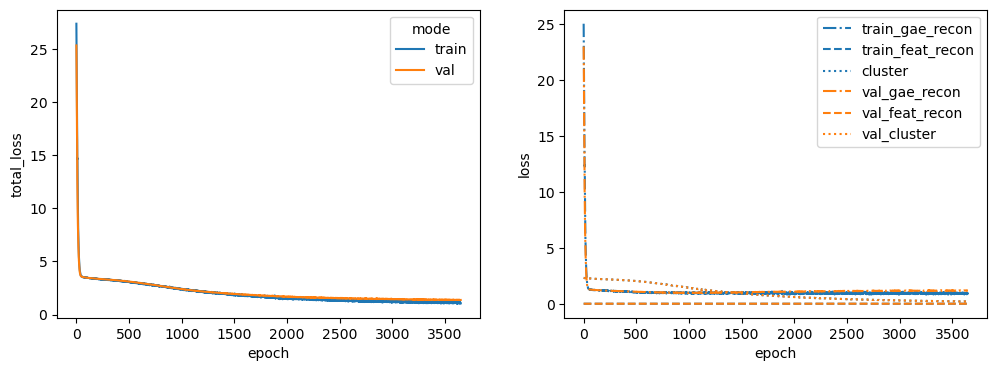

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


CASP8
Latent dim: 1024


 50%|████▉     | 4954/10000 [01:38<01:40, 50.04it/s]


Training stopped after 4955 epochs
Best model found at epoch 4853
------------------------------------------------------------
TEST AUC: 0.8235827664399094 AP: 0.8615672257783211
TRAIN loss: 1.0055756568908691
VAL loss: 1.273911714553833
TEST loss: 1.2825757265090942
TEST AUC: 0.8235827664399094 	 AP: 0.8615672257783211


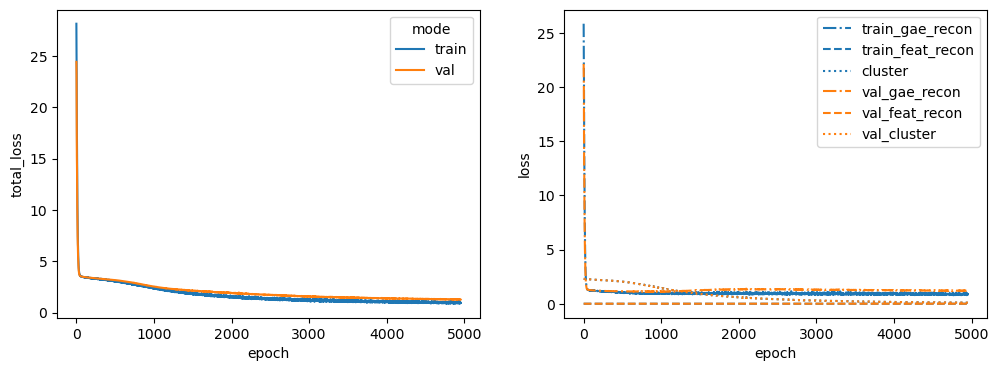

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


CDC42
Latent dim: 1024


 39%|███▊      | 3852/10000 [01:12<01:56, 52.86it/s]


Training stopped after 3853 epochs
Best model found at epoch 3751
------------------------------------------------------------
TEST AUC: 0.8058956916099773 AP: 0.8357223566489107
TRAIN loss: 1.1115162372589111
VAL loss: 1.398377776145935
TEST loss: 1.393865704536438
TEST AUC: 0.8058956916099773 	 AP: 0.8357223566489107


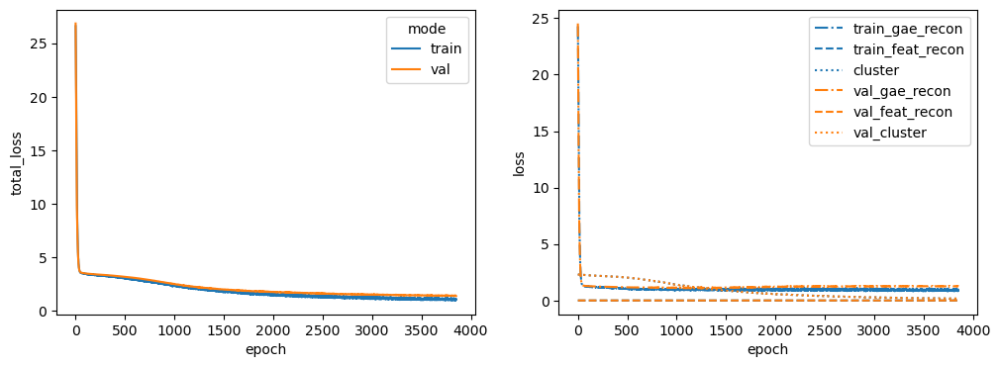

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


CDKN1A
Latent dim: 1024


 39%|███▉      | 3940/10000 [01:20<02:03, 48.90it/s]


Training stopped after 3941 epochs
Best model found at epoch 3839
------------------------------------------------------------
TEST AUC: 0.7928344671201814 AP: 0.7761971444721849
TRAIN loss: 0.9923184514045715
VAL loss: 1.3892414569854736
TEST loss: 1.4880105257034302
TEST AUC: 0.7928344671201814 	 AP: 0.7761971444721849


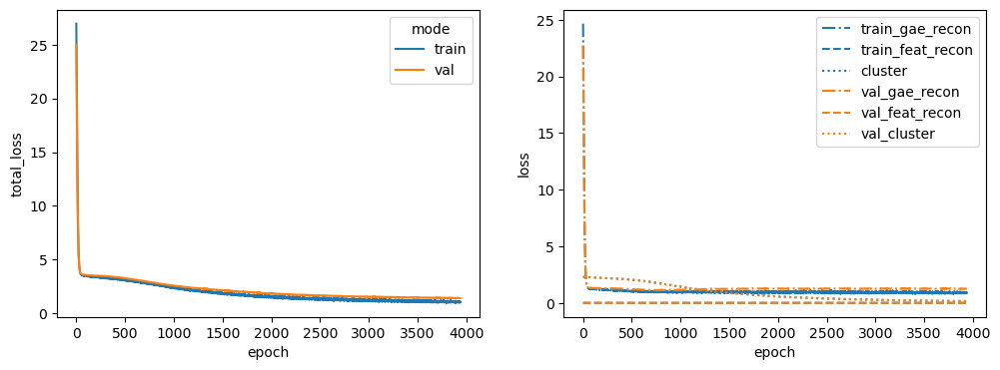

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


CEBPA
Latent dim: 1024


 33%|███▎      | 3343/10000 [01:06<02:12, 50.30it/s]


Training stopped after 3344 epochs
Best model found at epoch 3242
------------------------------------------------------------
TEST AUC: 0.7988208616780045 AP: 0.7901842592508352
TRAIN loss: 1.143943428993225
VAL loss: 1.4046974182128906
TEST loss: 1.5353193283081055
TEST AUC: 0.7988208616780045 	 AP: 0.7901842592508352


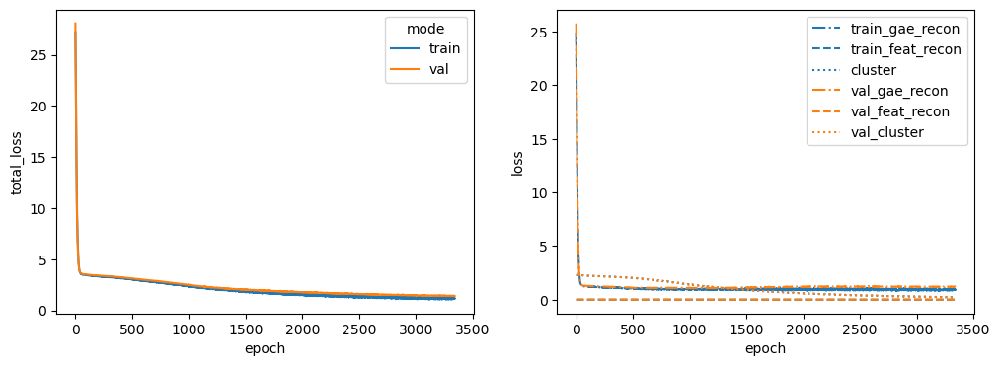

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


CREB1
Latent dim: 1024


 46%|████▌     | 4562/10000 [01:28<01:44, 51.81it/s]


Training stopped after 4563 epochs
Best model found at epoch 4461
------------------------------------------------------------
TEST AUC: 0.80281179138322 AP: 0.8430240479603929
TRAIN loss: 1.0511361360549927
VAL loss: 1.406307578086853
TEST loss: 1.3656247854232788
TEST AUC: 0.80281179138322 	 AP: 0.8430240479603929


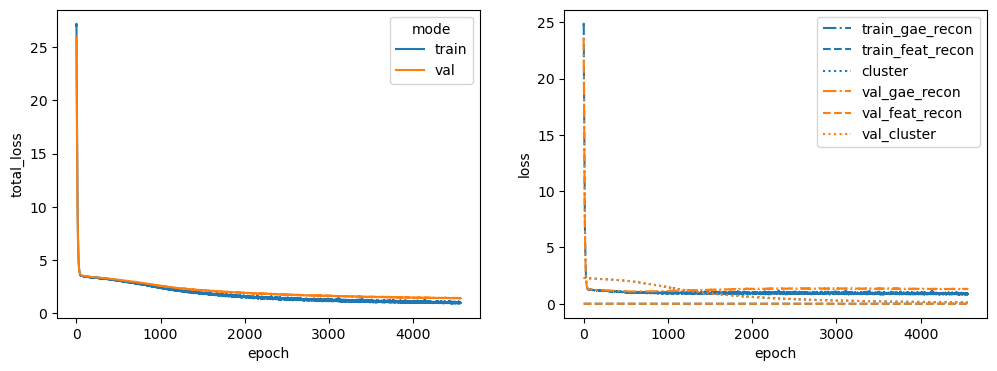

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


CXXC4
Latent dim: 1024


 39%|███▉      | 3943/10000 [01:19<02:02, 49.37it/s]


Training stopped after 3944 epochs
Best model found at epoch 3842
------------------------------------------------------------
TEST AUC: 0.8149659863945579 AP: 0.816219818792535
TRAIN loss: 1.0787453651428223
VAL loss: 1.397270679473877
TEST loss: 1.3805071115493774
TEST AUC: 0.8149659863945579 	 AP: 0.816219818792535


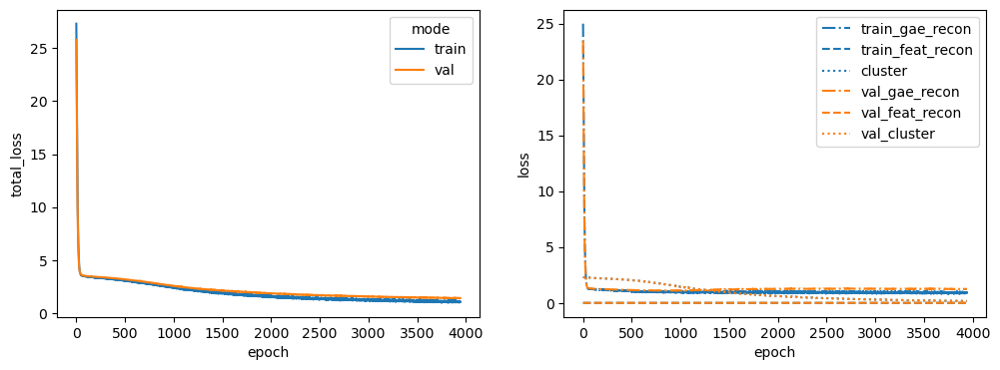

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


DIABLO
Latent dim: 1024


 53%|█████▎    | 5348/10000 [01:45<01:31, 50.83it/s]


Training stopped after 5349 epochs
Best model found at epoch 5247
------------------------------------------------------------
TEST AUC: 0.82140589569161 AP: 0.8466732530564924
TRAIN loss: 0.8855730295181274
VAL loss: 1.2608485221862793
TEST loss: 1.2498778104782104
TEST AUC: 0.82140589569161 	 AP: 0.8466732530564924


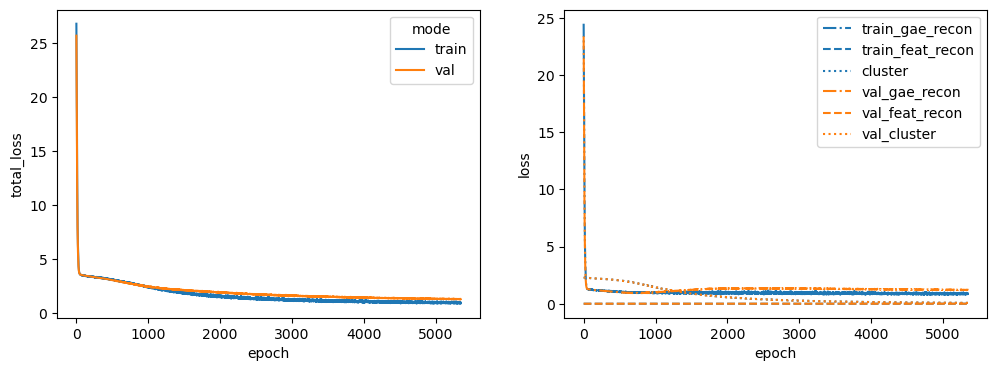

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


E2F1
Latent dim: 1024


 32%|███▏      | 3189/10000 [01:02<02:13, 51.04it/s]


Training stopped after 3190 epochs
Best model found at epoch 3088
------------------------------------------------------------
TEST AUC: 0.7627210884353741 AP: 0.764026157923306
TRAIN loss: 1.152946949005127
VAL loss: 1.4068794250488281
TEST loss: 1.6757632493972778
TEST AUC: 0.7627210884353741 	 AP: 0.764026157923306


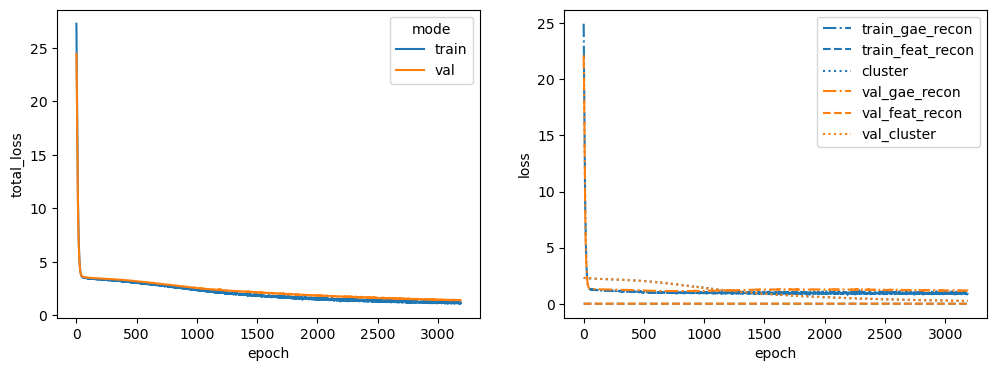

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


ELK1
Latent dim: 1024


 29%|██▉       | 2944/10000 [00:59<02:22, 49.35it/s]


Training stopped after 2945 epochs
Best model found at epoch 2843
------------------------------------------------------------
TEST AUC: 0.8079818594104308 AP: 0.8041902739280992
TRAIN loss: 1.2486965656280518
VAL loss: 1.716030240058899
TEST loss: 1.5715161561965942
TEST AUC: 0.8079818594104308 	 AP: 0.8041902739280992


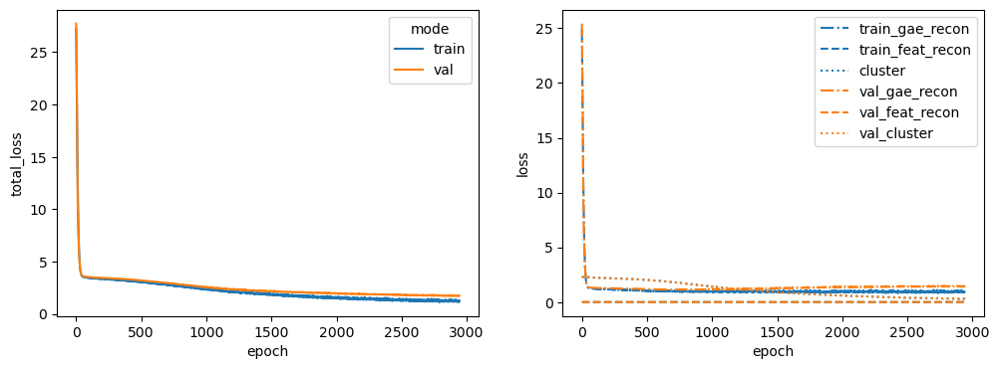

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


EMPTY
Latent dim: 1024


 36%|███▌      | 3565/10000 [01:11<02:08, 49.89it/s]


Training stopped after 3566 epochs
Best model found at epoch 3464
------------------------------------------------------------
TEST AUC: 0.8226757369614514 AP: 0.8134499218839985
TRAIN loss: 1.070246696472168
VAL loss: 1.5872418880462646
TEST loss: 1.4488760232925415
TEST AUC: 0.8226757369614514 	 AP: 0.8134499218839985


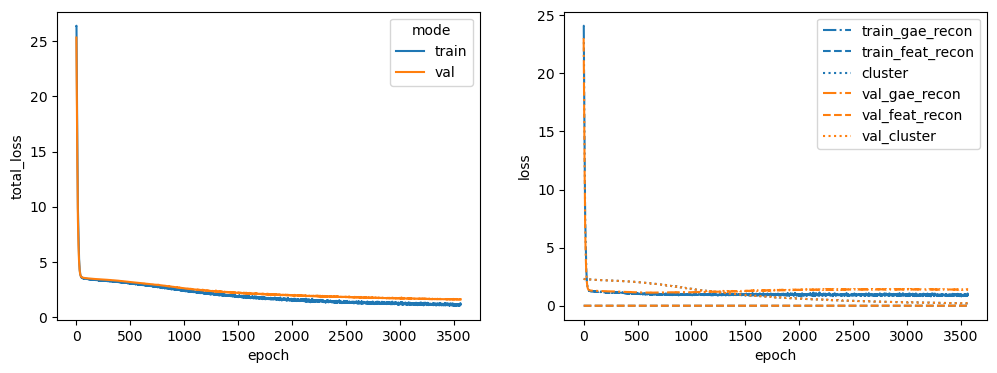

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


ERG
Latent dim: 1024


 30%|███       | 3036/10000 [01:00<02:18, 50.14it/s]


Training stopped after 3037 epochs
Best model found at epoch 2935
------------------------------------------------------------
TEST AUC: 0.8380045351473923 AP: 0.8378386964123701
TRAIN loss: 1.1523761749267578
VAL loss: 1.6902886629104614
TEST loss: 1.4611045122146606
TEST AUC: 0.8380045351473923 	 AP: 0.8378386964123701


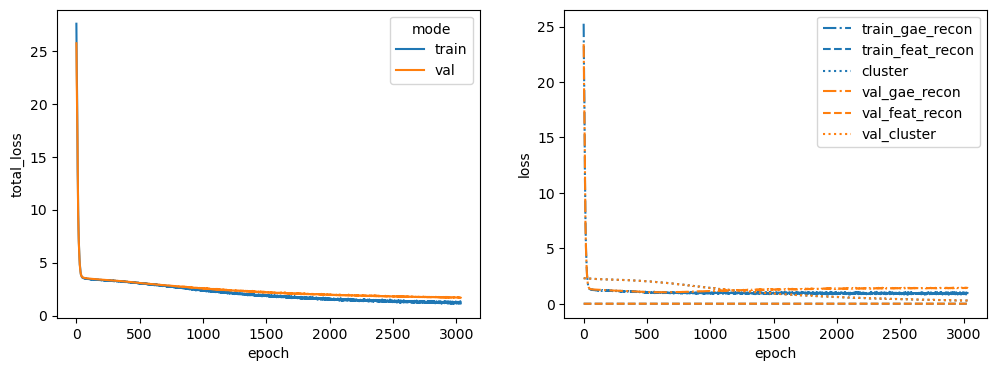

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


FGFR3
Latent dim: 1024


 40%|███▉      | 3991/10000 [01:21<02:02, 49.12it/s]


Training stopped after 3992 epochs
Best model found at epoch 3890
------------------------------------------------------------
TEST AUC: 0.8509750566893425 AP: 0.862532543613435
TRAIN loss: 1.123480200767517
VAL loss: 1.3345283269882202
TEST loss: 1.2926125526428223
TEST AUC: 0.8509750566893425 	 AP: 0.862532543613435


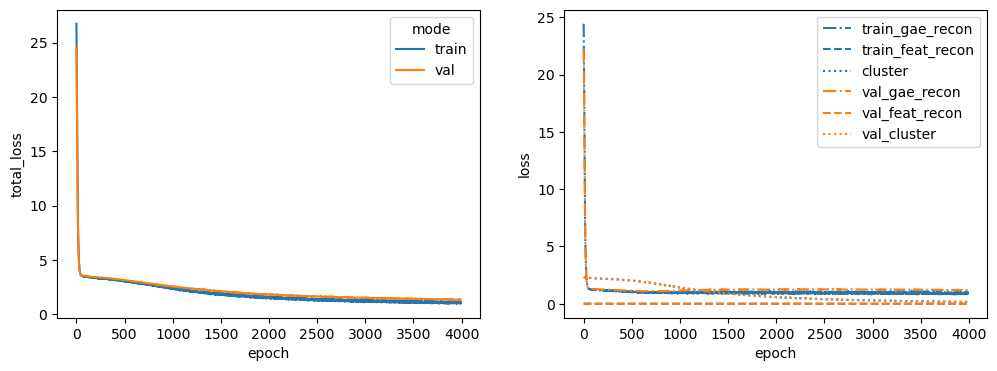

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


FOXO1
Latent dim: 1024


 39%|███▊      | 3873/10000 [01:18<02:03, 49.43it/s]


Training stopped after 3874 epochs
Best model found at epoch 3772
------------------------------------------------------------
TEST AUC: 0.7988208616780045 AP: 0.8077454434980047
TRAIN loss: 1.0587817430496216
VAL loss: 1.2630963325500488
TEST loss: 1.4925689697265625
TEST AUC: 0.7988208616780045 	 AP: 0.8077454434980047


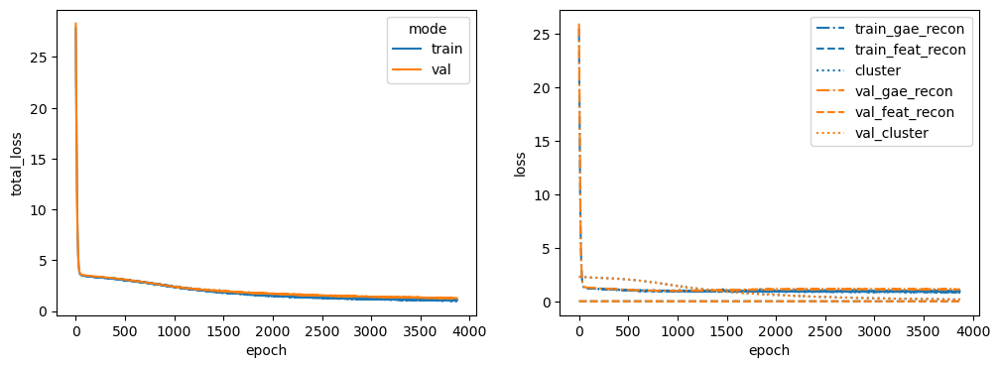

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


GLI1
Latent dim: 1024


 28%|██▊       | 2770/10000 [00:53<02:19, 51.99it/s]


Training stopped after 2771 epochs
Best model found at epoch 2669
------------------------------------------------------------
TEST AUC: 0.8214058956916099 AP: 0.8451565745105581
TRAIN loss: 1.221869707107544
VAL loss: 1.5446193218231201
TEST loss: 1.5165903568267822
TEST AUC: 0.8214058956916099 	 AP: 0.8451565745105581


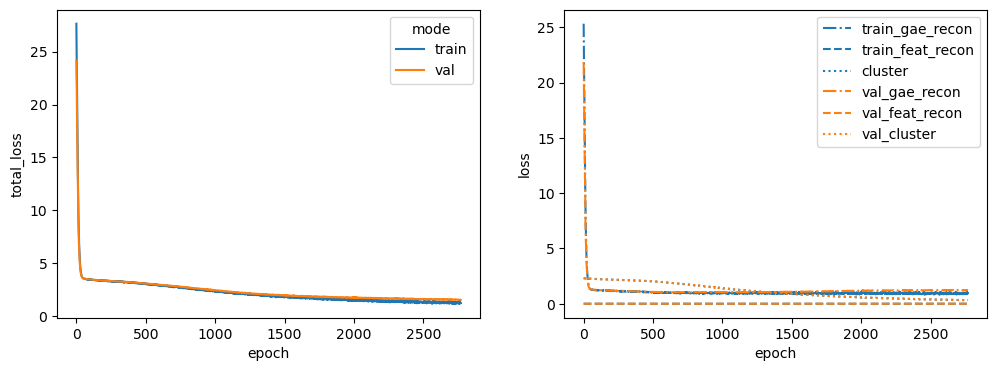

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


HRAS
Latent dim: 1024


 41%|████      | 4107/10000 [01:24<02:01, 48.61it/s]


Training stopped after 4108 epochs
Best model found at epoch 4006
------------------------------------------------------------
TEST AUC: 0.8230385487528346 AP: 0.8165239726412039
TRAIN loss: 1.1152845621109009
VAL loss: 1.4519039392471313
TEST loss: 1.37199068069458
TEST AUC: 0.8230385487528346 	 AP: 0.8165239726412039


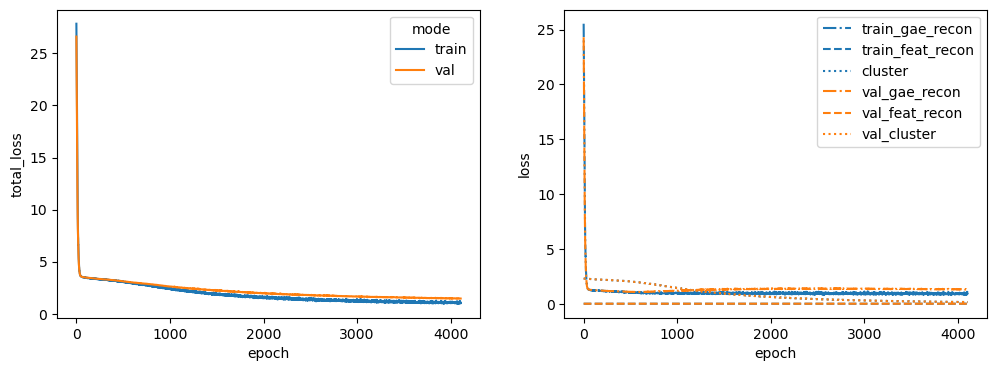

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


IRAK4
Latent dim: 1024


 42%|████▏     | 4219/10000 [01:25<01:57, 49.33it/s]


Training stopped after 4220 epochs
Best model found at epoch 4118
------------------------------------------------------------
TEST AUC: 0.7927437641723357 AP: 0.8298880426499535
TRAIN loss: 1.06717050075531
VAL loss: 1.162545919418335
TEST loss: 1.401662826538086
TEST AUC: 0.7927437641723357 	 AP: 0.8298880426499535


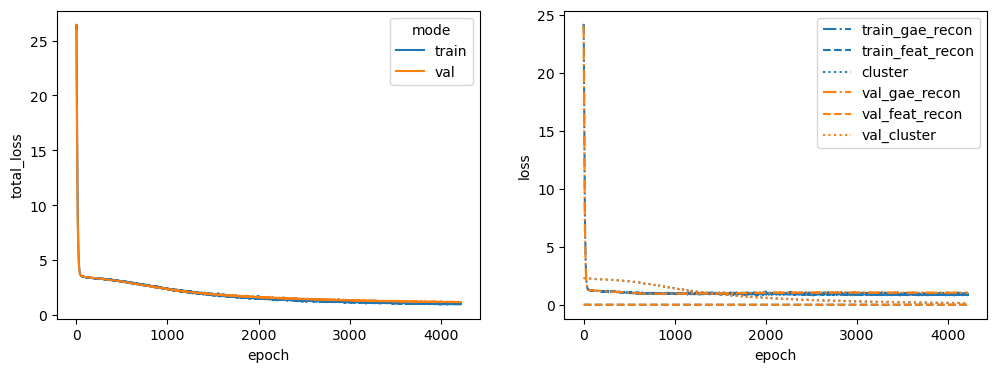

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


JUN
Latent dim: 1024


 43%|████▎     | 4255/10000 [01:28<01:58, 48.29it/s]


Training stopped after 4256 epochs
Best model found at epoch 4154
------------------------------------------------------------
TEST AUC: 0.8263945578231292 AP: 0.8433045105187391
TRAIN loss: 1.0313071012496948
VAL loss: 1.4398913383483887
TEST loss: 1.3200929164886475
TEST AUC: 0.8263945578231292 	 AP: 0.8433045105187391


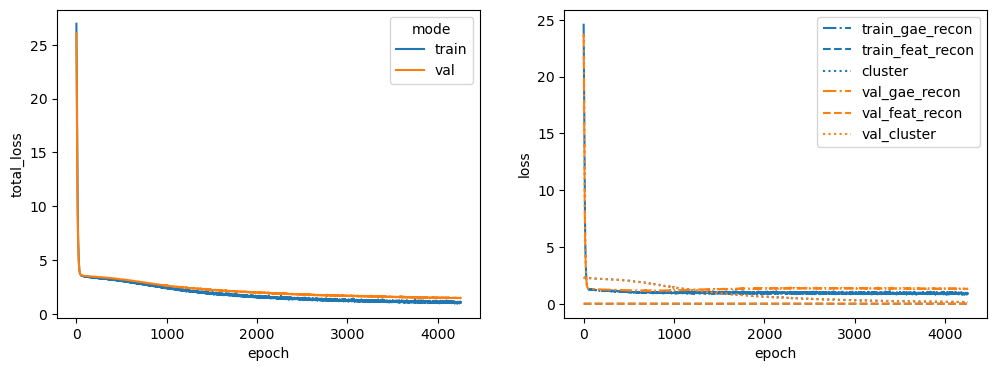

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


MAP2K3
Latent dim: 1024


 32%|███▏      | 3180/10000 [01:04<02:18, 49.15it/s]


Training stopped after 3181 epochs
Best model found at epoch 3079
------------------------------------------------------------
TEST AUC: 0.8008163265306121 AP: 0.8199501828339564
TRAIN loss: 1.2816083431243896
VAL loss: 1.6047606468200684
TEST loss: 1.5578033924102783
TEST AUC: 0.8008163265306121 	 AP: 0.8199501828339564


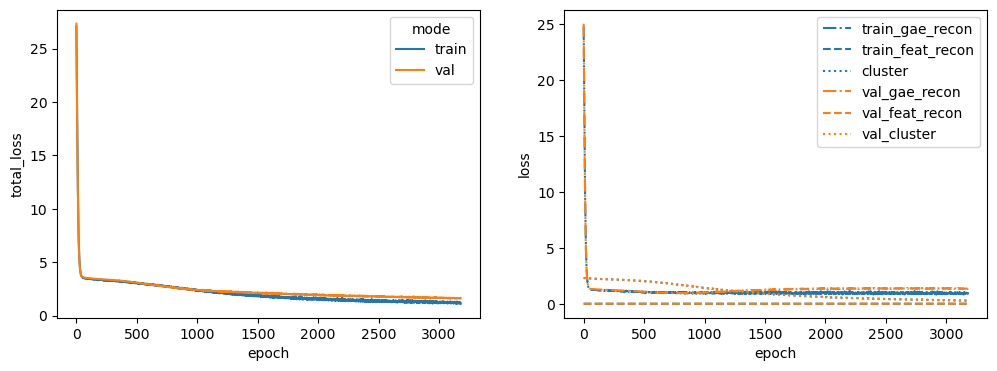

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


MAP3K2
Latent dim: 1024


 39%|███▉      | 3920/10000 [01:18<02:02, 49.74it/s]


Training stopped after 3921 epochs
Best model found at epoch 3819
------------------------------------------------------------
TEST AUC: 0.8278458049886621 AP: 0.831888012581422
TRAIN loss: 1.0630632638931274
VAL loss: 1.3981859683990479
TEST loss: 1.3682801723480225
TEST AUC: 0.8278458049886621 	 AP: 0.831888012581422


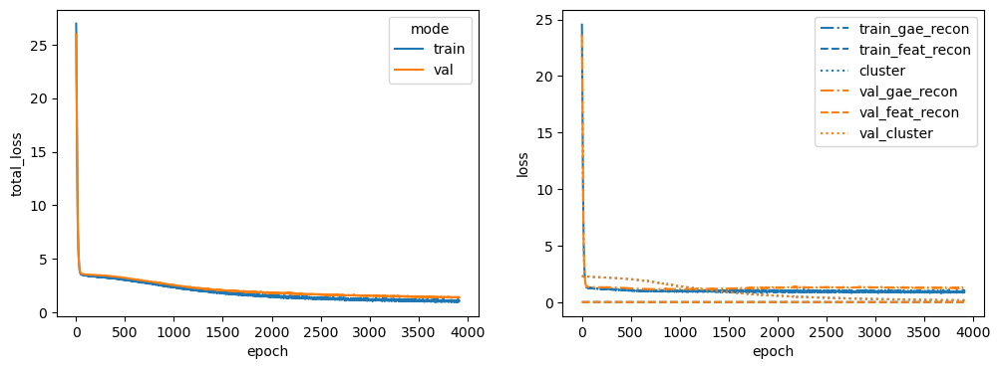

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


MAP3K5
Latent dim: 1024


 49%|████▉     | 4946/10000 [01:37<01:40, 50.53it/s]


Training stopped after 4947 epochs
Best model found at epoch 4845
------------------------------------------------------------
TEST AUC: 0.801904761904762 AP: 0.8034044607070213
TRAIN loss: 0.9711760878562927
VAL loss: 1.3192996978759766
TEST loss: 1.444575309753418
TEST AUC: 0.801904761904762 	 AP: 0.8034044607070213


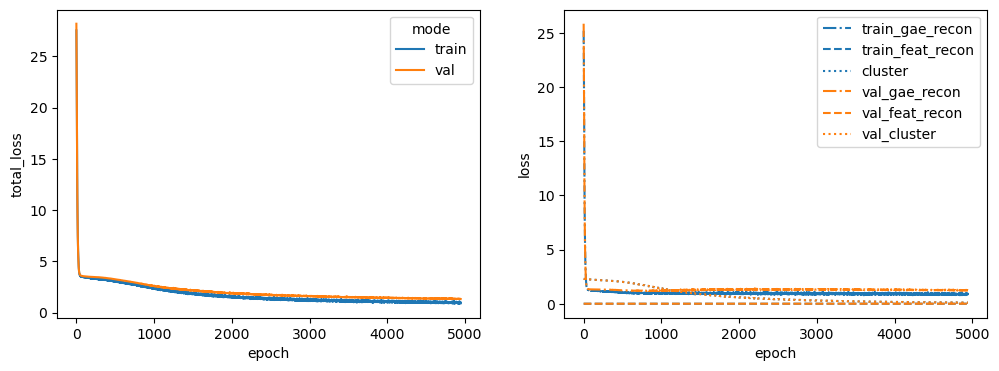

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


MAP3K9
Latent dim: 1024


 28%|██▊       | 2814/10000 [00:57<02:25, 49.31it/s]


Training stopped after 2815 epochs
Best model found at epoch 2713
------------------------------------------------------------
TEST AUC: 0.7724263038548752 AP: 0.773940997154586
TRAIN loss: 1.2952148914337158
VAL loss: 1.6481890678405762
TEST loss: 1.7414474487304688
TEST AUC: 0.7724263038548752 	 AP: 0.773940997154586


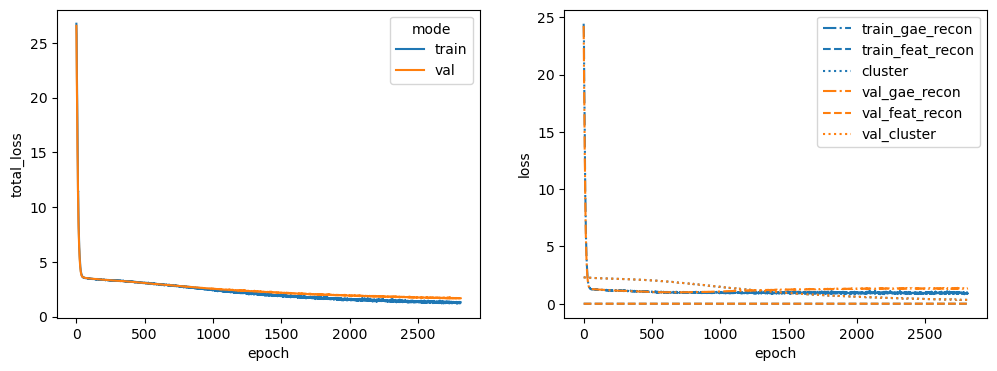

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


MAPK7
Latent dim: 1024


 40%|████      | 4020/10000 [01:19<01:57, 50.72it/s]


Training stopped after 4021 epochs
Best model found at epoch 3919
------------------------------------------------------------
TEST AUC: 0.7922902494331066 AP: 0.7630769322140921
TRAIN loss: 1.0614385604858398
VAL loss: 1.4861410856246948
TEST loss: 1.793172836303711
TEST AUC: 0.7922902494331066 	 AP: 0.7630769322140921


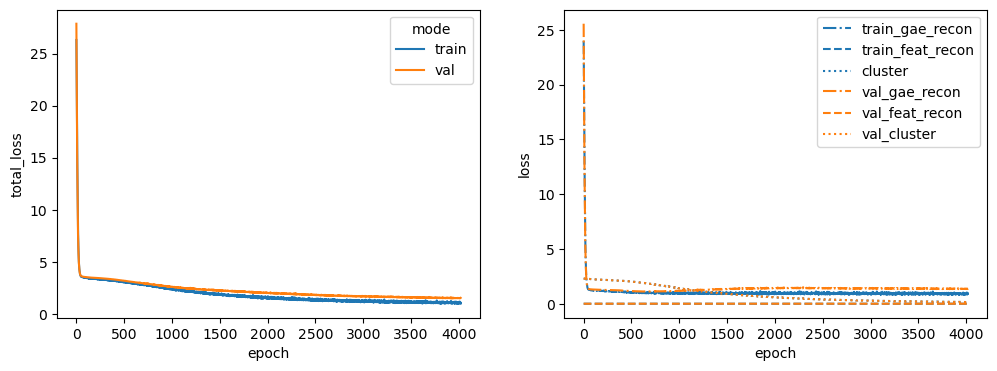

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


MOS
Latent dim: 1024


 46%|████▋     | 4644/10000 [01:34<01:48, 49.17it/s]


Training stopped after 4645 epochs
Best model found at epoch 4543
------------------------------------------------------------
TEST AUC: 0.8046258503401361 AP: 0.8202377817550506
TRAIN loss: 1.0713038444519043
VAL loss: 1.3039617538452148
TEST loss: 1.3750320672988892
TEST AUC: 0.8046258503401361 	 AP: 0.8202377817550506


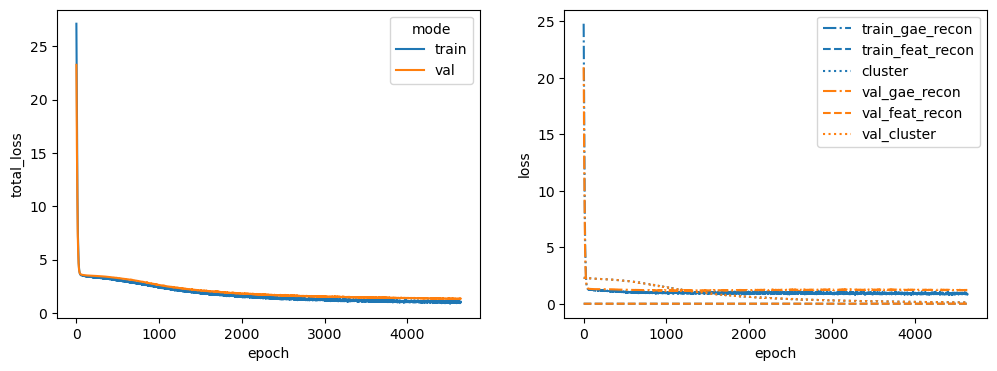

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


MYD88
Latent dim: 1024


 34%|███▍      | 3410/10000 [01:10<02:15, 48.56it/s]


Training stopped after 3411 epochs
Best model found at epoch 3309
------------------------------------------------------------
TEST AUC: 0.836190476190476 AP: 0.8597274386043245
TRAIN loss: 1.1869271993637085
VAL loss: 1.7421821355819702
TEST loss: 1.385454773902893
TEST AUC: 0.836190476190476 	 AP: 0.8597274386043245


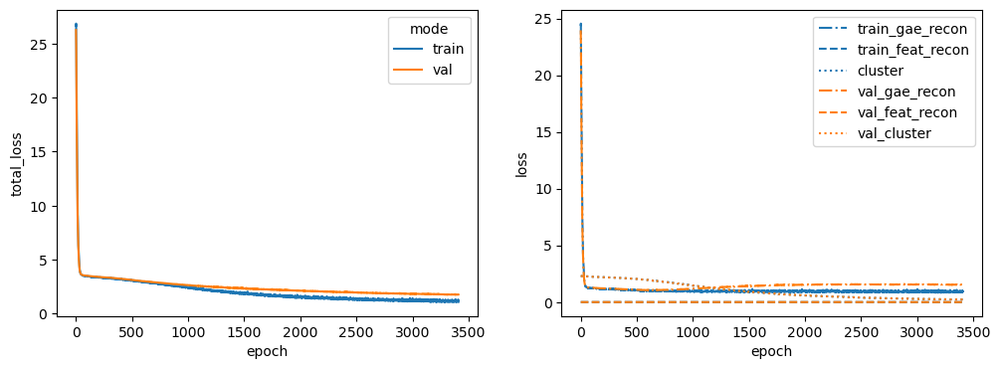

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


PIK3R2
Latent dim: 1024


 26%|██▋       | 2625/10000 [00:53<02:30, 49.14it/s]


Training stopped after 2626 epochs
Best model found at epoch 2524
------------------------------------------------------------
TEST AUC: 0.826938775510204 AP: 0.8380728468226988
TRAIN loss: 1.29250168800354
VAL loss: 1.6049076318740845
TEST loss: 1.5933972597122192
TEST AUC: 0.826938775510204 	 AP: 0.8380728468226988


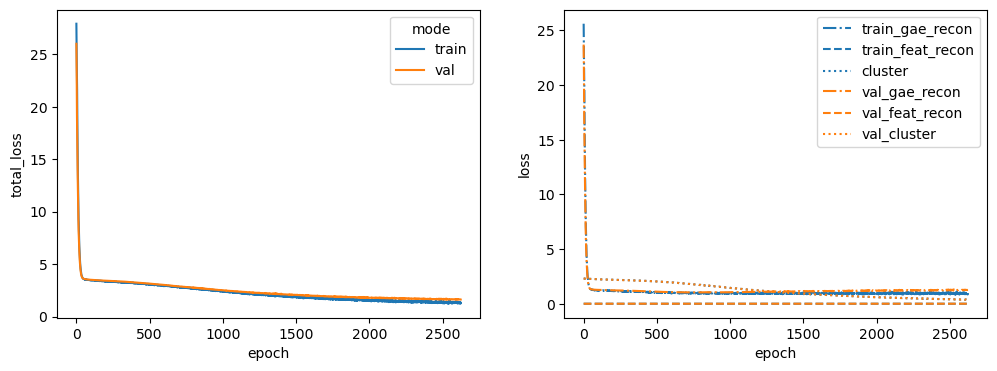

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


PRKACA
Latent dim: 1024


 33%|███▎      | 3266/10000 [01:06<02:16, 49.28it/s]


Training stopped after 3267 epochs
Best model found at epoch 3165
------------------------------------------------------------
TEST AUC: 0.7969160997732426 AP: 0.783549857931291
TRAIN loss: 1.188728928565979
VAL loss: 1.841705560684204
TEST loss: 1.5698515176773071
TEST AUC: 0.7969160997732426 	 AP: 0.783549857931291


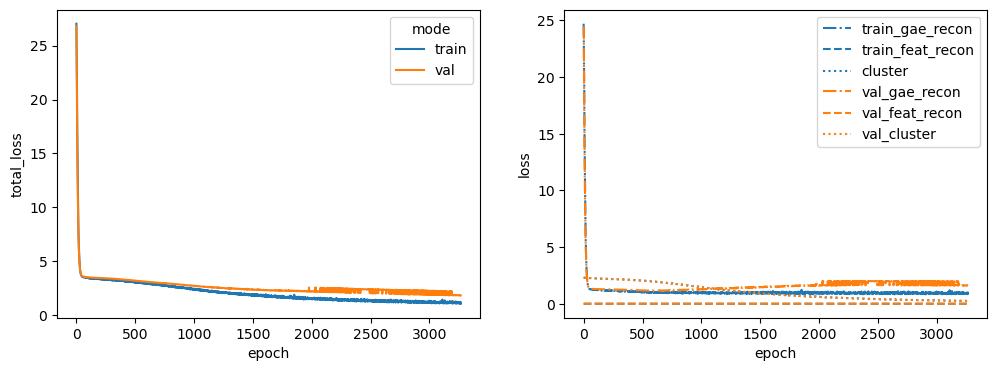

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


PRKCE
Latent dim: 1024


 30%|██▉       | 2962/10000 [01:00<02:23, 49.05it/s]


Training stopped after 2963 epochs
Best model found at epoch 2861
------------------------------------------------------------
TEST AUC: 0.8171428571428571 AP: 0.8201187131533654
TRAIN loss: 1.1780085563659668
VAL loss: 1.7073885202407837
TEST loss: 1.5489448308944702
TEST AUC: 0.8171428571428571 	 AP: 0.8201187131533654


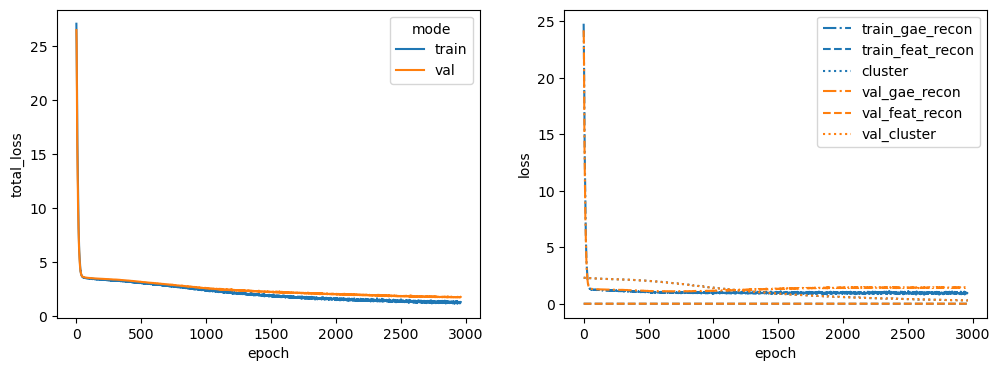

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


RAF1
Latent dim: 1024


 40%|███▉      | 3966/10000 [01:21<02:03, 48.68it/s]


Training stopped after 3967 epochs
Best model found at epoch 3865
------------------------------------------------------------
TEST AUC: 0.8059863945578232 AP: 0.8172227861781106
TRAIN loss: 1.050823450088501
VAL loss: 1.338753342628479
TEST loss: 1.4320640563964844
TEST AUC: 0.8059863945578232 	 AP: 0.8172227861781106


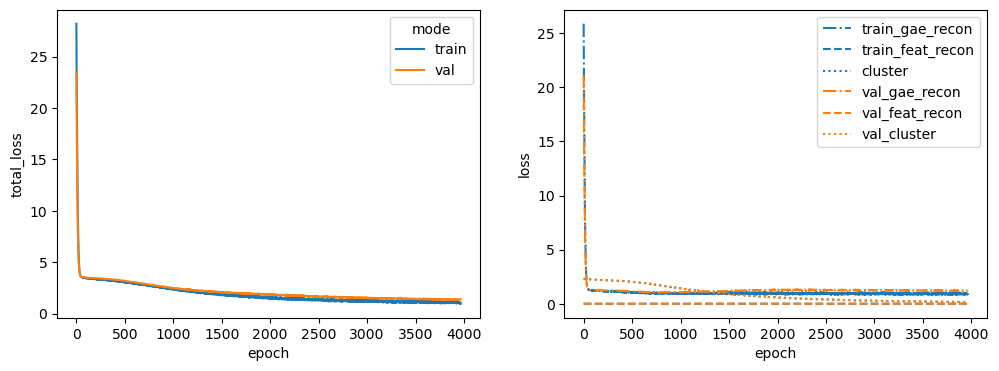

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


RELB
Latent dim: 1024


 49%|████▉     | 4941/10000 [01:41<01:43, 48.71it/s]


Training stopped after 4942 epochs
Best model found at epoch 4840
------------------------------------------------------------
TEST AUC: 0.8315646258503402 AP: 0.8488702758374437
TRAIN loss: 0.9529486894607544
VAL loss: 1.3001039028167725
TEST loss: 1.2469079494476318
TEST AUC: 0.8315646258503402 	 AP: 0.8488702758374437


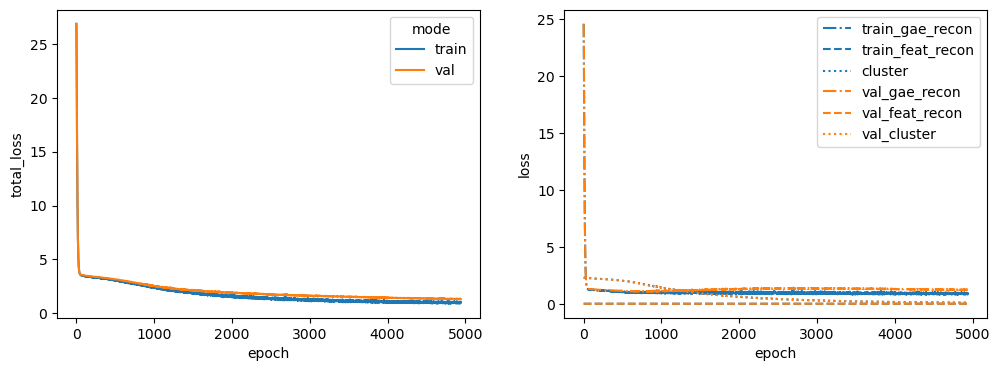

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


RHOA
Latent dim: 1024


 36%|███▌      | 3622/10000 [01:12<02:07, 49.96it/s]


Training stopped after 3623 epochs
Best model found at epoch 3521
------------------------------------------------------------
TEST AUC: 0.8188662131519274 AP: 0.8174048849490465
TRAIN loss: 1.0913585424423218
VAL loss: 1.4121274948120117
TEST loss: 1.4491318464279175
TEST AUC: 0.8188662131519274 	 AP: 0.8174048849490465


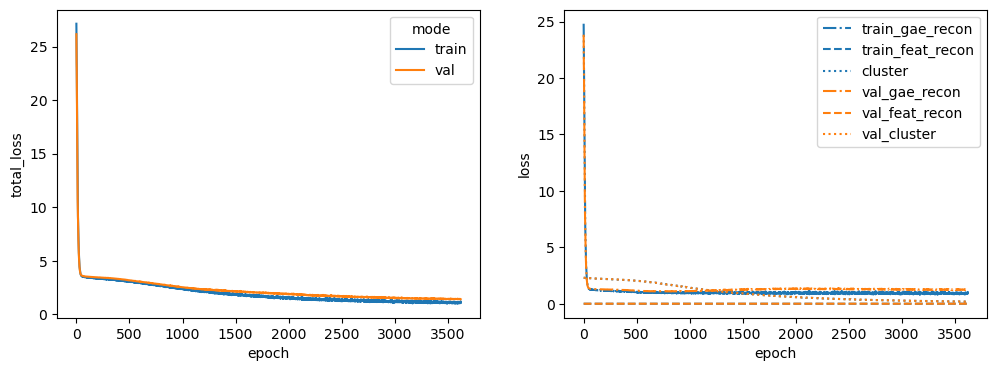

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


SMAD4
Latent dim: 1024


 43%|████▎     | 4270/10000 [01:24<01:53, 50.65it/s]


Training stopped after 4271 epochs
Best model found at epoch 4169
------------------------------------------------------------
TEST AUC: 0.8127891156462586 AP: 0.8054098447394332
TRAIN loss: 1.0532184839248657
VAL loss: 1.253782868385315
TEST loss: 1.4196135997772217
TEST AUC: 0.8127891156462586 	 AP: 0.8054098447394332


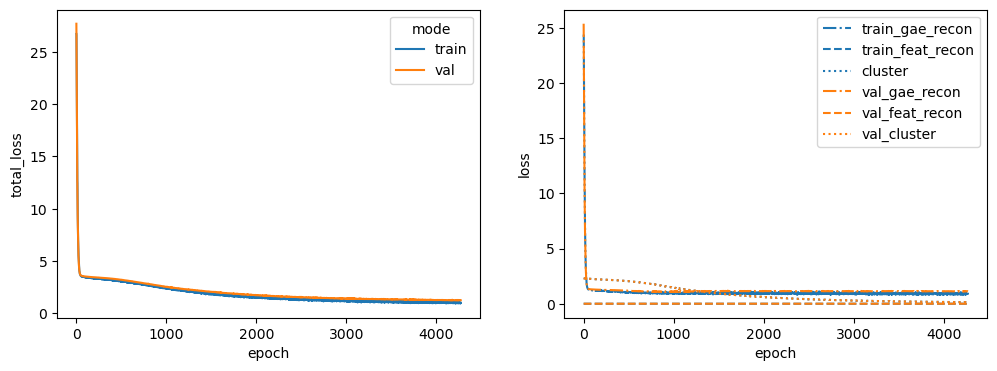

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


SMO
Latent dim: 1024


 46%|████▌     | 4553/10000 [01:33<01:52, 48.52it/s]


Training stopped after 4554 epochs
Best model found at epoch 4452
------------------------------------------------------------
TEST AUC: 0.8145124716553288 AP: 0.8317846839721166
TRAIN loss: 1.03352689743042
VAL loss: 1.3427560329437256
TEST loss: 1.3646466732025146
TEST AUC: 0.8145124716553288 	 AP: 0.8317846839721166


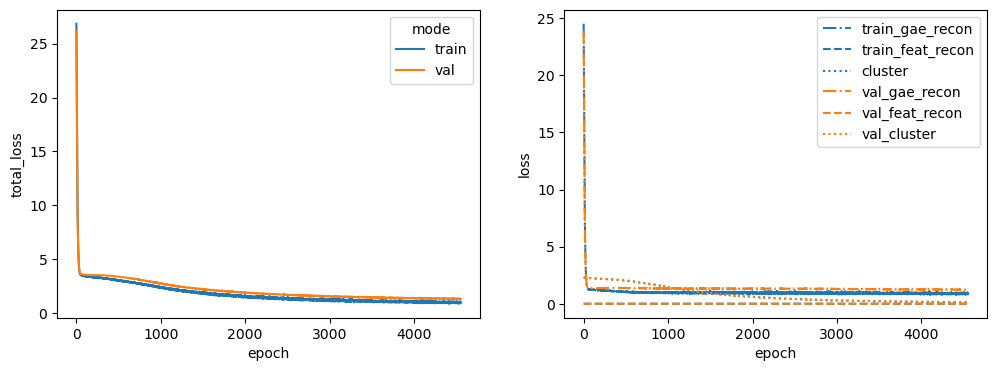

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


SRC
Latent dim: 1024


 34%|███▍      | 3419/10000 [01:09<02:13, 49.19it/s]


Training stopped after 3420 epochs
Best model found at epoch 3318
------------------------------------------------------------
TEST AUC: 0.7820408163265307 AP: 0.7891242526736801
TRAIN loss: 1.0932891368865967
VAL loss: 1.3689452409744263
TEST loss: 1.558580756187439
TEST AUC: 0.7820408163265307 	 AP: 0.7891242526736801


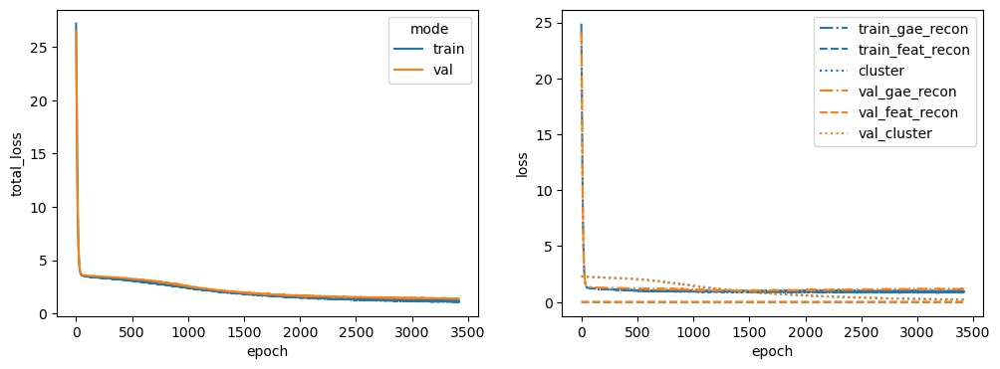

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


SREBF1
Latent dim: 1024


 31%|███▏      | 3130/10000 [01:06<02:25, 47.31it/s]


Training stopped after 3131 epochs
Best model found at epoch 3029
------------------------------------------------------------
TEST AUC: 0.7909297052154195 AP: 0.755273416354802
TRAIN loss: 1.2299253940582275
VAL loss: 1.6492035388946533
TEST loss: 1.6536474227905273
TEST AUC: 0.7909297052154195 	 AP: 0.755273416354802


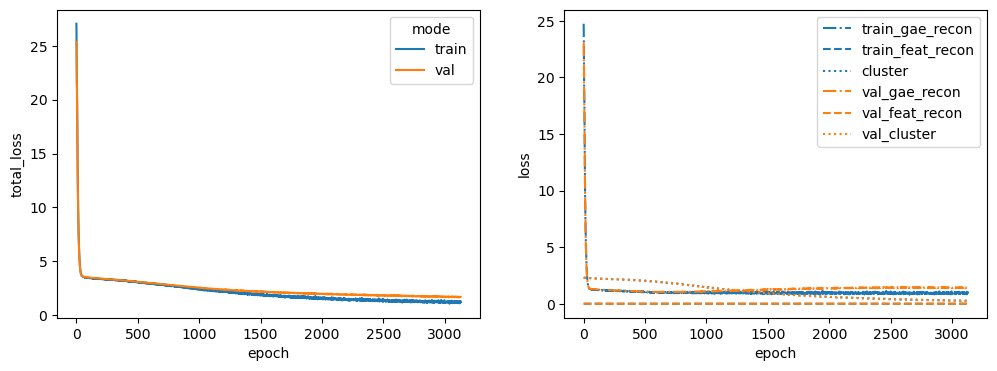

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


TRAF2
Latent dim: 1024


 35%|███▍      | 3477/10000 [01:10<02:12, 49.09it/s]


Training stopped after 3478 epochs
Best model found at epoch 3376
------------------------------------------------------------
TEST AUC: 0.8379138321995465 AP: 0.8340675613603683
TRAIN loss: 1.2267262935638428
VAL loss: 1.5319600105285645
TEST loss: 1.4131264686584473
TEST AUC: 0.8379138321995465 	 AP: 0.8340675613603683


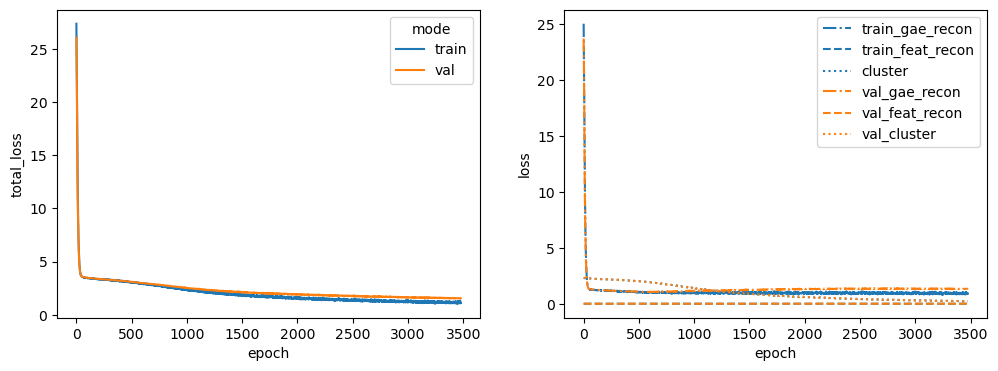

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


TSC2
Latent dim: 1024


 34%|███▍      | 3420/10000 [01:09<02:13, 49.44it/s]


Training stopped after 3421 epochs
Best model found at epoch 3319
------------------------------------------------------------
TEST AUC: 0.7947392290249433 AP: 0.7859324673493474
TRAIN loss: 1.1165342330932617
VAL loss: 1.371411681175232
TEST loss: 1.5878928899765015
TEST AUC: 0.7947392290249433 	 AP: 0.7859324673493474


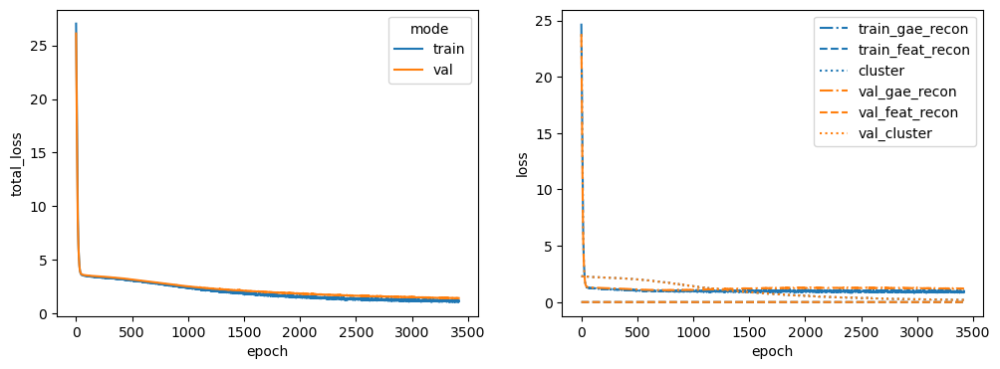

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


WWTR1
Latent dim: 1024


 38%|███▊      | 3812/10000 [01:16<02:04, 49.65it/s]


Training stopped after 3813 epochs
Best model found at epoch 3711
------------------------------------------------------------
TEST AUC: 0.8207709750566892 AP: 0.8390728676041752
TRAIN loss: 1.0753121376037598
VAL loss: 1.4742082357406616
TEST loss: 1.3524149656295776
TEST AUC: 0.8207709750566892 	 AP: 0.8390728676041752


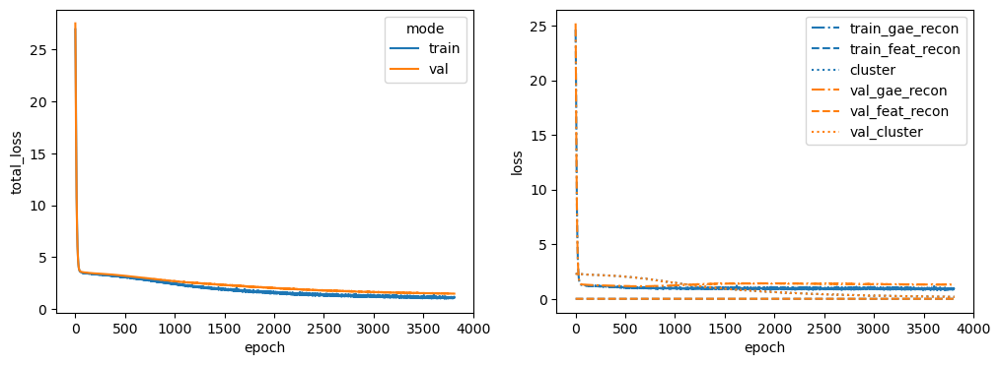

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


<IPython.core.display.Javascript object>

In [45]:
for oe_target in oe_targets:
    print(oe_target)
    phy_clusters = cmap_clusters.copy()
    phy_clusters.loc[oe_target] = -1
    lut = dict(
        zip(
            list(np.unique(phy_clusters)),
            [
                "tab:blue",
                "tab:red",
                "tab:green",
                "gold",
                "tab:orange",
                "tab:cyan",
                "tab:purple",
                "tab:pink",
                "tab:olive",
                "olivedrab",
                "tab:brown",
            ],
        )
    )
    phy_clusters.loc[:, "color"] = phy_clusters.loc[:, "cluster"].map(lut)
    spearman_interactome = graph_dict[oe_target]

    device = torch.device("cpu")

    graph_data = from_networkx(spearman_interactome)
    graph_data.id = torch.FloatTensor(np.identity(len(spearman_interactome)))
    graph_data = T.ToDevice(
        device,
        attrs=[
            "id",
            "sc_gex",
            "label",
            "label_mask",
            "hallmark",
            "sc_gex_hallmark",
        ],
    )(graph_data)

    input_dim = 1176
    latent_dim = 1024

    # Derive class weights
    class_weights = OrderedDict(
        sorted(dict(Counter(np.array(phy_clusters.loc[:, "cluster"]))).items())
    )
    del class_weights[-1]
    class_weights = np.array(list(class_weights.values()))
    class_weights = 1 / class_weights
    class_weights = class_weights / np.sum(class_weights)

    class_weights = None

    gae = GAE(
        GCNEncoder(in_channels=input_dim, out_channels=latent_dim, hidden_dim=1024)
    )
    feature_decoder = FeatureDecoder(
        latent_dim=latent_dim,
        hidden_dims=[1024],
        output_dim=input_dim,
        loss_fct=torch.nn.L1Loss(),
    )
    latent_classifier = LatentClassifier(
        latent_dim=latent_dim,
        hidden_dims=None,
        n_classes=10,
        loss_fct=None,
        class_weights=class_weights,
    )

    seeds = [1234]
    alpha = 1
    beta = 0
    gamma = 1
    use_graph = "split_graph"

    node_feature_key = "sc_gex_hallmark"
    edge_weight_key = None

    print("Latent dim: {}".format(1024))
    latents_dict, loss_hist_dict = get_gae_latents_for_seed(
        graph_data=graph_data,
        gae=gae,
        seeds=seeds,
        node_feature_key=node_feature_key,
        edge_weight_key=edge_weight_key,
        feature_decoder=feature_decoder,
        latent_classifier=latent_classifier,
        n_epochs=10000,
        lr=0.00001,
        split_type="link",
        alpha=alpha,
        beta=beta,
        gamma=gamma,
        plot_loss=True,
        early_stopping=100,
        use_full_graph=use_graph == "full_graph",
        neg_edge_ratio=1.0,
    )

    output_dir = "../../../data/experiments/image_embeddings/specificity_target_emb_loto/embeddings/{}".format(
        oe_target
    )

    output_dir = os.path.join(
        output_dir,
        "gae_exp_a{}_b{}_g{}_{}_cmap_target_out".format(alpha, beta, gamma, use_graph),
    )
    os.makedirs(output_dir, exist_ok=True)

    latents = latents_dict[1234]
    node_names = getattr(graph_data, "name")
    st_memberships = getattr(graph_data, "spec_target")
    latents = pd.DataFrame(latents, index=node_names)

    embs = TSNE(
        random_state=1234,
        perplexity=int(np.sqrt(len(latents))) + 1,
        init="pca",
        learning_rate="auto",
    ).fit_transform(latents)
    embs = pd.DataFrame(embs, columns=["tsne_0", "tsne_1"], index=node_names)
    embs["spec_target"] = st_memberships.cpu().numpy()

    fig, ax = plt.subplots(figsize=[20, 10])
    ax = sns.scatterplot(
        data=embs, x="tsne_0", y="tsne_1", cmap="viridis", hue="spec_target"
    )
    label_point(
        np.array(embs.loc[:, "tsne_0"]),
        np.array(embs.loc[:, "tsne_1"]),
        np.array(embs.index).astype("str"),
        ax=ax,
    )
    ax.set_title("Visualization of the inferred embedding space")
    plt.savefig(
        os.path.join(
            output_dir,
            "tsne_embs.png".format(alpha, beta, gamma, use_graph),
        ), bbox_inches = "tight"
    )
    plt.close()

    ax = sns.clustermap(
        latents.loc[set(oe_targets).intersection(latents.index)],
        figsize=[6, 12],
        metric="cosine",
        method="complete",
        cmap="seismic",
        row_colors=np.array(
            phy_clusters.loc[set(oe_targets).intersection(latents.index), "color"]
        ).ravel(),
    )
    ax.ax_heatmap.set_yticklabels(
        ax.ax_heatmap.get_ymajorticklabels(),
        fontsize=15,
        fontweight="bold",
    )
    plt.savefig(
        os.path.join(
            output_dir,
            "reg_clustering.png".format(alpha, beta, gamma, use_graph),
        ), bbox_inches = "tight"
    )
    plt.close()

    latents.to_csv(
        os.path.join(
            output_dir,
            "node_embs.csv".format(alpha, beta, gamma, use_graph),
        )
    )

AKT1S1
Latent dim: 1024


 45%|████▌     | 4517/10000 [01:23<01:40, 54.33it/s]


Training stopped after 4518 epochs
Best model found at epoch 4416
------------------------------------------------------------
TEST AUC: 0.7927437641723356 AP: 0.777450683007244
TRAIN loss: 1.526879072189331
VAL loss: 2.4032015800476074
TEST loss: 1.9722497463226318
TEST AUC: 0.7927437641723356 	 AP: 0.777450683007244


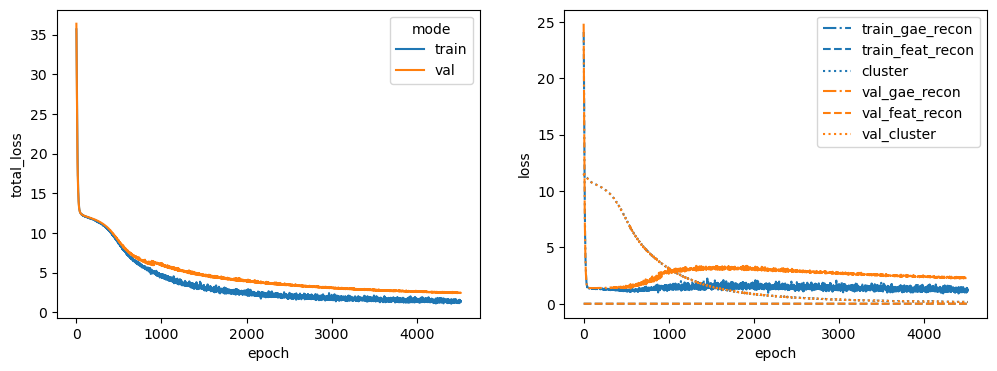

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


ATF4
Latent dim: 1024


 35%|███▌      | 3508/10000 [01:03<01:56, 55.68it/s]


Training stopped after 3509 epochs
Best model found at epoch 3407
------------------------------------------------------------
TEST AUC: 0.7821315192743763 AP: 0.787590968183344
TRAIN loss: 1.851243495941162
VAL loss: 1.506281852722168
TEST loss: 2.0017333030700684
TEST AUC: 0.7821315192743763 	 AP: 0.787590968183344


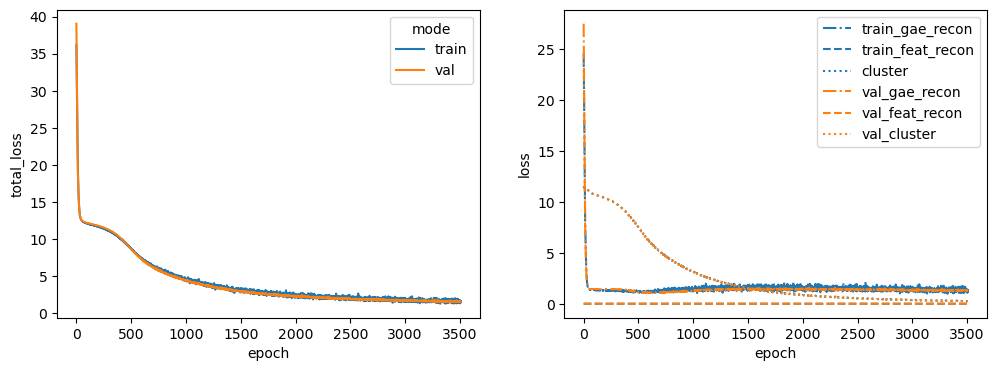

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


BAX
Latent dim: 1024


 19%|█▉        | 1879/10000 [00:34<02:28, 54.75it/s]


Training stopped after 1880 epochs
Best model found at epoch 1778
------------------------------------------------------------
TEST AUC: 0.7455782312925171 AP: 0.7149186792442283
TRAIN loss: 2.804835319519043
VAL loss: 3.2773690223693848
TEST loss: 3.264913558959961
TEST AUC: 0.7455782312925171 	 AP: 0.7149186792442283


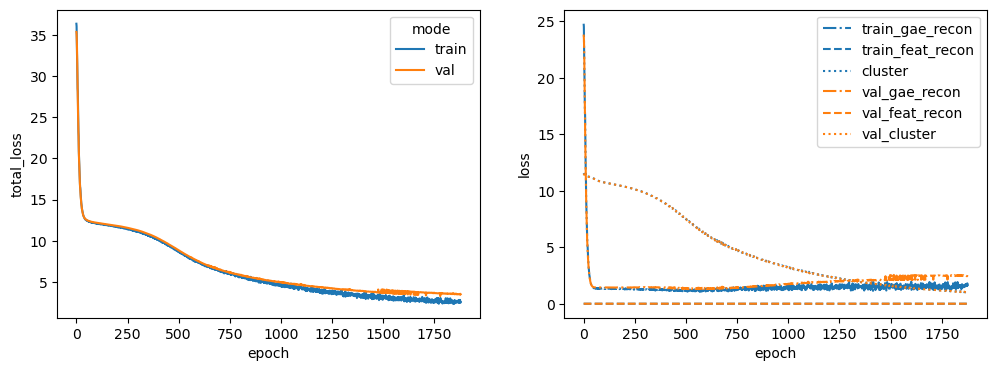

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


BCL2L11
Latent dim: 1024


 17%|█▋        | 1670/10000 [00:29<02:28, 55.92it/s]


Training stopped after 1671 epochs
Best model found at epoch 1569
------------------------------------------------------------
TEST AUC: 0.7803174603174603 AP: 0.7540006358363074
TRAIN loss: 2.884591579437256
VAL loss: 4.1592116355896
TEST loss: 3.5246682167053223
TEST AUC: 0.7803174603174603 	 AP: 0.7540006358363074


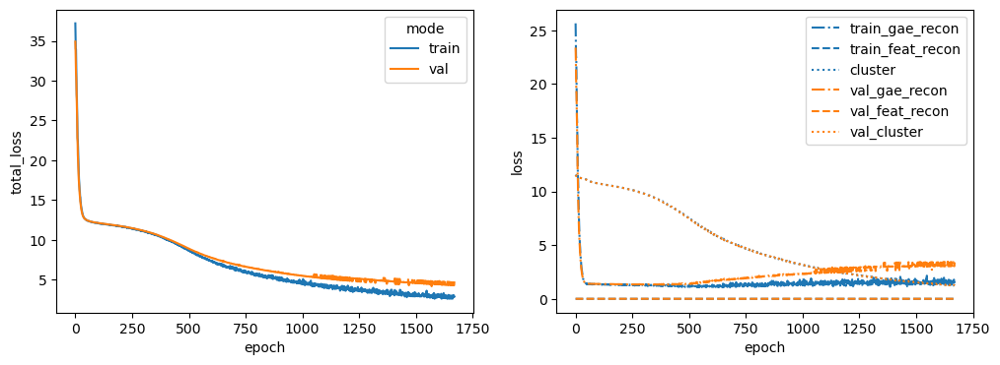

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


BRAF
Latent dim: 1024


 33%|███▎      | 3328/10000 [01:00<02:01, 54.84it/s]


Training stopped after 3329 epochs
Best model found at epoch 3227
------------------------------------------------------------
TEST AUC: 0.7703401360544218 AP: 0.7187070919706114
TRAIN loss: 1.6410515308380127
VAL loss: 1.9912681579589844
TEST loss: 3.0466442108154297
TEST AUC: 0.7703401360544218 	 AP: 0.7187070919706114


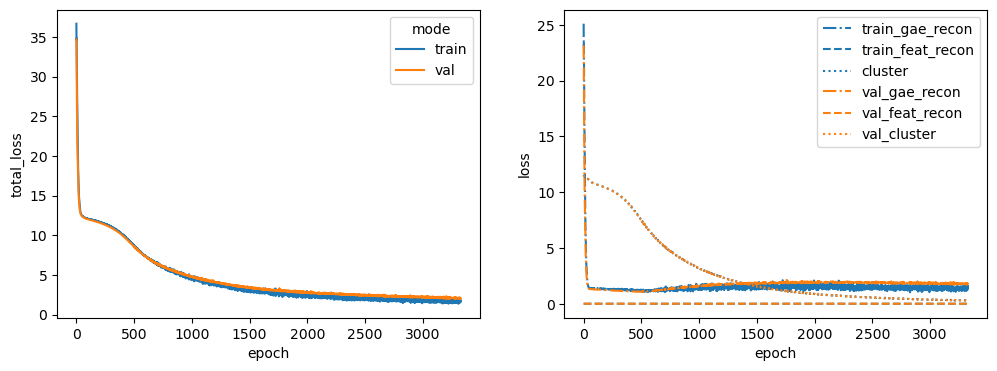

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


CASP8
Latent dim: 1024


 35%|███▌      | 3510/10000 [01:02<01:56, 55.72it/s]


Training stopped after 3511 epochs
Best model found at epoch 3409
------------------------------------------------------------
TEST AUC: 0.7925623582766439 AP: 0.7967322527665817
TRAIN loss: 1.715198040008545
VAL loss: 2.367974281311035
TEST loss: 2.039475202560425
TEST AUC: 0.7925623582766439 	 AP: 0.7967322527665817


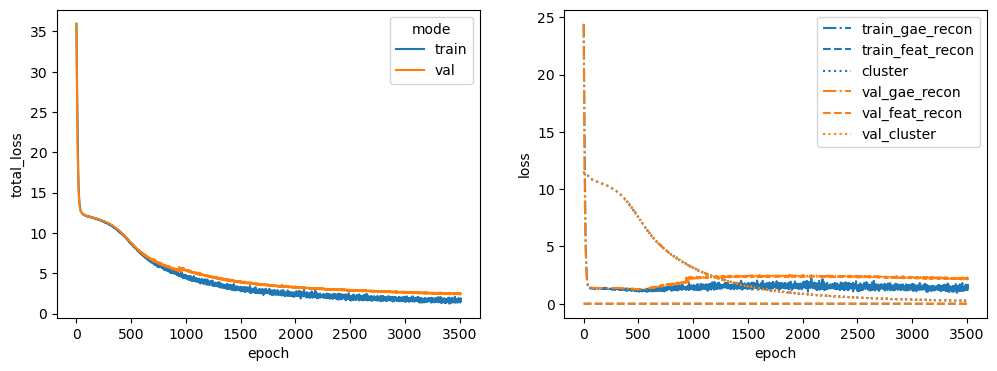

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


CDC42
Latent dim: 1024


 32%|███▏      | 3170/10000 [00:59<02:07, 53.57it/s]


Training stopped after 3171 epochs
Best model found at epoch 3069
------------------------------------------------------------
TEST AUC: 0.7726984126984127 AP: 0.7335923129291938
TRAIN loss: 1.8403360843658447
VAL loss: 1.6933821439743042
TEST loss: 2.76670503616333
TEST AUC: 0.7726984126984127 	 AP: 0.7335923129291938


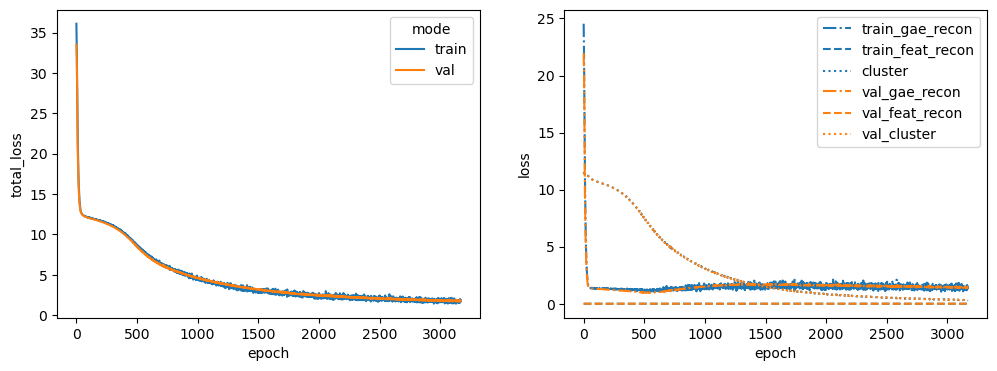

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


CDKN1A
Latent dim: 1024


 63%|██████▎   | 6332/10000 [01:53<01:05, 55.71it/s]


Training stopped after 6333 epochs
Best model found at epoch 6231
------------------------------------------------------------
TEST AUC: 0.7961904761904763 AP: 0.7821259991941556
TRAIN loss: 1.0505410432815552
VAL loss: 1.5366578102111816
TEST loss: 1.9546246528625488
TEST AUC: 0.7961904761904763 	 AP: 0.7821259991941556


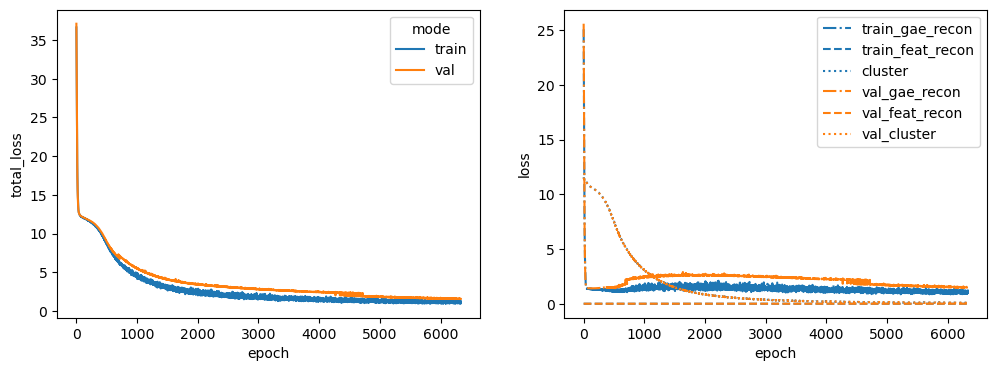

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


CEBPA
Latent dim: 1024


 12%|█▏        | 1157/10000 [00:21<02:46, 53.25it/s]


Training stopped after 1158 epochs
Best model found at epoch 1056
------------------------------------------------------------
TEST AUC: 0.8020408163265307 AP: 0.7615406590347207
TRAIN loss: 4.383432388305664
VAL loss: 5.844325065612793
TEST loss: 4.764932632446289
TEST AUC: 0.8020408163265307 	 AP: 0.7615406590347207


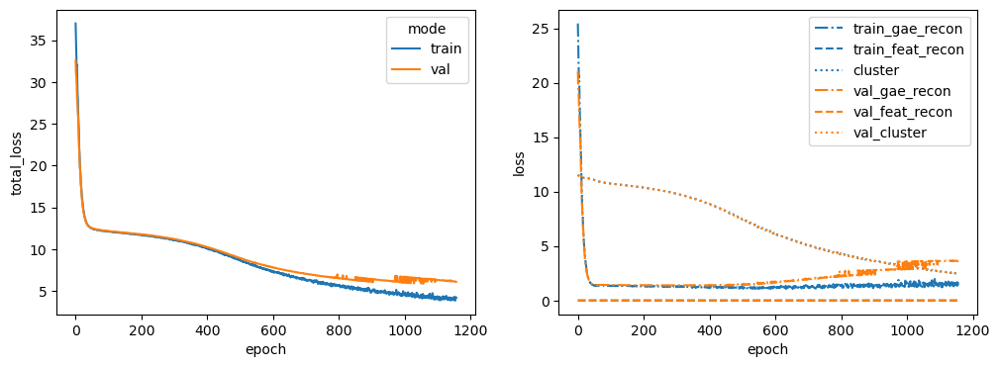

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


CREB1
Latent dim: 1024


 47%|████▋     | 4705/10000 [01:25<01:36, 54.93it/s]


Training stopped after 4706 epochs
Best model found at epoch 4604
------------------------------------------------------------
TEST AUC: 0.7892063492063491 AP: 0.7753898481730812
TRAIN loss: 1.2878530025482178
VAL loss: 1.4776027202606201
TEST loss: 2.1247949600219727
TEST AUC: 0.7892063492063491 	 AP: 0.7753898481730812


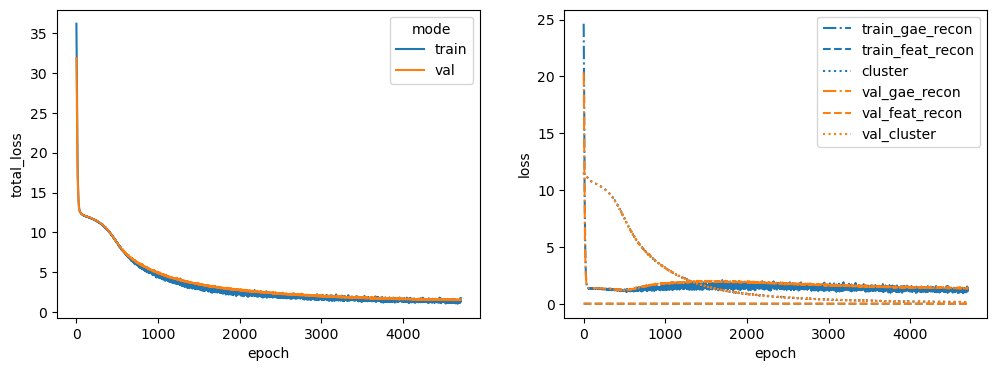

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


CXXC4
Latent dim: 1024


 23%|██▎       | 2343/10000 [00:43<02:20, 54.40it/s]


Training stopped after 2344 epochs
Best model found at epoch 2242
------------------------------------------------------------
TEST AUC: 0.7663038548752834 AP: 0.740400219055973
TRAIN loss: 2.326827049255371
VAL loss: 2.7429583072662354
TEST loss: 2.8674073219299316
TEST AUC: 0.7663038548752834 	 AP: 0.740400219055973


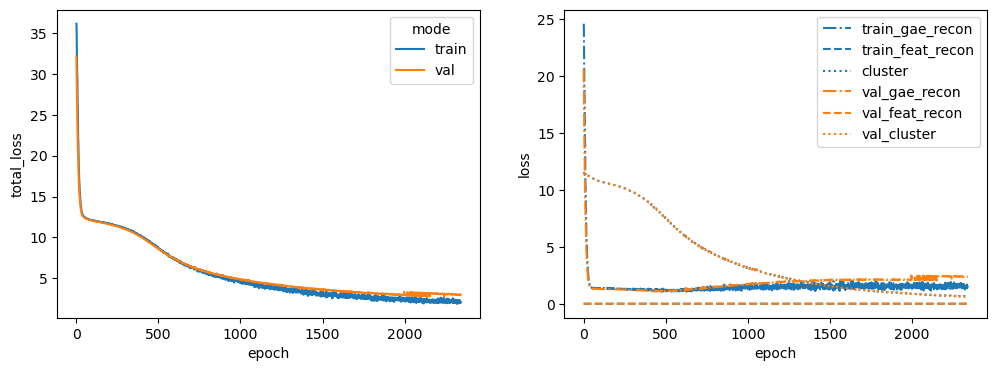

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


DIABLO
Latent dim: 1024


 37%|███▋      | 3732/10000 [01:09<01:56, 53.65it/s]


Training stopped after 3733 epochs
Best model found at epoch 3631
------------------------------------------------------------
TEST AUC: 0.7895691609977324 AP: 0.7911738996754405
TRAIN loss: 1.7942756414413452
VAL loss: 1.7305245399475098
TEST loss: 1.9608296155929565
TEST AUC: 0.7895691609977324 	 AP: 0.7911738996754405


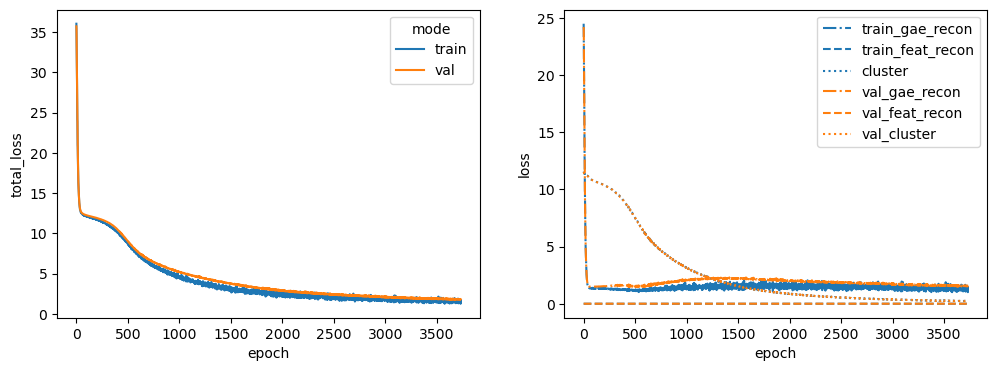

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


E2F1
Latent dim: 1024


 12%|█▏        | 1171/10000 [00:20<02:38, 55.83it/s]


Training stopped after 1172 epochs
Best model found at epoch 1070
------------------------------------------------------------
TEST AUC: 0.76421768707483 AP: 0.7589376719332406
TRAIN loss: 4.380685806274414
VAL loss: 6.538209915161133
TEST loss: 4.942169189453125
TEST AUC: 0.76421768707483 	 AP: 0.7589376719332406


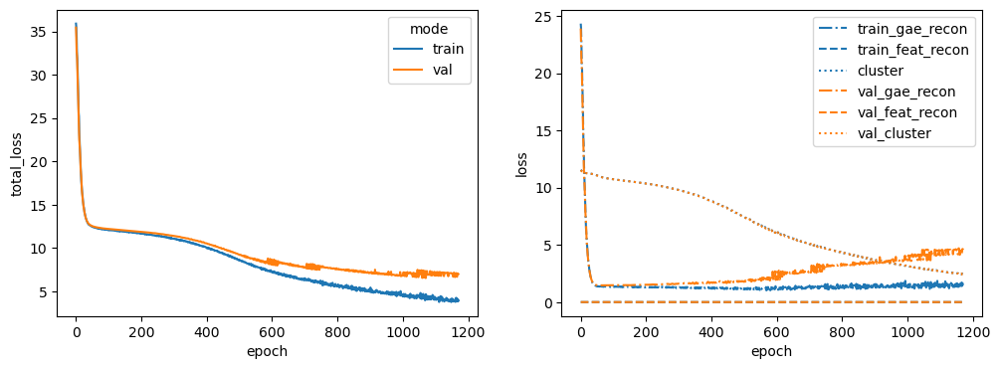

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


ELK1
Latent dim: 1024


 57%|█████▋    | 5722/10000 [01:44<01:18, 54.67it/s]


Training stopped after 5723 epochs
Best model found at epoch 5621
------------------------------------------------------------
TEST AUC: 0.8058956916099774 AP: 0.8055514427001167
TRAIN loss: 1.0283161401748657
VAL loss: 1.4790245294570923
TEST loss: 1.75931978225708
TEST AUC: 0.8058956916099774 	 AP: 0.8055514427001167


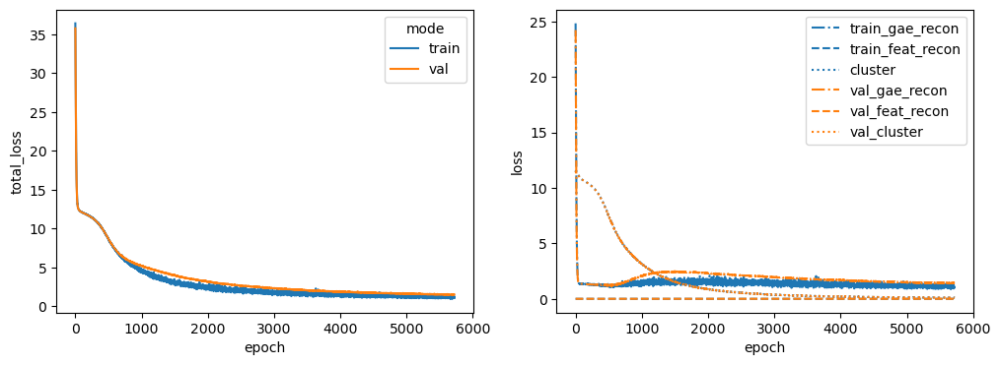

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


EMPTY
Latent dim: 1024


 30%|██▉       | 2999/10000 [00:53<02:04, 56.06it/s]


Training stopped after 3000 epochs
Best model found at epoch 2898
------------------------------------------------------------
TEST AUC: 0.7645351473922902 AP: 0.7557215741740462
TRAIN loss: 2.0552804470062256
VAL loss: 2.151094436645508
TEST loss: 2.4724502563476562
TEST AUC: 0.7645351473922902 	 AP: 0.7557215741740462


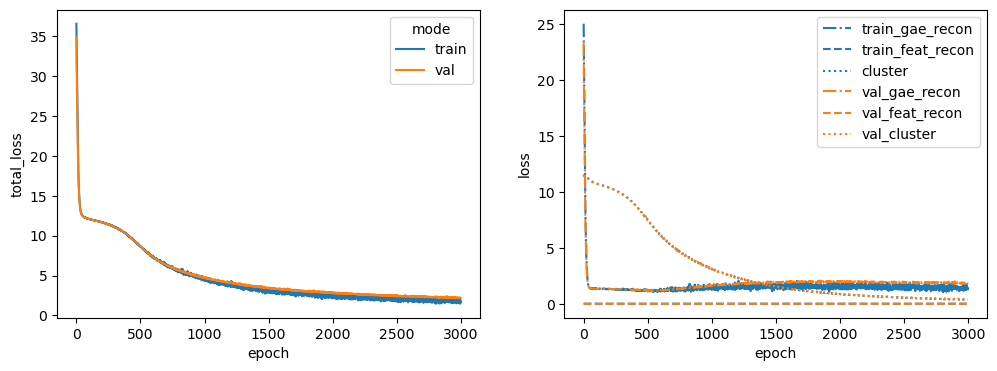

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


ERG
Latent dim: 1024


 15%|█▌        | 1548/10000 [00:28<02:37, 53.52it/s]


Training stopped after 1549 epochs
Best model found at epoch 1447
------------------------------------------------------------
TEST AUC: 0.7956462585034013 AP: 0.8008522518780335
TRAIN loss: 3.2195396423339844
VAL loss: 4.2450456619262695
TEST loss: 3.3510420322418213
TEST AUC: 0.7956462585034013 	 AP: 0.8008522518780335


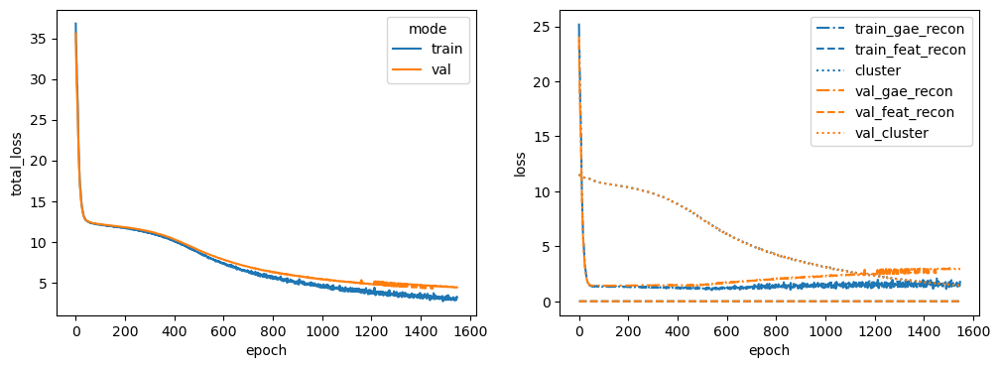

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


FGFR3
Latent dim: 1024


 30%|██▉       | 2982/10000 [00:55<02:11, 53.41it/s]


Training stopped after 2983 epochs
Best model found at epoch 2881
------------------------------------------------------------
TEST AUC: 0.788888888888889 AP: 0.789028479507696
TRAIN loss: 1.6639230251312256
VAL loss: 2.1943187713623047
TEST loss: 2.3734235763549805
TEST AUC: 0.788888888888889 	 AP: 0.789028479507696


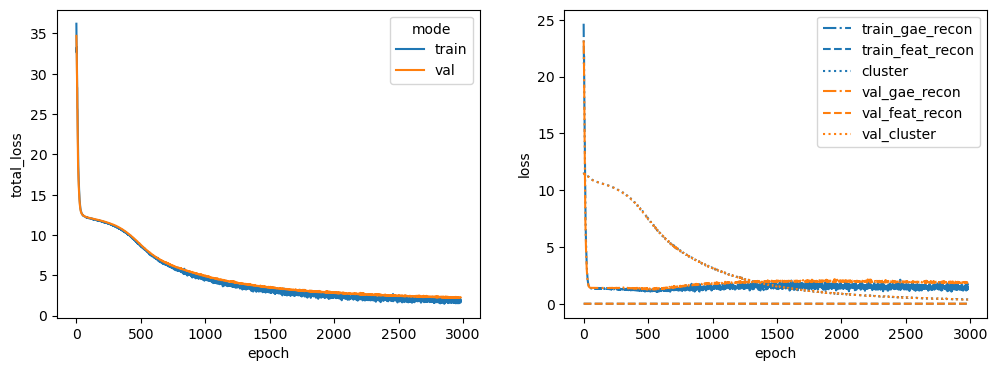

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


FOXO1
Latent dim: 1024


 17%|█▋        | 1744/10000 [00:32<02:32, 54.26it/s]


Training stopped after 1745 epochs
Best model found at epoch 1643
------------------------------------------------------------
TEST AUC: 0.7893877551020407 AP: 0.7481195990532642
TRAIN loss: 2.669527292251587
VAL loss: 3.3844738006591797
TEST loss: 3.6569619178771973
TEST AUC: 0.7893877551020407 	 AP: 0.7481195990532642


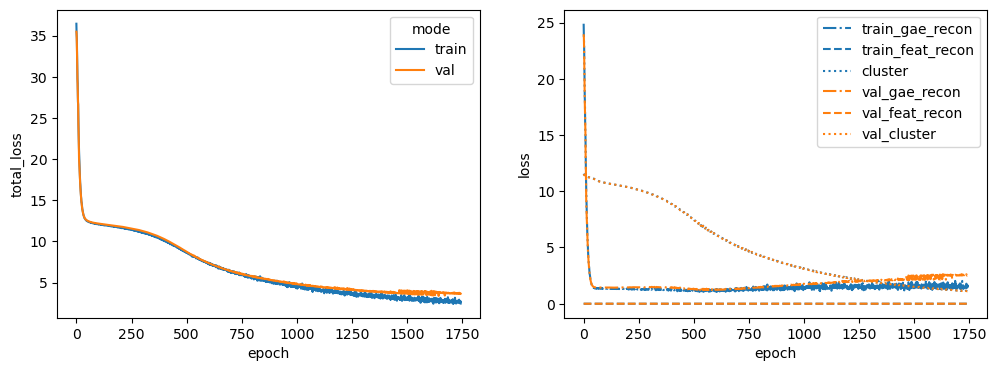

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


GLI1
Latent dim: 1024


 32%|███▎      | 3250/10000 [00:59<02:03, 54.75it/s]


Training stopped after 3251 epochs
Best model found at epoch 3149
------------------------------------------------------------
TEST AUC: 0.7504761904761904 AP: 0.7388773589112876
TRAIN loss: 1.9374536275863647
VAL loss: 1.5829463005065918
TEST loss: 2.3145692348480225
TEST AUC: 0.7504761904761904 	 AP: 0.7388773589112876


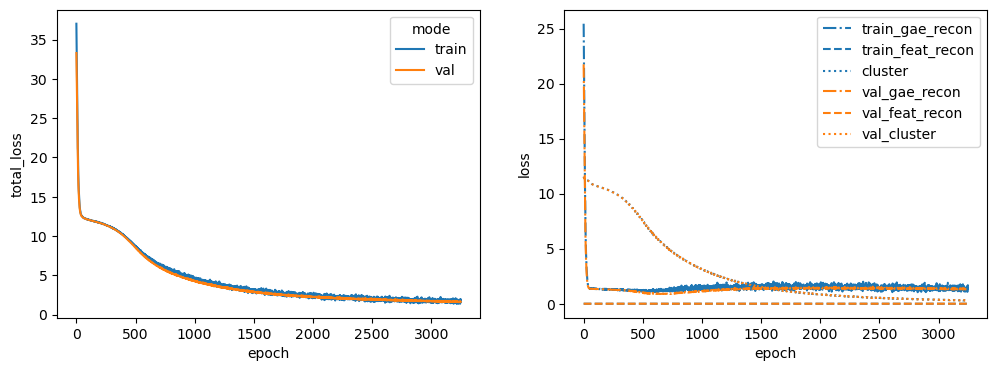

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


HRAS
Latent dim: 1024


 30%|██▉       | 2990/10000 [00:55<02:09, 54.18it/s]


Training stopped after 2991 epochs
Best model found at epoch 2889
------------------------------------------------------------
TEST AUC: 0.7819501133786847 AP: 0.7582682650751233
TRAIN loss: 1.7456129789352417
VAL loss: 2.1643030643463135
TEST loss: 2.473085403442383
TEST AUC: 0.7819501133786847 	 AP: 0.7582682650751233


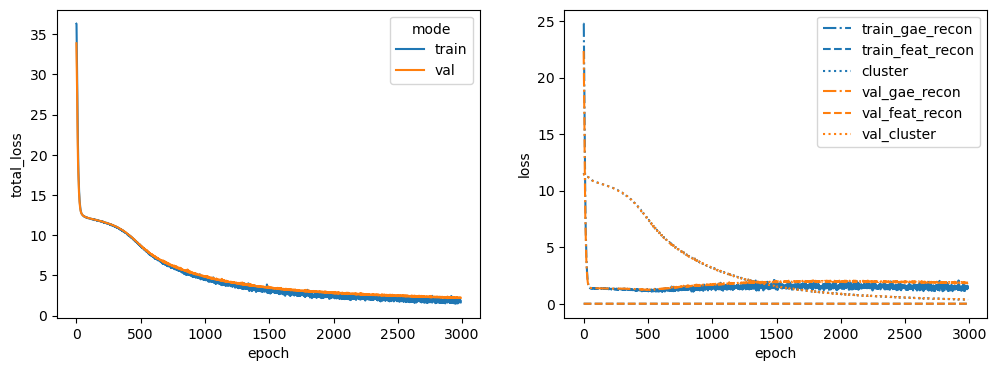

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


IRAK4
Latent dim: 1024


 32%|███▏      | 3227/10000 [00:58<02:03, 54.91it/s]


Training stopped after 3228 epochs
Best model found at epoch 3126
------------------------------------------------------------
TEST AUC: 0.8143310657596372 AP: 0.8235486369037743
TRAIN loss: 1.637992024421692
VAL loss: 1.7718219757080078
TEST loss: 2.1747689247131348
TEST AUC: 0.8143310657596372 	 AP: 0.8235486369037743


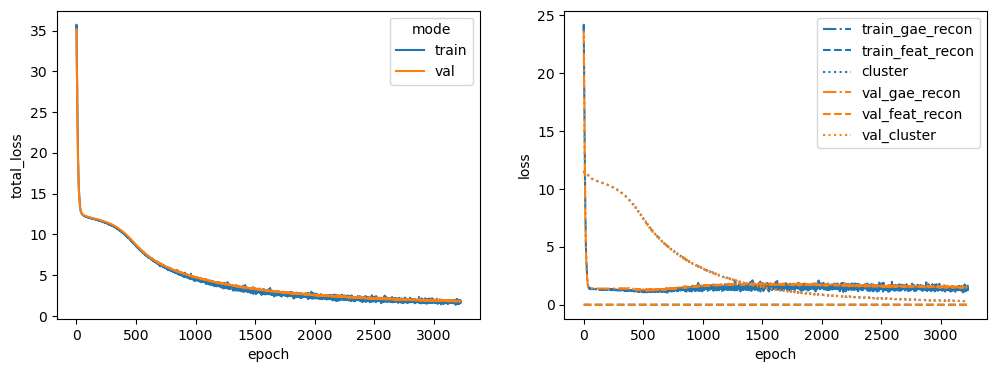

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


JUN
Latent dim: 1024


 46%|████▌     | 4595/10000 [01:23<01:37, 55.20it/s]


Training stopped after 4596 epochs
Best model found at epoch 4494
------------------------------------------------------------
TEST AUC: 0.7823582766439909 AP: 0.7619375123125798
TRAIN loss: 1.6226557493209839
VAL loss: 1.6260788440704346
TEST loss: 2.2037830352783203
TEST AUC: 0.7823582766439909 	 AP: 0.7619375123125798


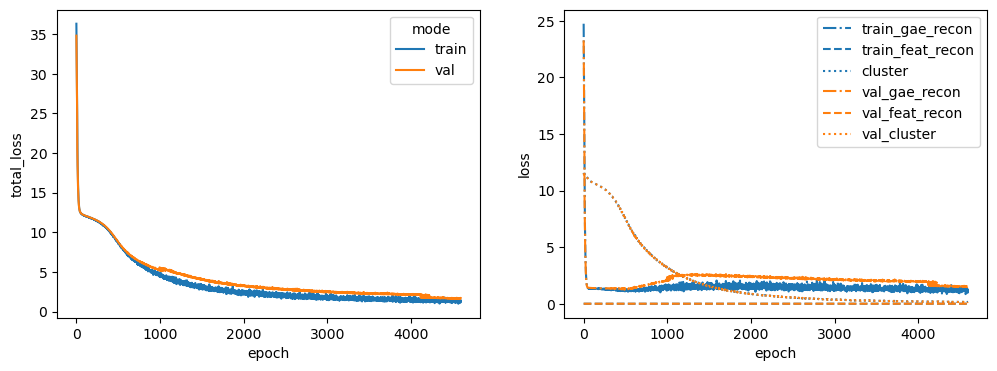

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


MAP2K3
Latent dim: 1024


 34%|███▍      | 3408/10000 [01:01<01:59, 55.29it/s]


Training stopped after 3409 epochs
Best model found at epoch 3307
------------------------------------------------------------
TEST AUC: 0.7658956916099774 AP: 0.7622140085503959
TRAIN loss: 1.5215150117874146
VAL loss: 2.014798164367676
TEST loss: 2.2405800819396973
TEST AUC: 0.7658956916099774 	 AP: 0.7622140085503959


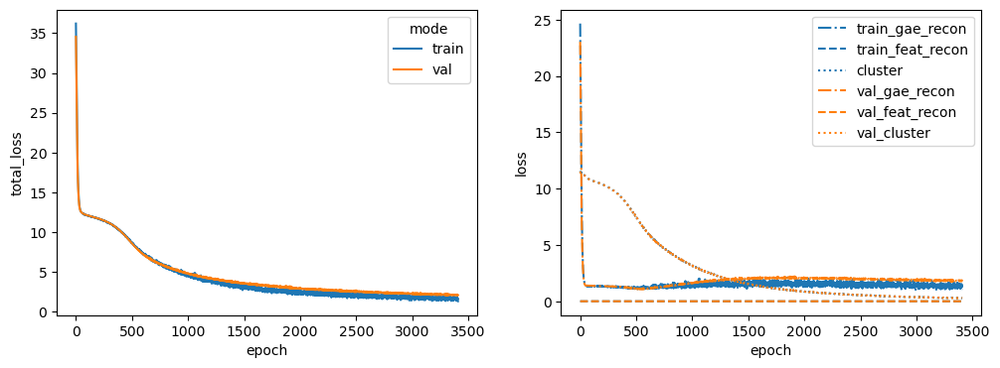

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


MAP3K2
Latent dim: 1024


 22%|██▏       | 2186/10000 [00:39<02:22, 54.73it/s]


Training stopped after 2187 epochs
Best model found at epoch 2085
------------------------------------------------------------
TEST AUC: 0.7569160997732427 AP: 0.7230845363686014
TRAIN loss: 2.3041086196899414
VAL loss: 3.2214300632476807
TEST loss: 3.0402235984802246
TEST AUC: 0.7569160997732427 	 AP: 0.7230845363686014


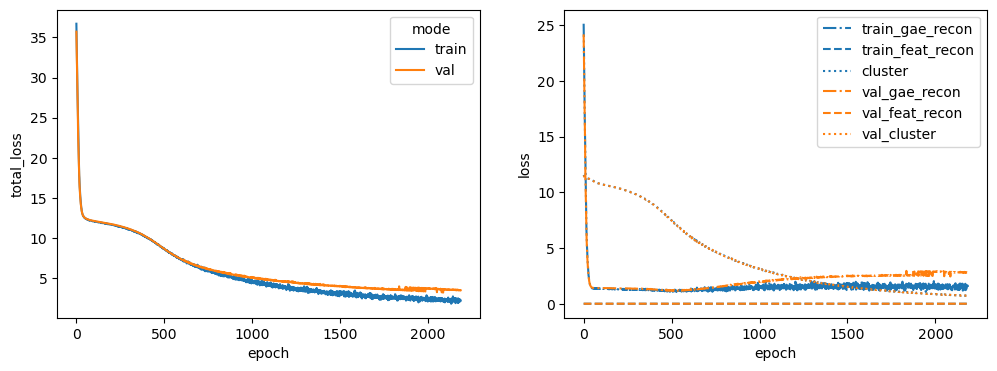

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


MAP3K5
Latent dim: 1024


 43%|████▎     | 4274/10000 [01:19<01:46, 53.95it/s]


Training stopped after 4275 epochs
Best model found at epoch 4173
------------------------------------------------------------
TEST AUC: 0.7822222222222222 AP: 0.8079862557827742
TRAIN loss: 1.342913031578064
VAL loss: 2.4172286987304688
TEST loss: 1.940840721130371
TEST AUC: 0.7822222222222222 	 AP: 0.8079862557827742


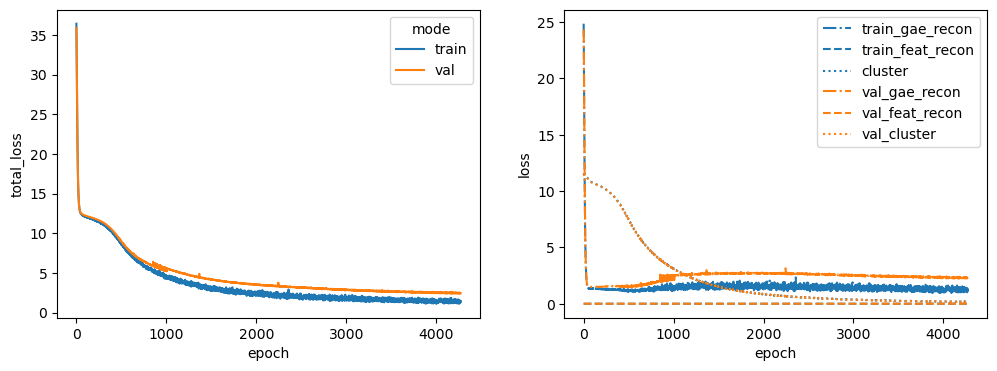

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


MAP3K9
Latent dim: 1024


 49%|████▉     | 4887/10000 [01:29<01:33, 54.70it/s]


Training stopped after 4888 epochs
Best model found at epoch 4786
------------------------------------------------------------
TEST AUC: 0.7654421768707483 AP: 0.7794861467470335
TRAIN loss: 1.4640170335769653
VAL loss: 1.7176194190979004
TEST loss: 1.9451631307601929
TEST AUC: 0.7654421768707483 	 AP: 0.7794861467470335


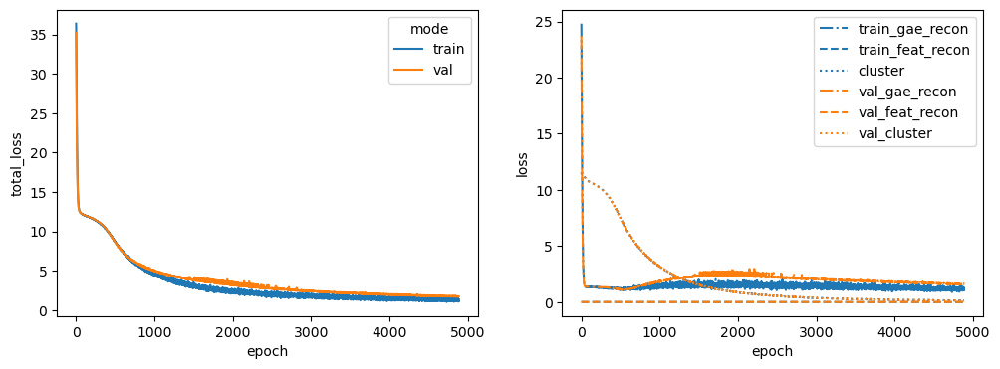

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


MAPK7
Latent dim: 1024


 33%|███▎      | 3288/10000 [01:01<02:04, 53.85it/s]


Training stopped after 3289 epochs
Best model found at epoch 3187
------------------------------------------------------------
TEST AUC: 0.7827664399092971 AP: 0.7851911712036951
TRAIN loss: 1.7662937641143799
VAL loss: 1.7065989971160889
TEST loss: 2.115645408630371
TEST AUC: 0.7827664399092971 	 AP: 0.7851911712036951


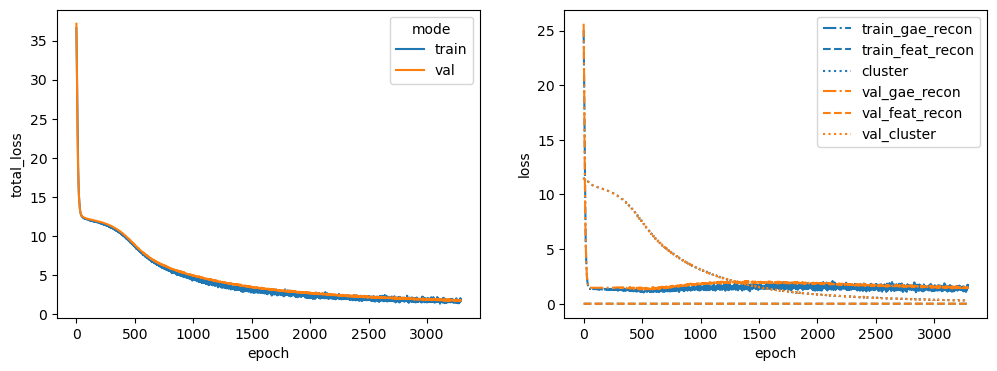

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


MOS
Latent dim: 1024


 37%|███▋      | 3653/10000 [01:07<01:57, 54.19it/s]


Training stopped after 3654 epochs
Best model found at epoch 3552
------------------------------------------------------------
TEST AUC: 0.8009977324263039 AP: 0.7567340480735841
TRAIN loss: 1.662358045578003
VAL loss: 1.565760850906372
TEST loss: 2.621619462966919
TEST AUC: 0.8009977324263039 	 AP: 0.7567340480735841


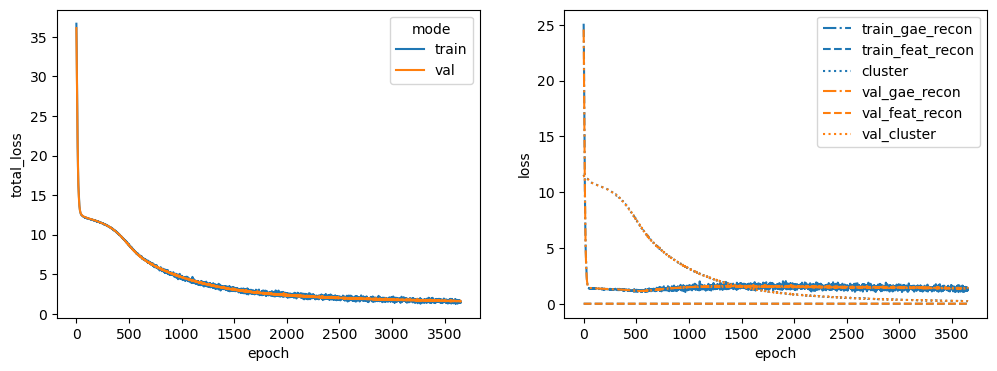

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


MYD88
Latent dim: 1024


 40%|███▉      | 3987/10000 [01:11<01:47, 55.73it/s]


Training stopped after 3988 epochs
Best model found at epoch 3886
------------------------------------------------------------
TEST AUC: 0.7980045351473923 AP: 0.8100993905695746
TRAIN loss: 1.882852554321289
VAL loss: 1.683133602142334
TEST loss: 1.812859058380127
TEST AUC: 0.7980045351473923 	 AP: 0.8100993905695746


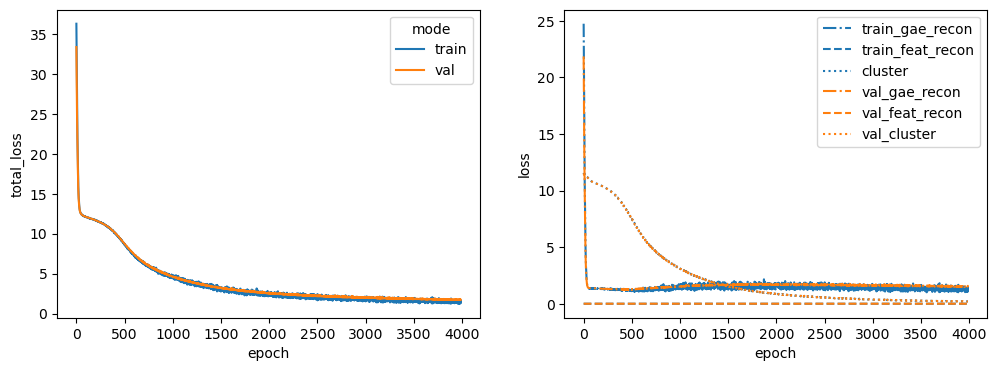

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


PIK3R2
Latent dim: 1024


 22%|██▏       | 2238/10000 [00:42<02:26, 52.95it/s]


Training stopped after 2239 epochs
Best model found at epoch 2137
------------------------------------------------------------
TEST AUC: 0.7765079365079366 AP: 0.7782452373654968
TRAIN loss: 2.19903564453125
VAL loss: 2.414119005203247
TEST loss: 2.563589096069336
TEST AUC: 0.7765079365079366 	 AP: 0.7782452373654968


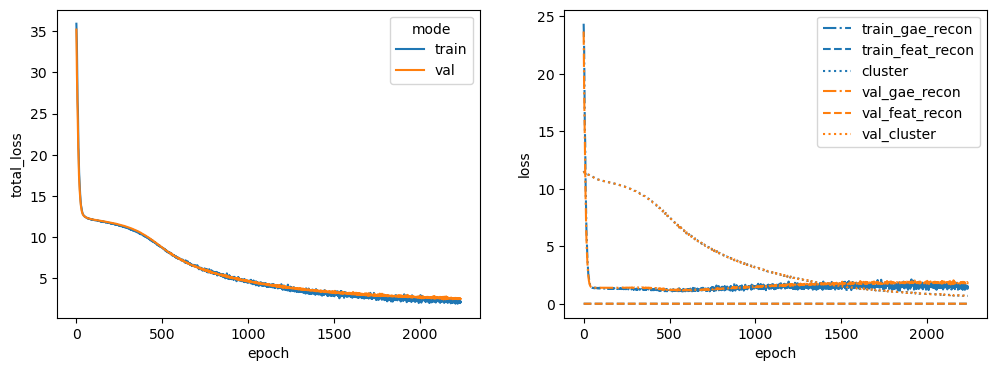

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


PRKACA
Latent dim: 1024


 19%|█▉        | 1912/10000 [00:35<02:31, 53.21it/s]


Training stopped after 1913 epochs
Best model found at epoch 1811
------------------------------------------------------------
TEST AUC: 0.7654875283446713 AP: 0.7572231543894234
TRAIN loss: 2.72703218460083
VAL loss: 3.043123245239258
TEST loss: 2.949376106262207
TEST AUC: 0.7654875283446713 	 AP: 0.7572231543894234


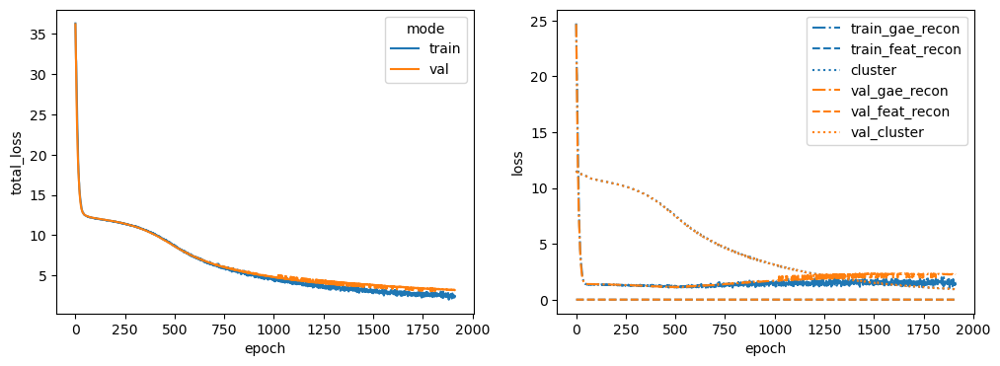

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


PRKCE
Latent dim: 1024


 46%|████▋     | 4625/10000 [01:25<01:39, 53.92it/s]


Training stopped after 4626 epochs
Best model found at epoch 4524
------------------------------------------------------------
TEST AUC: 0.7815873015873015 AP: 0.750129748182339
TRAIN loss: 1.3807685375213623
VAL loss: 1.724907636642456
TEST loss: 2.5094547271728516
TEST AUC: 0.7815873015873015 	 AP: 0.750129748182339


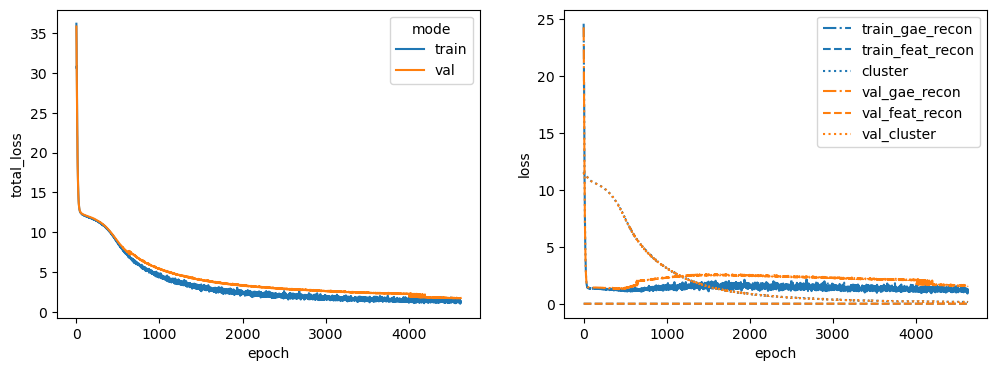

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


RAF1
Latent dim: 1024


 17%|█▋        | 1745/10000 [00:32<02:35, 52.93it/s]


Training stopped after 1746 epochs
Best model found at epoch 1644
------------------------------------------------------------
TEST AUC: 0.8033560090702948 AP: 0.7700108705567832
TRAIN loss: 2.8135337829589844
VAL loss: 3.614814281463623
TEST loss: 3.286863088607788
TEST AUC: 0.8033560090702948 	 AP: 0.7700108705567832


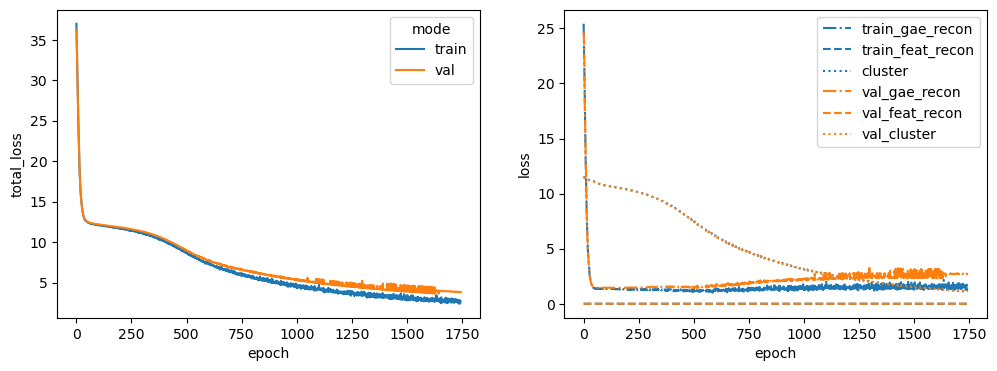

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


RELB
Latent dim: 1024


 49%|████▉     | 4898/10000 [01:31<01:34, 53.73it/s]


Training stopped after 4899 epochs
Best model found at epoch 4797
------------------------------------------------------------
TEST AUC: 0.784172335600907 AP: 0.7599584739681463
TRAIN loss: 1.112058162689209
VAL loss: 1.5903005599975586
TEST loss: 2.150662660598755
TEST AUC: 0.784172335600907 	 AP: 0.7599584739681463


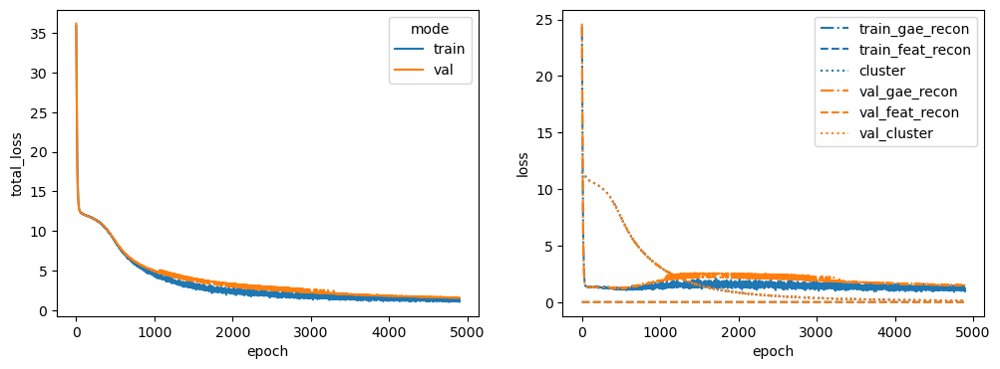

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


RHOA
Latent dim: 1024


 34%|███▍      | 3434/10000 [01:04<02:04, 52.86it/s]


Training stopped after 3435 epochs
Best model found at epoch 3333
------------------------------------------------------------
TEST AUC: 0.7990022675736961 AP: 0.7903076137864486
TRAIN loss: 1.8114720582962036
VAL loss: 1.9076640605926514
TEST loss: 2.011826753616333
TEST AUC: 0.7990022675736961 	 AP: 0.7903076137864486


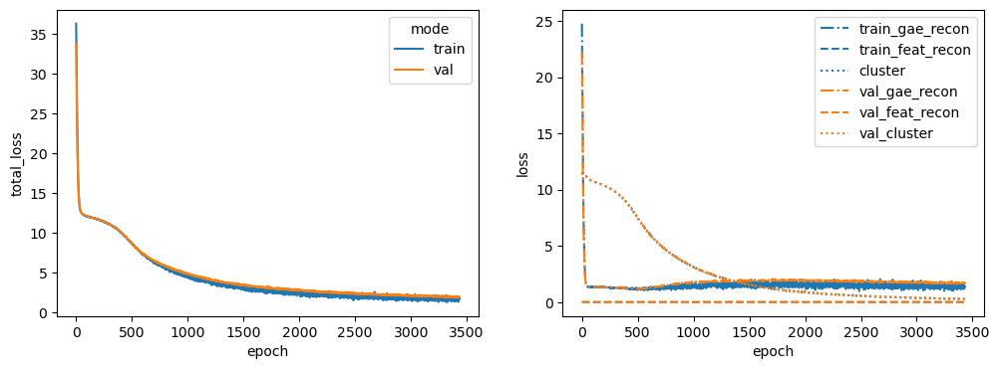

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


SMAD4
Latent dim: 1024


 26%|██▋       | 2635/10000 [00:49<02:18, 53.12it/s]


Training stopped after 2636 epochs
Best model found at epoch 2534
------------------------------------------------------------
TEST AUC: 0.812063492063492 AP: 0.8360618294852703
TRAIN loss: 2.0088253021240234
VAL loss: 2.3436508178710938
TEST loss: 2.107713222503662
TEST AUC: 0.812063492063492 	 AP: 0.8360618294852703


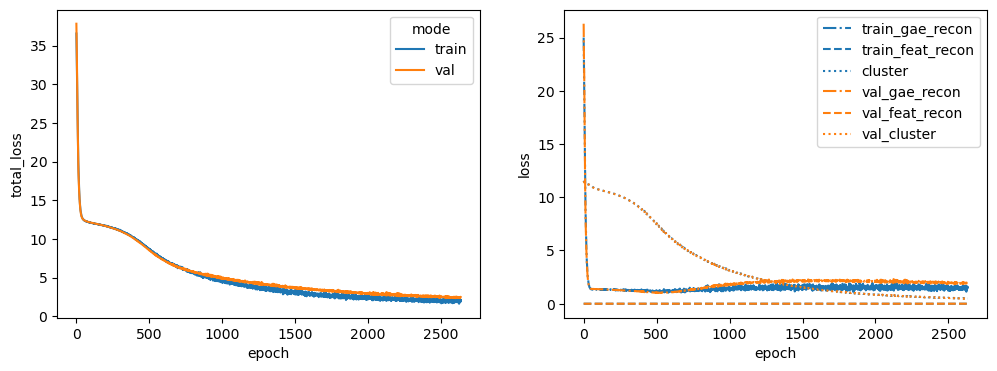

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


SMO
Latent dim: 1024


 41%|████      | 4083/10000 [01:14<01:48, 54.49it/s]


Training stopped after 4084 epochs
Best model found at epoch 3982
------------------------------------------------------------
TEST AUC: 0.7694331065759638 AP: 0.7529478370672603
TRAIN loss: 1.2567739486694336
VAL loss: 1.6593323945999146
TEST loss: 2.1939265727996826
TEST AUC: 0.7694331065759638 	 AP: 0.7529478370672603


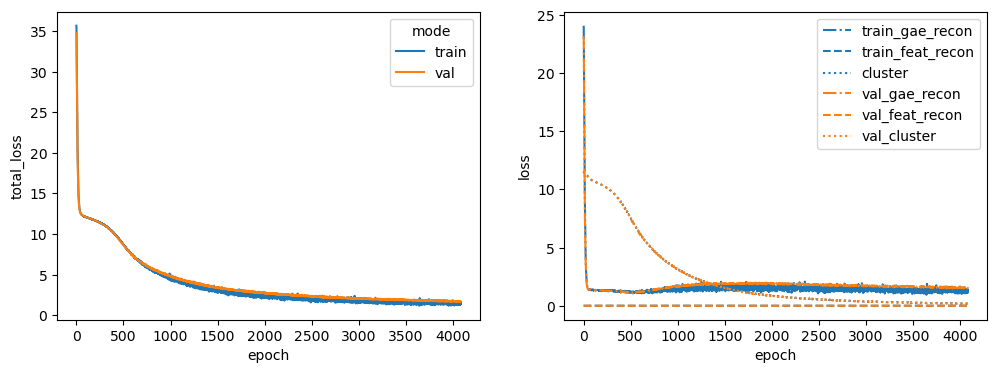

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


SRC
Latent dim: 1024


 26%|██▋       | 2643/10000 [00:49<02:17, 53.68it/s]


Training stopped after 2644 epochs
Best model found at epoch 2542
------------------------------------------------------------
TEST AUC: 0.7593650793650792 AP: 0.7327828635717872
TRAIN loss: 1.847525715827942
VAL loss: 2.3251826763153076
TEST loss: 2.790462017059326
TEST AUC: 0.7593650793650792 	 AP: 0.7327828635717872


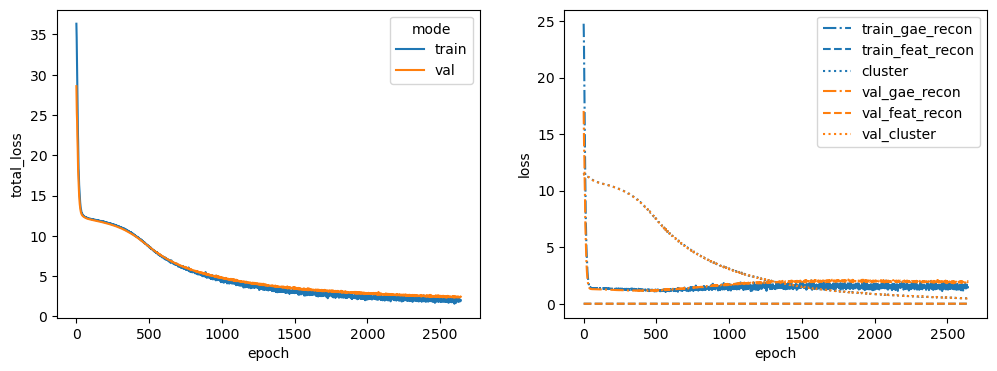

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


SREBF1
Latent dim: 1024


 40%|███▉      | 3986/10000 [01:13<01:50, 54.34it/s]


Training stopped after 3987 epochs
Best model found at epoch 3885
------------------------------------------------------------
TEST AUC: 0.80281179138322 AP: 0.7987366654556304
TRAIN loss: 1.347062587738037
VAL loss: 2.2767210006713867
TEST loss: 1.923837661743164
TEST AUC: 0.80281179138322 	 AP: 0.7987366654556304


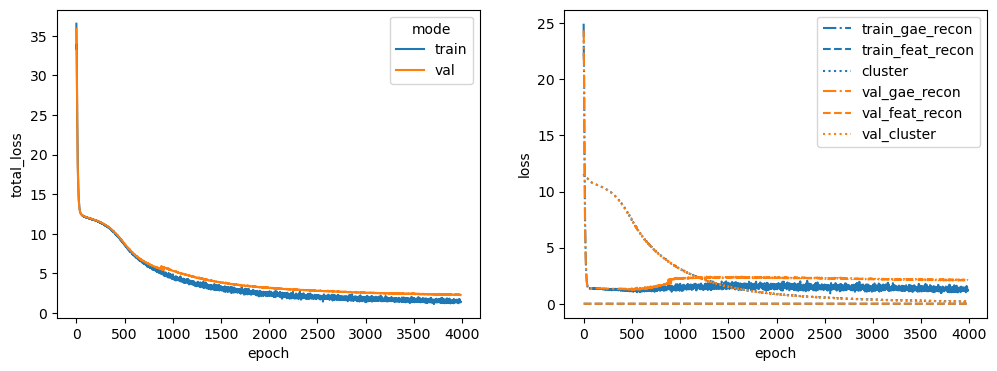

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


TRAF2
Latent dim: 1024


 14%|█▍        | 1428/10000 [00:27<02:44, 52.06it/s]


Training stopped after 1429 epochs
Best model found at epoch 1327
------------------------------------------------------------
TEST AUC: 0.7882086167800454 AP: 0.7568716493144301
TRAIN loss: 3.3160600662231445
VAL loss: 3.780522108078003
TEST loss: 4.087131023406982
TEST AUC: 0.7882086167800454 	 AP: 0.7568716493144301


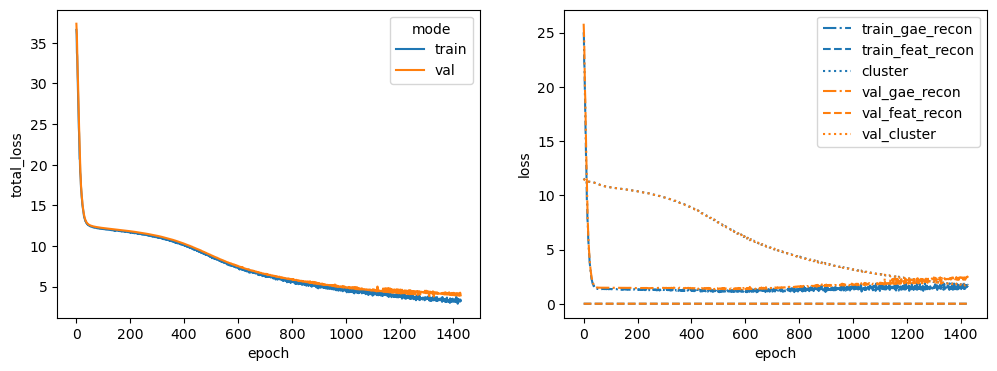

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


TSC2
Latent dim: 1024


 47%|████▋     | 4710/10000 [01:27<01:38, 53.60it/s]


Training stopped after 4711 epochs
Best model found at epoch 4609
------------------------------------------------------------
TEST AUC: 0.7843083900226757 AP: 0.782352079600016
TRAIN loss: 1.3611981868743896
VAL loss: 2.096740961074829
TEST loss: 2.0201144218444824
TEST AUC: 0.7843083900226757 	 AP: 0.782352079600016


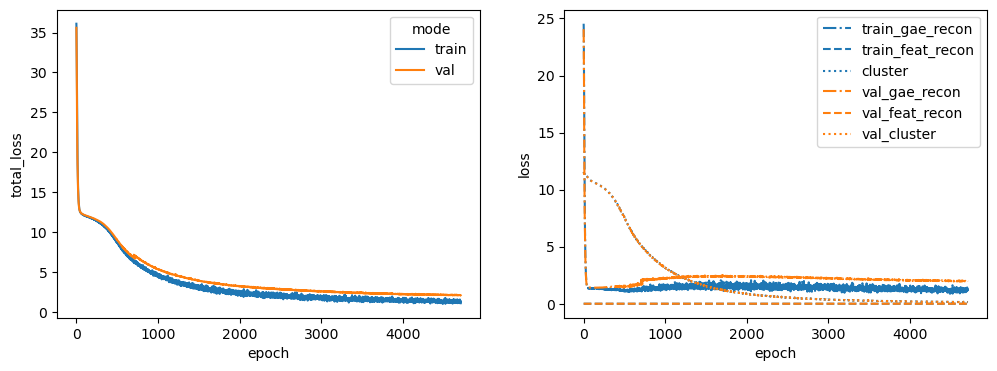

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


WWTR1
Latent dim: 1024


 36%|███▌      | 3595/10000 [01:06<01:57, 54.38it/s]


Training stopped after 3596 epochs
Best model found at epoch 3494
------------------------------------------------------------
TEST AUC: 0.7573696145124716 AP: 0.7370757640234156
TRAIN loss: 1.3969464302062988
VAL loss: 1.7298064231872559
TEST loss: 2.3319125175476074
TEST AUC: 0.7573696145124716 	 AP: 0.7370757640234156


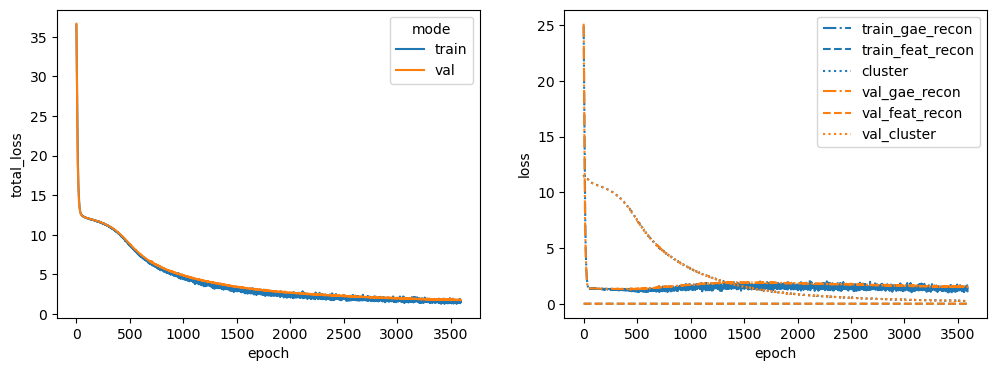

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


<IPython.core.display.Javascript object>

In [32]:
for oe_target in oe_targets:
    print(oe_target)
    phy_clusters = cmap_clusters.copy()
    phy_clusters.loc[oe_target] = -1
    lut = dict(
        zip(
            list(np.unique(phy_clusters)),
            [
                "tab:blue",
                "tab:red",
                "tab:green",
                "gold",
                "tab:orange",
                "tab:cyan",
                "tab:purple",
                "tab:pink",
                "tab:olive",
                "olivedrab",
                "tab:brown",
            ],
        )
    )
    phy_clusters.loc[:, "color"] = phy_clusters.loc[:, "cluster"].map(lut)
    spearman_interactome = graph_dict[oe_target]

    device = torch.device("cpu")

    graph_data = from_networkx(spearman_interactome)
    graph_data.id = torch.FloatTensor(np.identity(len(spearman_interactome)))
    graph_data = T.ToDevice(
        device,
        attrs=[
            "id",
            "sc_gex",
            "label",
            "label_mask",
            "hallmark",
            "sc_gex_hallmark",
        ],
    )(graph_data)

    input_dim = 1176
    latent_dim = 1024

    # Derive class weights
    class_weights = OrderedDict(
        sorted(dict(Counter(np.array(phy_clusters.loc[:, "cluster"]))).items())
    )
    del class_weights[-1]
    class_weights = np.array(list(class_weights.values()))
    class_weights = 1 / class_weights
    class_weights = class_weights / np.sum(class_weights)

    class_weights = None

    gae = GAE(
        GCNEncoder(in_channels=input_dim, out_channels=latent_dim, hidden_dim=1024)
    )
    feature_decoder = FeatureDecoder(
        latent_dim=latent_dim,
        hidden_dims=[1024],
        output_dim=input_dim,
        loss_fct=torch.nn.L1Loss(),
    )
    latent_classifier = LatentClassifier(
        latent_dim=latent_dim,
        hidden_dims=None,
        n_classes=10,
        loss_fct=None,
        class_weights=class_weights,
    )

    seeds = [1234]
    alpha = 1
    beta = 0
    gamma = 5
    use_graph = "split_graph"

    node_feature_key = "sc_gex_hallmark"
    edge_weight_key = None

    print("Latent dim: {}".format(1024))
    latents_dict, loss_hist_dict = get_gae_latents_for_seed(
        graph_data=graph_data,
        gae=gae,
        seeds=seeds,
        node_feature_key=node_feature_key,
        edge_weight_key=edge_weight_key,
        feature_decoder=feature_decoder,
        latent_classifier=latent_classifier,
        n_epochs=10000,
        lr=0.00001,
        split_type="link",
        alpha=alpha,
        beta=beta,
        gamma=gamma,
        plot_loss=True,
        early_stopping=100,
        use_full_graph=use_graph == "full_graph",
        neg_edge_ratio=1.0,
    )

    output_dir = "../../../data/experiments/image_embeddings/specificity_target_emb_loto/embeddings/{}".format(
        oe_target
    )

    output_dir = os.path.join(
        output_dir, "gae_exp_a{}_b{}_g{}_{}_cmap".format(alpha, beta, gamma, use_graph)
    )
    os.makedirs(output_dir, exist_ok=True)

    latents = latents_dict[1234]
    node_names = getattr(graph_data, "name")
    st_memberships = getattr(graph_data, "spec_target")
    latents = pd.DataFrame(latents, index=node_names)

    embs = TSNE(
        random_state=1234,
        perplexity=int(np.sqrt(len(latents))) + 1,
        init="pca",
        learning_rate="auto",
    ).fit_transform(latents)
    embs = pd.DataFrame(embs, columns=["tsne_0", "tsne_1"], index=node_names)
    embs["spec_target"] = st_memberships.cpu().numpy()

    fig, ax = plt.subplots(figsize=[20, 10])
    ax = sns.scatterplot(
        data=embs, x="tsne_0", y="tsne_1", cmap="viridis", hue="spec_target"
    )
    label_point(
        np.array(embs.loc[:, "tsne_0"]),
        np.array(embs.loc[:, "tsne_1"]),
        np.array(embs.index).astype("str"),
        ax=ax,
    )
    ax.set_title("Visualization of the inferred embedding space")
    plt.savefig(
        os.path.join(
            output_dir,
            "tsne_embs.png".format(alpha, beta, gamma, use_graph),
        )
    )
    plt.close()

    ax = sns.clustermap(
        latents.loc[set(oe_targets).intersection(latents.index)],
        figsize=[6, 12],
        metric="cosine",
        method="complete",
        cmap="seismic",
        row_colors=np.array(
            phy_clusters.loc[set(oe_targets).intersection(latents.index), "color"]
        ).ravel(),
    )
    ax.ax_heatmap.set_yticklabels(
        ax.ax_heatmap.get_ymajorticklabels(),
        fontsize=15,
        fontweight="bold",
    )
    plt.savefig(
        os.path.join(
            output_dir,
            "reg_clustering.png".format(alpha, beta, gamma, use_graph),
        )
    )
    plt.close()

    latents.to_csv(
        os.path.join(
            output_dir,
            "node_embs.csv".format(alpha, beta, gamma, use_graph),
        )
    )

---

In [291]:
i = 14
oe_target = oe_targets[i]
phy_clusters = phy_clusters_dict[oe_target].copy()
phy_clusters.loc[oe_target] = -1
lut = dict(
    zip(
        list(np.unique(phy_clusters)),
        [
            "tab:blue",
            "tab:red",
            "tab:green",
            "gold",
            "tab:orange",
            "tab:cyan",
            "tab:purple",
            "tab:pink",
            "tab:olive",
            "olivedrab",
            "tab:brown",
        ],
    )
)
phy_clusters.loc[:, "color"] = phy_clusters.loc[:, "cluster"].map(lut)

<IPython.core.display.Javascript object>

In [292]:
spearman_interactome = graph_dict[oe_target]

<IPython.core.display.Javascript object>

---

### 2.2 Data preparation

Next, we transform the individual graph objects into a data object complient with the used pytorch_geometric framework to learn the graph embeddings, again we do that for each graph corresponding to a specific leave-one-target-out setting.

In [293]:
device = torch.device("cpu")

graph_data = from_networkx(spearman_interactome)
graph_data.id = torch.FloatTensor(np.identity(len(spearman_interactome)))
graph_data = T.ToDevice(
    device,
    attrs=[
        "id",
        "sc_gex",
        "label",
        "label_mask",
        "hallmark",
        "sc_gex_hallmark",
    ],
)(graph_data)

<IPython.core.display.Javascript object>

---
---

## 3. Node embeddings

Next, we aim at inferring the regulatory space in U2OS cells by encoding the previously inferred gene-gene interactome in the way described above.

### 3.1. Model setup

As a first step, we thus define the graph autoencoder model in addition to a feature decoder and a latent classification model which will jointly guide the inference.


In [294]:
input_dim = 1176
latent_dim = 1024

# Derive class weights
class_weights = OrderedDict(
    sorted(dict(Counter(np.array(phy_clusters.loc[:, "cluster"]))).items())
)
del class_weights[-1]
class_weights = np.array(list(class_weights.values()))
class_weights = 1 / class_weights
class_weights = class_weights / np.sum(class_weights)

# class_weights = None

gae = GAE(GCNEncoder(in_channels=input_dim, out_channels=latent_dim, hidden_dim=1024))
feature_decoder = FeatureDecoder(
    latent_dim=latent_dim,
    hidden_dims=[1024],
    output_dim=input_dim,
    loss_fct=torch.nn.L1Loss(),
)
latent_classifier = LatentClassifier(
    latent_dim=latent_dim,
    hidden_dims=None,
    n_classes=10,
    loss_fct=None,
    class_weights=class_weights,
)

<IPython.core.display.Javascript object>

---

##### Hallmark-GEX GAE (adjacency & feature reconstruction) with link splitting

We train the model on the adjacency and feature reconstruction task to monitor the model performance we split the existing links into 0.7 for training, 0.1 for validation and 0.2 for training. The training is early stopped if the performance of the link prediction task does no longer improve as measured by the BCELoss.

In [295]:
seeds = [1234]
alpha = 1
beta = 0
gamma = 2
use_graph = "split_graph"

<IPython.core.display.Javascript object>

Latent dim: 1024


 40%|████      | 4013/10000 [01:18<01:57, 50.95it/s]


Training stopped after 4014 epochs
Best model found at epoch 3912
------------------------------------------------------------
TEST AUC: 0.7731519274376417 AP: 0.7838420563161526
TRAIN loss: 1.1327096223831177
VAL loss: 1.4496355056762695
TEST loss: 1.6033382415771484
TEST AUC: 0.7731519274376417 	 AP: 0.7838420563161526


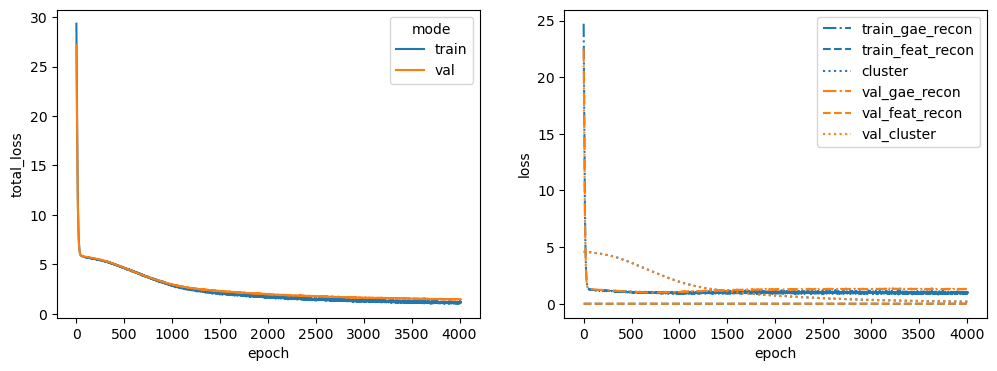

<IPython.core.display.Javascript object>

In [296]:
node_feature_key = "sc_gex_hallmark"
edge_weight_key = None

print("Latent dim: {}".format(1024))
latents_dict, loss_hist_dict = get_gae_latents_for_seed(
    graph_data=graph_data,
    gae=gae,
    seeds=seeds,
    node_feature_key=node_feature_key,
    edge_weight_key=edge_weight_key,
    feature_decoder=feature_decoder,
    latent_classifier=latent_classifier,
    n_epochs=10000,
    lr=0.00001,
    split_type="link",
    alpha=alpha,
    beta=beta,
    gamma=gamma,
    plot_loss=True,
    early_stopping=100,
    use_full_graph=use_graph == "full_graph",
    neg_edge_ratio=1.0,
)

---

### 3.3. Analyses of the inferred node embeddings

As discussed earlier, we will select the embeddings obtained from the previously described model as the final embeddings of the nodes in our network. We now will visualize and analyze the node embeddings with respect to their clustering to validate that e.g. genes which are known to function together co-cluster in the embedding space.

#### Visualization of the inferred latent space

In [320]:
from sklearn.preprocessing import normalize

<IPython.core.display.Javascript object>

In [324]:
latents = pd.read_csv(
    "../../../data/experiments/image_embeddings/specificity_target_emb_loto/embeddings/JUN/gae_exp_a1_b0_g1_full_graph/node_embs.csv",
    index_col=0,
)
latents = pd.DataFrame(normalize(latents), index=latents.index, columns=latents.columns)

<IPython.core.display.Javascript object>

In [297]:
latents = latents_dict[1234]

<IPython.core.display.Javascript object>

In [298]:
node_names = getattr(graph_data, "name")
st_memberships = getattr(graph_data, "spec_target")

<IPython.core.display.Javascript object>

In [299]:
latents = pd.DataFrame(latents, index=node_names)

<IPython.core.display.Javascript object>

In [325]:
embs = TSNE(
    random_state=1234,
    perplexity=int(np.sqrt(len(latents))) + 1,
    init="pca",
    learning_rate="auto",
).fit_transform(latents)
embs = pd.DataFrame(embs, columns=["tsne_0", "tsne_1"], index=node_names)
embs["spec_target"] = st_memberships.cpu().numpy()

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


<IPython.core.display.Javascript object>

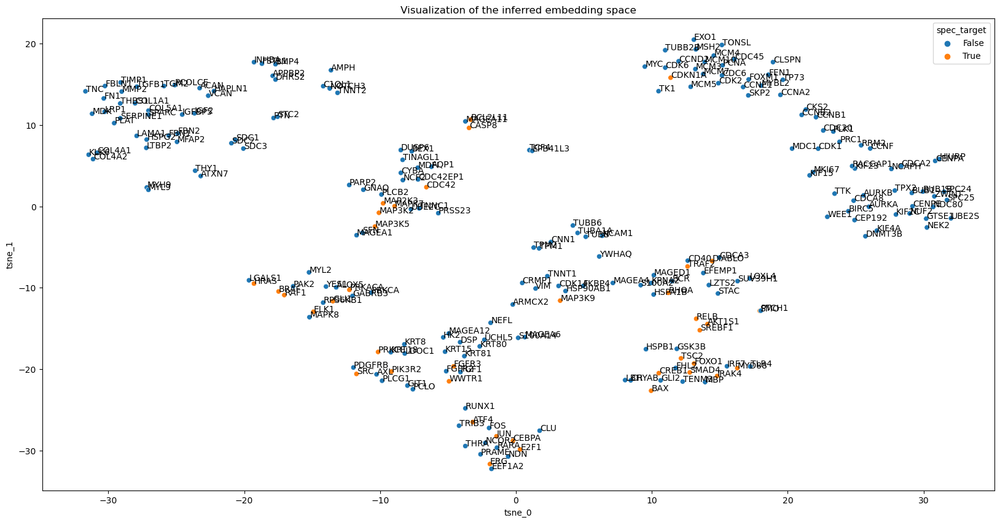

<IPython.core.display.Javascript object>

In [326]:
fig, ax = plt.subplots(figsize=[20, 10])
ax = sns.scatterplot(
    data=embs, x="tsne_0", y="tsne_1", cmap="viridis", hue="spec_target"
)
label_point(
    np.array(embs.loc[:, "tsne_0"]),
    np.array(embs.loc[:, "tsne_1"]),
    np.array(embs.index).astype("str"),
    ax=ax,
)
ax.set_title("Visualization of the inferred embedding space")
plt.show()

#### Clustering of the embedding space

We will now perform a cluster analyses using hierarchical clustering based on the euclidean distances of the individual node embeddings and average linkage.

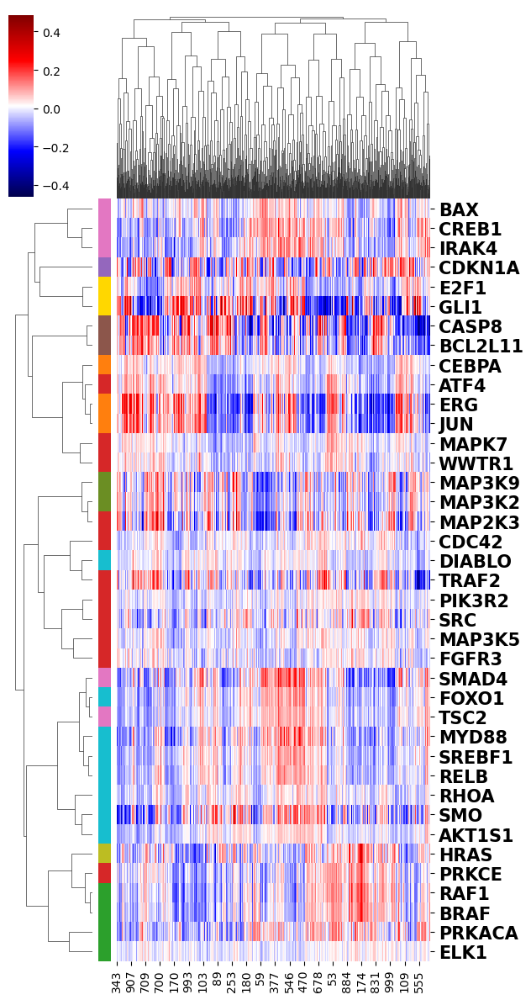

<IPython.core.display.Javascript object>

In [302]:
# latents = node_embs.copy()
ax = sns.clustermap(
    latents.loc[set(oe_targets).intersection(latents.index)],
    figsize=[6, 12],
    metric="cosine",
    method="complete",
    cmap="seismic",
    row_colors=np.array(
        phy_clusters.loc[set(oe_targets).intersection(latents.index), "color"]
    ).ravel(),
)
ax.ax_heatmap.set_yticklabels(
    ax.ax_heatmap.get_ymajorticklabels(),
    fontsize=15,
    fontweight="bold",
)
plt.show()

---

In [303]:
output_dir = "../../../data/experiments/image_embeddings/specificity_target_emb_loto/embeddings/{}".format(
    oe_target
)
latents.to_csv(
    os.path.join(
        output_dir, "node_embs_a{}_b{}_g{}_{}.csv".format(alpha, beta, gamma, use_graph)
    )
)

<IPython.core.display.Javascript object>